In [3]:
!nvidia-smi

Wed Dec 20 12:15:52 2023       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   41C    P8               9W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [4]:
#Debug the code
import pdb
import torch
#Build deep learning architectures (models)
from torch import nn
#It will generate an iterable item for iterate the dataset
from torch.utils.data import DataLoader
#Transform data in diferent ways (torchvision - Computer vision)
from torchvision import transforms
from torchvision.datasets import MNIST
#Grid of images to evaluate how fake images are looking vs real images
from torchvision.utils import make_grid
#Progress Bar
from tqdm.auto import tqdm
import matplotlib.pyplot as plt

In [25]:
def show(tensor, ch=1, size=(28, 28), num=16):
  #tensor: 128 x 784 (128 - Batch Size, 784 - Size 28x28)
  data = tensor.detach().cpu().view(-1, ch, *size) #-1 is for what's remaining so 128 items will be taking one by one
  grid = make_grid(data[:num], nrow=4).permute(1,2,0) #First num items 1, 28, 28 permute will be changing to  28, 28, 1 (for matplotlib)
  plt.imshow(grid)
  plt.show()

In [7]:
epochs = 500 #Number of cycles
cur_step = 0 #Current step
info_step = 300 #How many steps we want to show information
mean_gen_loss = 0
mean_disc_loss = 0

z_dim = 64
lr = 0.00001 #Learning rate
loss_func = nn.BCEWithLogitsLoss()

bs = 128 #Each step how many images we're going to proceed (Batch Size)
device = 'cuda'

dataloader = DataLoader(
    dataset = MNIST('.', download=True, transform=transforms.ToTensor()),
    shuffle = True, #Each step data will be shuffled
    batch_size = bs
)

#num_of_steps = dataset total size / batch size
#num_of_steps = 60000 / 128 = 468.75
#num_of_steps = 469 (last step, batch size will be less than 128 images)

100%|██████████| 9912422/9912422 [00:00<00:00, 108612607.06it/s]


Extracting ./MNIST/raw/train-images-idx3-ubyte.gz to ./MNIST/raw



100%|██████████| 28881/28881 [00:00<00:00, 38763422.02it/s]


Extracting ./MNIST/raw/train-labels-idx1-ubyte.gz to ./MNIST/raw



100%|██████████| 1648877/1648877 [00:00<00:00, 30333655.26it/s]


Extracting ./MNIST/raw/t10k-images-idx3-ubyte.gz to ./MNIST/raw



100%|██████████| 4542/4542 [00:00<00:00, 18370808.84it/s]


Extracting ./MNIST/raw/t10k-labels-idx1-ubyte.gz to ./MNIST/raw



In [9]:
def genBlock(inp, out):
  return nn.Sequential(
      nn.Linear(inp, out), #Linear computations
      nn.BatchNorm1d(out), #1d 1 channel images (Black and White) It will normallice the output of the linear layer, it makes training more stable
      nn.ReLU(inplace=True) #Non Linear function (if x < 0 then x = 0 else x), inplace=True it will modify the values directly instead of using more resources
  ) ##nn.Sequential allow us to create a collection of different layers that will be executed in sequential

class Generator(nn.Module):
  def __init__(self, z_dim=64, i_dim=784, h_dim=128):
    super().__init__()
    self.gen = nn.Sequential(
        genBlock(z_dim, h_dim), #64 -> 128
        genBlock(h_dim, 2*h_dim), #128 -> 256
        genBlock(2*h_dim, 4*h_dim), #256 -> 512
        genBlock(4*h_dim, 8*h_dim), #512 -> 1024
        nn.Linear(8*h_dim, i_dim), #1024 -> 784 (28x28)
        nn.Sigmoid()
    )


  def forward(self, noise):
    return self.gen(noise)

def gen_noise(number, z_dim):
  #randn creates a item with values between 0 and 1
  return torch.randn(number, z_dim).to(device)

In [11]:
def discBlock(inp, out):
  return nn.Sequential(
      nn.Linear(inp, out),
      nn.LeakyReLU(0.2) #Prevent dead neurons (see more info), this will give negative values a slope (pendiente)
  )

class Discriminator(nn.Module):
  def __init__(self, i_dim=784, h_dim=256):
    super().__init__()
    self.disc = nn.Sequential(
        discBlock(i_dim, 4*h_dim), #748 -> 1024
        discBlock(4*h_dim, 2*h_dim), #1024 -> 512
        discBlock(2*h_dim, h_dim), #512 -> 256
        nn.Linear(h_dim, 1) #256 -> 1
    )

  def forward(self, image):
    return self.disc(image)

In [28]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(
    gen.parameters(),
    lr=lr
) #This optimizer will fit the training items to the best structure for training

In [29]:
disc = Discriminator().to(device)
disc_opt = torch.optim.Adam(
    disc.parameters(),
    lr=lr
)

In [30]:
gen

Generator(
  (gen): Sequential(
    (0): Sequential(
      (0): Linear(in_features=64, out_features=128, bias=True)
      (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (1): Sequential(
      (0): Linear(in_features=128, out_features=256, bias=True)
      (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (2): Sequential(
      (0): Linear(in_features=256, out_features=512, bias=True)
      (1): BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (3): Sequential(
      (0): Linear(in_features=512, out_features=1024, bias=True)
      (1): BatchNorm1d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (4): Linear(in_features=1024, out_features=784, bias=True)
    (5): Sigmoid()
  )
)

torch.Size([128, 1, 28, 28]) torch.Size([128])
tensor([1, 4, 0, 4, 4, 9, 2, 9, 0, 4])


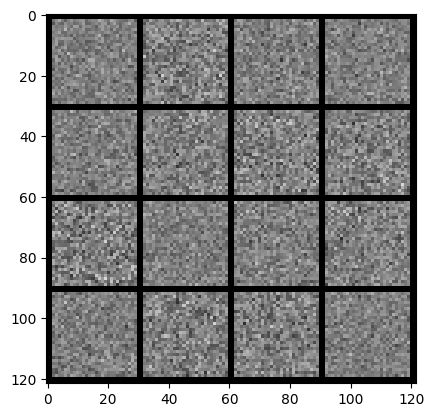

In [31]:
x, y = next(iter(dataloader)) #Cast data loader into an iterator and then give me next item
print(x.shape, y.shape)
print(y[:10])

noise = gen_noise(bs, z_dim)
fake = gen(noise)
show(fake)

In [34]:
def calc_gen_loss(loss_func, gen, disc, number, z_dim):
  noise = gen_noise(number, z_dim)
  fake = gen(noise)
  pred = disc(fake)
  targets = torch.ones_like(pred) #Generator wants to fool discriminator (1)

  gen_loss = loss_func(pred, targets)
  return gen_loss

def calc_disc_loss(loss_func, gen, disc, number, real, z_dim):
  noise = gen_noise(number, z_dim)
  fake = gen(noise)
  disc_fake = disc(fake.detach()) #We don't want to update the generator here
  disc_fake_targets = torch.zeros_like(disc_fake)

  disc_fake_loss = loss_func(disc_fake, disc_fake_targets)

  disc_real = disc(real)
  disc_real_targets = torch.ones_like(disc_real)

  disc_real_loss=loss_func(disc_real, disc_real_targets)

  disc_loss = (disc_fake_loss + disc_real_loss) / 2
  return disc_loss


  0%|          | 0/469 [00:00<?, ?it/s]

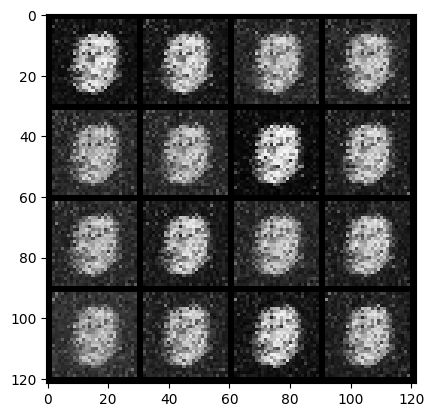

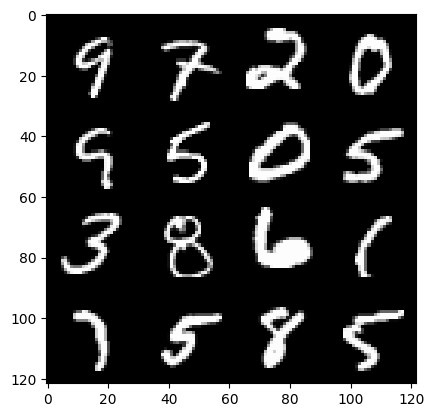

0: step 300 / Gen loss: 2.0277035876115166 / disc_loss: 0.3351151957114538


  0%|          | 0/469 [00:00<?, ?it/s]

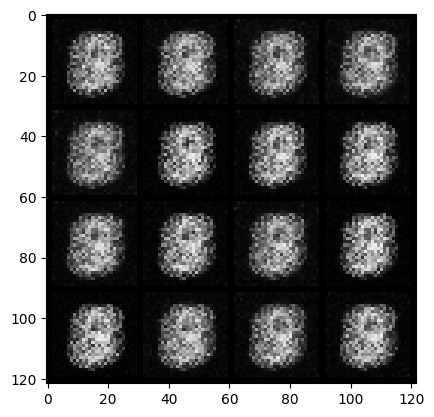

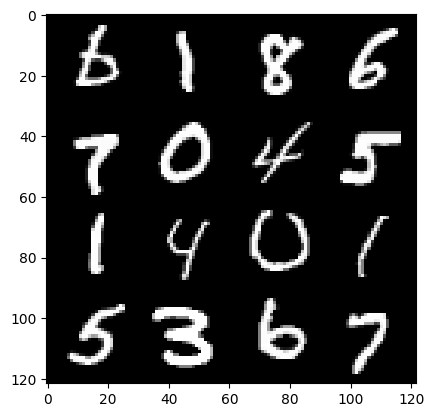

1: step 600 / Gen loss: 3.6493294239044167 / disc_loss: 0.10979371263335144


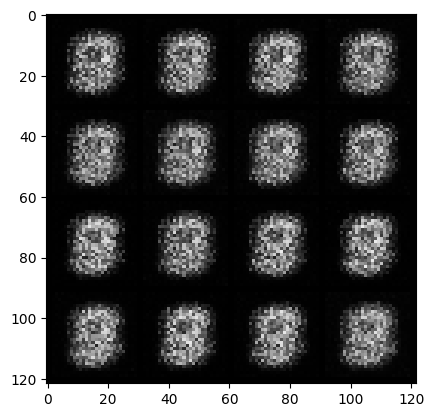

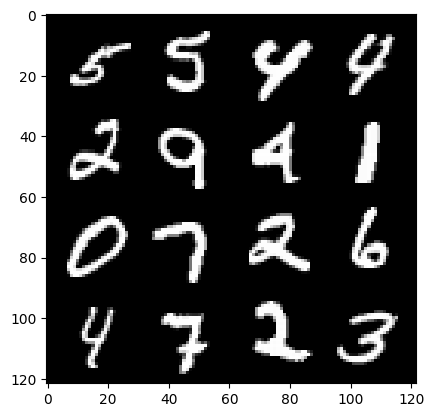

1: step 900 / Gen loss: 3.6908274332682303 / disc_loss: 0.04652268871044118


  0%|          | 0/469 [00:00<?, ?it/s]

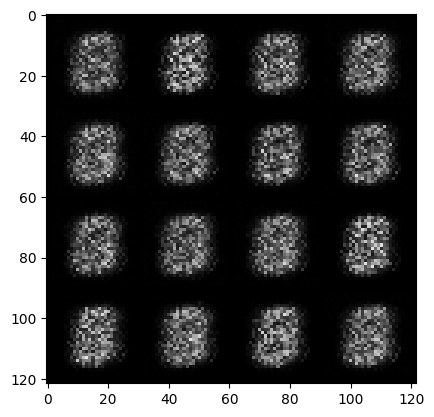

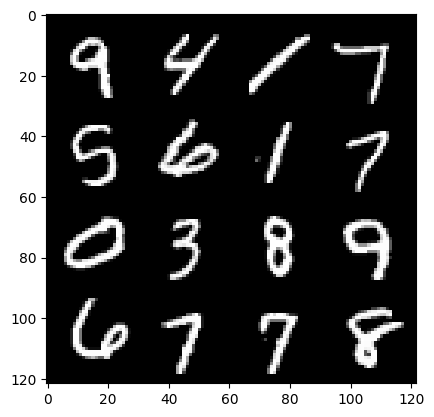

2: step 1200 / Gen loss: 3.7464114491144804 / disc_loss: 0.030604806511352462


  0%|          | 0/469 [00:00<?, ?it/s]

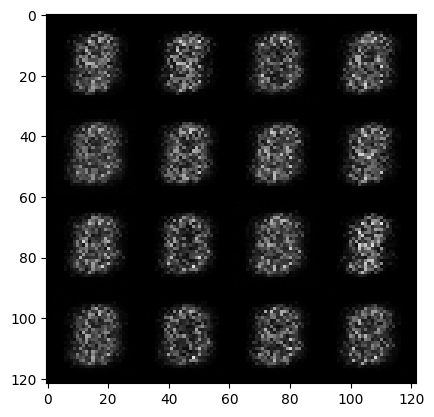

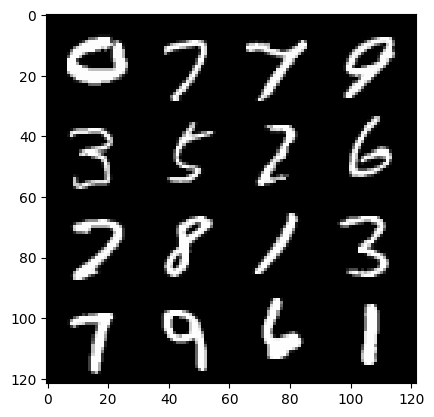

3: step 1500 / Gen loss: 3.5514372801780687 / disc_loss: 0.038294696578135085


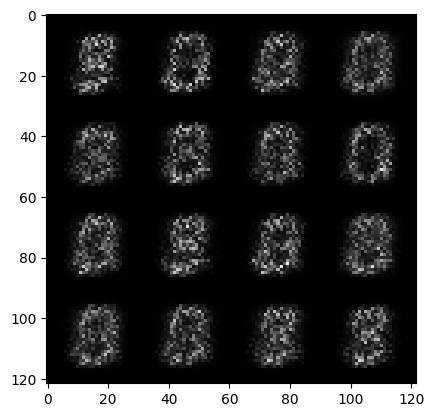

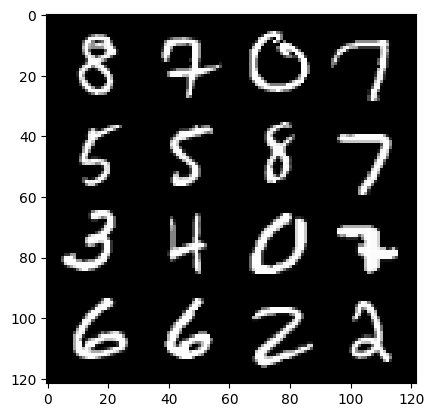

3: step 1800 / Gen loss: 3.3742623734474178 / disc_loss: 0.05274805011848607


  0%|          | 0/469 [00:00<?, ?it/s]

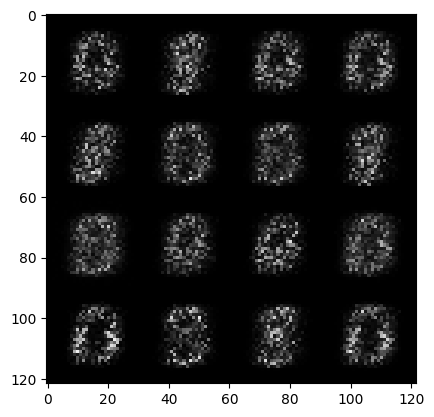

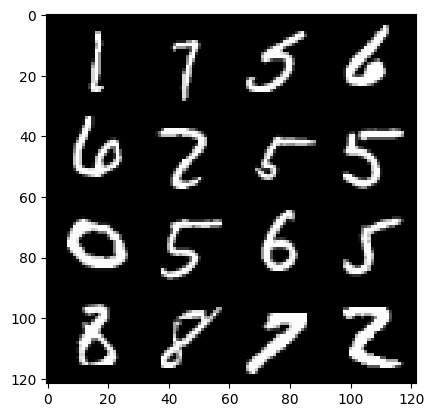

4: step 2100 / Gen loss: 3.573755931059518 / disc_loss: 0.0488084037353595


  0%|          | 0/469 [00:00<?, ?it/s]

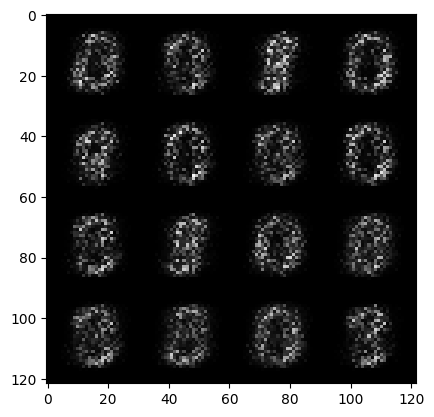

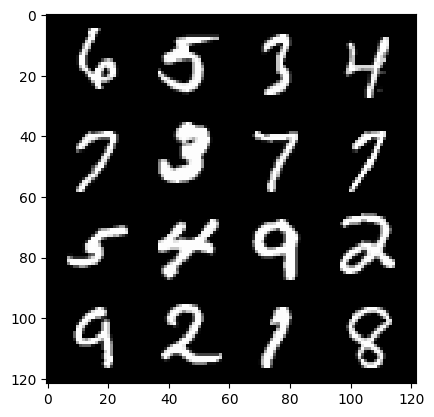

5: step 2400 / Gen loss: 3.8938171760241205 / disc_loss: 0.0376348836161196


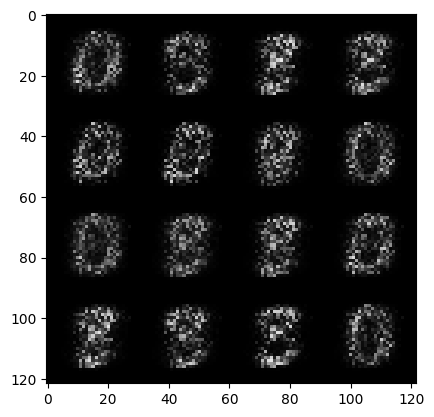

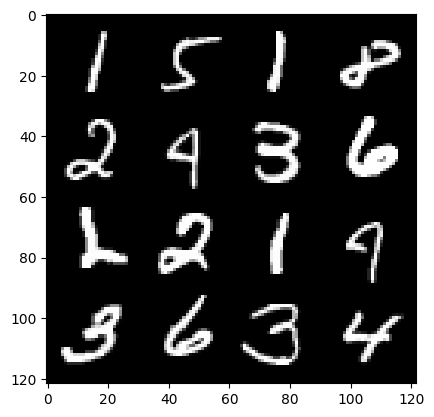

5: step 2700 / Gen loss: 4.306254963874818 / disc_loss: 0.03274835466717681


  0%|          | 0/469 [00:00<?, ?it/s]

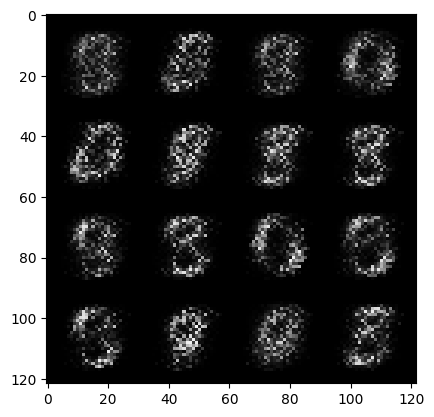

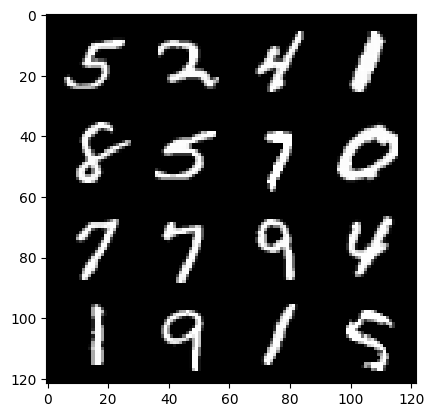

6: step 3000 / Gen loss: 4.650925057729087 / disc_loss: 0.028421721073488407


  0%|          | 0/469 [00:00<?, ?it/s]

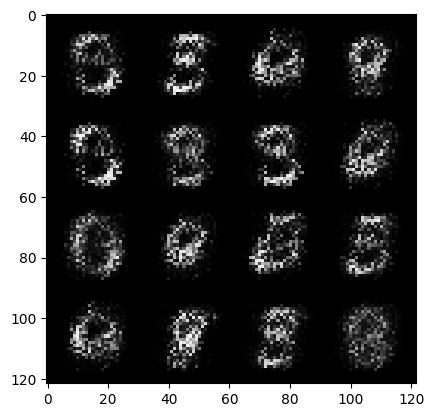

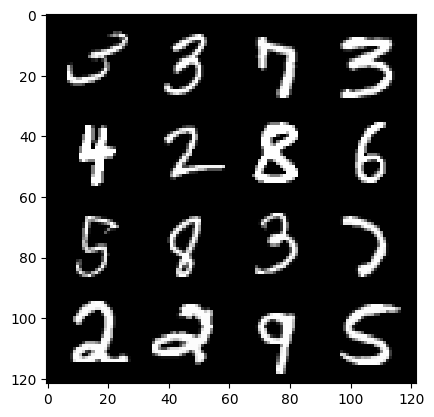

7: step 3300 / Gen loss: 4.828832198778787 / disc_loss: 0.02792106496170163


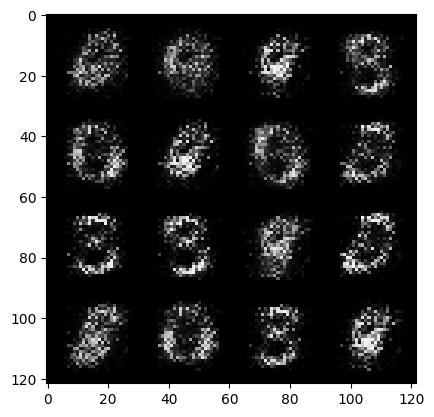

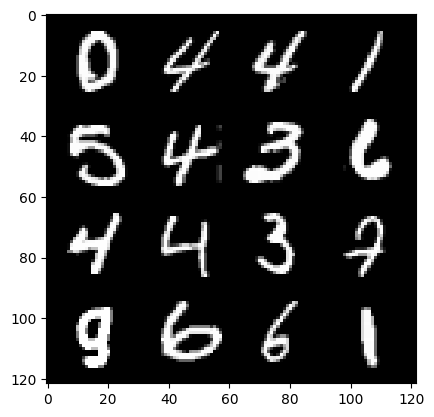

7: step 3600 / Gen loss: 4.963332754770912 / disc_loss: 0.027900228404129555


  0%|          | 0/469 [00:00<?, ?it/s]

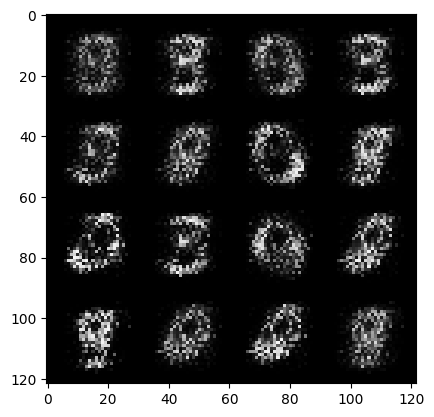

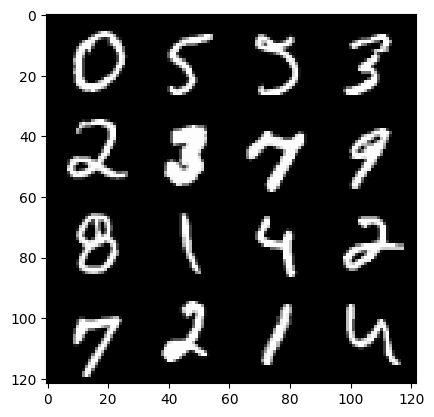

8: step 3900 / Gen loss: 5.271302024523416 / disc_loss: 0.02266185319051148


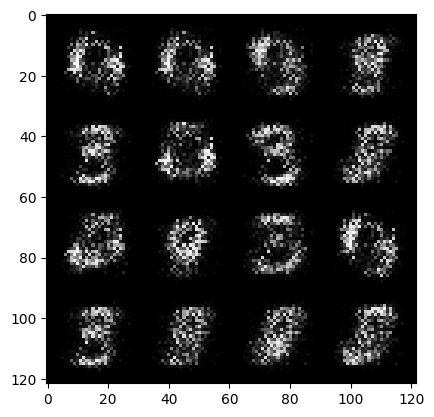

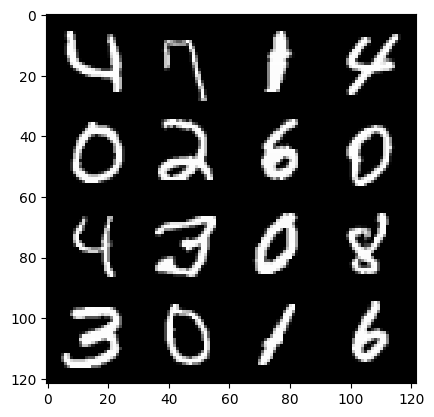

8: step 4200 / Gen loss: 5.63602966785431 / disc_loss: 0.018030201460545264


  0%|          | 0/469 [00:00<?, ?it/s]

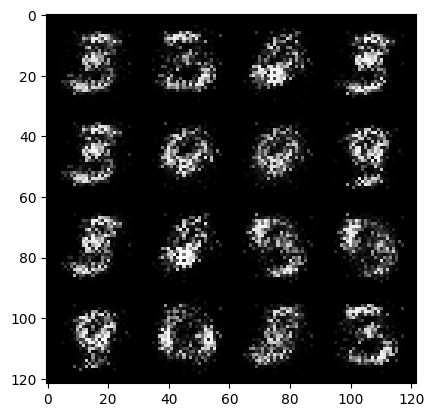

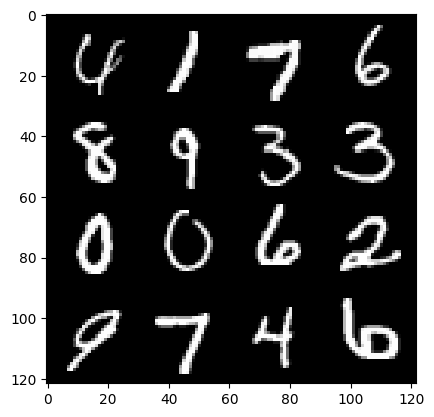

9: step 4500 / Gen loss: 5.835907588005068 / disc_loss: 0.01594895235107591


  0%|          | 0/469 [00:00<?, ?it/s]

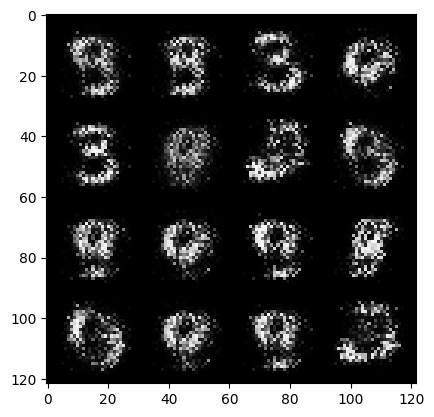

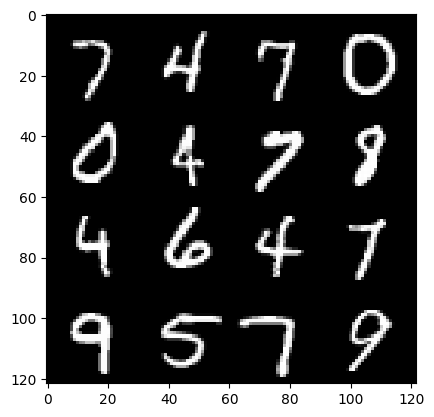

10: step 4800 / Gen loss: 5.909639488855995 / disc_loss: 0.014765870984022827


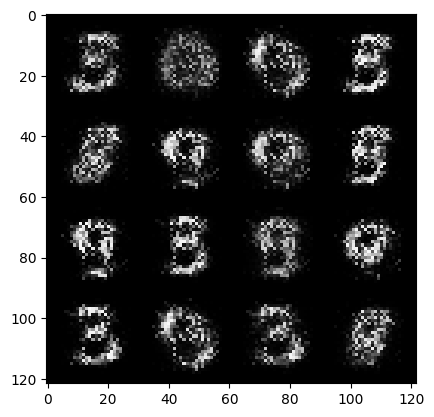

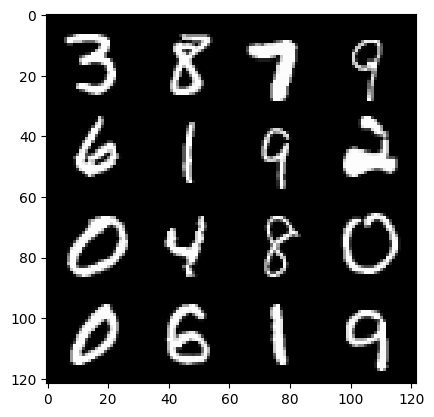

10: step 5100 / Gen loss: 6.090028425852455 / disc_loss: 0.01253843687940389


  0%|          | 0/469 [00:00<?, ?it/s]

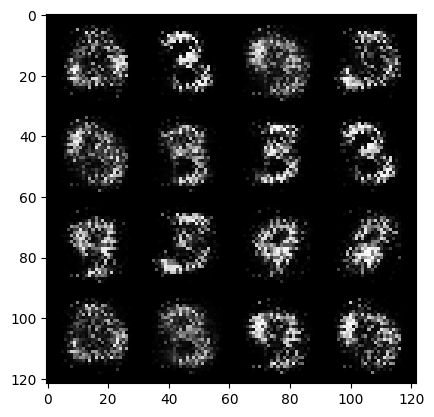

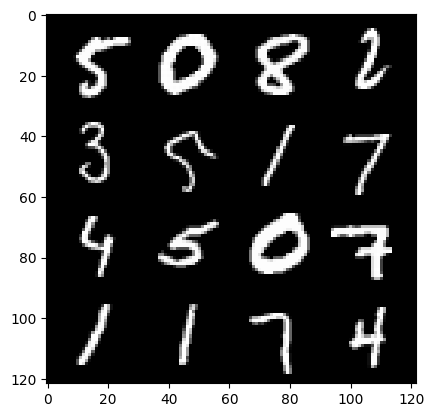

11: step 5400 / Gen loss: 6.347791280746461 / disc_loss: 0.010140812206858162


  0%|          | 0/469 [00:00<?, ?it/s]

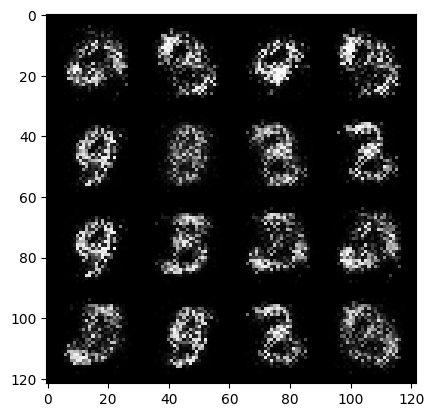

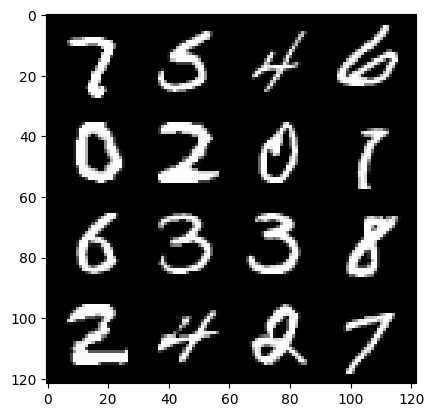

12: step 5700 / Gen loss: 6.842824570337939 / disc_loss: 0.010509568325554334


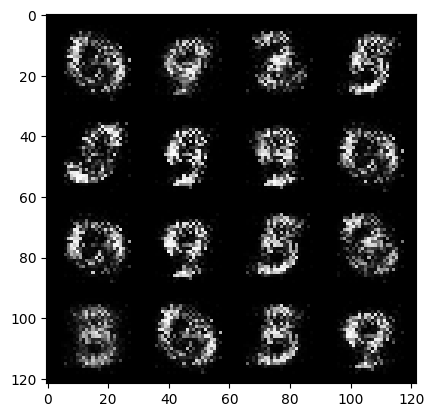

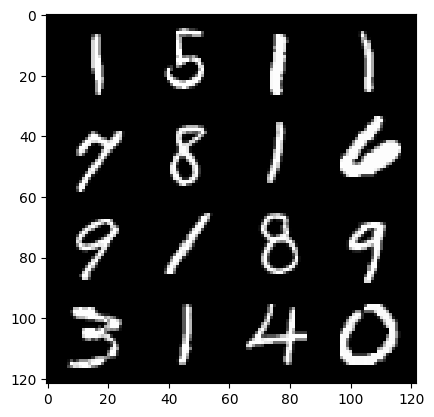

12: step 6000 / Gen loss: 6.966379833221438 / disc_loss: 0.011433203687580933


  0%|          | 0/469 [00:00<?, ?it/s]

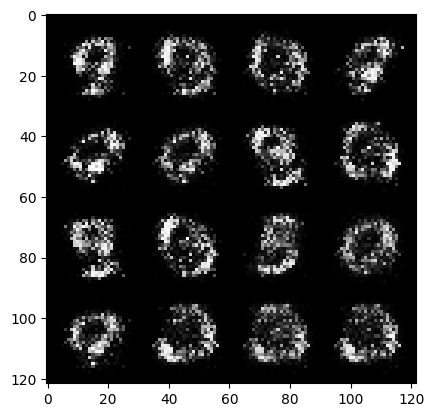

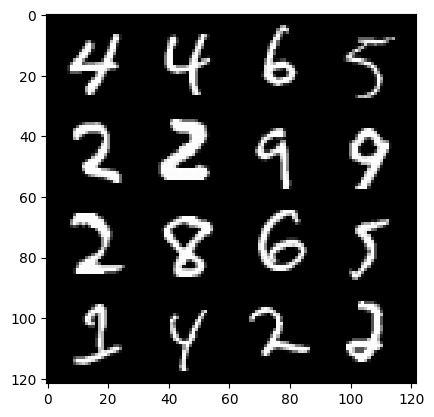

13: step 6300 / Gen loss: 6.780955060323075 / disc_loss: 0.01187707321330284


  0%|          | 0/469 [00:00<?, ?it/s]

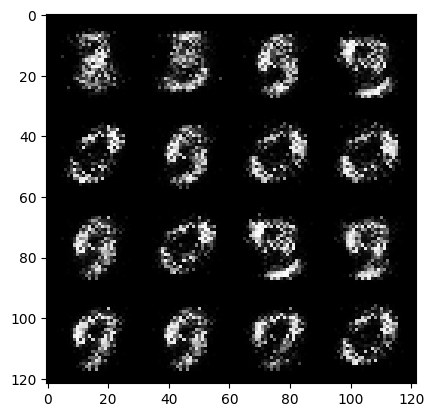

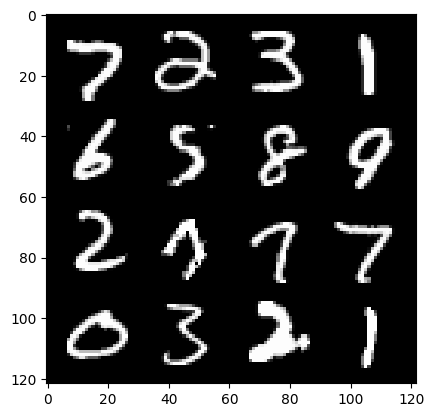

14: step 6600 / Gen loss: 6.165147984822591 / disc_loss: 0.013248122298779587


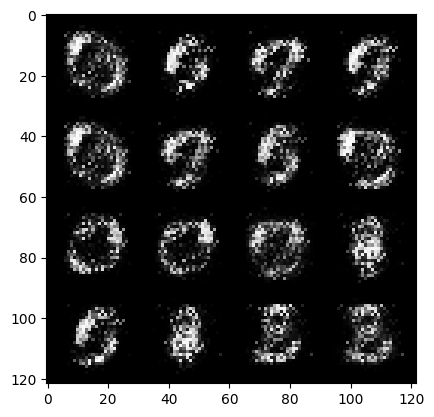

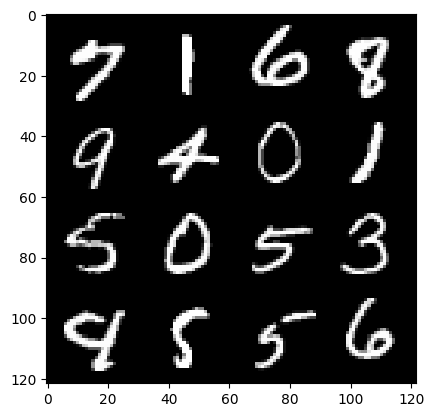

14: step 6900 / Gen loss: 6.2399062712987226 / disc_loss: 0.012907665314463291


  0%|          | 0/469 [00:00<?, ?it/s]

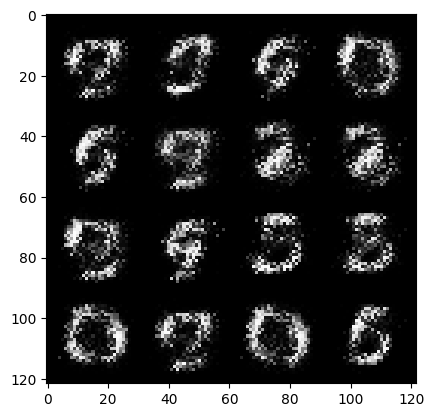

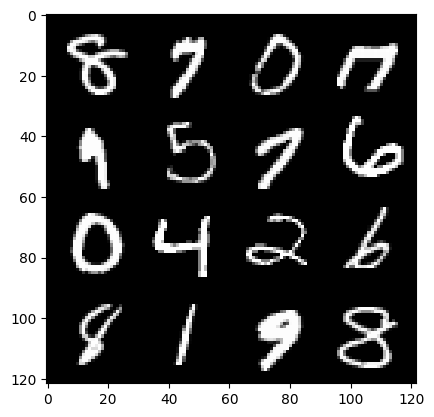

15: step 7200 / Gen loss: 6.597784926096601 / disc_loss: 0.010338697384577248


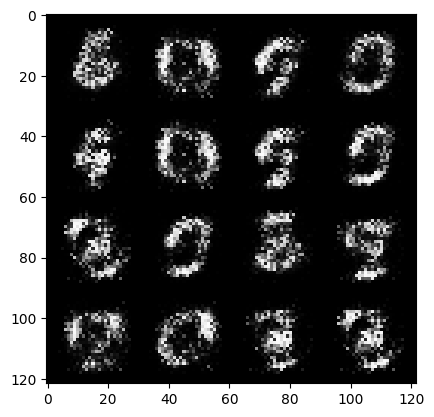

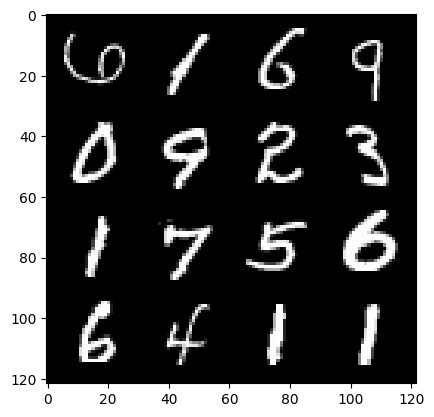

15: step 7500 / Gen loss: 6.900535004933677 / disc_loss: 0.009618318542682872


  0%|          | 0/469 [00:00<?, ?it/s]

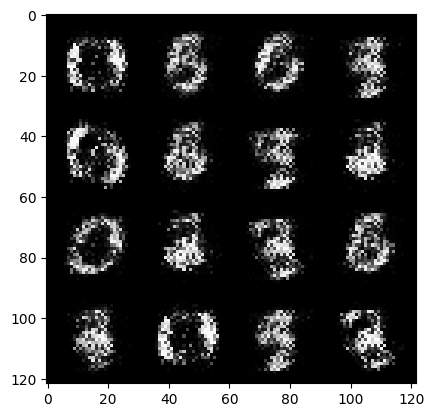

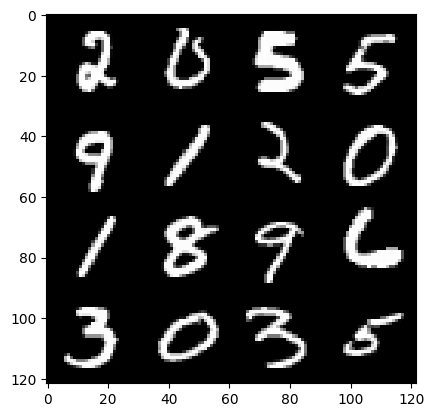

16: step 7800 / Gen loss: 6.760117011070253 / disc_loss: 0.01009327390269998


  0%|          | 0/469 [00:00<?, ?it/s]

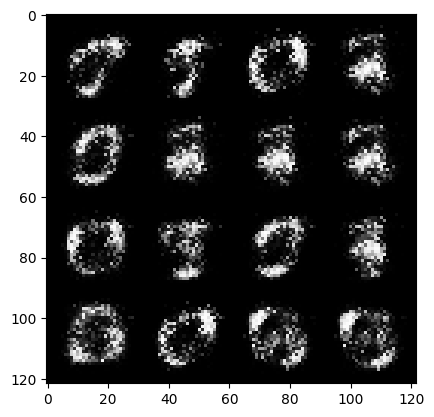

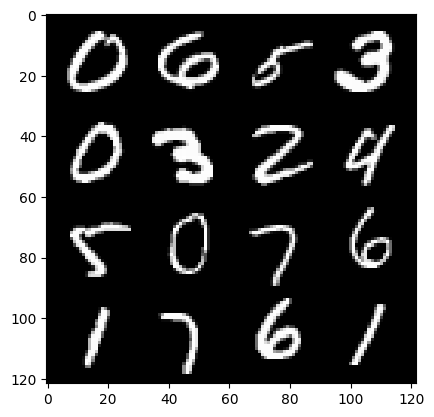

17: step 8100 / Gen loss: 7.046213332811992 / disc_loss: 0.01025755127736678


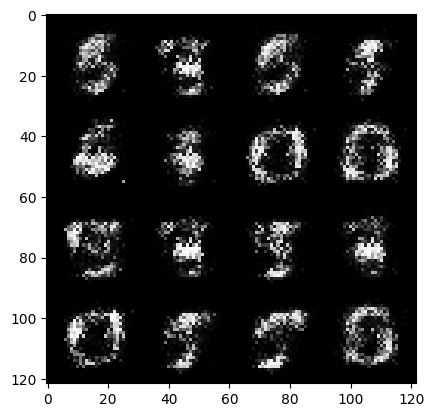

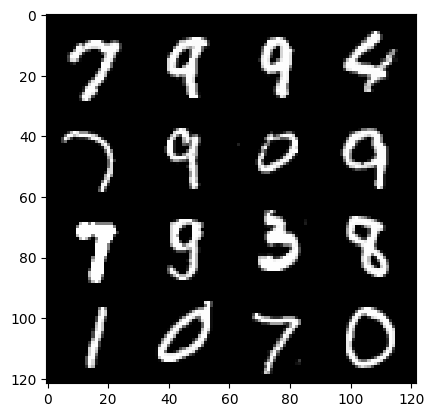

17: step 8400 / Gen loss: 6.61534159819285 / disc_loss: 0.011509078143474957


  0%|          | 0/469 [00:00<?, ?it/s]

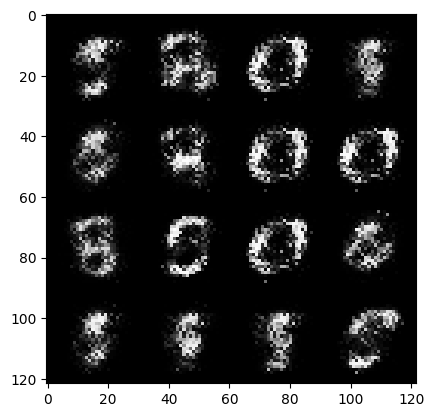

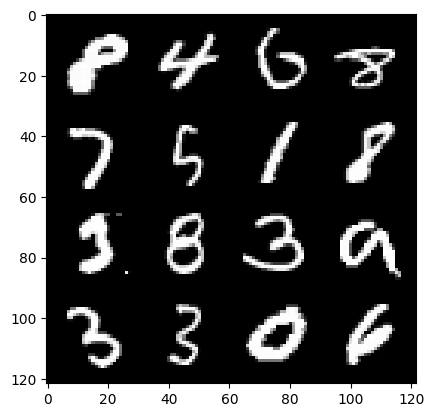

18: step 8700 / Gen loss: 6.737461113929746 / disc_loss: 0.01209341764527684


  0%|          | 0/469 [00:00<?, ?it/s]

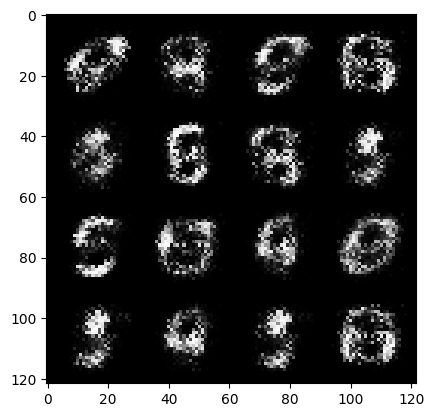

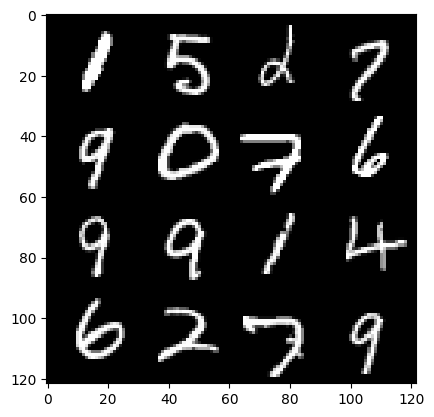

19: step 9000 / Gen loss: 7.005898607571919 / disc_loss: 0.01065321972322029


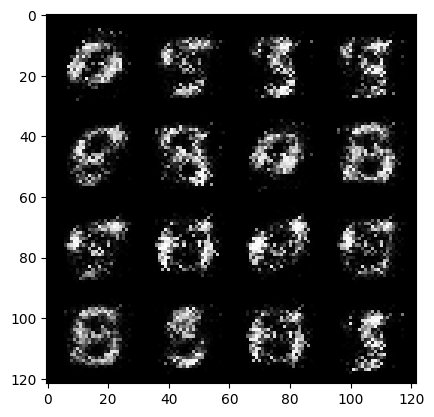

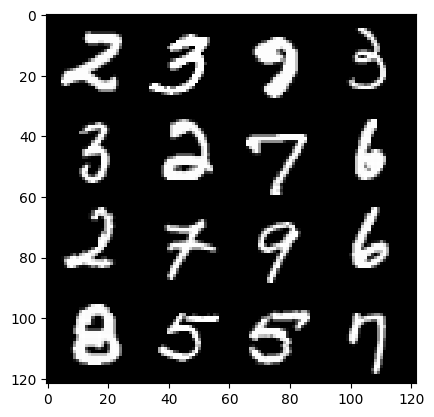

19: step 9300 / Gen loss: 7.224879542986547 / disc_loss: 0.01161494645522908


  0%|          | 0/469 [00:00<?, ?it/s]

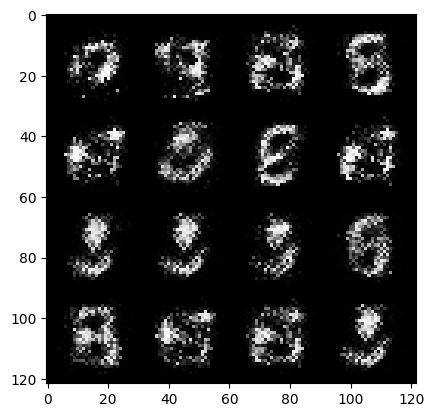

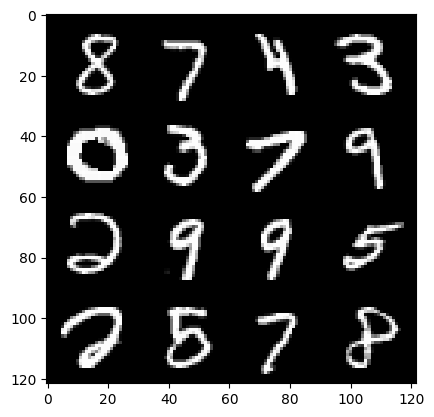

20: step 9600 / Gen loss: 6.866013143857321 / disc_loss: 0.011935127803590148


  0%|          | 0/469 [00:00<?, ?it/s]

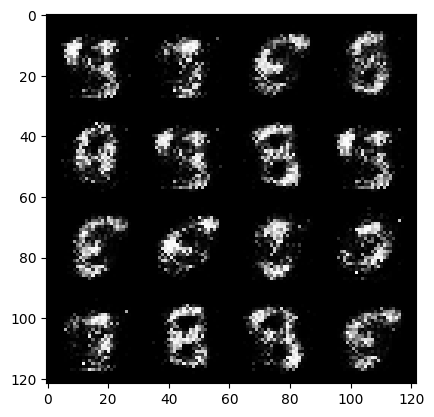

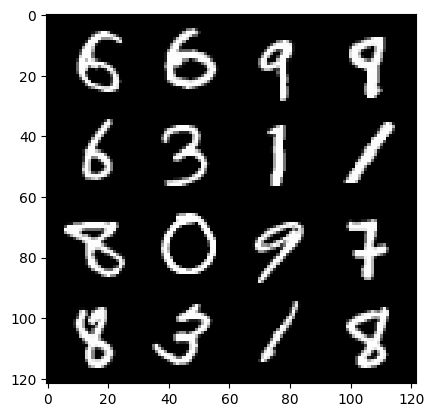

21: step 9900 / Gen loss: 6.727947886784867 / disc_loss: 0.012483330068644135


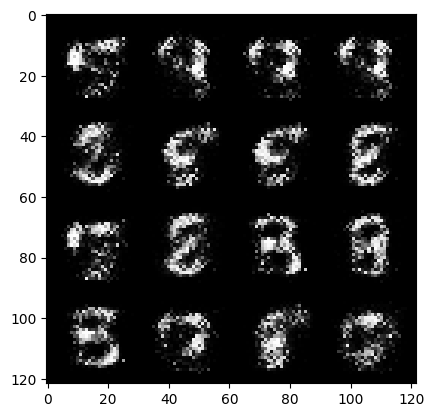

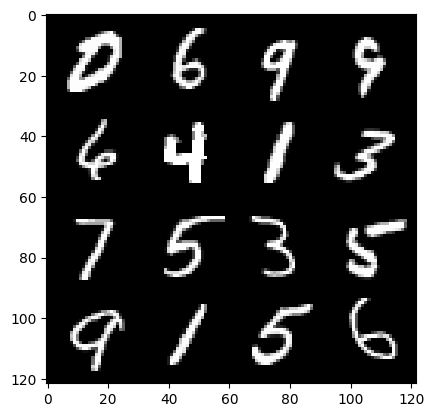

21: step 10200 / Gen loss: 6.503409490585334 / disc_loss: 0.012618133891373874


  0%|          | 0/469 [00:00<?, ?it/s]

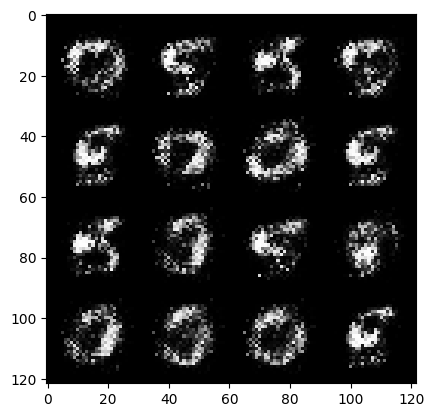

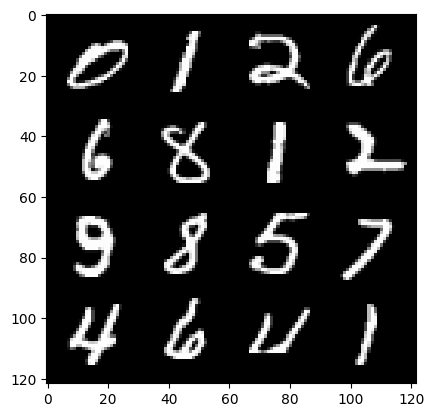

22: step 10500 / Gen loss: 6.495674626032515 / disc_loss: 0.011797703068392968


  0%|          | 0/469 [00:00<?, ?it/s]

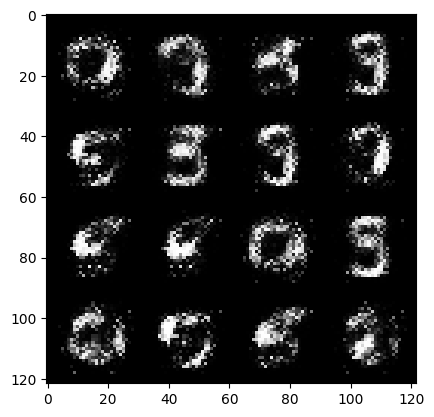

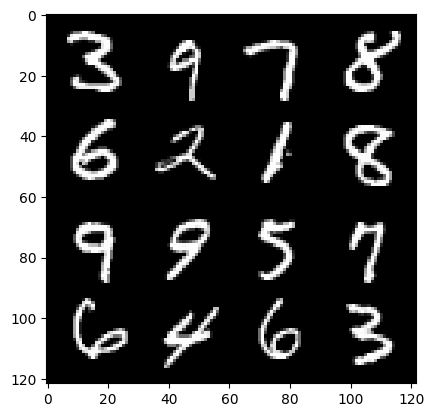

23: step 10800 / Gen loss: 6.530935204823813 / disc_loss: 0.013664269921137024


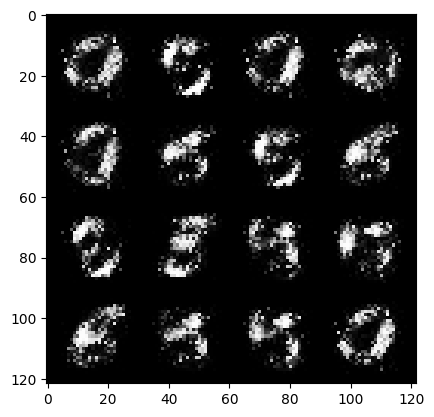

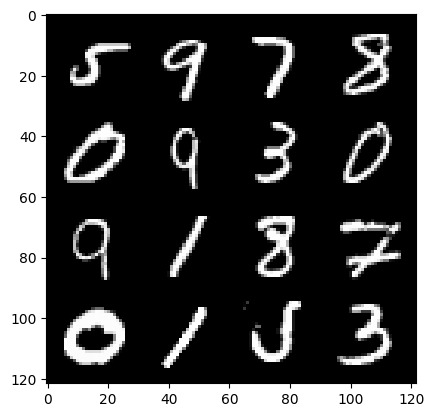

23: step 11100 / Gen loss: 7.254241197903952 / disc_loss: 0.013532195989973848


  0%|          | 0/469 [00:00<?, ?it/s]

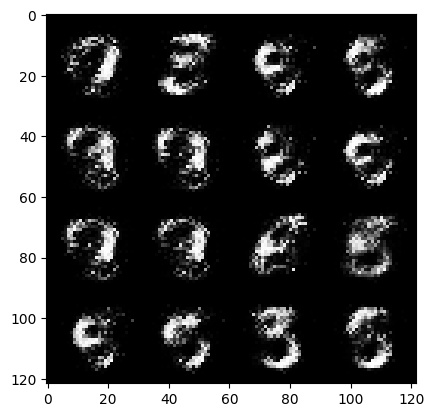

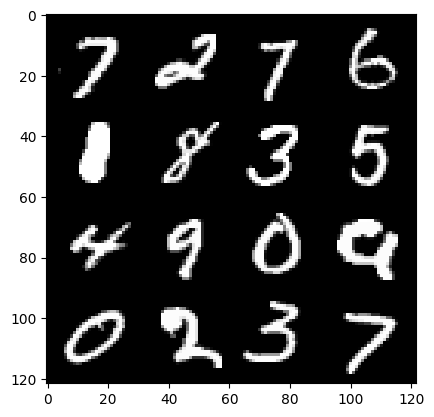

24: step 11400 / Gen loss: 7.26170069694519 / disc_loss: 0.012277046740831191


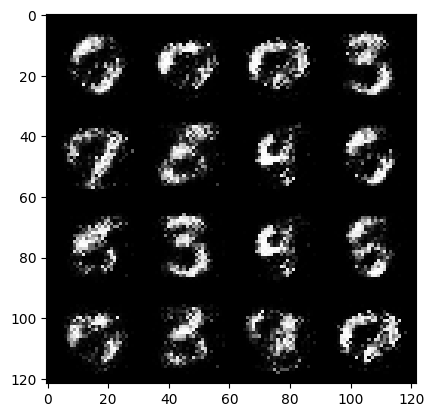

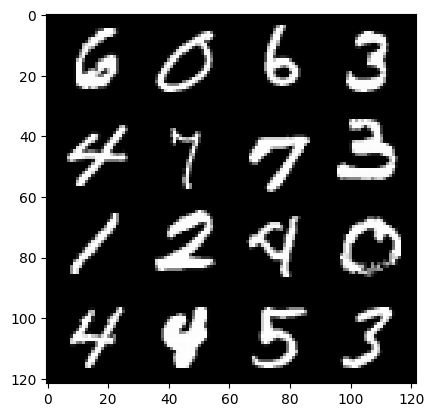

24: step 11700 / Gen loss: 7.204991173744202 / disc_loss: 0.011450034973677243


  0%|          | 0/469 [00:00<?, ?it/s]

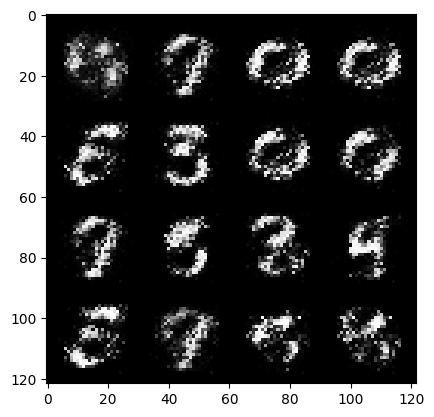

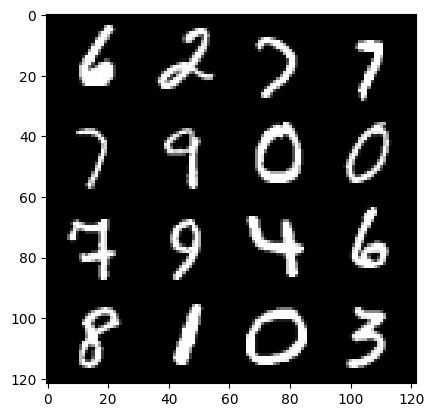

25: step 12000 / Gen loss: 7.241725711822503 / disc_loss: 0.01123475003056228


  0%|          | 0/469 [00:00<?, ?it/s]

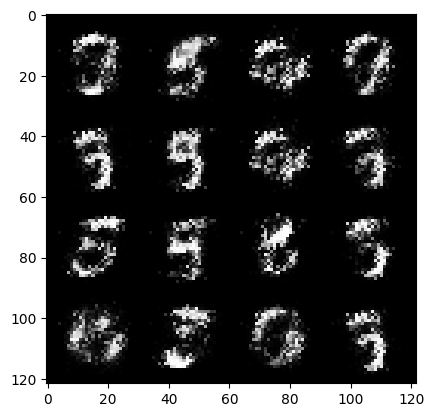

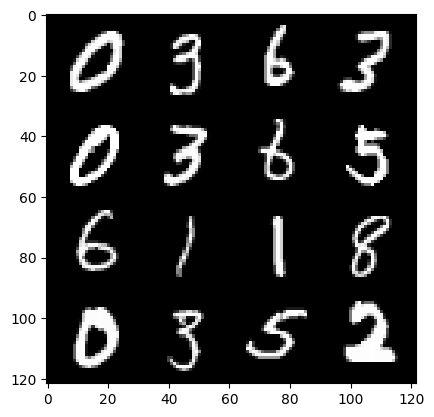

26: step 12300 / Gen loss: 7.235078210830692 / disc_loss: 0.014159278292985017


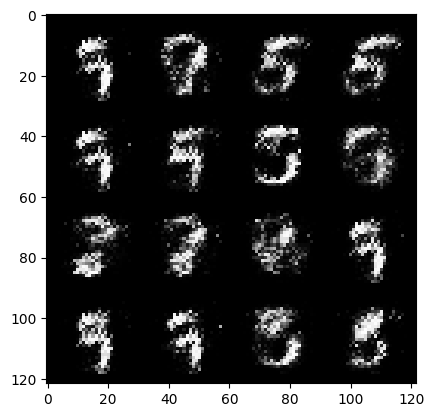

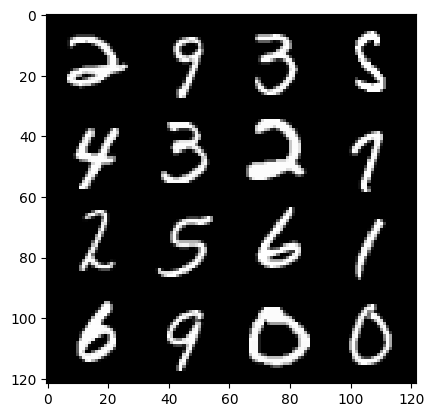

26: step 12600 / Gen loss: 7.085985070864361 / disc_loss: 0.013337797540783267


  0%|          | 0/469 [00:00<?, ?it/s]

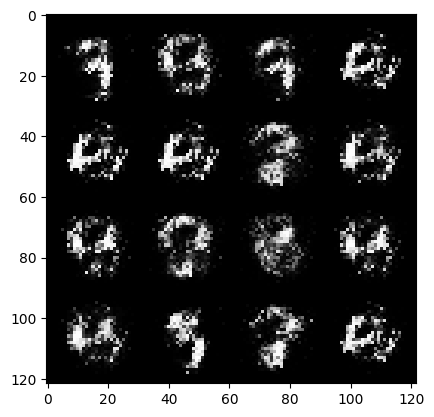

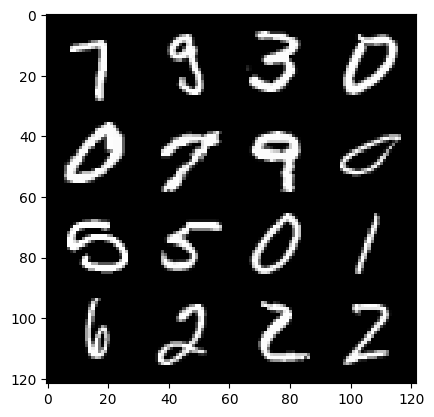

27: step 12900 / Gen loss: 7.096185962359108 / disc_loss: 0.01455308065904926


  0%|          | 0/469 [00:00<?, ?it/s]

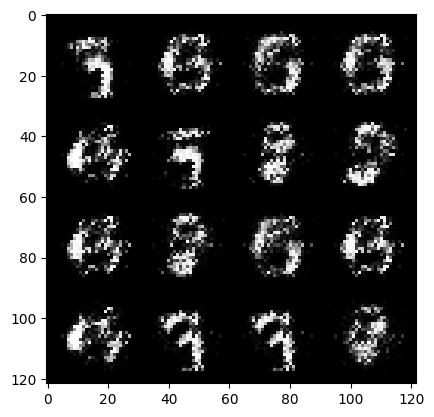

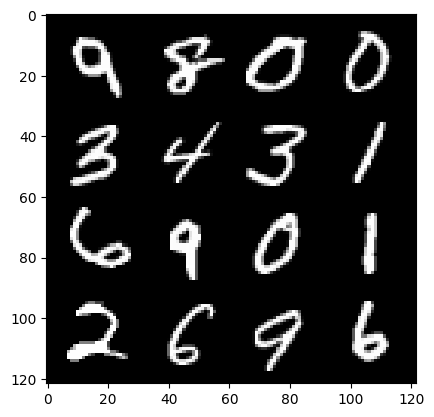

28: step 13200 / Gen loss: 6.9719961531956915 / disc_loss: 0.014751907569201049


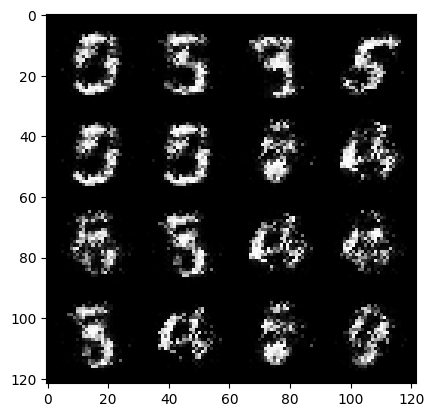

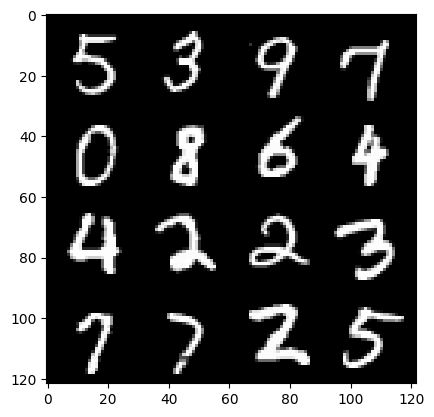

28: step 13500 / Gen loss: 6.837492432594302 / disc_loss: 0.01505054938141256


  0%|          | 0/469 [00:00<?, ?it/s]

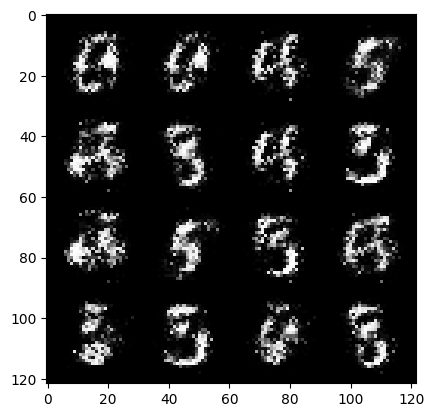

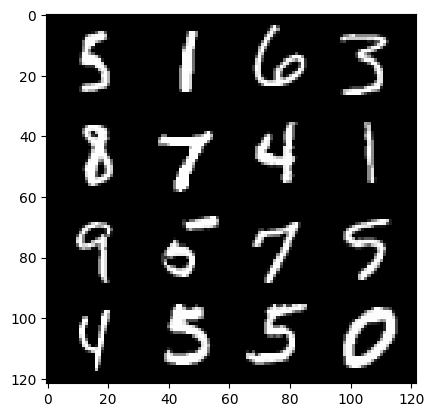

29: step 13800 / Gen loss: 6.687067200342815 / disc_loss: 0.019834339002457763


  0%|          | 0/469 [00:00<?, ?it/s]

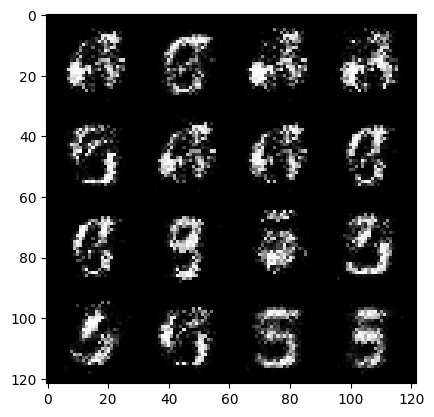

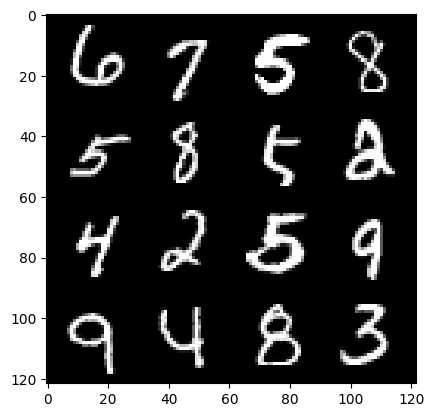

30: step 14100 / Gen loss: 6.718903193473811 / disc_loss: 0.022704179489519426


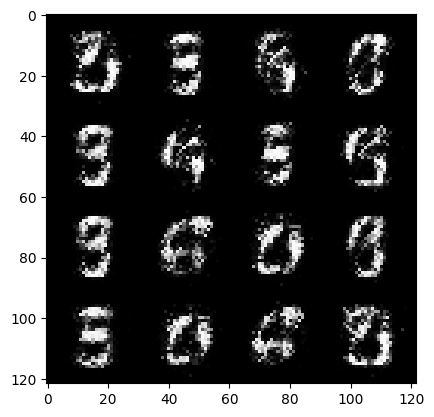

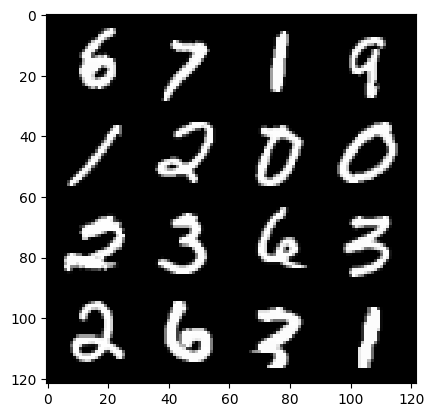

30: step 14400 / Gen loss: 6.257963164647423 / disc_loss: 0.02512573482856773


  0%|          | 0/469 [00:00<?, ?it/s]

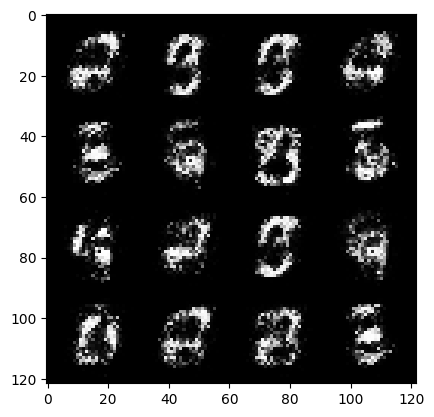

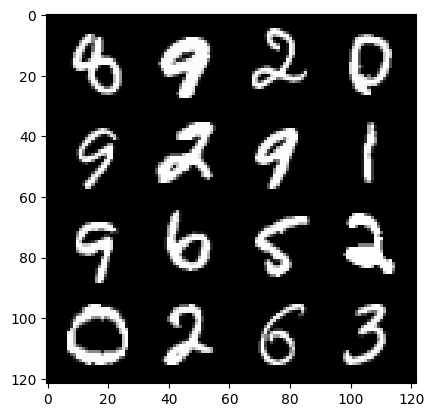

31: step 14700 / Gen loss: 6.537047915458675 / disc_loss: 0.023715761941857642


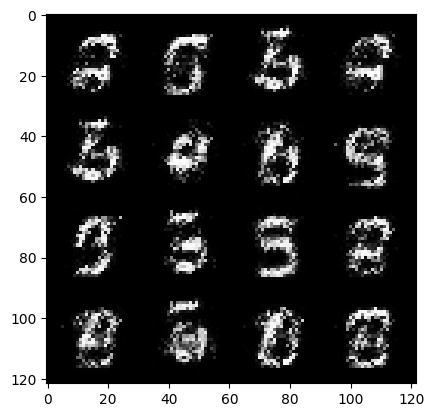

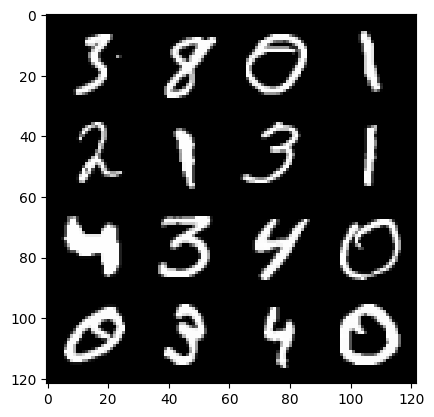

31: step 15000 / Gen loss: 6.305946847597759 / disc_loss: 0.022014547803749635


  0%|          | 0/469 [00:00<?, ?it/s]

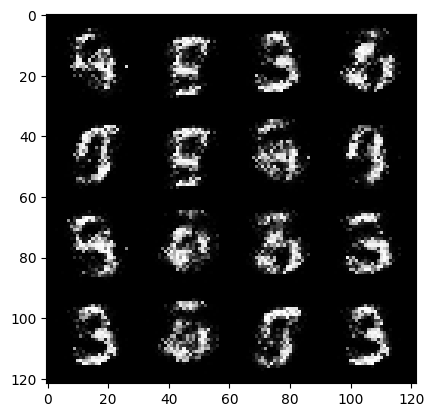

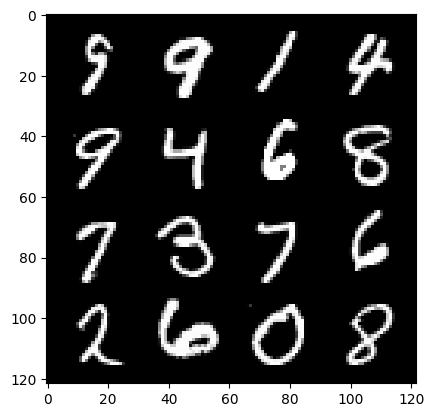

32: step 15300 / Gen loss: 6.374781045913697 / disc_loss: 0.02176152640022337


  0%|          | 0/469 [00:00<?, ?it/s]

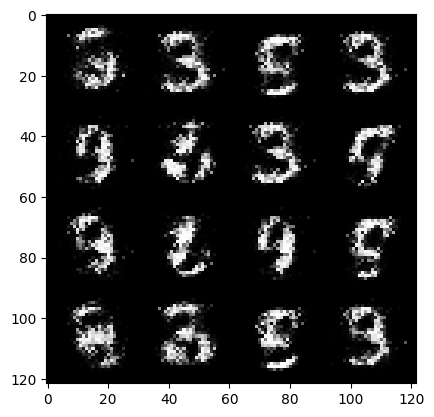

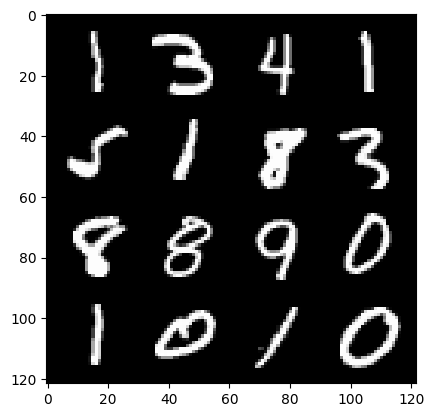

33: step 15600 / Gen loss: 6.254090755780531 / disc_loss: 0.022083156961792465


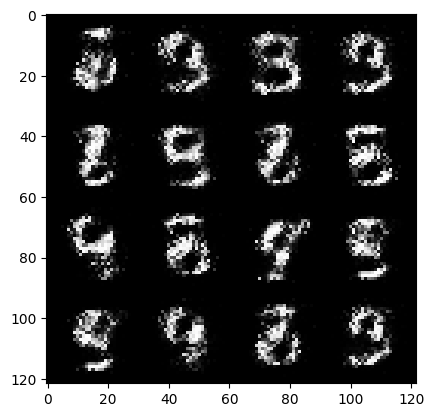

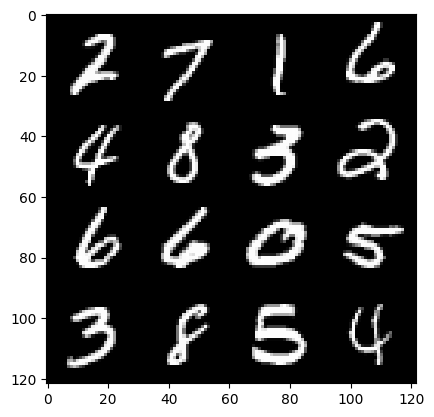

33: step 15900 / Gen loss: 6.717589823404947 / disc_loss: 0.02176614861004052


  0%|          | 0/469 [00:00<?, ?it/s]

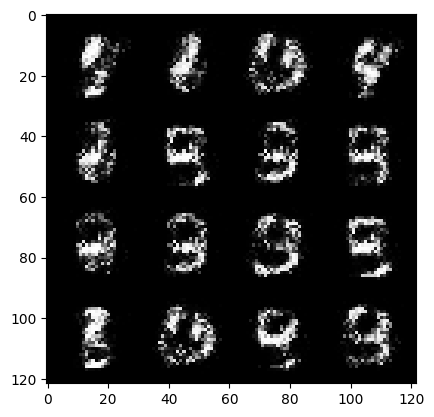

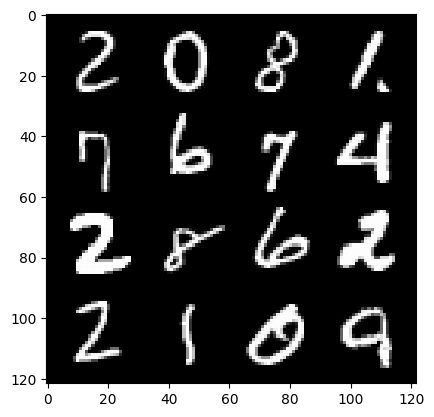

34: step 16200 / Gen loss: 6.833117616971334 / disc_loss: 0.020274356890780224


  0%|          | 0/469 [00:00<?, ?it/s]

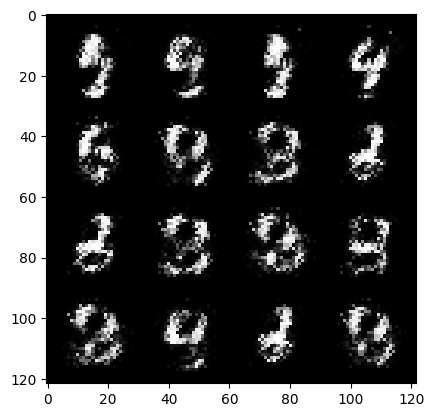

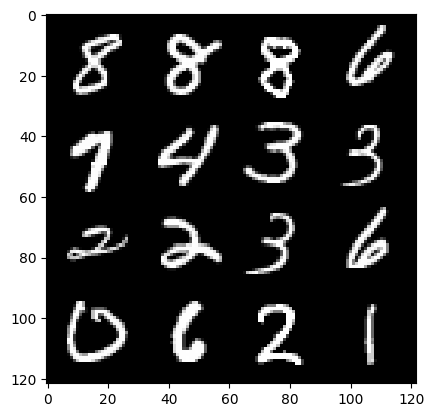

35: step 16500 / Gen loss: 6.934201005299882 / disc_loss: 0.020800134993623935


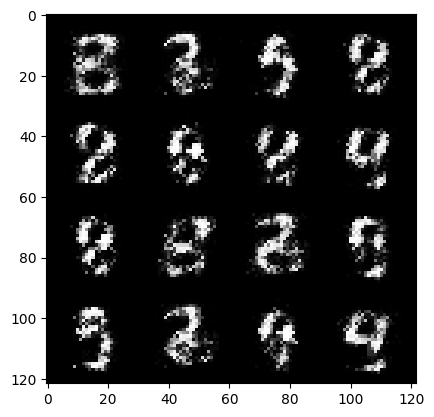

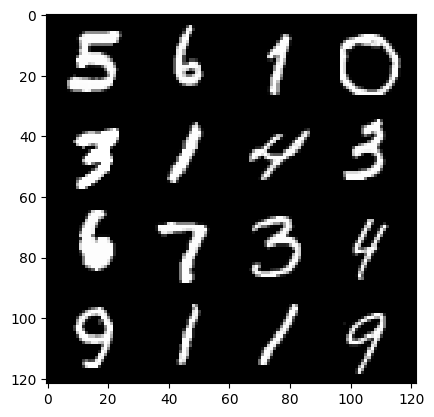

35: step 16800 / Gen loss: 6.458063705762224 / disc_loss: 0.025841187909245476


  0%|          | 0/469 [00:00<?, ?it/s]

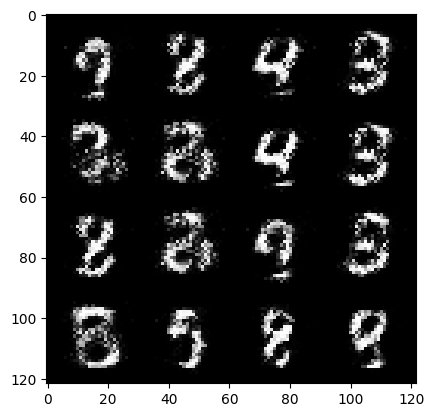

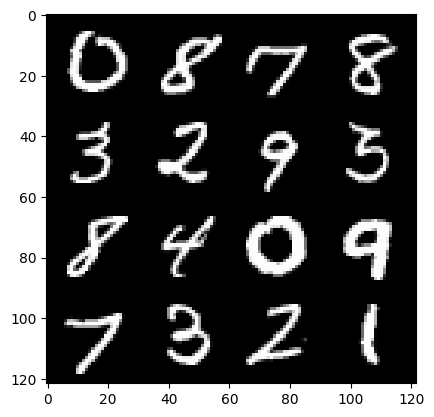

36: step 17100 / Gen loss: 6.215661045710247 / disc_loss: 0.027419110210612434


  0%|          | 0/469 [00:00<?, ?it/s]

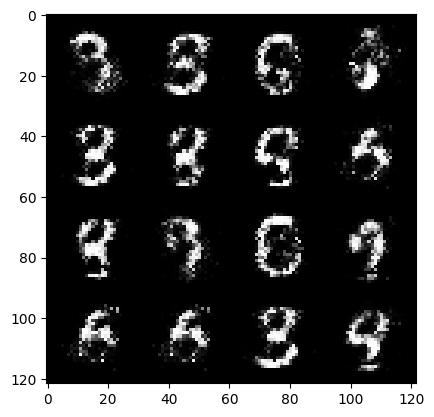

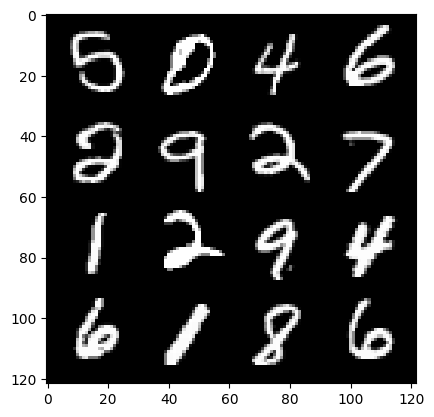

37: step 17400 / Gen loss: 6.258354531923931 / disc_loss: 0.026274524178976813


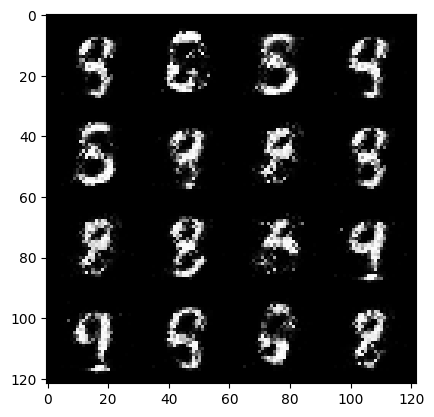

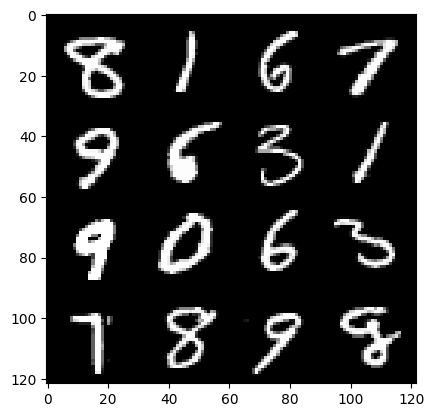

37: step 17700 / Gen loss: 6.1018889109293575 / disc_loss: 0.02928821821076175


  0%|          | 0/469 [00:00<?, ?it/s]

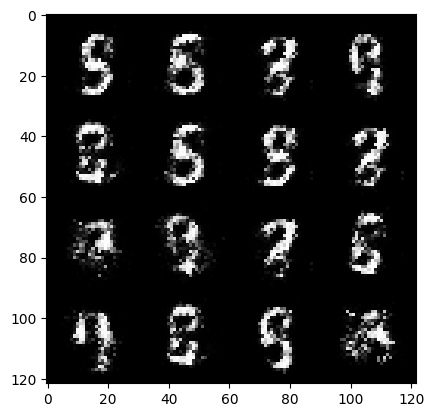

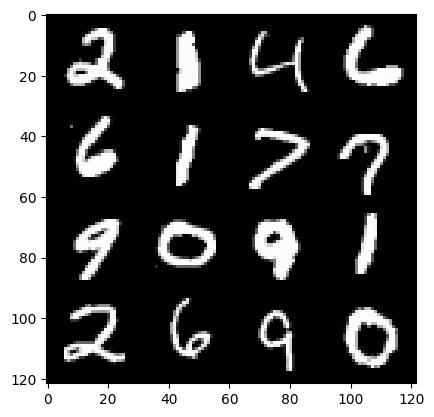

38: step 18000 / Gen loss: 6.09990827719371 / disc_loss: 0.030189645166198407


  0%|          | 0/469 [00:00<?, ?it/s]

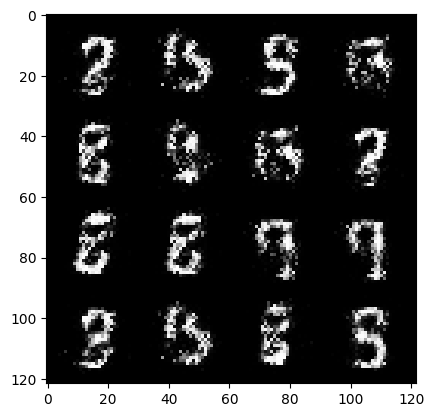

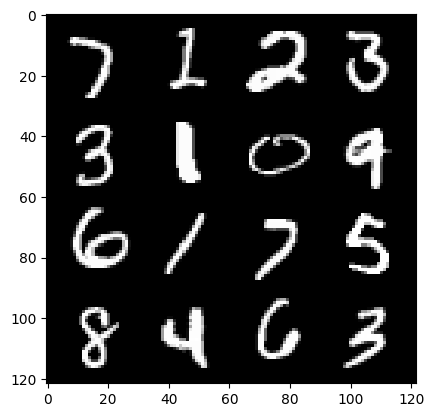

39: step 18300 / Gen loss: 5.987889202435811 / disc_loss: 0.02538131217472254


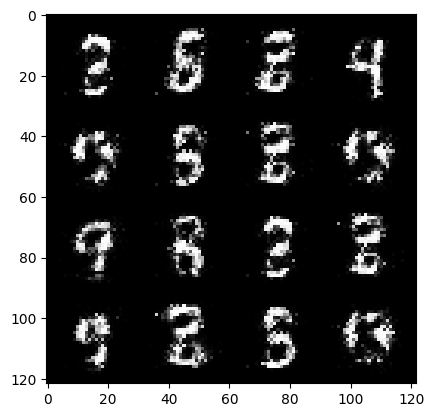

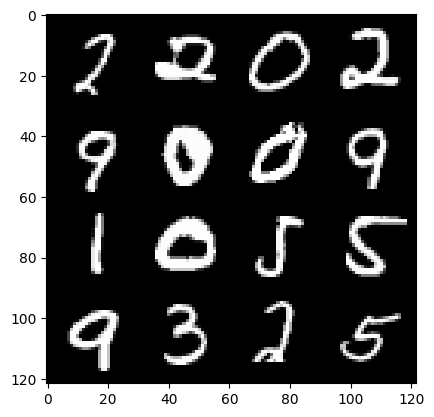

39: step 18600 / Gen loss: 5.8710320075353 / disc_loss: 0.02452148434706031


  0%|          | 0/469 [00:00<?, ?it/s]

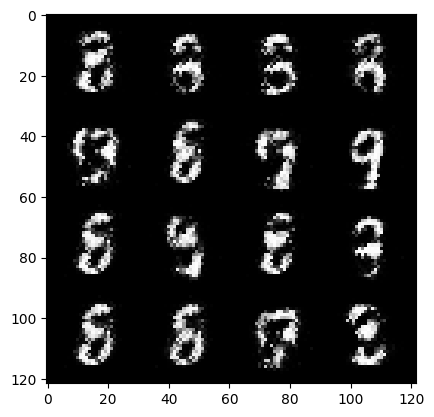

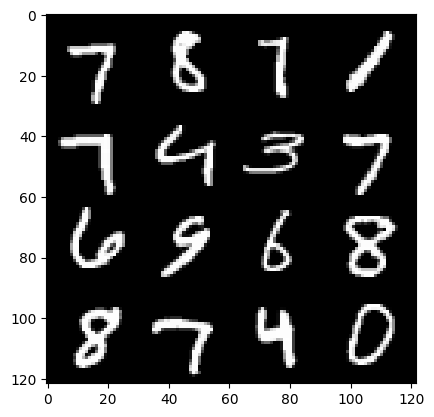

40: step 18900 / Gen loss: 5.64626449267069 / disc_loss: 0.03442961775076885


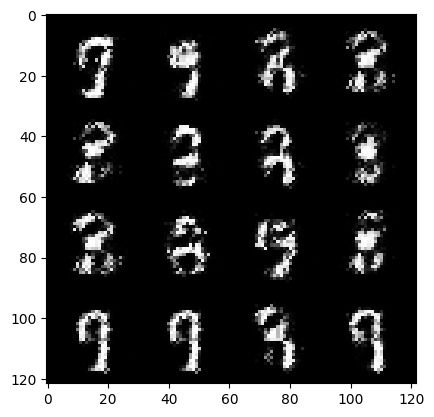

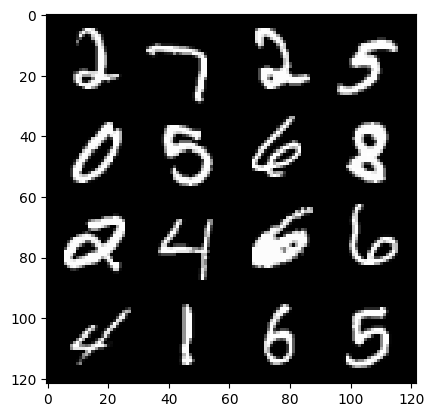

40: step 19200 / Gen loss: 5.5895795551935885 / disc_loss: 0.034922617889630296


  0%|          | 0/469 [00:00<?, ?it/s]

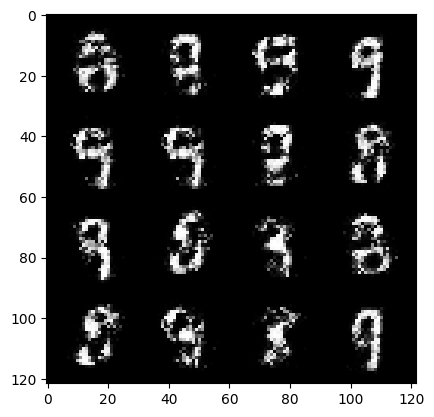

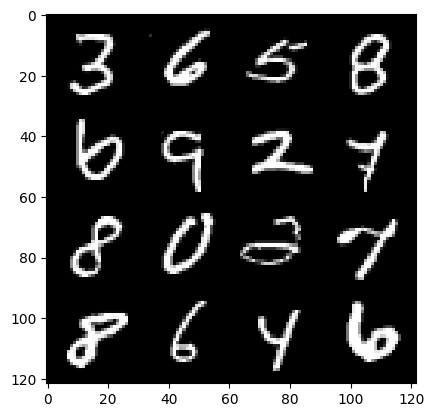

41: step 19500 / Gen loss: 5.625941804250076 / disc_loss: 0.03518035988944272


  0%|          | 0/469 [00:00<?, ?it/s]

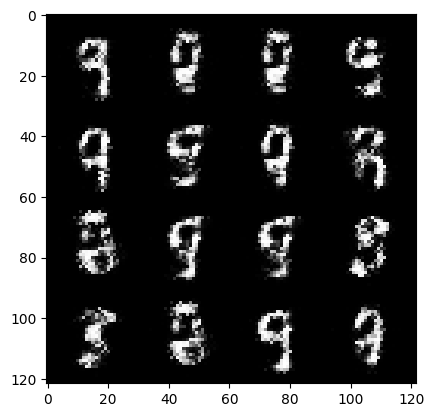

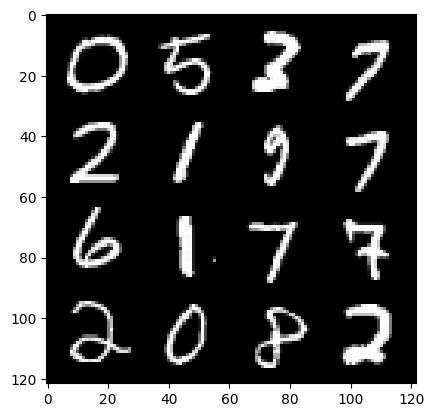

42: step 19800 / Gen loss: 5.701895403862002 / disc_loss: 0.041382946937034544


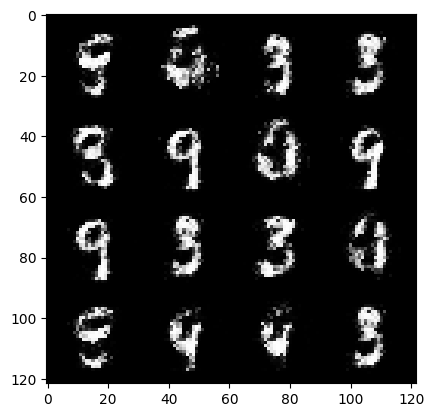

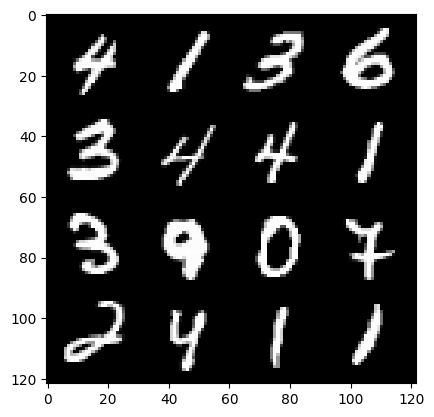

42: step 20100 / Gen loss: 5.496030616760261 / disc_loss: 0.04414727296369769


  0%|          | 0/469 [00:00<?, ?it/s]

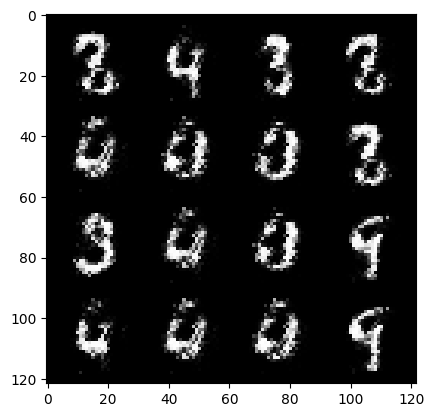

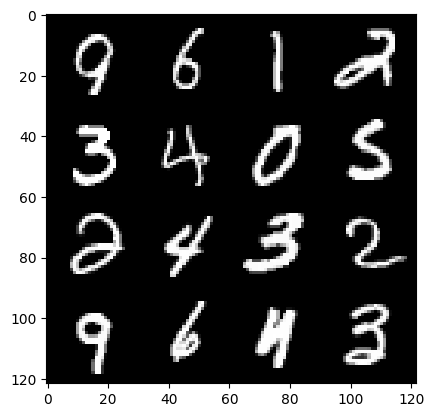

43: step 20400 / Gen loss: 5.752127866744993 / disc_loss: 0.03686785720443976


  0%|          | 0/469 [00:00<?, ?it/s]

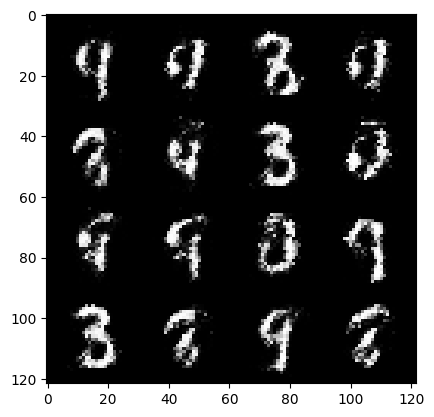

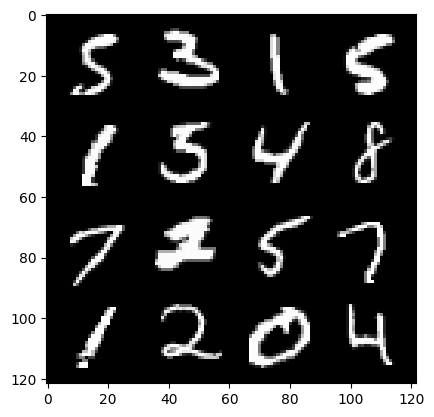

44: step 20700 / Gen loss: 5.585659635861716 / disc_loss: 0.04077565593334532


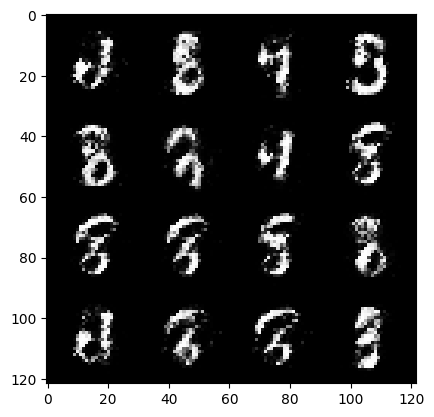

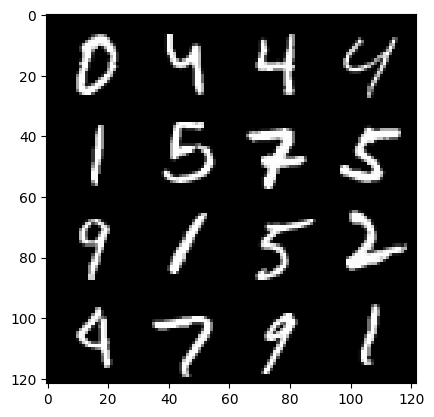

44: step 21000 / Gen loss: 5.415319941838577 / disc_loss: 0.03995861289557071


  0%|          | 0/469 [00:00<?, ?it/s]

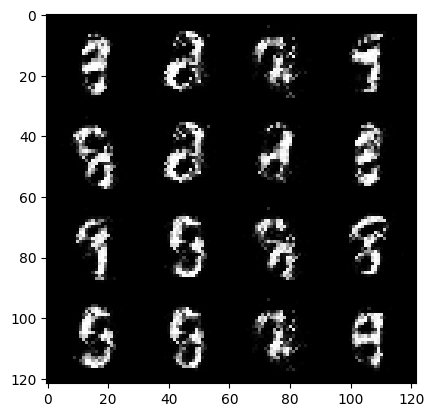

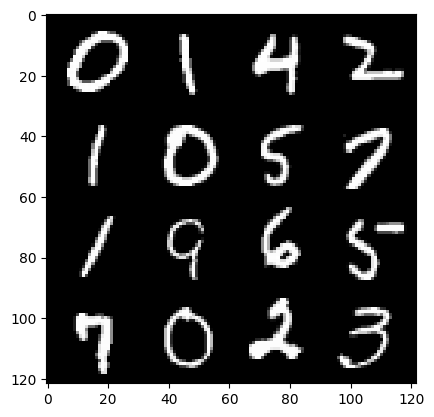

45: step 21300 / Gen loss: 5.47682257970174 / disc_loss: 0.0435357599550237


  0%|          | 0/469 [00:00<?, ?it/s]

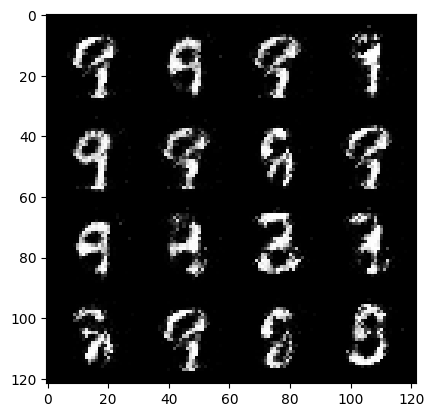

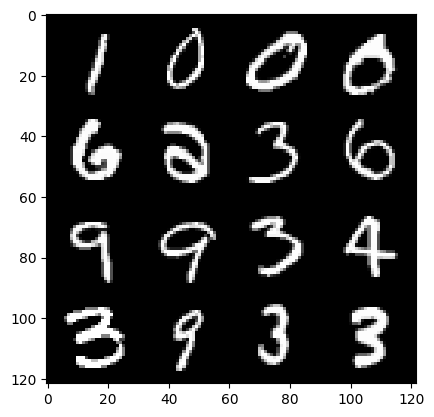

46: step 21600 / Gen loss: 5.660401059786476 / disc_loss: 0.043203709839532776


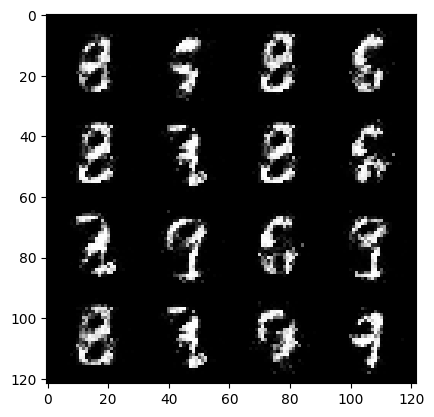

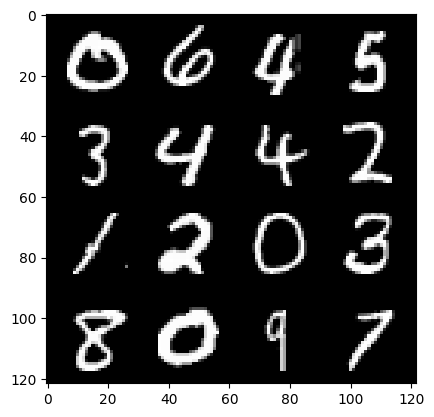

46: step 21900 / Gen loss: 5.376366801261899 / disc_loss: 0.04633887043533226


  0%|          | 0/469 [00:00<?, ?it/s]

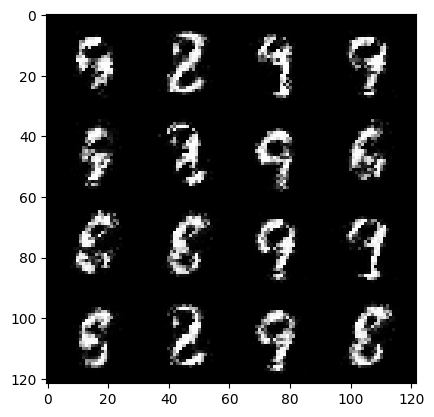

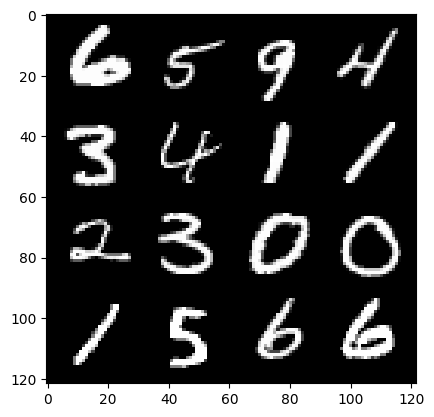

47: step 22200 / Gen loss: 5.39896882692973 / disc_loss: 0.040741382691388356


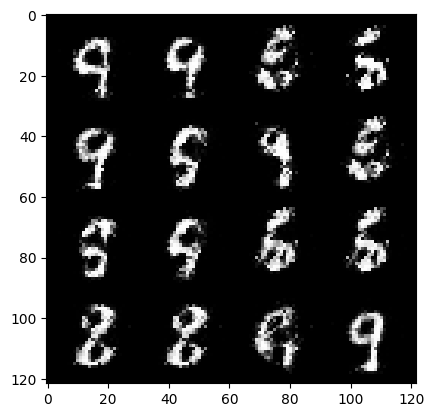

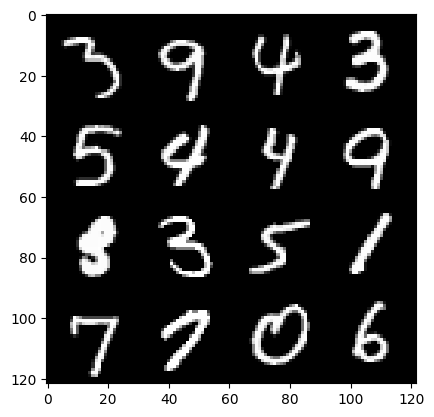

47: step 22500 / Gen loss: 5.502234775225318 / disc_loss: 0.03973172722073892


  0%|          | 0/469 [00:00<?, ?it/s]

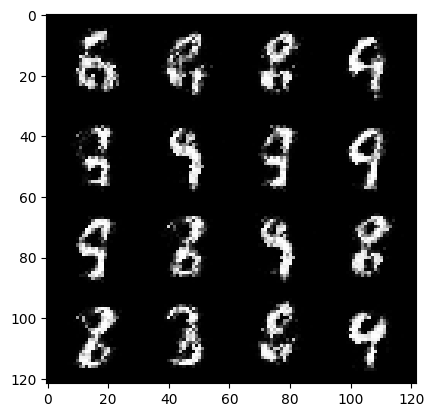

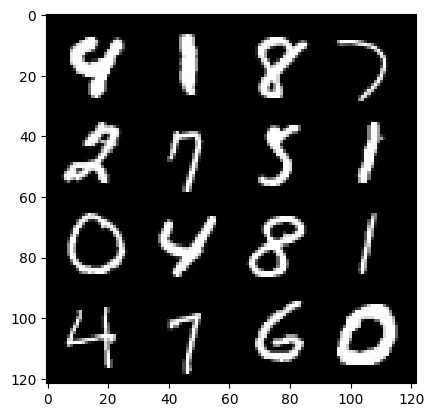

48: step 22800 / Gen loss: 5.30976202487946 / disc_loss: 0.045229603030408426


  0%|          | 0/469 [00:00<?, ?it/s]

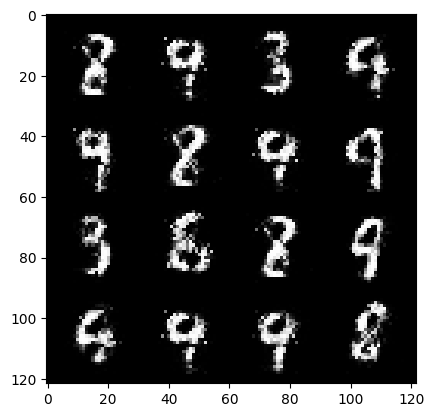

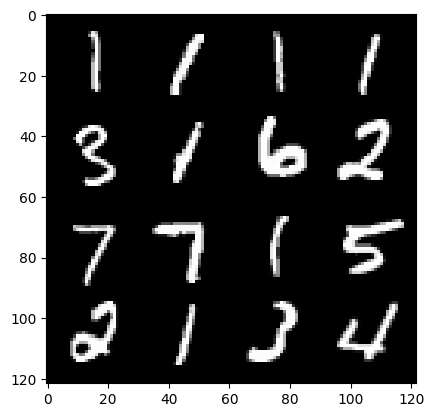

49: step 23100 / Gen loss: 5.342452133496603 / disc_loss: 0.05378198694127301


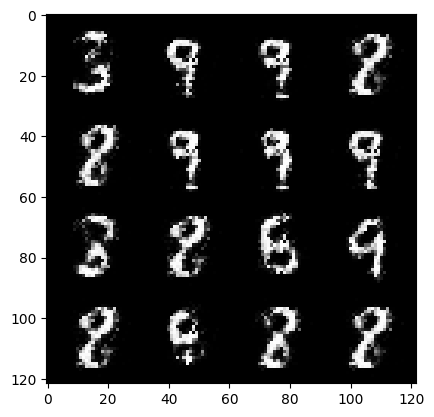

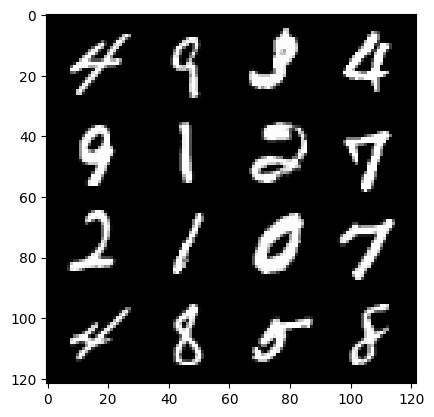

49: step 23400 / Gen loss: 5.5199282121658335 / disc_loss: 0.05660858634859321


  0%|          | 0/469 [00:00<?, ?it/s]

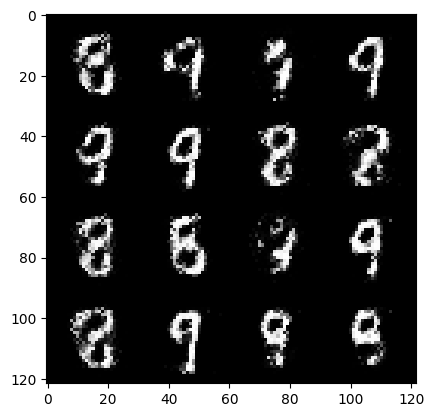

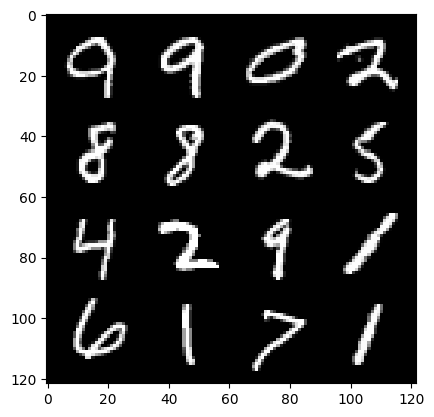

50: step 23700 / Gen loss: 5.219415102799732 / disc_loss: 0.04874778886636097


  0%|          | 0/469 [00:00<?, ?it/s]

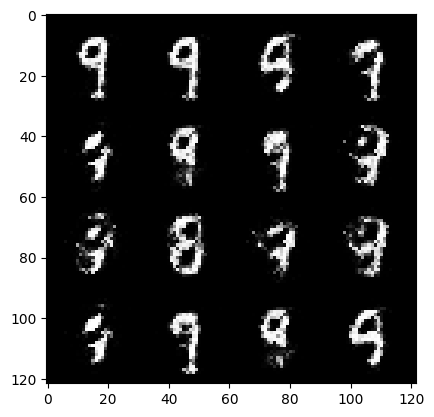

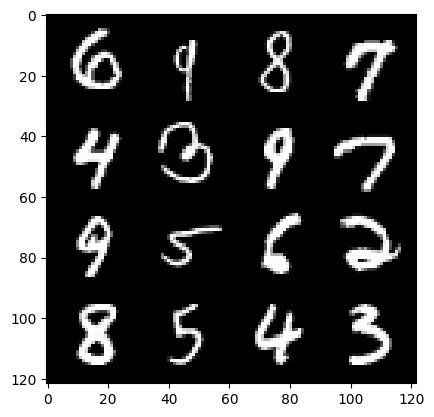

51: step 24000 / Gen loss: 5.25726031780243 / disc_loss: 0.050489426692947766


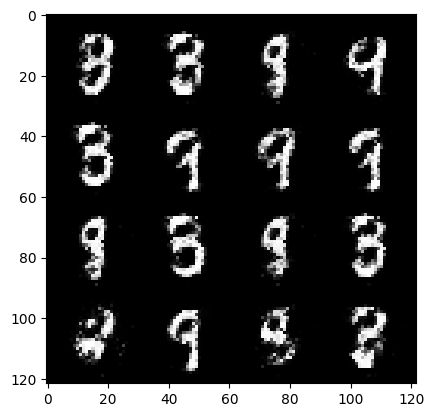

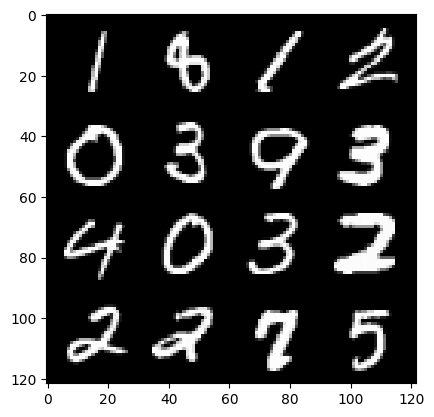

51: step 24300 / Gen loss: 5.263617951869965 / disc_loss: 0.05856778686245282


  0%|          | 0/469 [00:00<?, ?it/s]

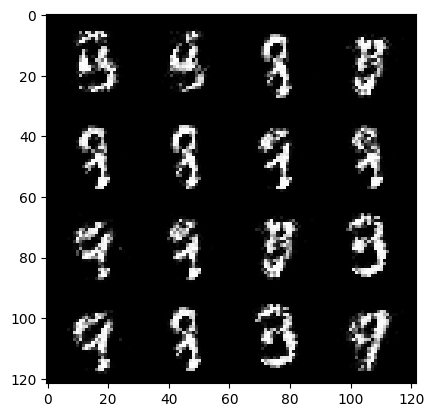

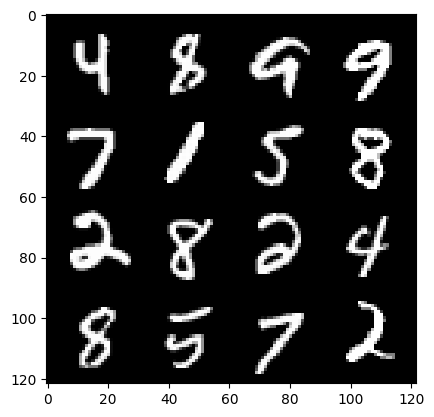

52: step 24600 / Gen loss: 4.880117276509604 / disc_loss: 0.06304212911054488


  0%|          | 0/469 [00:00<?, ?it/s]

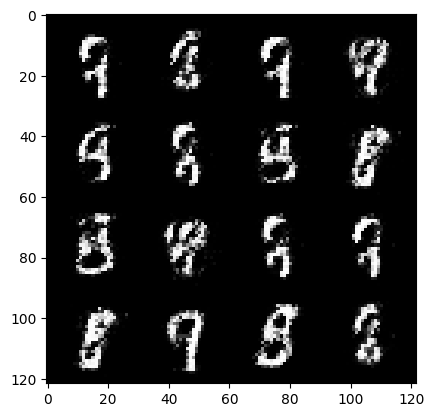

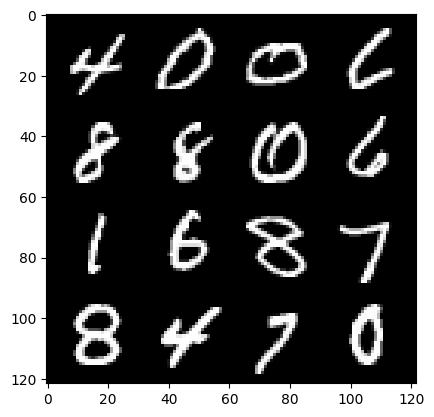

53: step 24900 / Gen loss: 5.095312497615816 / disc_loss: 0.05490754197972518


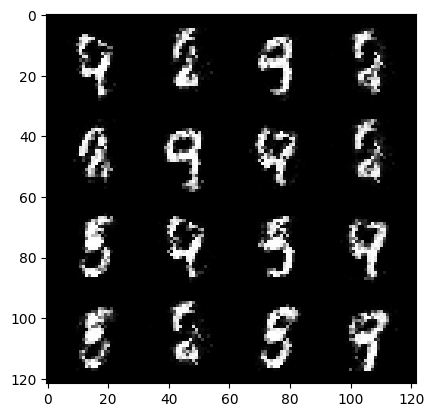

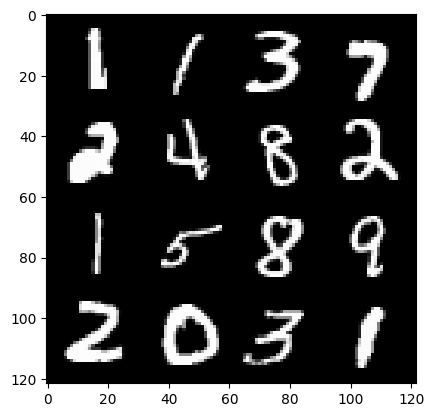

53: step 25200 / Gen loss: 5.1256216112772615 / disc_loss: 0.06059686119978628


  0%|          | 0/469 [00:00<?, ?it/s]

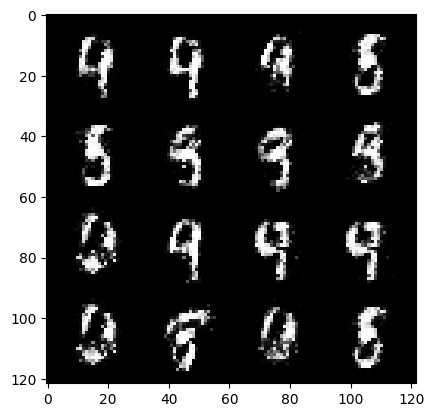

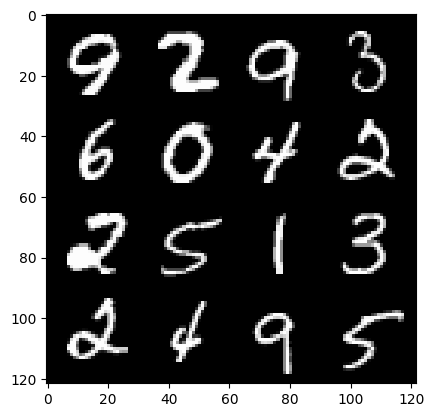

54: step 25500 / Gen loss: 5.041324760913847 / disc_loss: 0.05606455397481719


  0%|          | 0/469 [00:00<?, ?it/s]

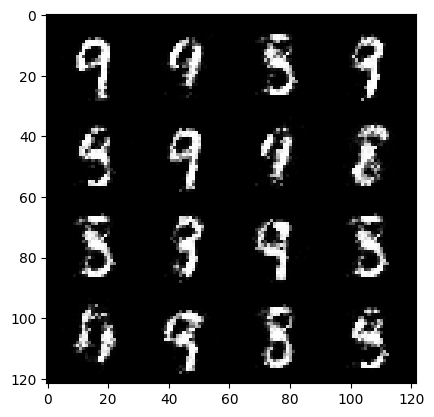

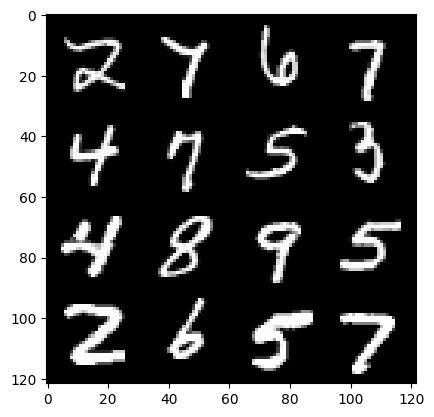

55: step 25800 / Gen loss: 5.243326981067657 / disc_loss: 0.06258615677555399


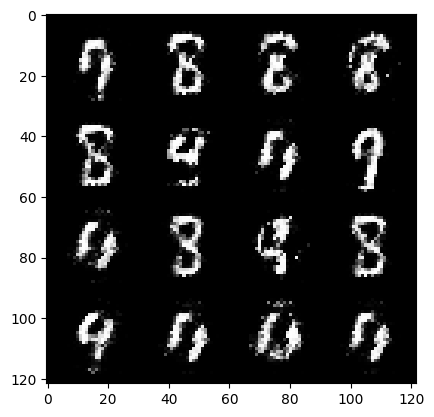

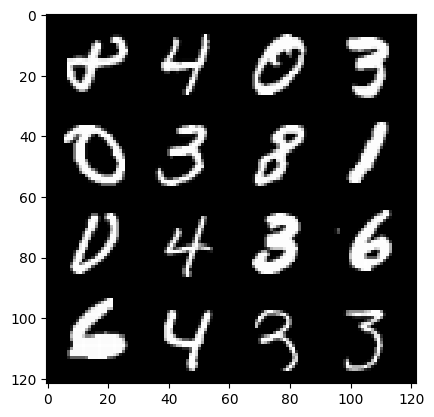

55: step 26100 / Gen loss: 4.837485979398092 / disc_loss: 0.06530683617418012


  0%|          | 0/469 [00:00<?, ?it/s]

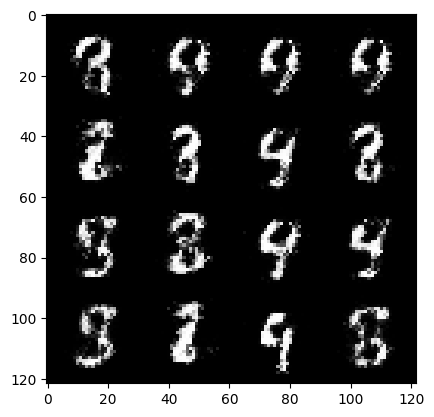

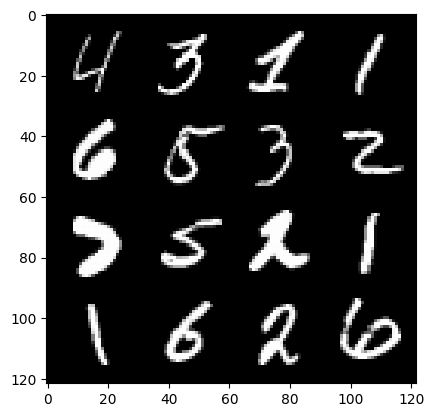

56: step 26400 / Gen loss: 4.77623497962952 / disc_loss: 0.08070384328253563


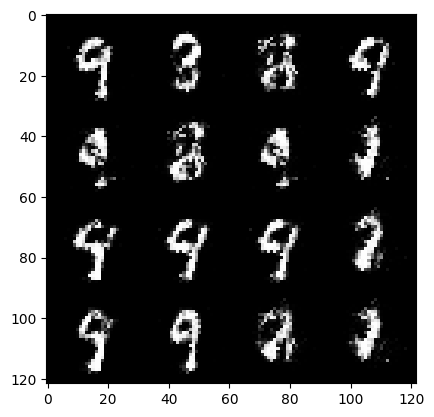

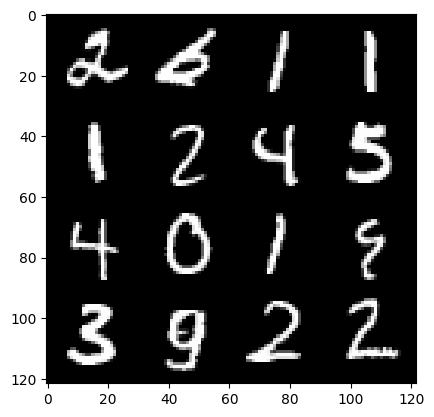

56: step 26700 / Gen loss: 4.622627038160959 / disc_loss: 0.07438512085316082


  0%|          | 0/469 [00:00<?, ?it/s]

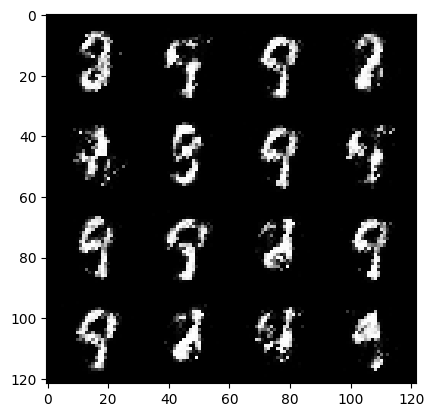

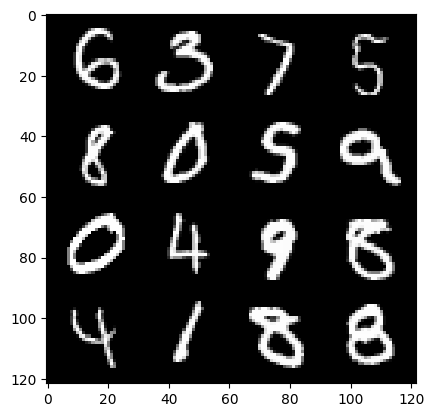

57: step 27000 / Gen loss: 4.9618251816431655 / disc_loss: 0.0536282176493357


  0%|          | 0/469 [00:00<?, ?it/s]

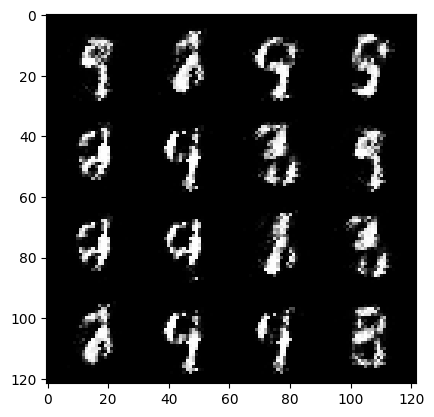

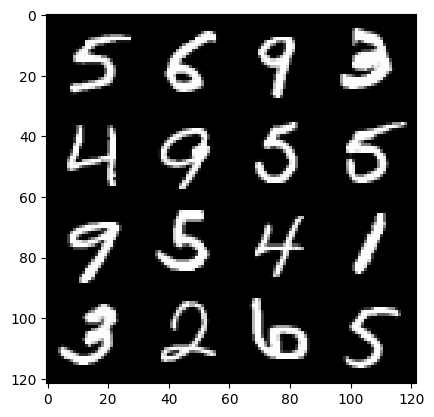

58: step 27300 / Gen loss: 5.209981560707091 / disc_loss: 0.057483503573263664


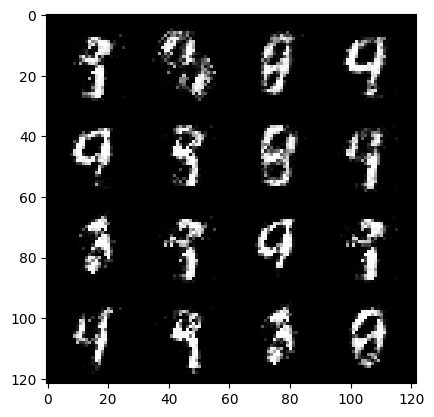

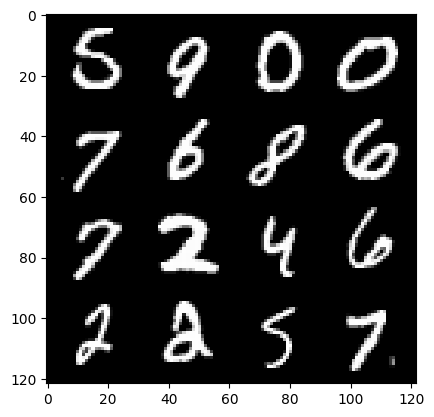

58: step 27600 / Gen loss: 5.093020884990692 / disc_loss: 0.05934096209394433


  0%|          | 0/469 [00:00<?, ?it/s]

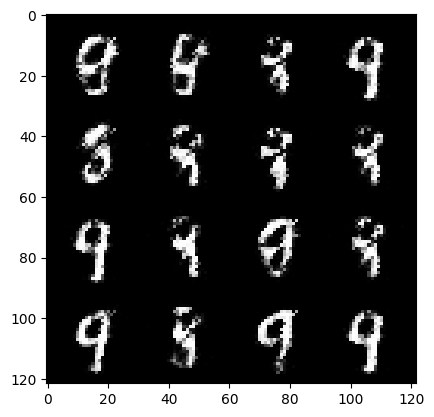

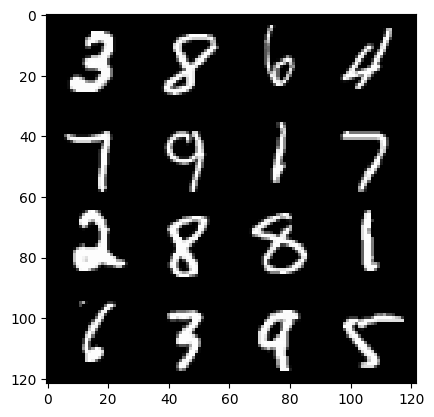

59: step 27900 / Gen loss: 4.9100760030746455 / disc_loss: 0.059145066449418665


  0%|          | 0/469 [00:00<?, ?it/s]

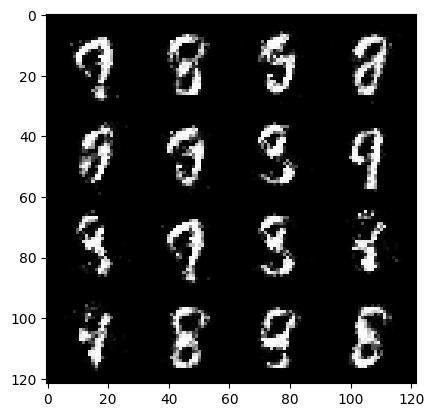

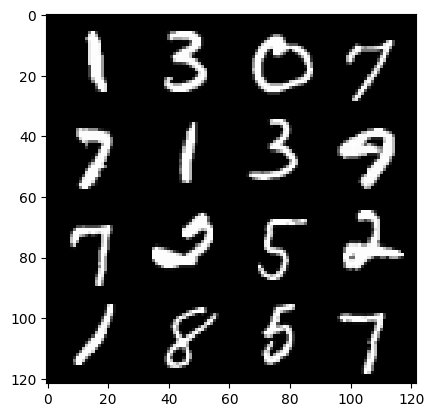

60: step 28200 / Gen loss: 5.09379527568817 / disc_loss: 0.051993610390151566


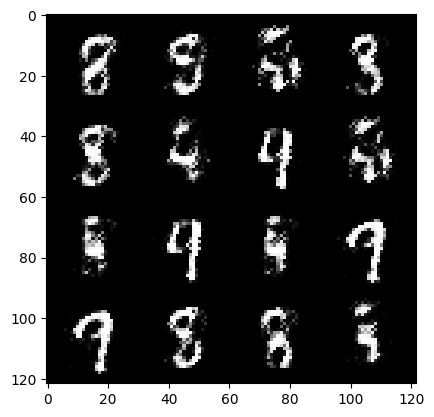

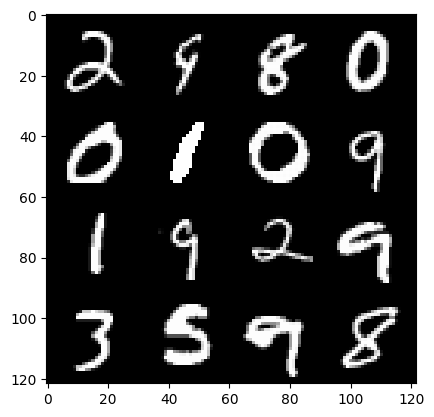

60: step 28500 / Gen loss: 5.2515302880605095 / disc_loss: 0.0538060346742471


  0%|          | 0/469 [00:00<?, ?it/s]

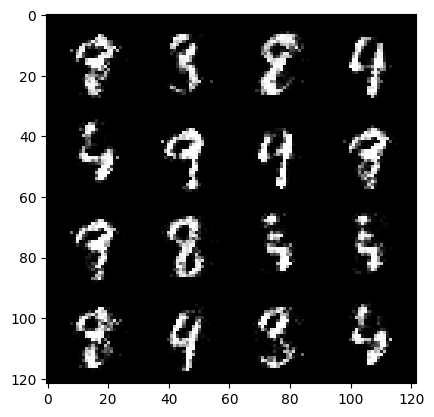

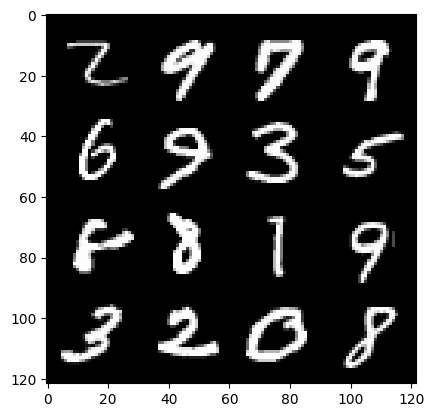

61: step 28800 / Gen loss: 4.92697049299876 / disc_loss: 0.06287982226038977


  0%|          | 0/469 [00:00<?, ?it/s]

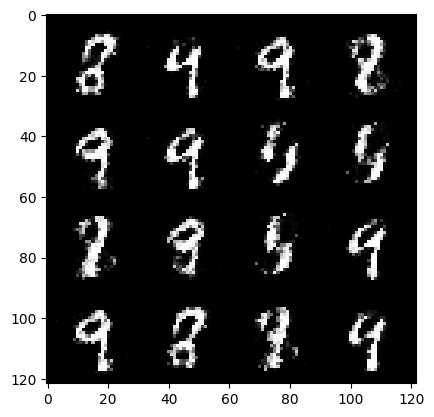

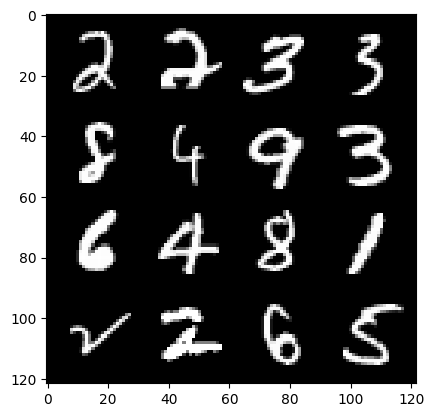

62: step 29100 / Gen loss: 4.812420153617863 / disc_loss: 0.07001294380674765


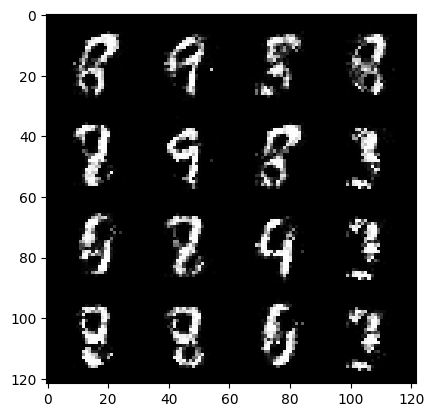

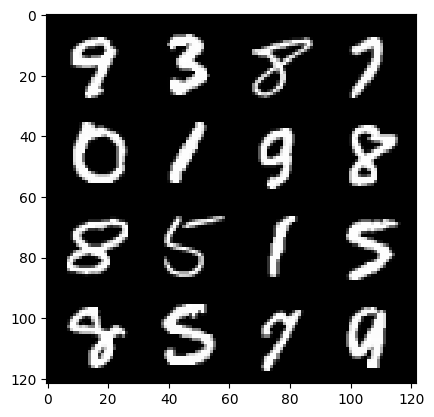

62: step 29400 / Gen loss: 5.011372485160829 / disc_loss: 0.07031437133128447


  0%|          | 0/469 [00:00<?, ?it/s]

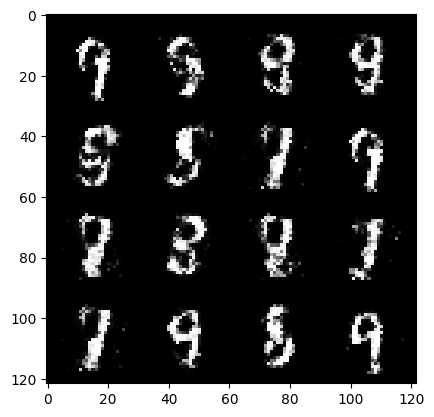

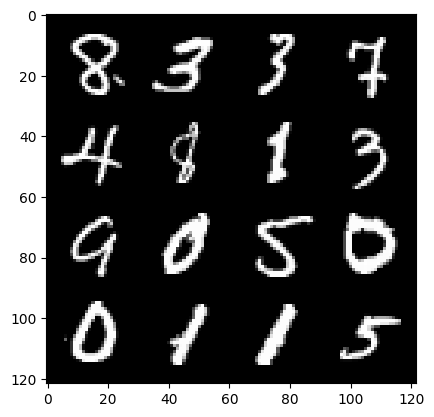

63: step 29700 / Gen loss: 4.894440673987074 / disc_loss: 0.06651242969557646


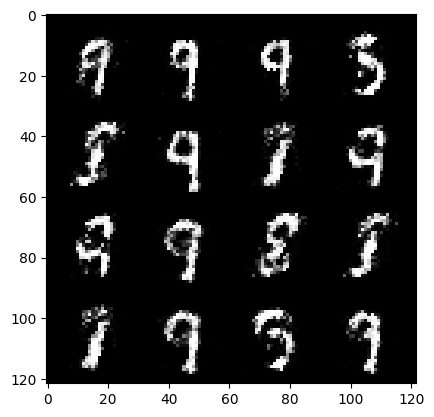

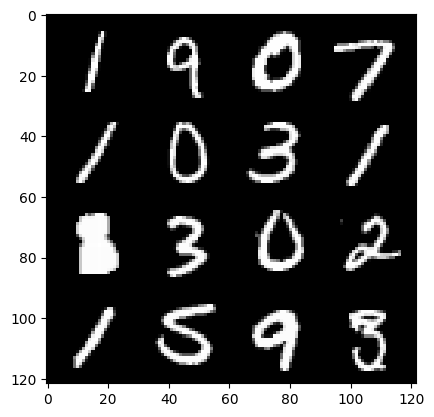

63: step 30000 / Gen loss: 4.9631354451179535 / disc_loss: 0.06383447804177804


  0%|          | 0/469 [00:00<?, ?it/s]

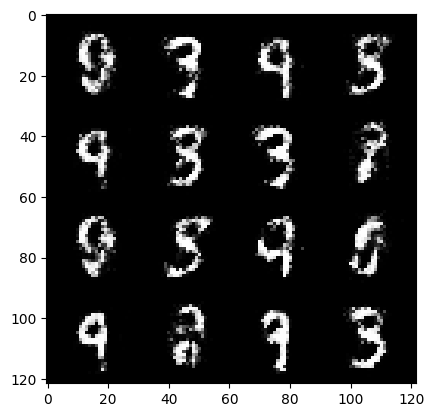

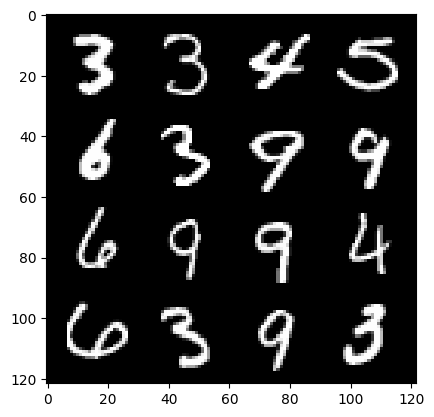

64: step 30300 / Gen loss: 4.817380643685663 / disc_loss: 0.06890928488224742


  0%|          | 0/469 [00:00<?, ?it/s]

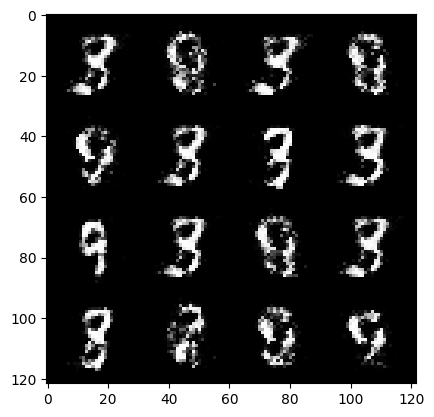

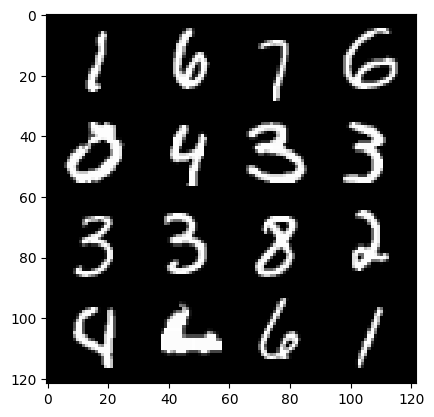

65: step 30600 / Gen loss: 4.707911772727967 / disc_loss: 0.07207193692525228


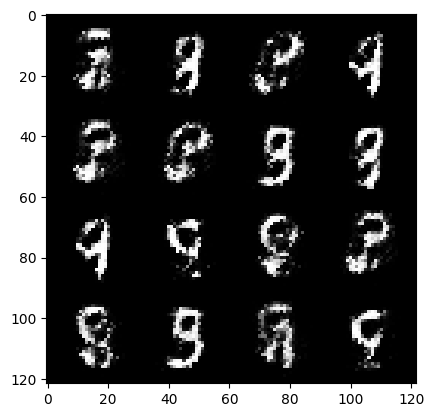

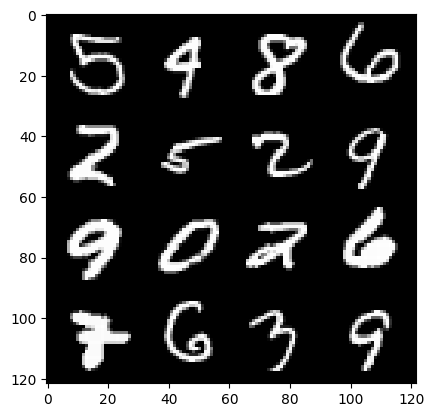

65: step 30900 / Gen loss: 4.983109005292262 / disc_loss: 0.07109880339975155


  0%|          | 0/469 [00:00<?, ?it/s]

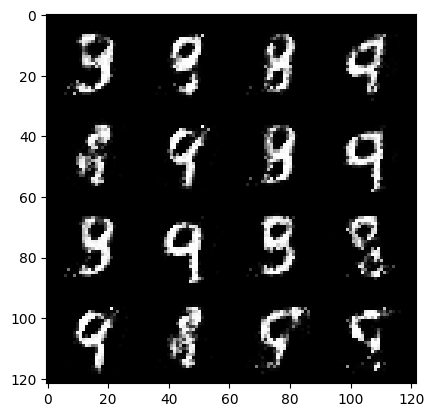

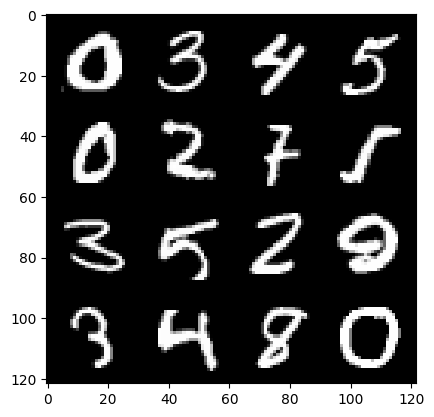

66: step 31200 / Gen loss: 4.722235798835753 / disc_loss: 0.07365425226589042


  0%|          | 0/469 [00:00<?, ?it/s]

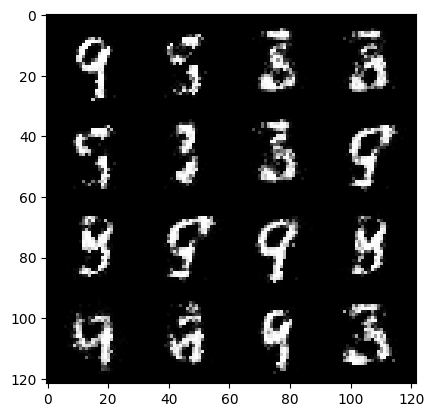

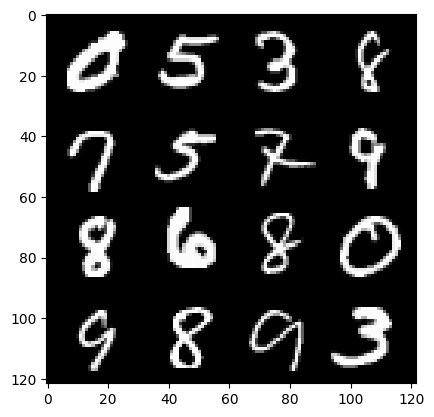

67: step 31500 / Gen loss: 4.896384871006016 / disc_loss: 0.06548777132605509


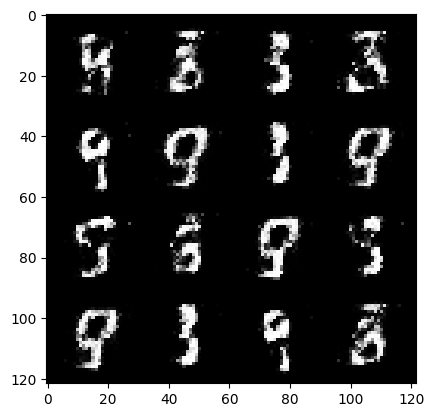

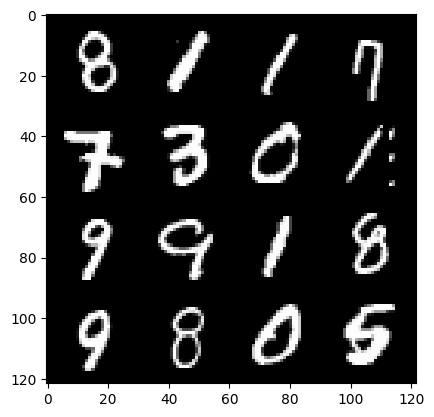

67: step 31800 / Gen loss: 4.747699299653375 / disc_loss: 0.06973666767279306


  0%|          | 0/469 [00:00<?, ?it/s]

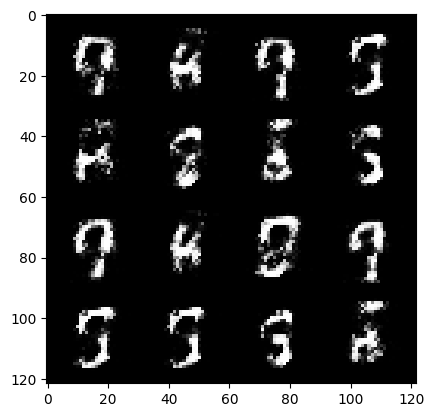

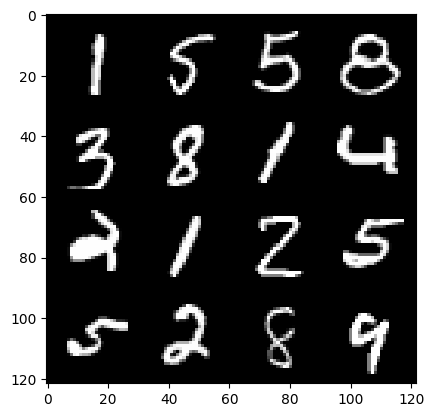

68: step 32100 / Gen loss: 4.588562499682109 / disc_loss: 0.07186282599344851


  0%|          | 0/469 [00:00<?, ?it/s]

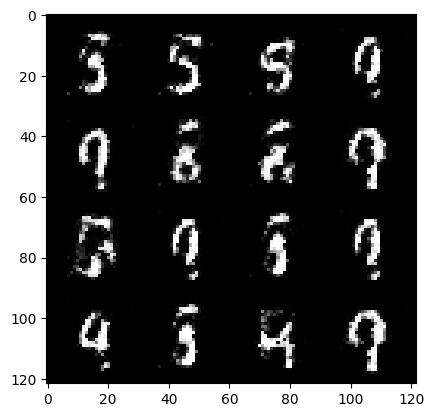

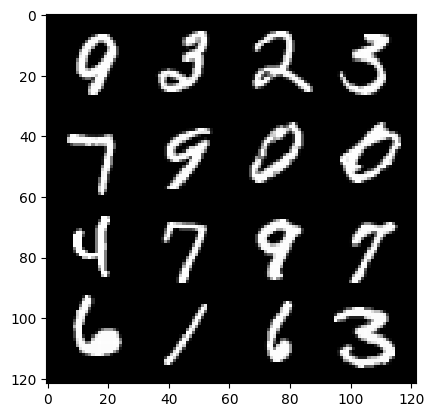

69: step 32400 / Gen loss: 4.857276466687523 / disc_loss: 0.06700321552033224


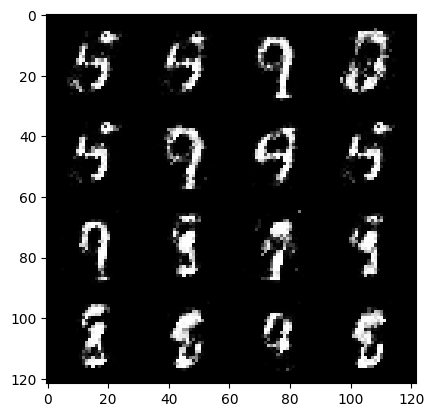

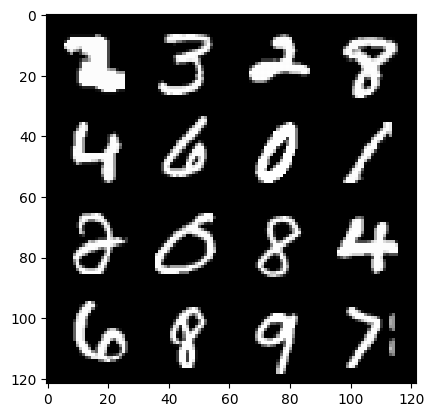

69: step 32700 / Gen loss: 4.649984268347422 / disc_loss: 0.07725078829874604


  0%|          | 0/469 [00:00<?, ?it/s]

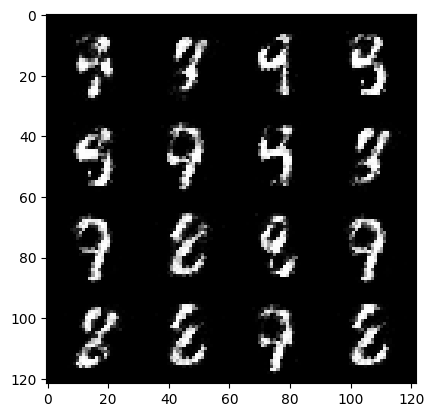

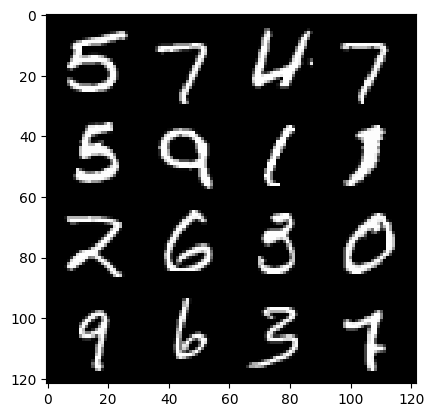

70: step 33000 / Gen loss: 4.6388500062624605 / disc_loss: 0.08338001336281499


  0%|          | 0/469 [00:00<?, ?it/s]

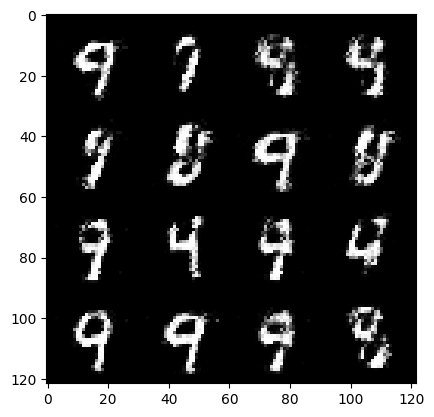

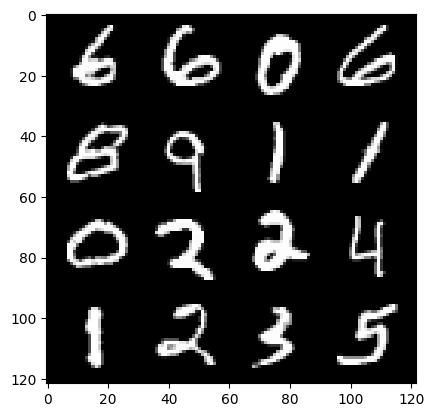

71: step 33300 / Gen loss: 4.4174648284912115 / disc_loss: 0.08513007742042344


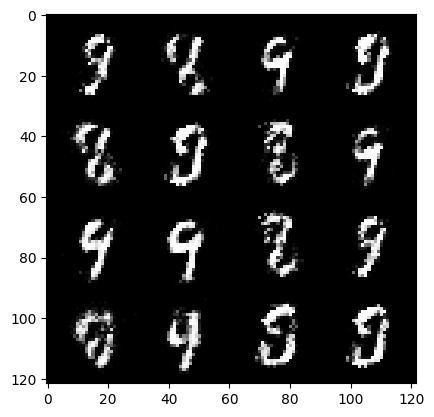

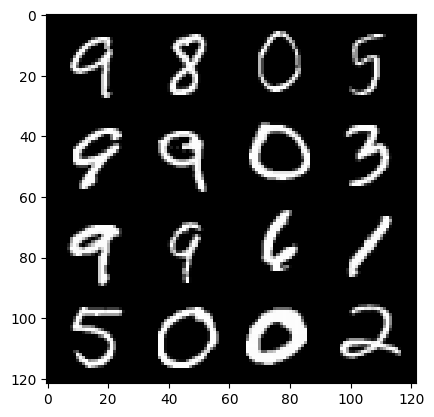

71: step 33600 / Gen loss: 4.284157277743023 / disc_loss: 0.08747645271942017


  0%|          | 0/469 [00:00<?, ?it/s]

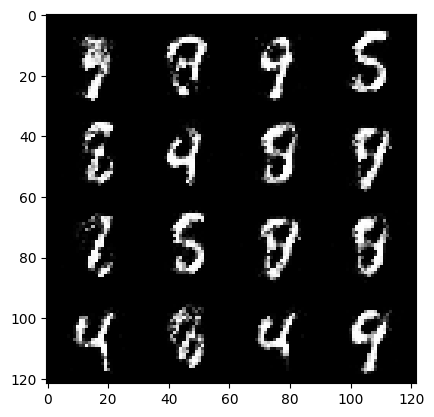

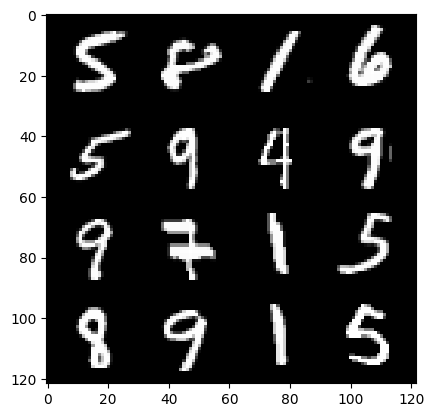

72: step 33900 / Gen loss: 4.377768348852794 / disc_loss: 0.08283959167078134


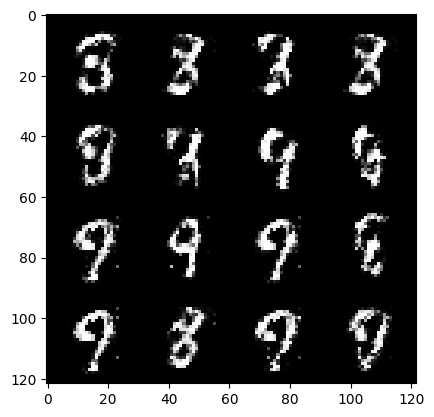

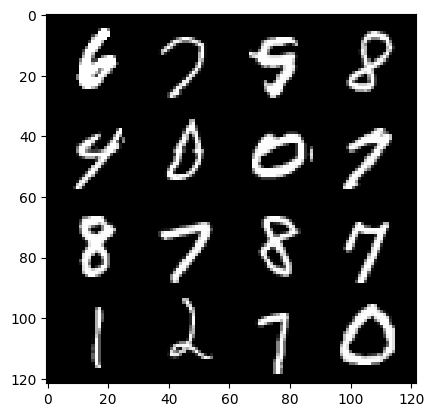

72: step 34200 / Gen loss: 4.558833904266357 / disc_loss: 0.07865045812601844


  0%|          | 0/469 [00:00<?, ?it/s]

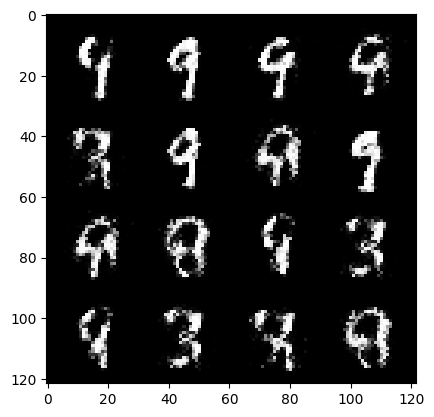

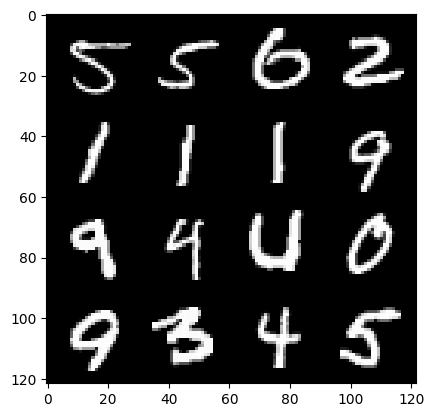

73: step 34500 / Gen loss: 4.739985534350079 / disc_loss: 0.07926389401778582


  0%|          | 0/469 [00:00<?, ?it/s]

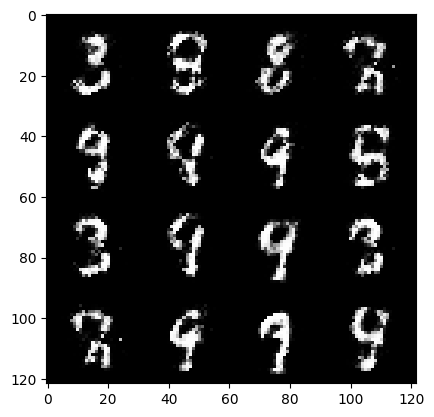

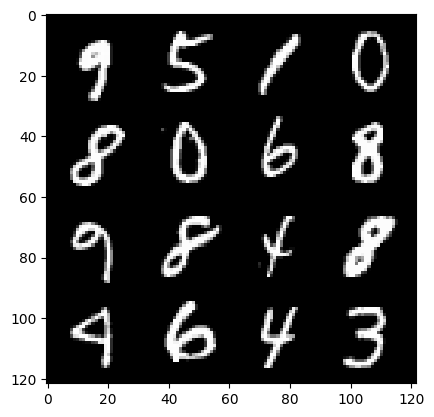

74: step 34800 / Gen loss: 4.28429517587026 / disc_loss: 0.09074258850266541


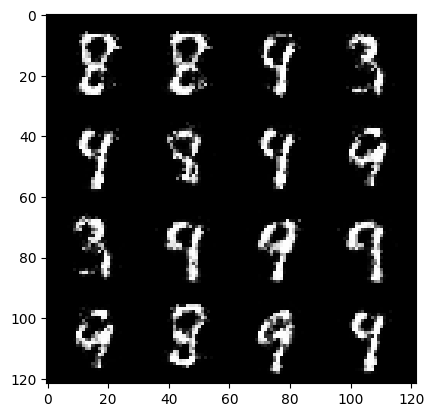

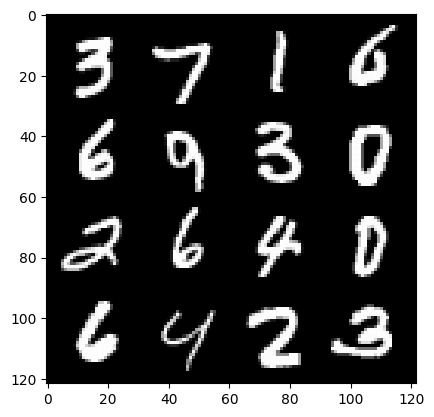

74: step 35100 / Gen loss: 4.26990739186605 / disc_loss: 0.09326623079677424


  0%|          | 0/469 [00:00<?, ?it/s]

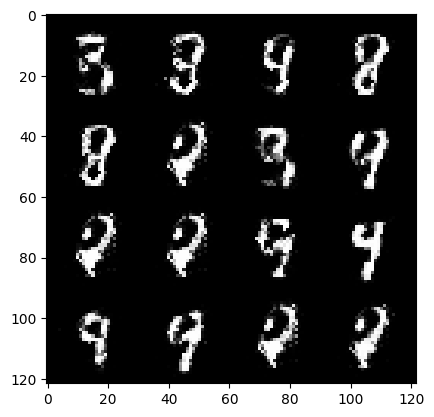

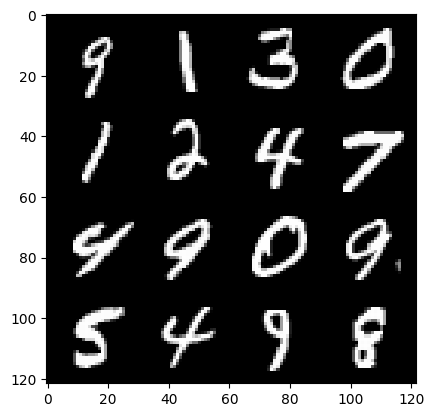

75: step 35400 / Gen loss: 4.269514332612353 / disc_loss: 0.09322818421448265


  0%|          | 0/469 [00:00<?, ?it/s]

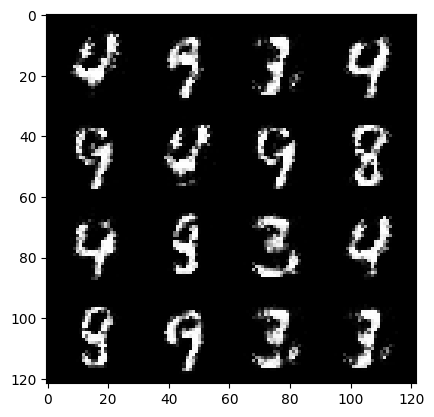

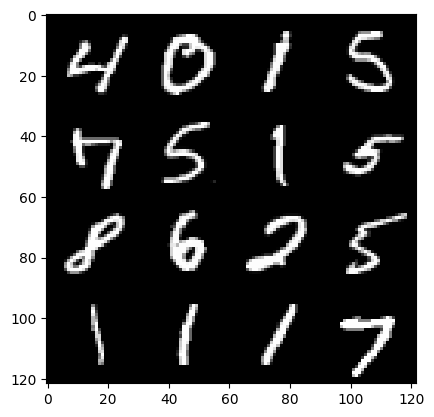

76: step 35700 / Gen loss: 4.4658728814125075 / disc_loss: 0.08519440995529297


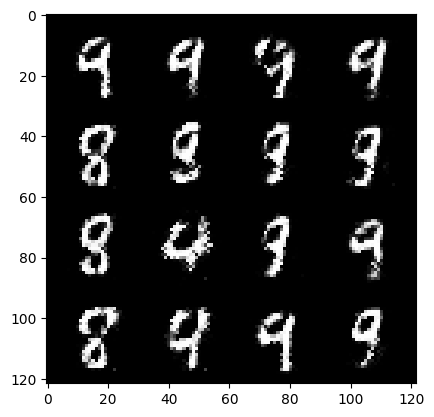

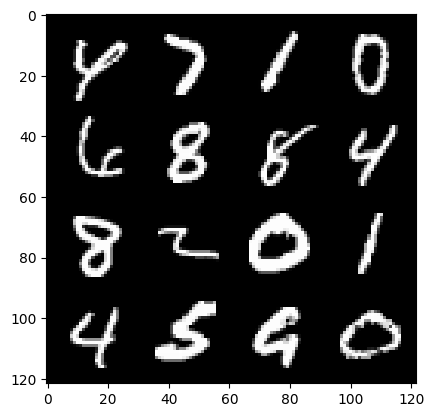

76: step 36000 / Gen loss: 4.247427035967507 / disc_loss: 0.09963994532823556


  0%|          | 0/469 [00:00<?, ?it/s]

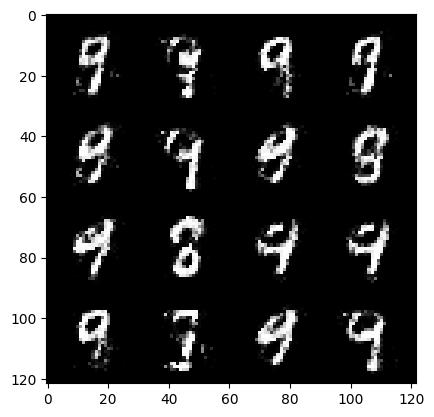

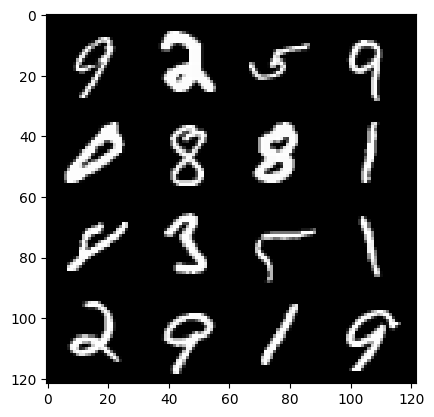

77: step 36300 / Gen loss: 4.311248693466193 / disc_loss: 0.08726035578797266


  0%|          | 0/469 [00:00<?, ?it/s]

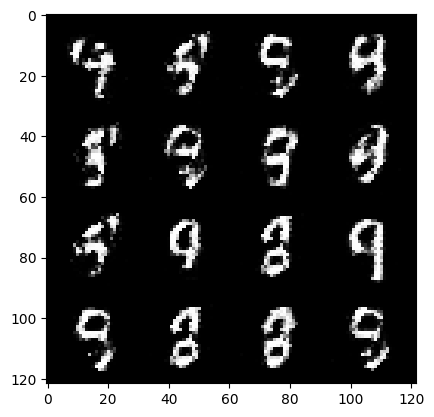

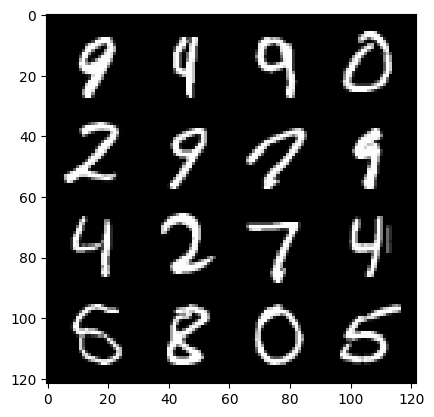

78: step 36600 / Gen loss: 4.18266097863515 / disc_loss: 0.0931858129923543


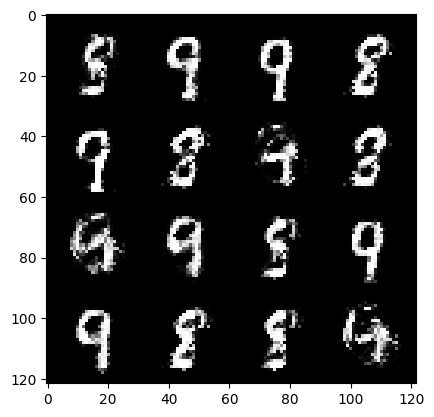

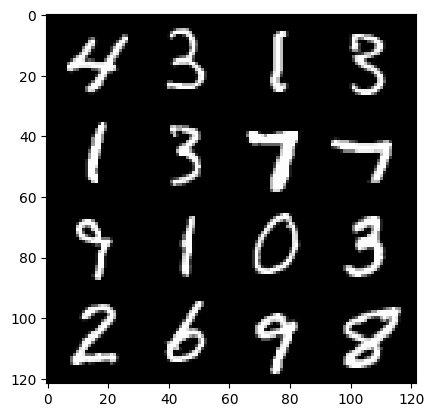

78: step 36900 / Gen loss: 4.248733486334486 / disc_loss: 0.09227686944728089


  0%|          | 0/469 [00:00<?, ?it/s]

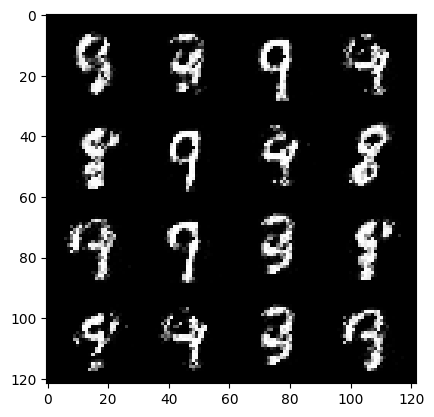

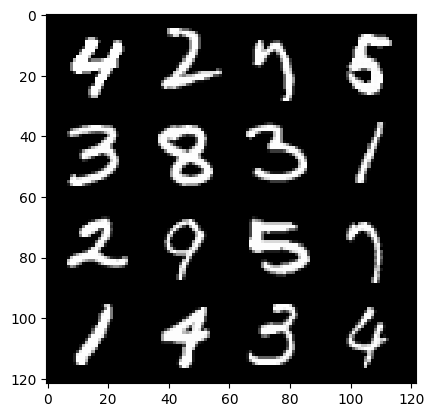

79: step 37200 / Gen loss: 4.449710426330566 / disc_loss: 0.08180184090510007


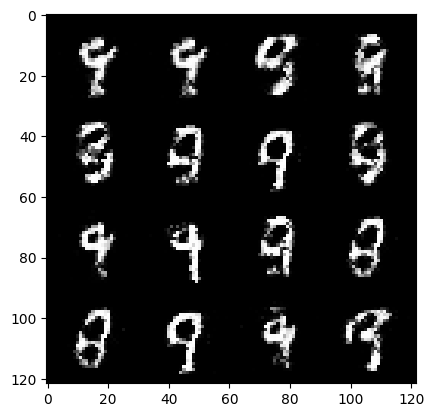

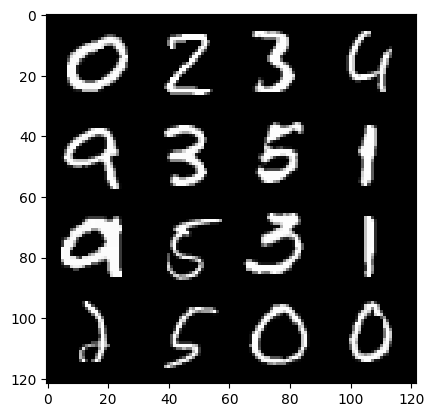

79: step 37500 / Gen loss: 4.440700752735137 / disc_loss: 0.07826915477712948


  0%|          | 0/469 [00:00<?, ?it/s]

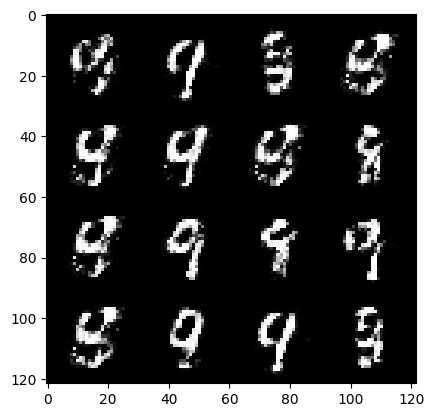

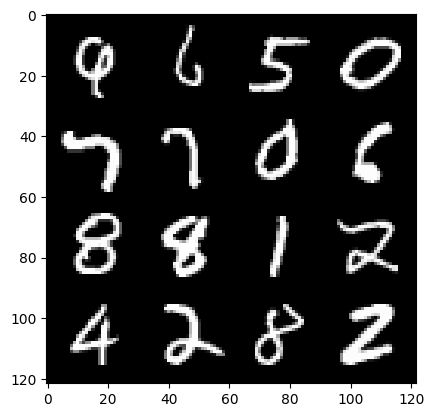

80: step 37800 / Gen loss: 4.175487341880793 / disc_loss: 0.09470100507140165


  0%|          | 0/469 [00:00<?, ?it/s]

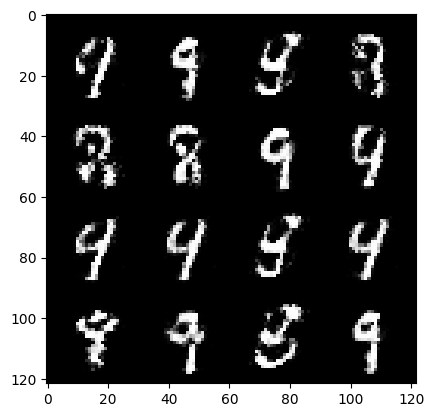

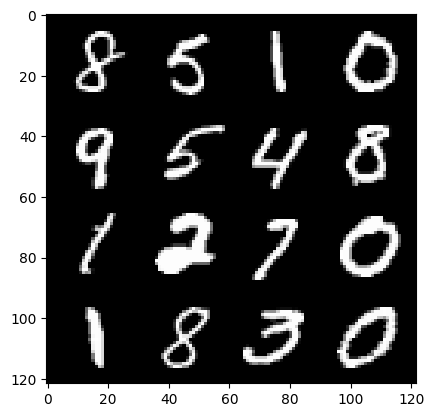

81: step 38100 / Gen loss: 4.130693687597909 / disc_loss: 0.09695373162627224


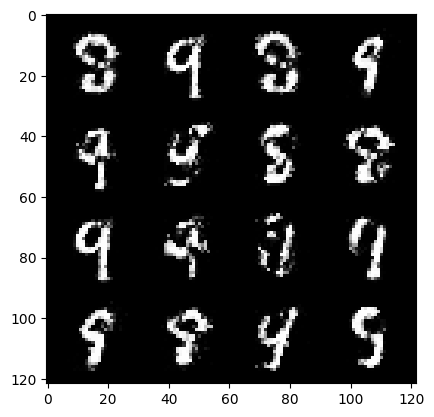

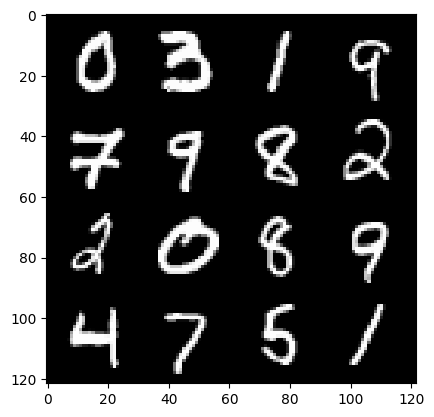

81: step 38400 / Gen loss: 4.012871562639871 / disc_loss: 0.10583294897029799


  0%|          | 0/469 [00:00<?, ?it/s]

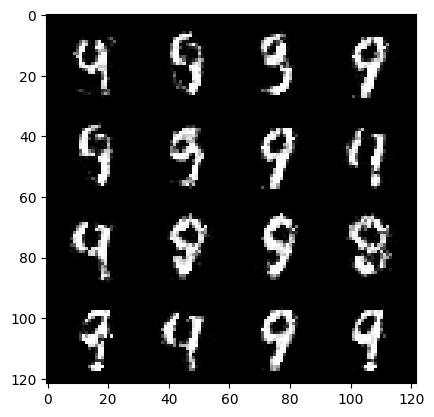

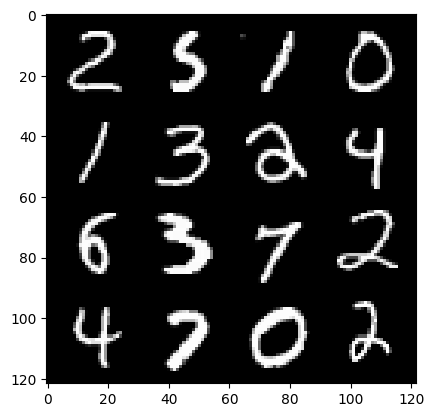

82: step 38700 / Gen loss: 3.8004396883646634 / disc_loss: 0.11604643117636443


  0%|          | 0/469 [00:00<?, ?it/s]

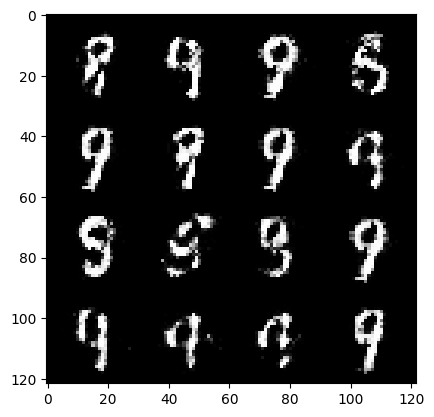

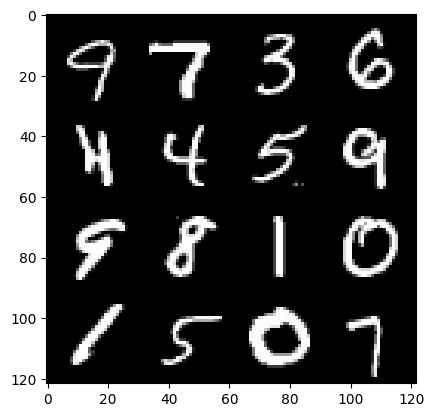

83: step 39000 / Gen loss: 3.966808892885845 / disc_loss: 0.11410256190846362


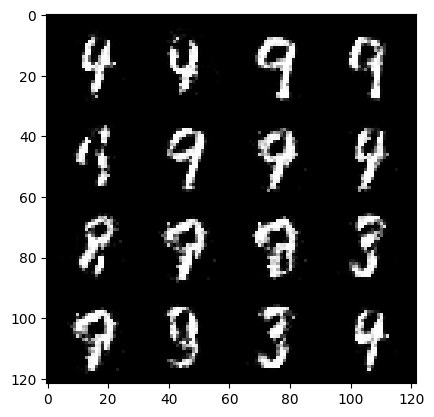

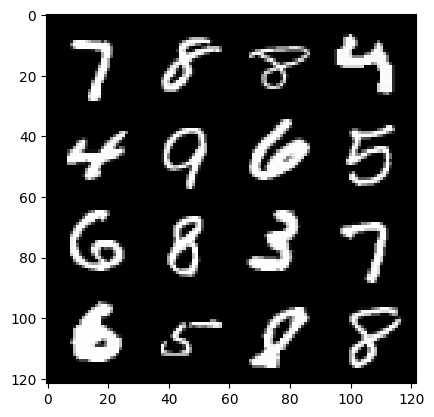

83: step 39300 / Gen loss: 3.9978137421607984 / disc_loss: 0.10344990619768697


  0%|          | 0/469 [00:00<?, ?it/s]

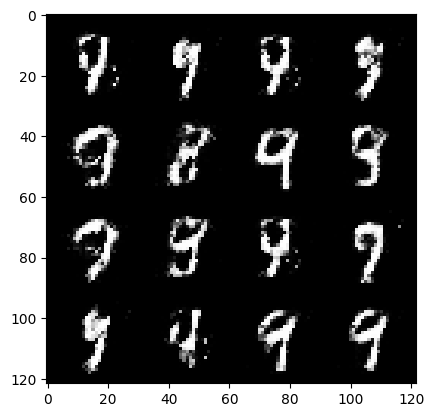

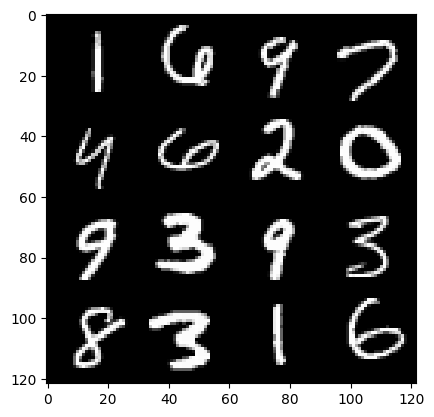

84: step 39600 / Gen loss: 3.869899830818179 / disc_loss: 0.11340399435410894


  0%|          | 0/469 [00:00<?, ?it/s]

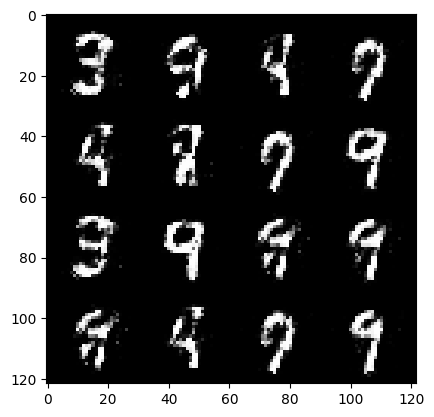

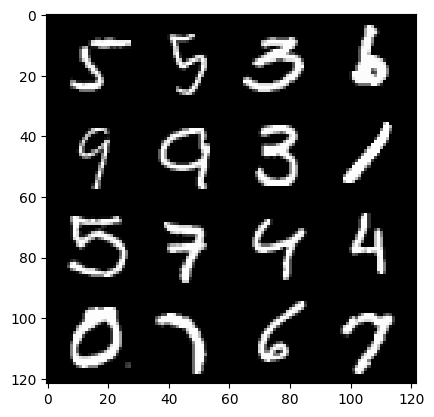

85: step 39900 / Gen loss: 3.9009040681521108 / disc_loss: 0.10786012961218756


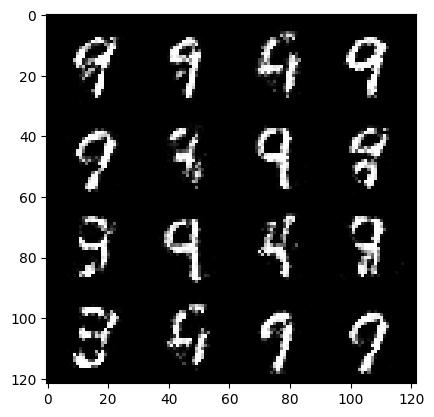

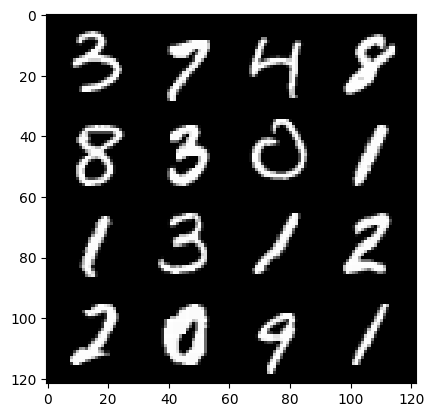

85: step 40200 / Gen loss: 3.7663450153668707 / disc_loss: 0.11206354112674793


  0%|          | 0/469 [00:00<?, ?it/s]

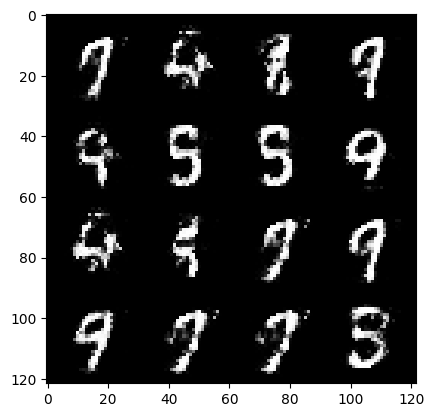

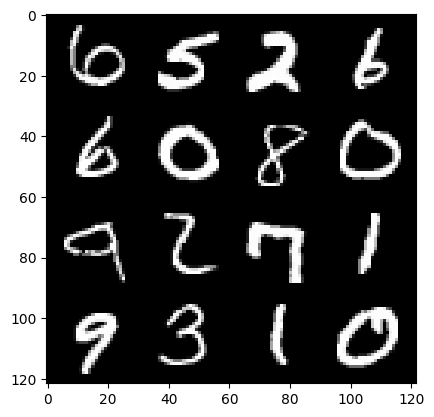

86: step 40500 / Gen loss: 3.6627812290191653 / disc_loss: 0.13313439647356654


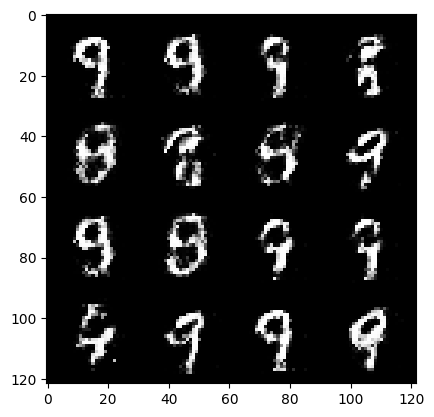

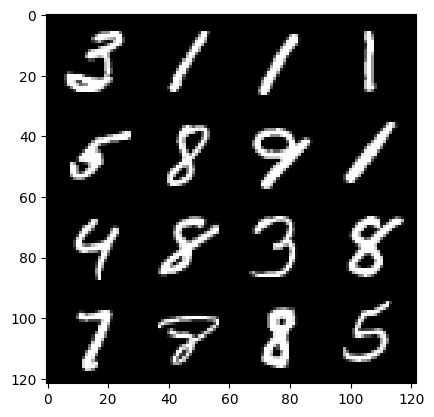

86: step 40800 / Gen loss: 3.6513002212842327 / disc_loss: 0.13002650669465451


  0%|          | 0/469 [00:00<?, ?it/s]

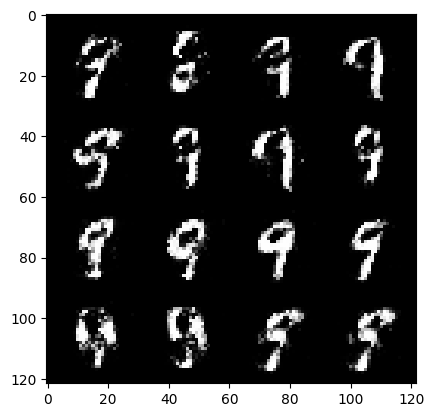

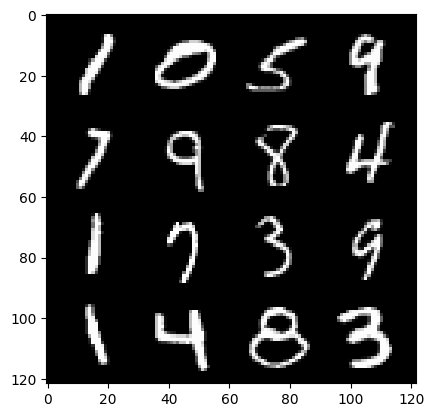

87: step 41100 / Gen loss: 3.6481270217895485 / disc_loss: 0.12374134600162506


  0%|          | 0/469 [00:00<?, ?it/s]

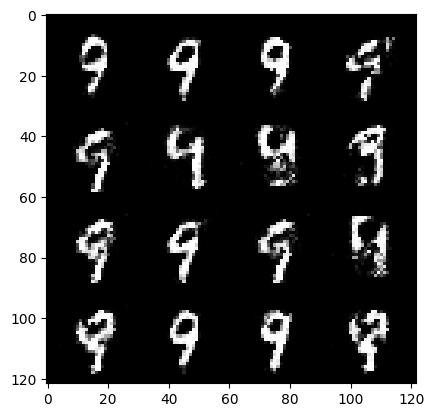

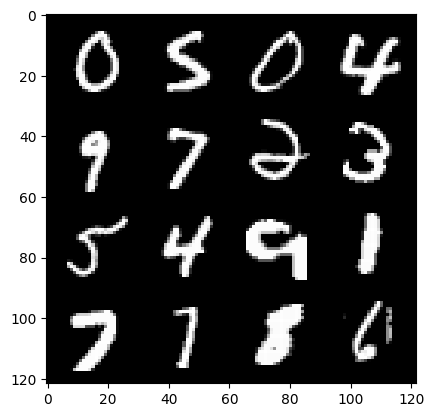

88: step 41400 / Gen loss: 3.7473882071177185 / disc_loss: 0.11908393784115712


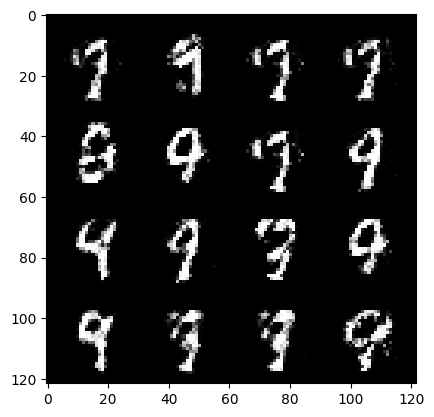

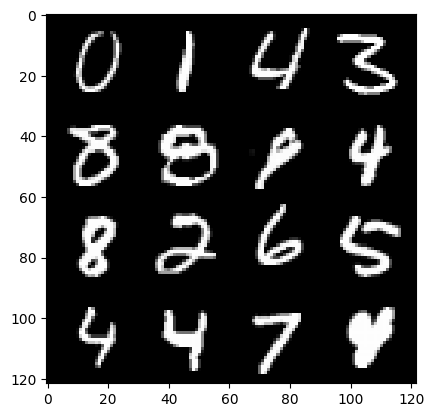

88: step 41700 / Gen loss: 3.6160589679082245 / disc_loss: 0.1374794972812135


  0%|          | 0/469 [00:00<?, ?it/s]

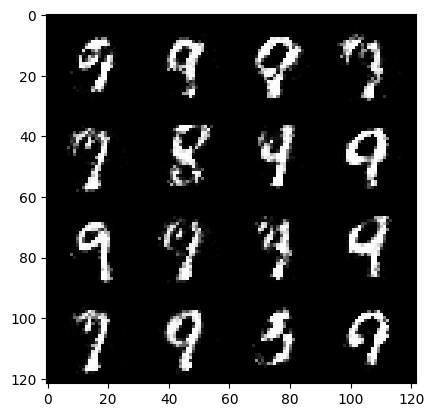

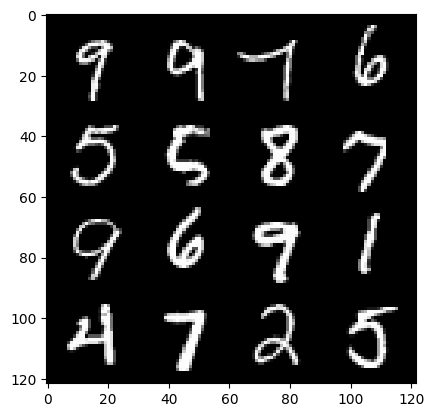

89: step 42000 / Gen loss: 3.6356899499893163 / disc_loss: 0.12882420763373378


  0%|          | 0/469 [00:00<?, ?it/s]

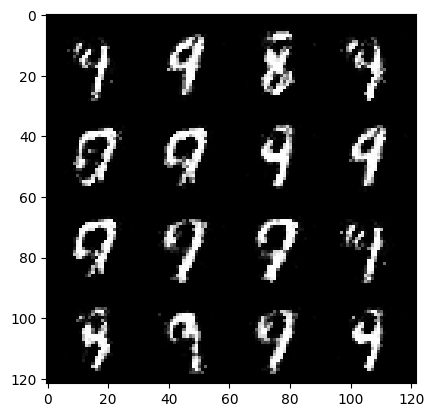

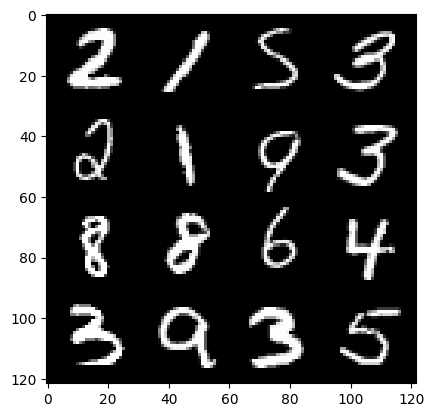

90: step 42300 / Gen loss: 3.564283536275229 / disc_loss: 0.12751471174259987


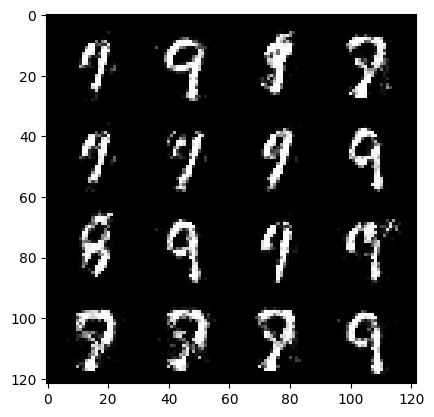

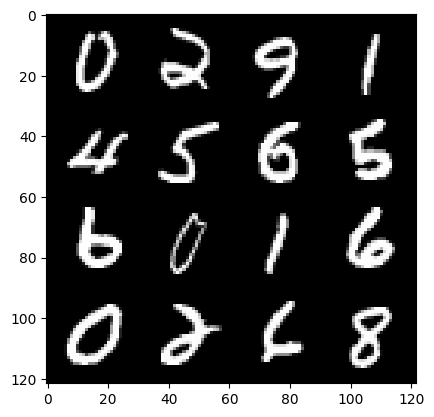

90: step 42600 / Gen loss: 3.3855341124534593 / disc_loss: 0.1381894764552514


  0%|          | 0/469 [00:00<?, ?it/s]

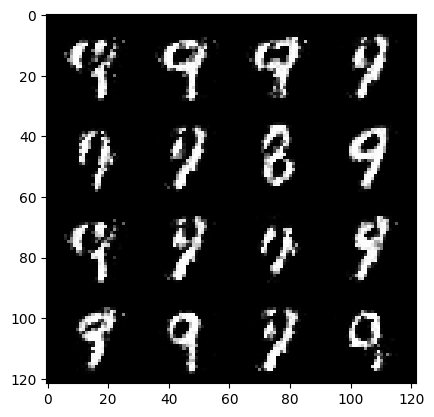

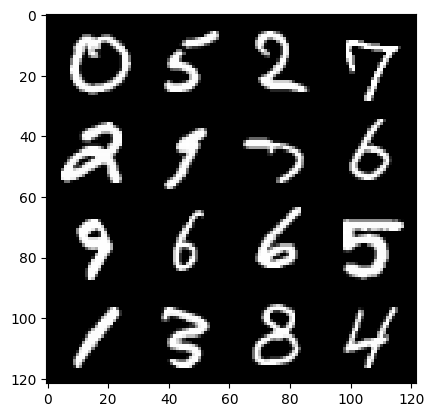

91: step 42900 / Gen loss: 3.4952719418207794 / disc_loss: 0.129074514185389


  0%|          | 0/469 [00:00<?, ?it/s]

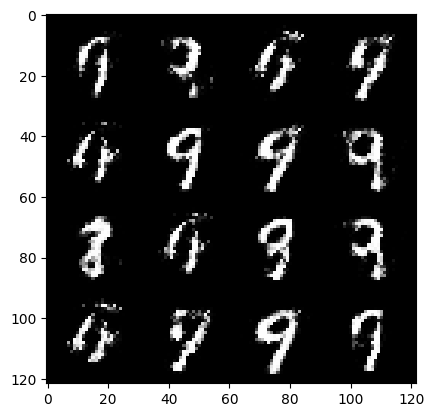

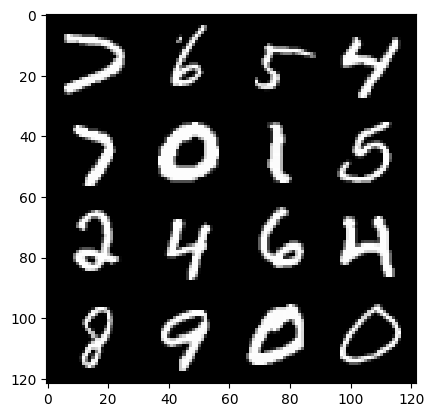

92: step 43200 / Gen loss: 3.6423313681284593 / disc_loss: 0.11911524683237076


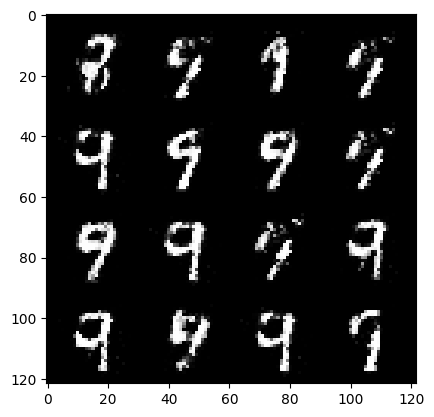

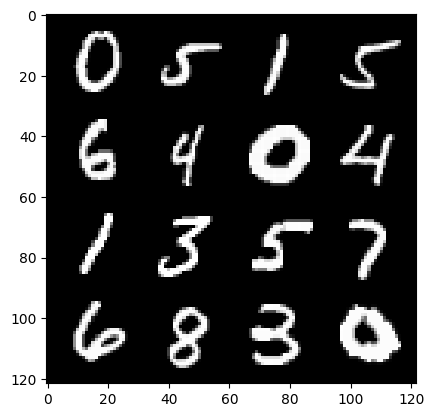

92: step 43500 / Gen loss: 3.6540681338310232 / disc_loss: 0.11097803583989539


  0%|          | 0/469 [00:00<?, ?it/s]

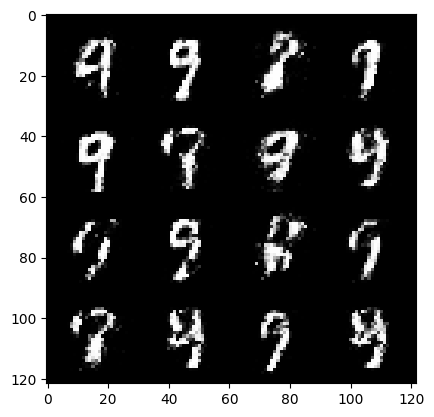

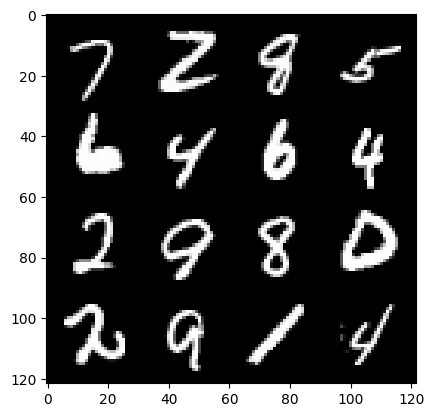

93: step 43800 / Gen loss: 3.535195028781892 / disc_loss: 0.1193344155699015


  0%|          | 0/469 [00:00<?, ?it/s]

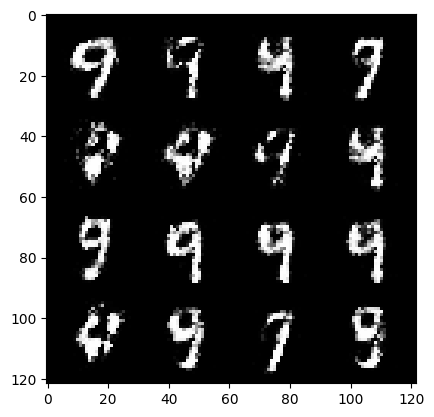

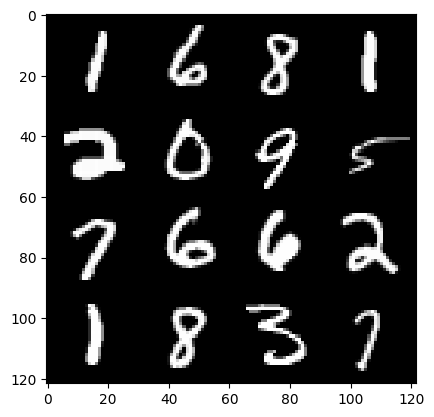

94: step 44100 / Gen loss: 3.626743054389953 / disc_loss: 0.12238386776919173


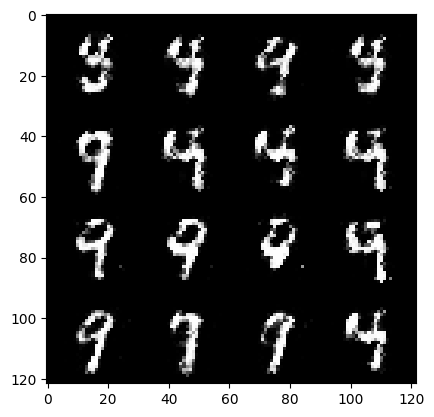

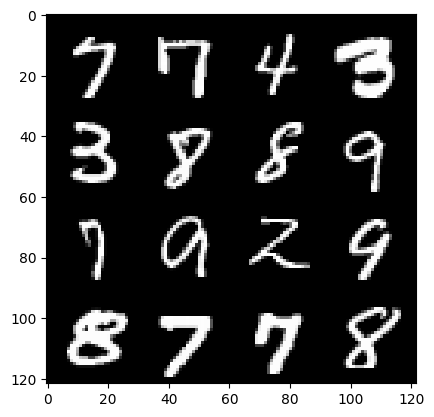

94: step 44400 / Gen loss: 3.5626310396194456 / disc_loss: 0.1246999277298649


  0%|          | 0/469 [00:00<?, ?it/s]

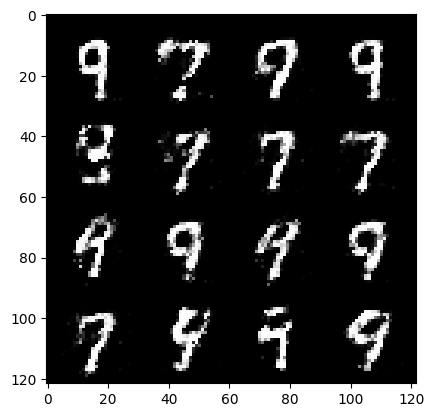

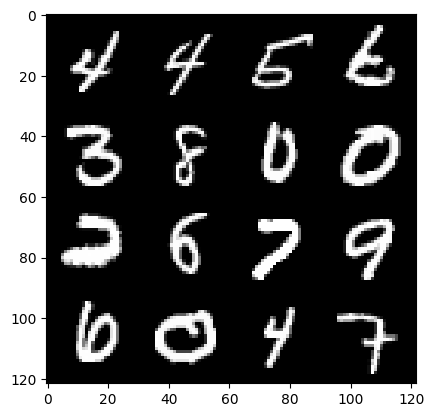

95: step 44700 / Gen loss: 3.7056053137779217 / disc_loss: 0.1202008432274064


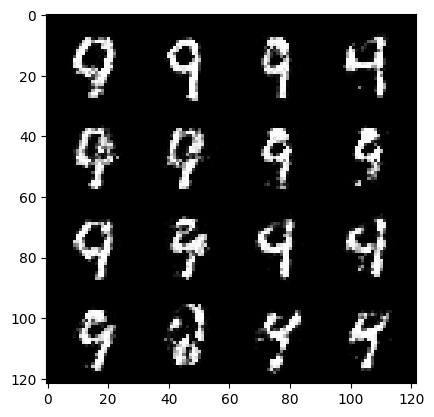

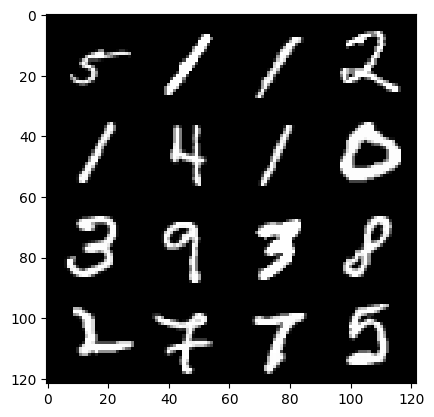

95: step 45000 / Gen loss: 3.3785277112325027 / disc_loss: 0.14688387207686895


  0%|          | 0/469 [00:00<?, ?it/s]

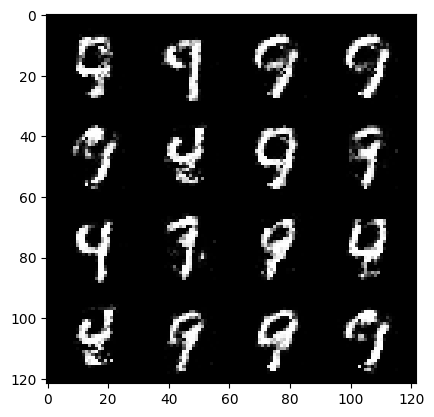

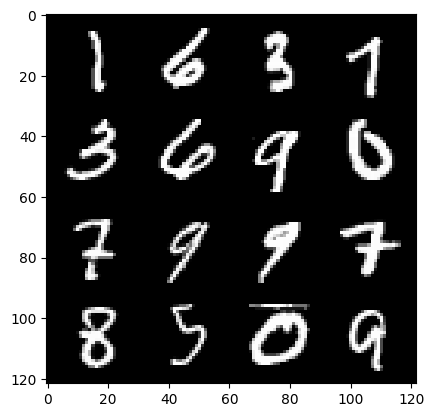

96: step 45300 / Gen loss: 3.548823053042094 / disc_loss: 0.13283829860389226


  0%|          | 0/469 [00:00<?, ?it/s]

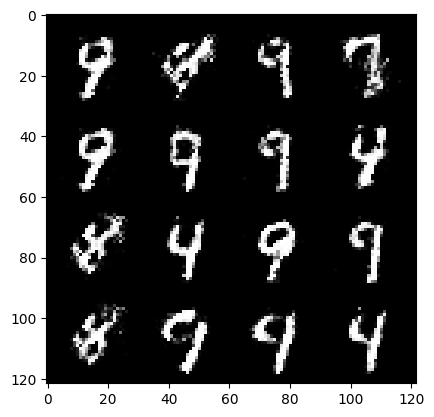

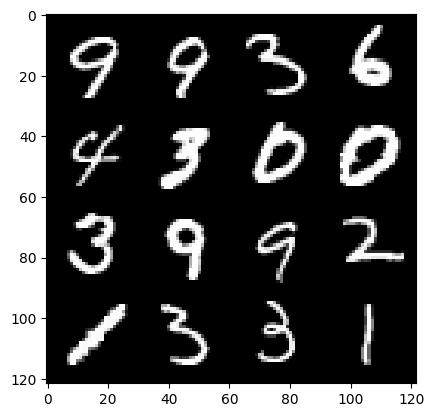

97: step 45600 / Gen loss: 3.3759062091509455 / disc_loss: 0.1480985065301258


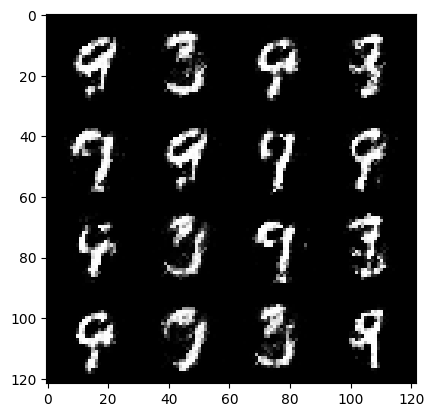

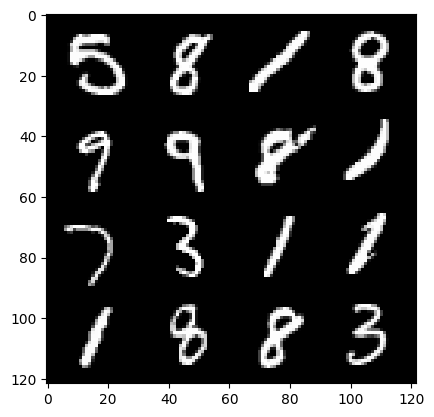

97: step 45900 / Gen loss: 3.3871727244059224 / disc_loss: 0.13118514399975545


  0%|          | 0/469 [00:00<?, ?it/s]

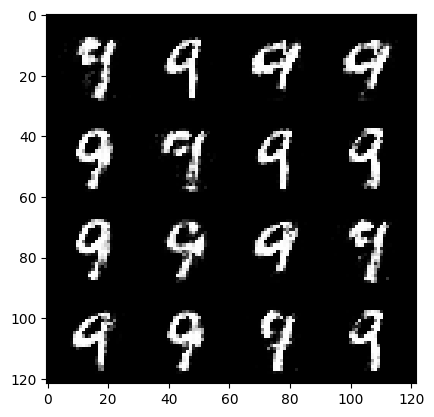

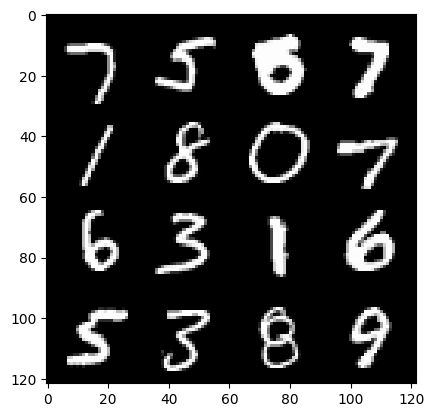

98: step 46200 / Gen loss: 3.3770732998847954 / disc_loss: 0.13976668864488598


  0%|          | 0/469 [00:00<?, ?it/s]

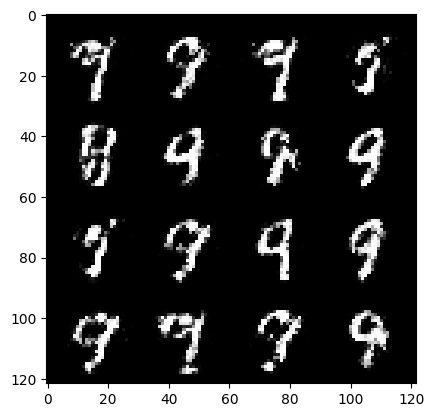

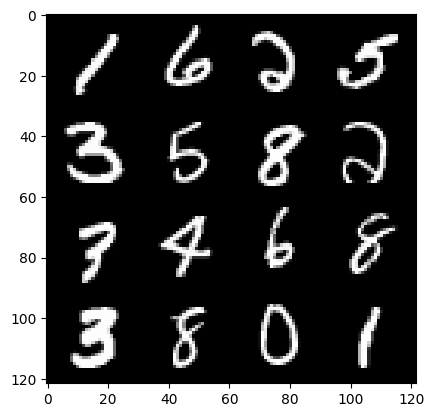

99: step 46500 / Gen loss: 3.4873183091481526 / disc_loss: 0.1161705088242888


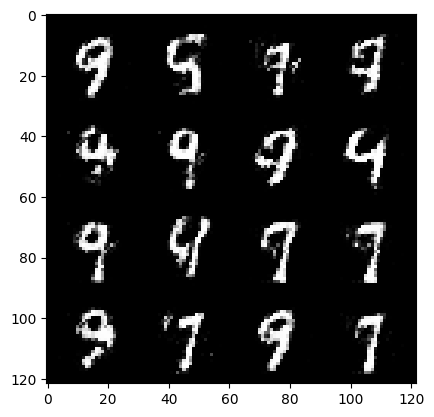

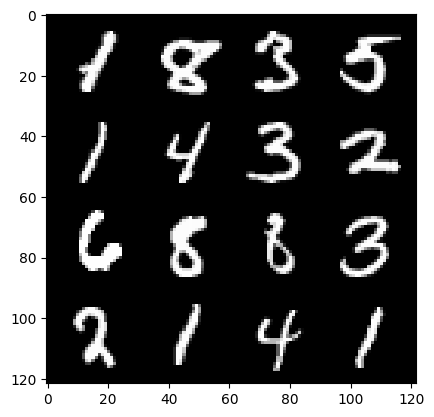

99: step 46800 / Gen loss: 3.4589330728848773 / disc_loss: 0.13639750060935815


  0%|          | 0/469 [00:00<?, ?it/s]

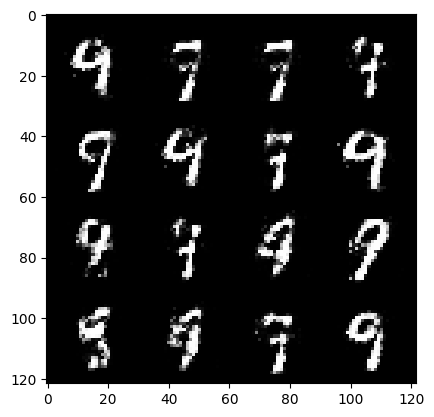

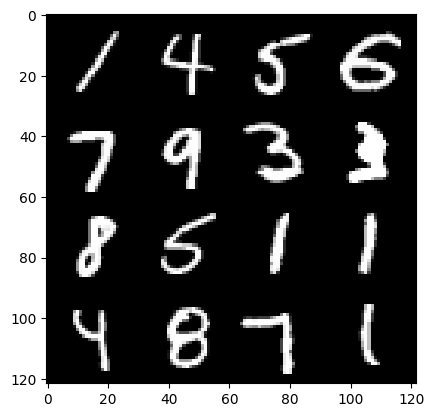

100: step 47100 / Gen loss: 3.1322399282455438 / disc_loss: 0.15813582283755143


  0%|          | 0/469 [00:00<?, ?it/s]

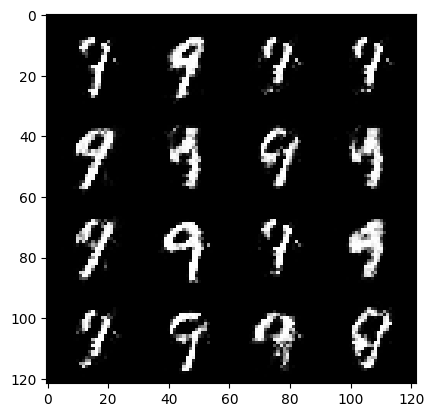

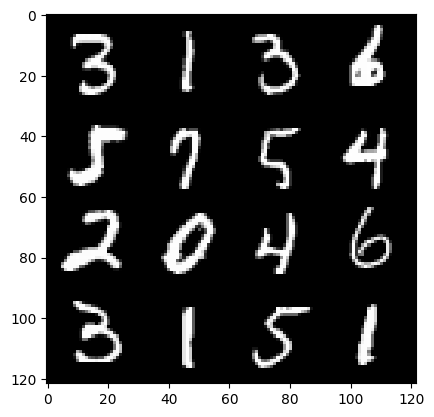

101: step 47400 / Gen loss: 3.149173198541004 / disc_loss: 0.16429933992524956


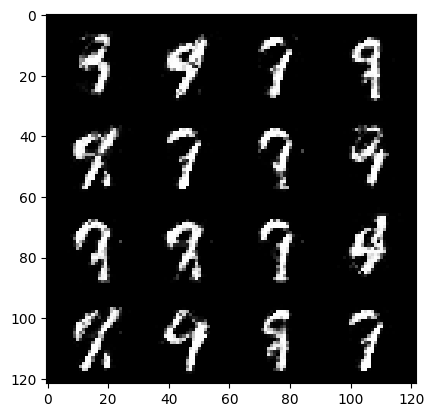

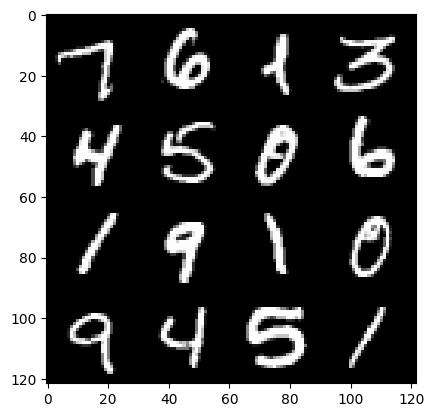

101: step 47700 / Gen loss: 3.2231523108482367 / disc_loss: 0.1479693320517738


  0%|          | 0/469 [00:00<?, ?it/s]

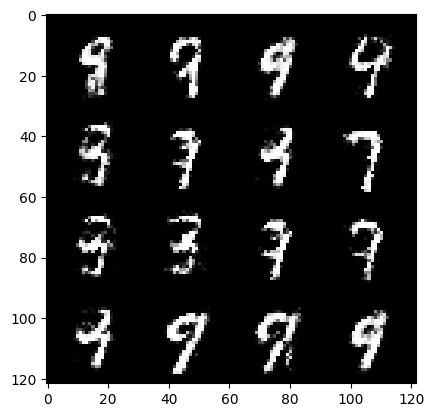

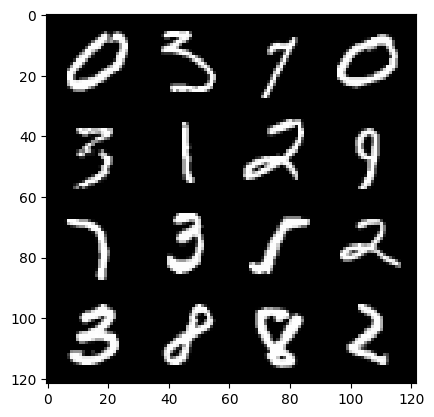

102: step 48000 / Gen loss: 3.31164158821106 / disc_loss: 0.13679023681829375


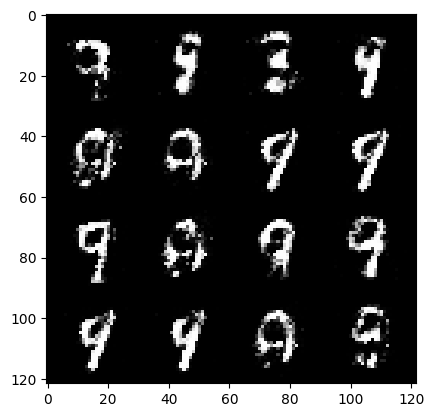

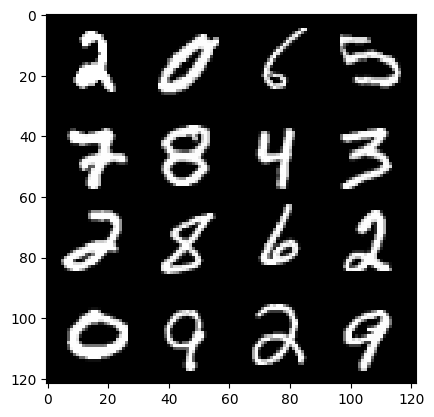

102: step 48300 / Gen loss: 3.3472301864624003 / disc_loss: 0.1349082594861587


  0%|          | 0/469 [00:00<?, ?it/s]

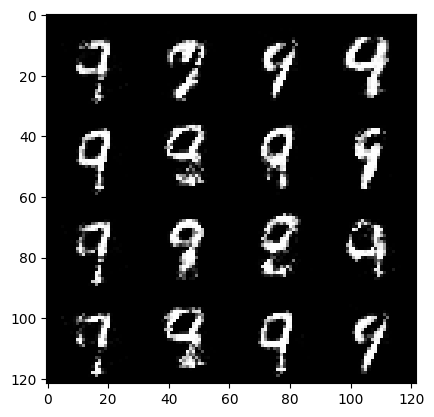

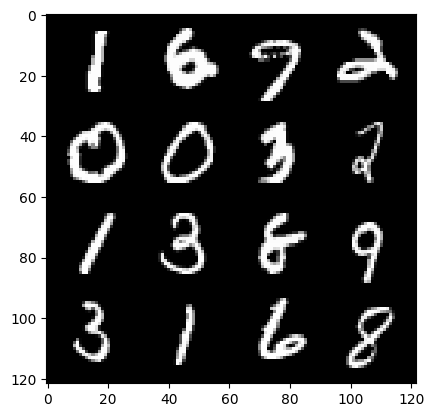

103: step 48600 / Gen loss: 3.525307606856025 / disc_loss: 0.11238628398627037


  0%|          | 0/469 [00:00<?, ?it/s]

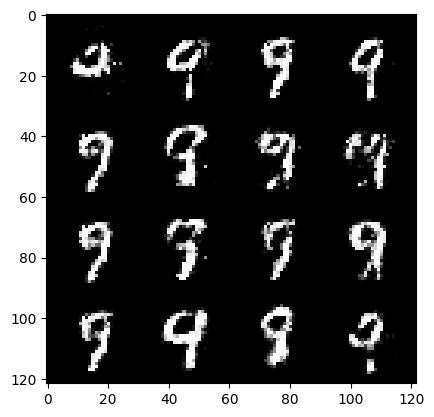

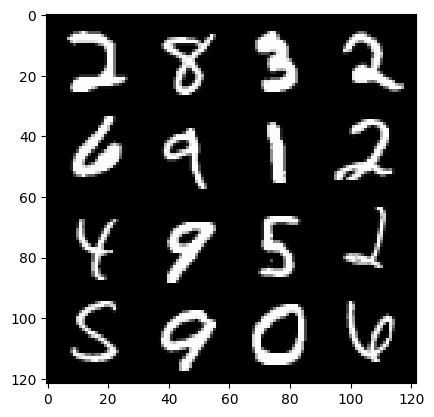

104: step 48900 / Gen loss: 3.3916913946469625 / disc_loss: 0.13345967640479406


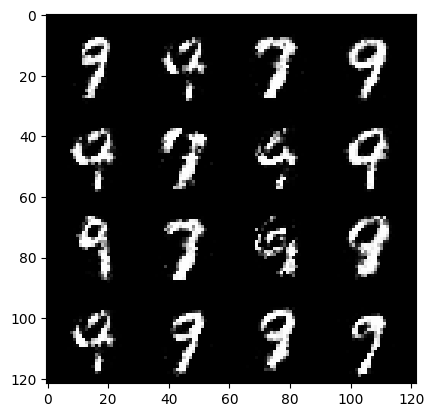

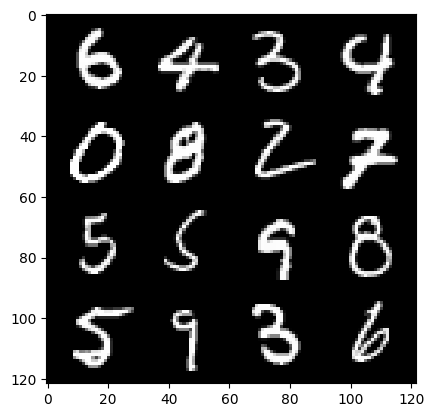

104: step 49200 / Gen loss: 3.4748644423484802 / disc_loss: 0.12604202839235462


  0%|          | 0/469 [00:00<?, ?it/s]

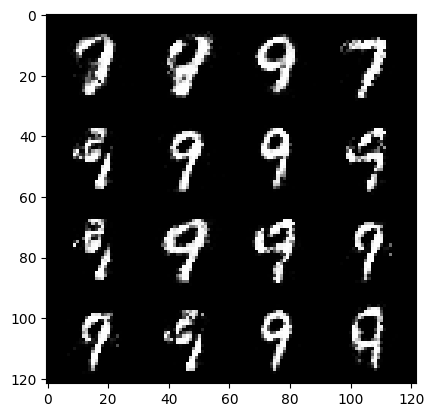

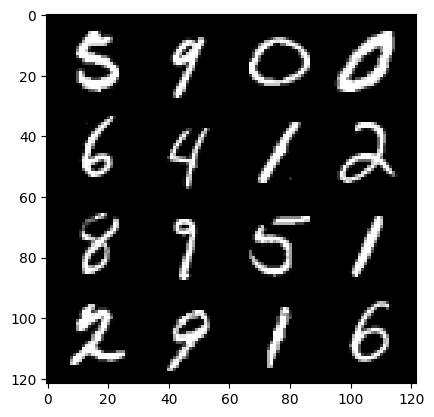

105: step 49500 / Gen loss: 3.382634809017179 / disc_loss: 0.12738026753067966


  0%|          | 0/469 [00:00<?, ?it/s]

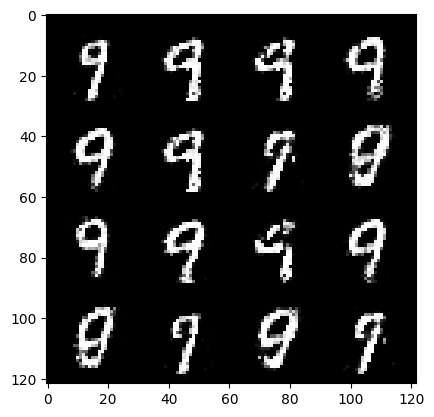

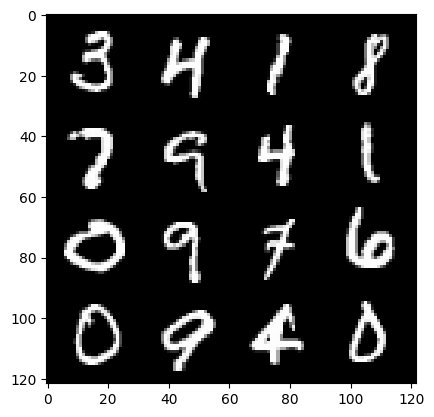

106: step 49800 / Gen loss: 3.436778693993889 / disc_loss: 0.13627463857332875


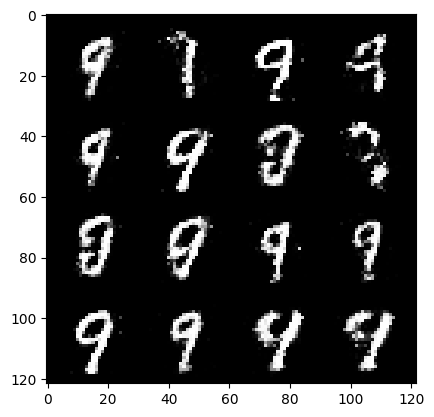

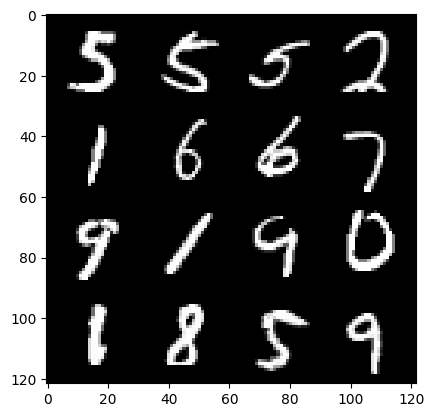

106: step 50100 / Gen loss: 3.5658918579419443 / disc_loss: 0.1292911928147078


  0%|          | 0/469 [00:00<?, ?it/s]

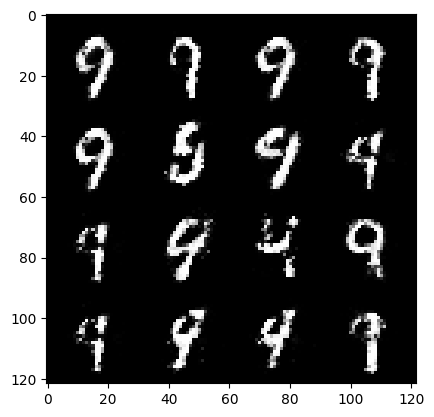

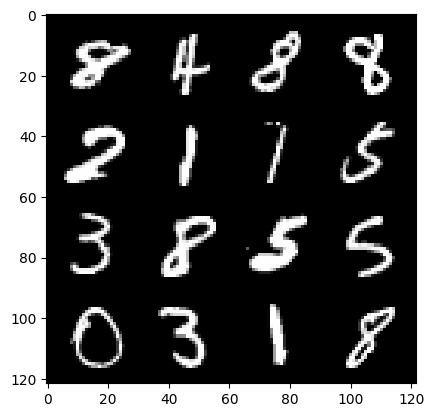

107: step 50400 / Gen loss: 3.541784904003144 / disc_loss: 0.12782922024528195


  0%|          | 0/469 [00:00<?, ?it/s]

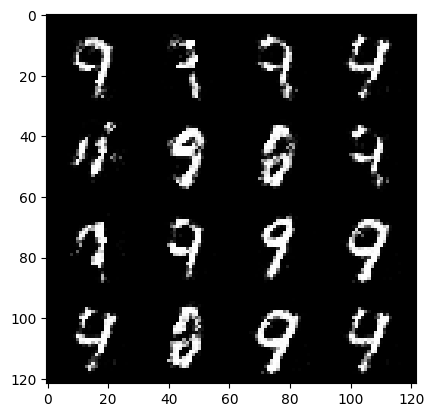

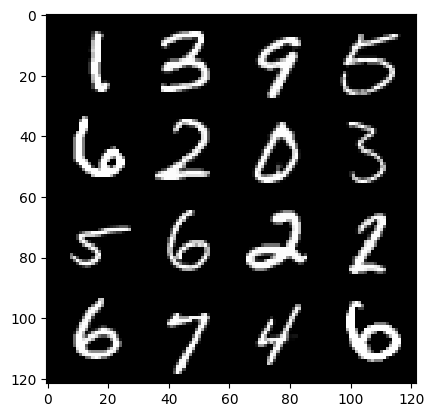

108: step 50700 / Gen loss: 3.3252880803743996 / disc_loss: 0.14904503102103867


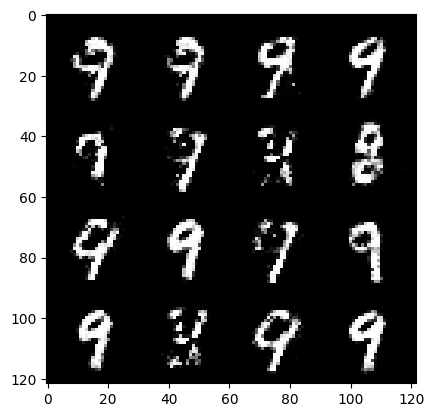

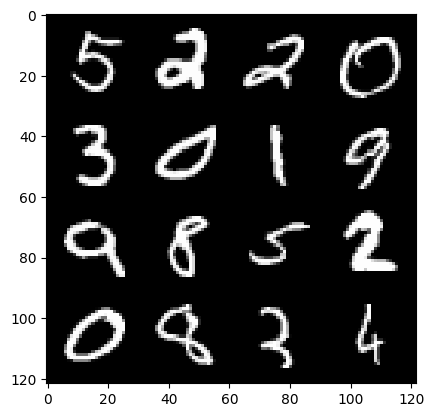

108: step 51000 / Gen loss: 3.1693733874956767 / disc_loss: 0.14959828617672116


  0%|          | 0/469 [00:00<?, ?it/s]

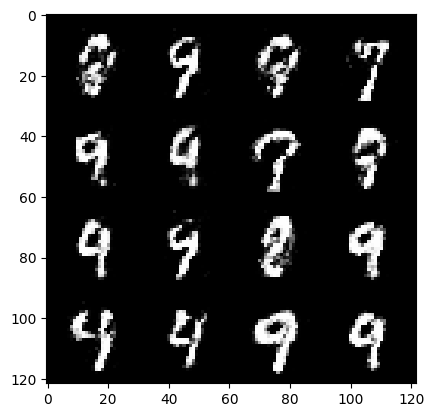

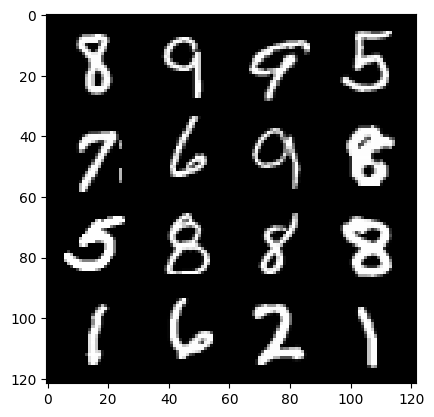

109: step 51300 / Gen loss: 3.1378361376126613 / disc_loss: 0.15194318125645317


  0%|          | 0/469 [00:00<?, ?it/s]

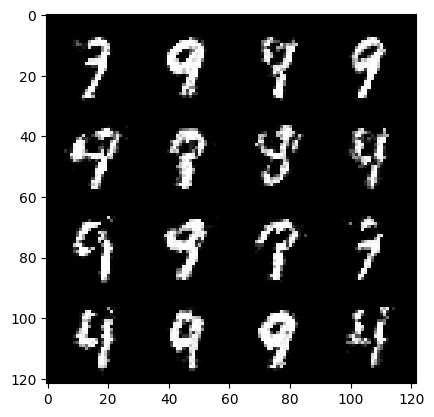

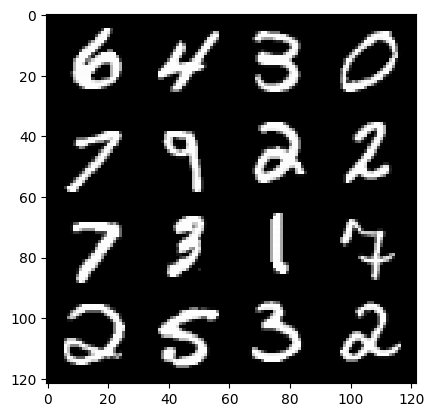

110: step 51600 / Gen loss: 3.1850575955708806 / disc_loss: 0.16159912756333755


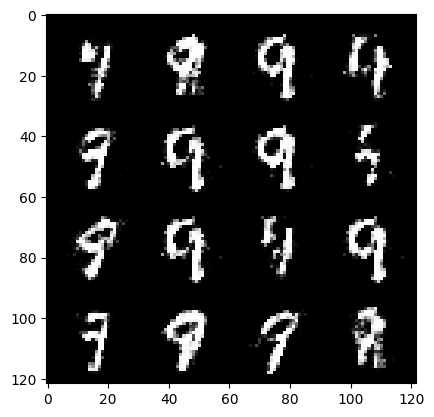

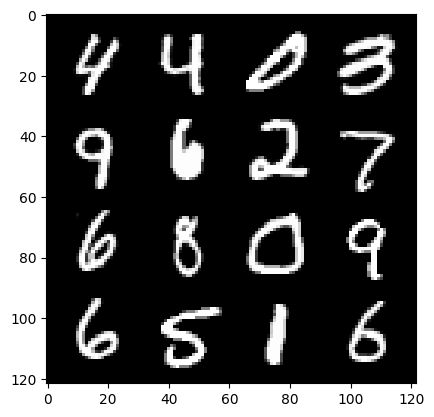

110: step 51900 / Gen loss: 3.2262971258163464 / disc_loss: 0.14984770826995383


  0%|          | 0/469 [00:00<?, ?it/s]

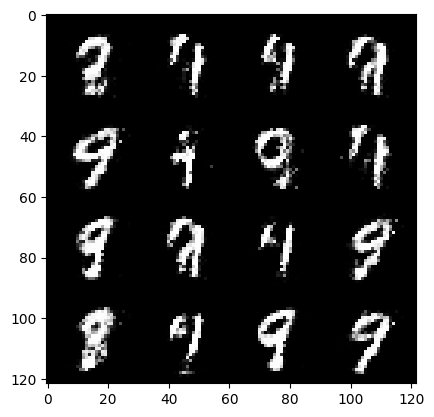

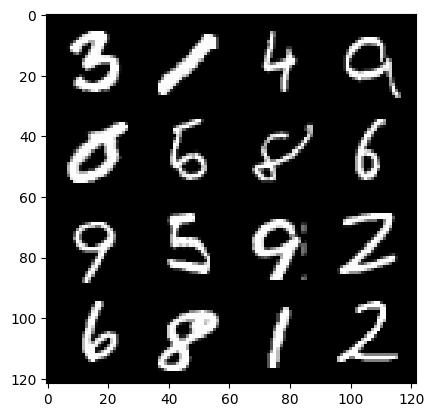

111: step 52200 / Gen loss: 3.1385155439376864 / disc_loss: 0.1555810484538477


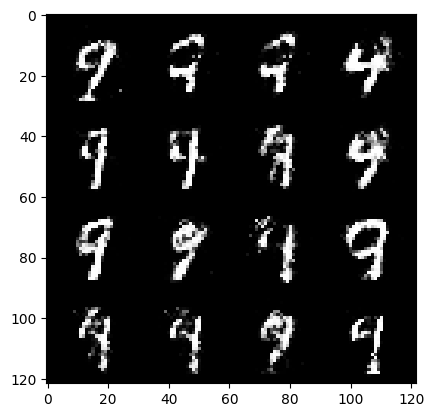

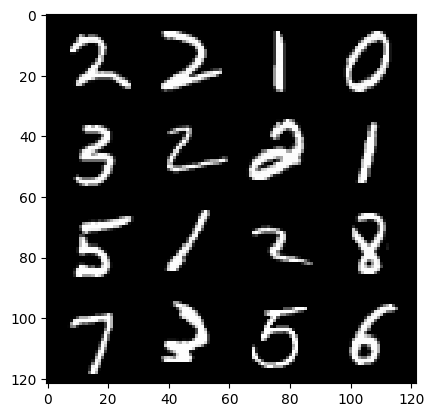

111: step 52500 / Gen loss: 3.4195105115572613 / disc_loss: 0.12311620471378171


  0%|          | 0/469 [00:00<?, ?it/s]

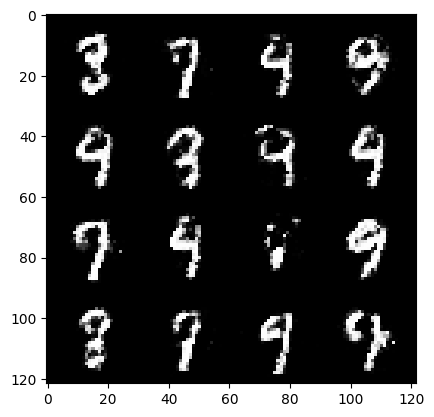

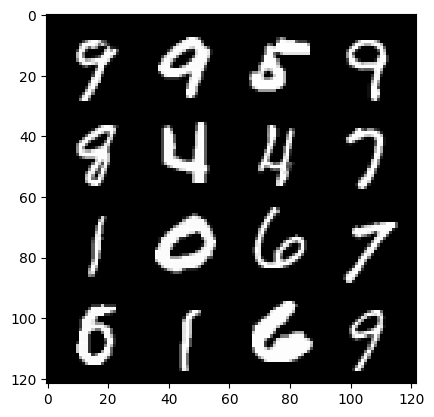

112: step 52800 / Gen loss: 3.1734370827674843 / disc_loss: 0.1510422455519438


  0%|          | 0/469 [00:00<?, ?it/s]

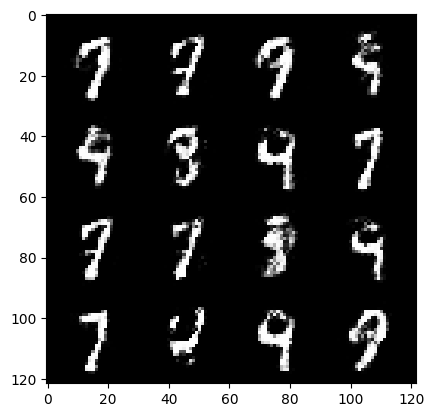

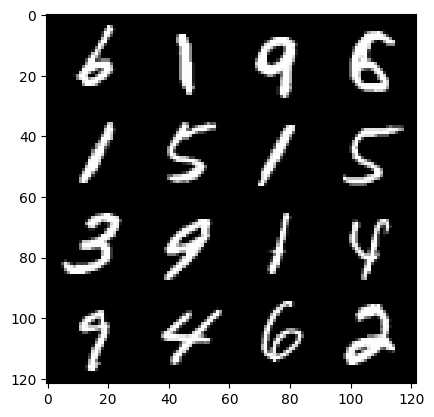

113: step 53100 / Gen loss: 3.013662206331888 / disc_loss: 0.17174714449793105


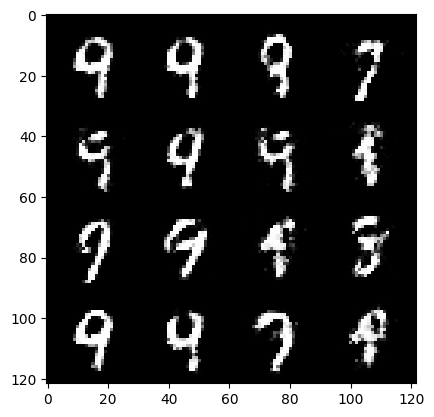

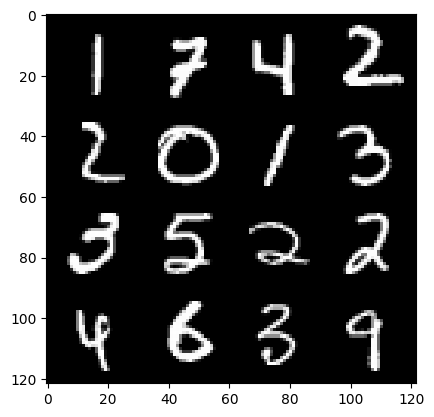

113: step 53400 / Gen loss: 3.1111805629730207 / disc_loss: 0.15175518177449718


  0%|          | 0/469 [00:00<?, ?it/s]

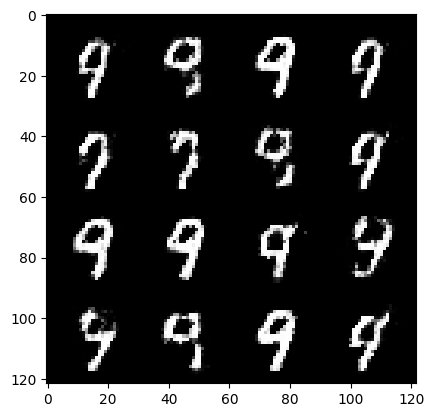

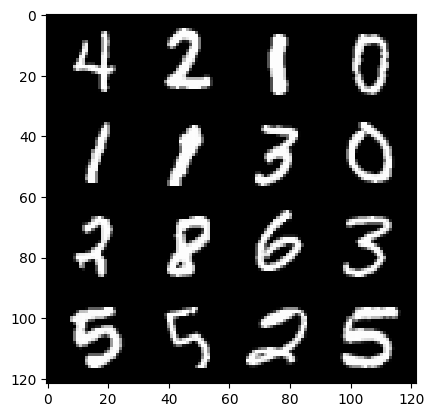

114: step 53700 / Gen loss: 3.1943655625979117 / disc_loss: 0.15329371847212317


  0%|          | 0/469 [00:00<?, ?it/s]

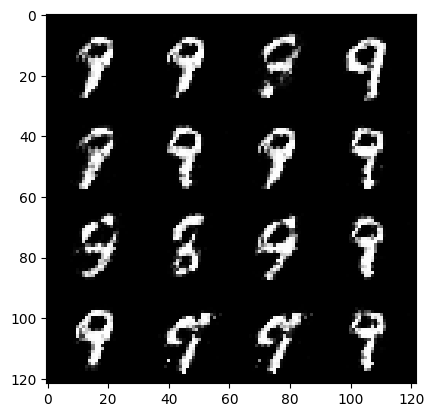

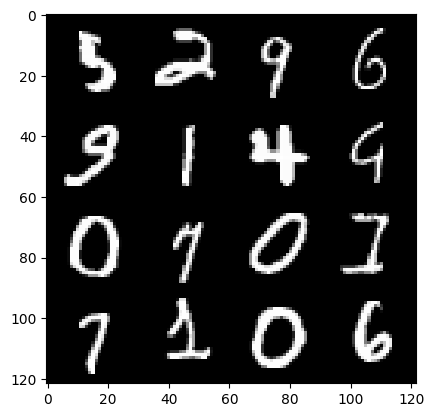

115: step 54000 / Gen loss: 3.0916896502176923 / disc_loss: 0.14939139932394035


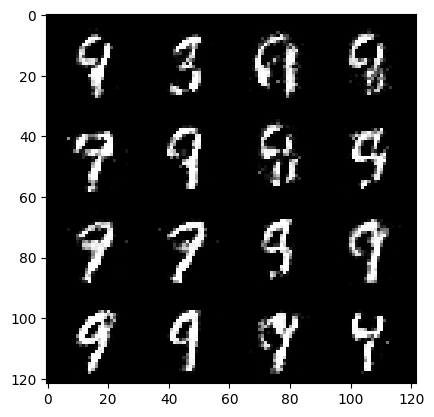

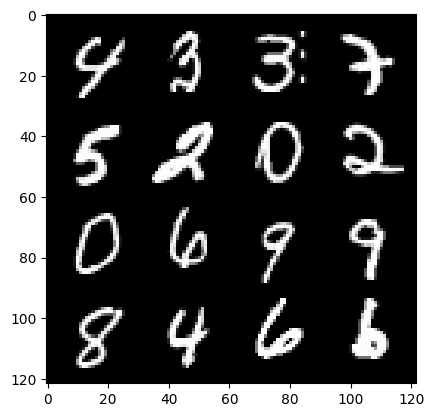

115: step 54300 / Gen loss: 3.258587435086567 / disc_loss: 0.14407773995151113


  0%|          | 0/469 [00:00<?, ?it/s]

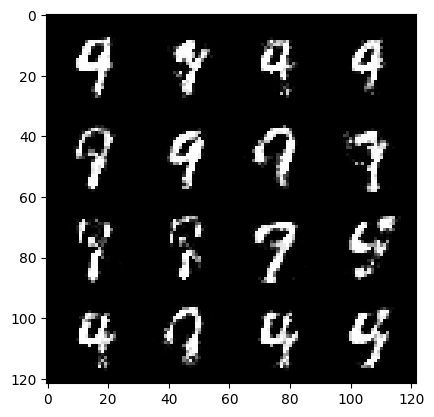

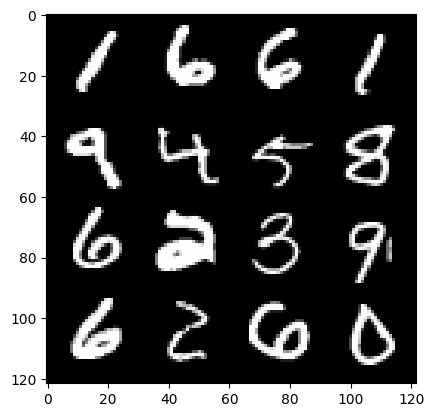

116: step 54600 / Gen loss: 3.064146382808685 / disc_loss: 0.16476149991154657


  0%|          | 0/469 [00:00<?, ?it/s]

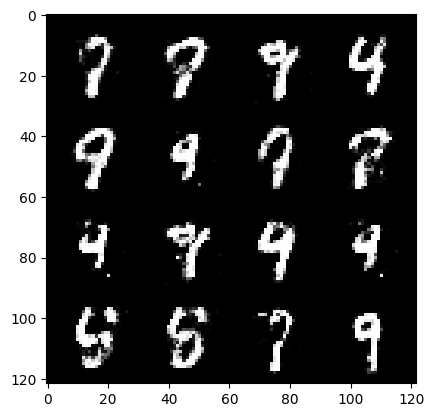

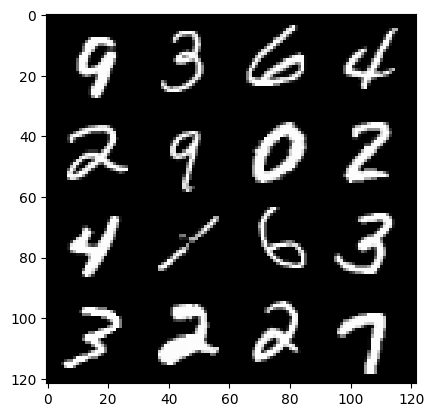

117: step 54900 / Gen loss: 2.9586101007461534 / disc_loss: 0.16939329547186688


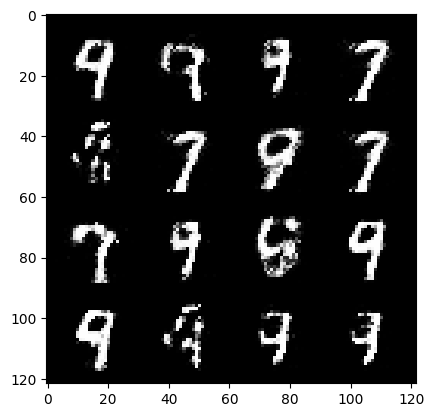

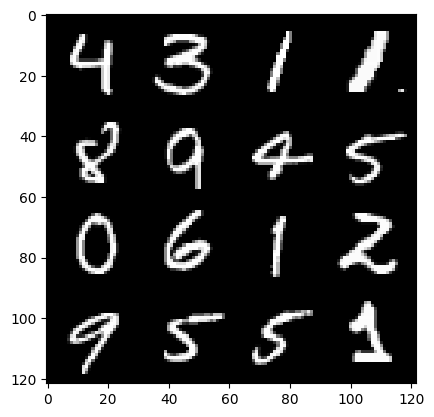

117: step 55200 / Gen loss: 3.1156285365422565 / disc_loss: 0.15170404533545173


  0%|          | 0/469 [00:00<?, ?it/s]

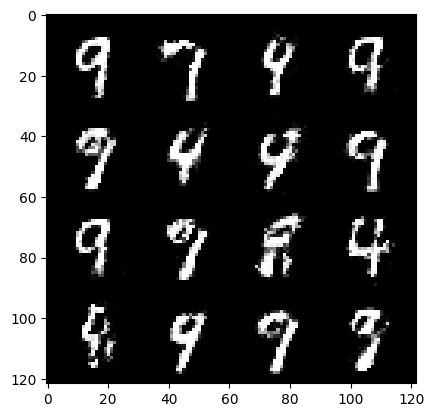

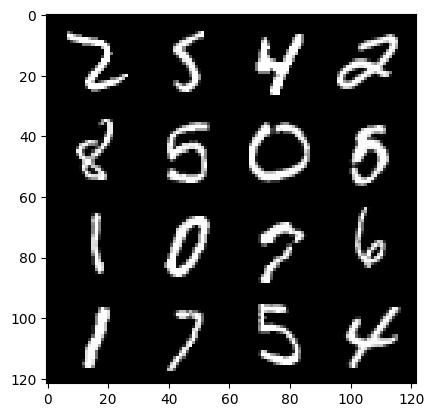

118: step 55500 / Gen loss: 3.141136208375295 / disc_loss: 0.14912268022696182


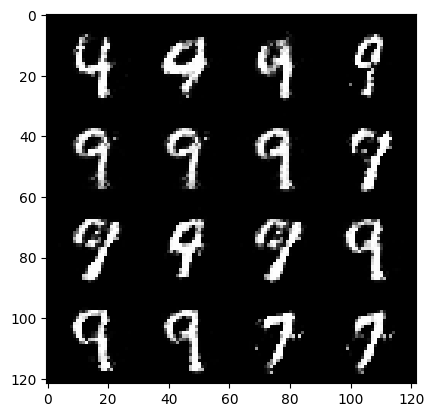

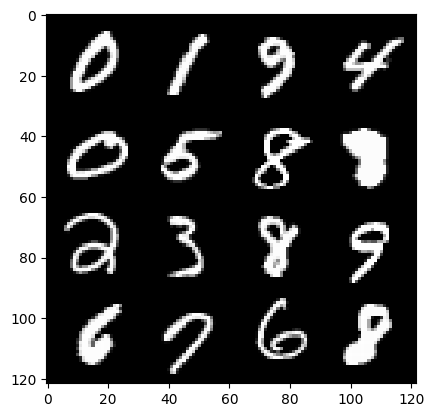

118: step 55800 / Gen loss: 2.9786009399096165 / disc_loss: 0.16752987280488005


  0%|          | 0/469 [00:00<?, ?it/s]

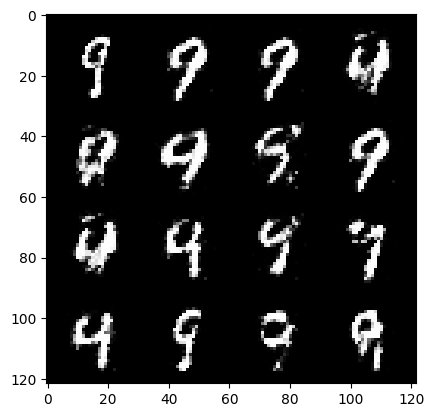

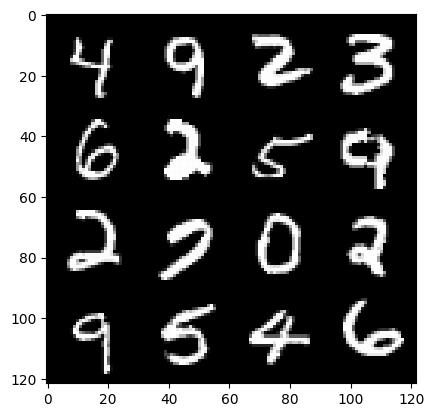

119: step 56100 / Gen loss: 3.0522155062357608 / disc_loss: 0.1667684351404508


  0%|          | 0/469 [00:00<?, ?it/s]

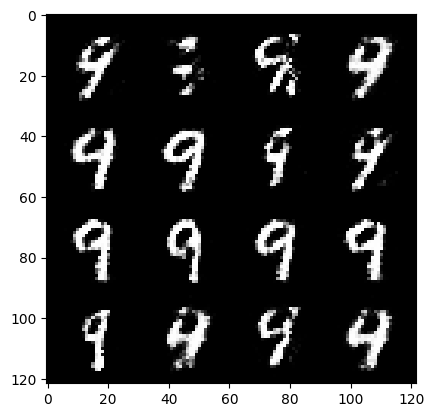

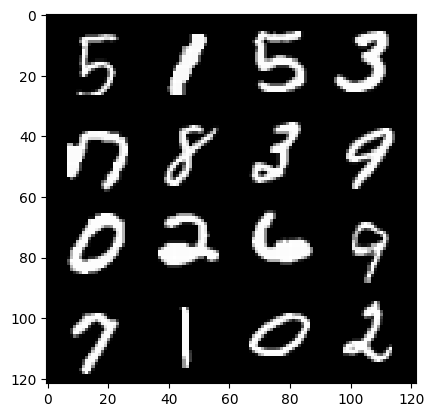

120: step 56400 / Gen loss: 2.9646378548940016 / disc_loss: 0.16398765976230298


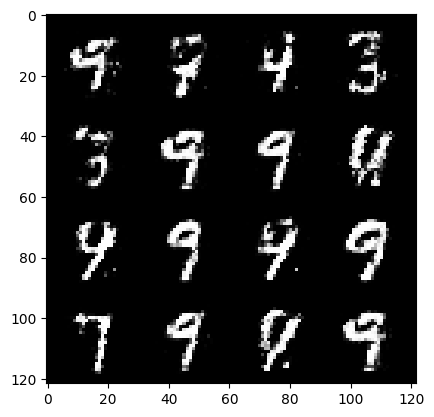

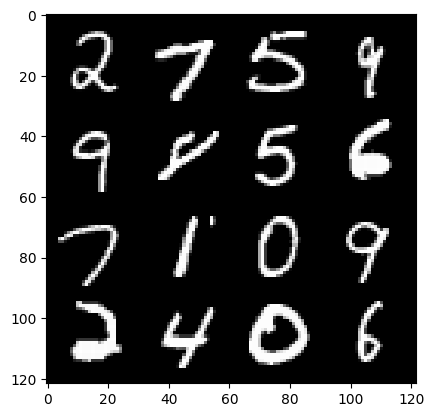

120: step 56700 / Gen loss: 2.9899382328987114 / disc_loss: 0.1588549677282571


  0%|          | 0/469 [00:00<?, ?it/s]

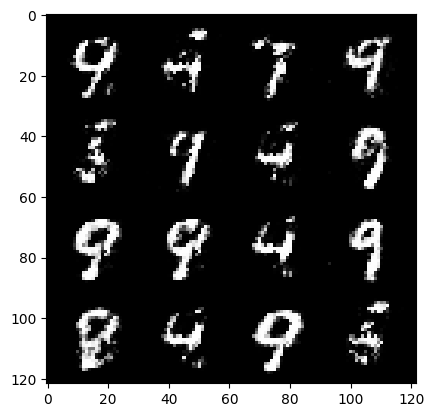

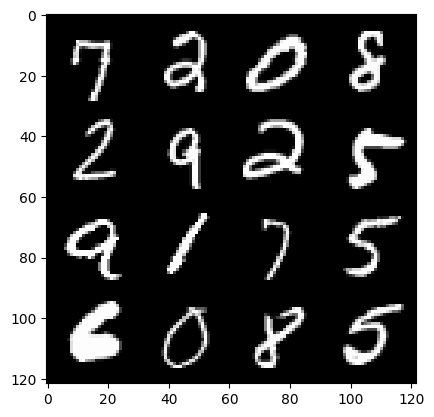

121: step 57000 / Gen loss: 3.069881405035651 / disc_loss: 0.16211973821123432


  0%|          | 0/469 [00:00<?, ?it/s]

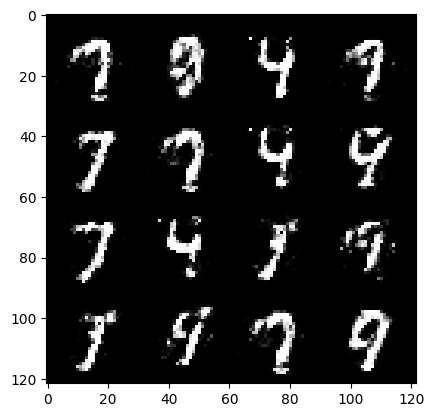

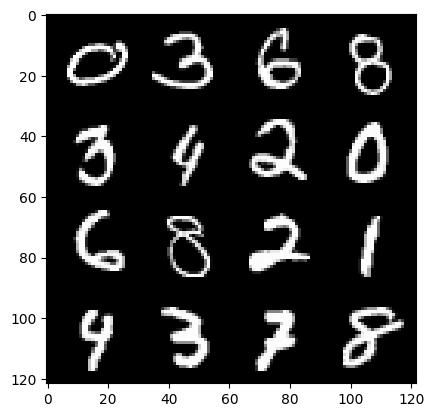

122: step 57300 / Gen loss: 2.780049631595611 / disc_loss: 0.19347922364870698


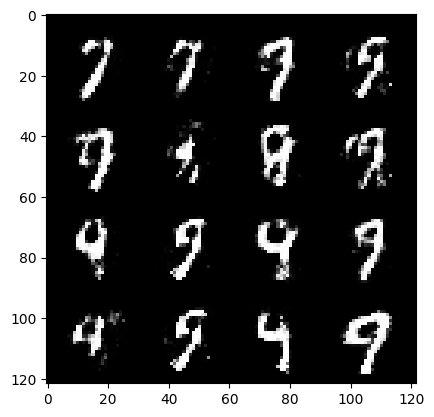

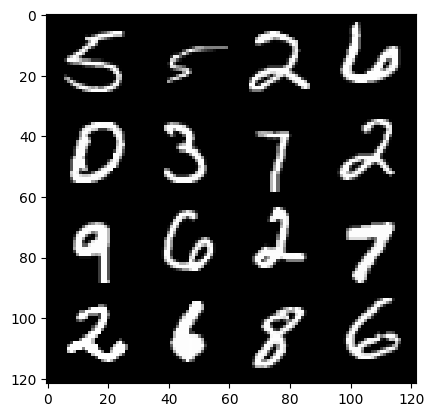

122: step 57600 / Gen loss: 2.9658675495783466 / disc_loss: 0.16252163350582124


  0%|          | 0/469 [00:00<?, ?it/s]

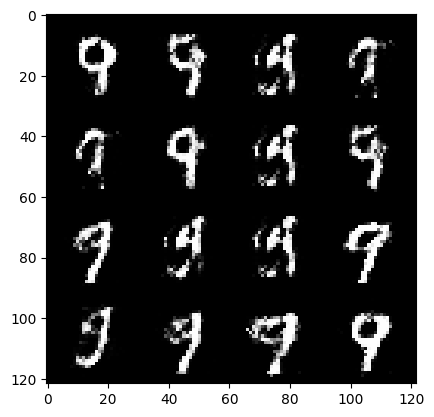

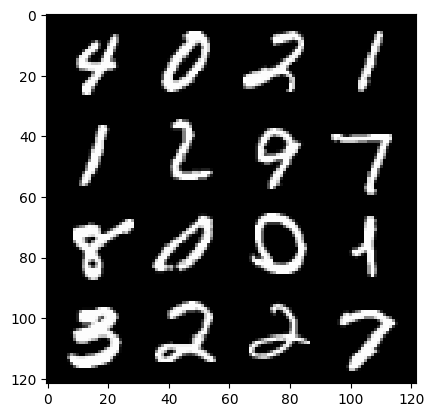

123: step 57900 / Gen loss: 3.1056356334686273 / disc_loss: 0.15067021342615294


  0%|          | 0/469 [00:00<?, ?it/s]

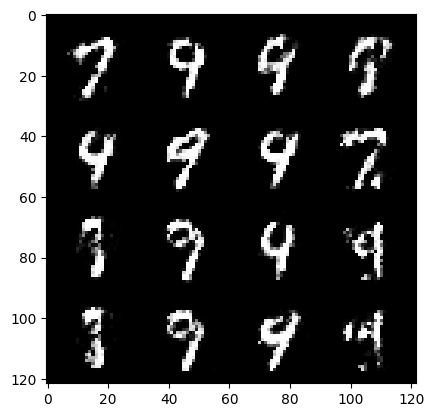

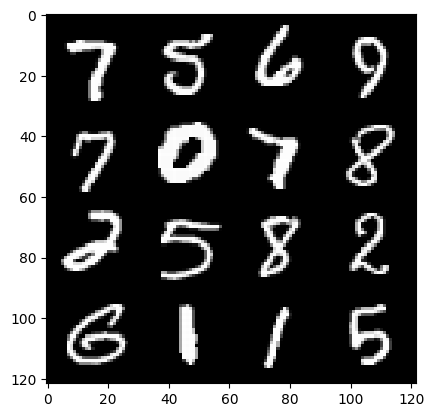

124: step 58200 / Gen loss: 3.0800080251693727 / disc_loss: 0.14528605016569293


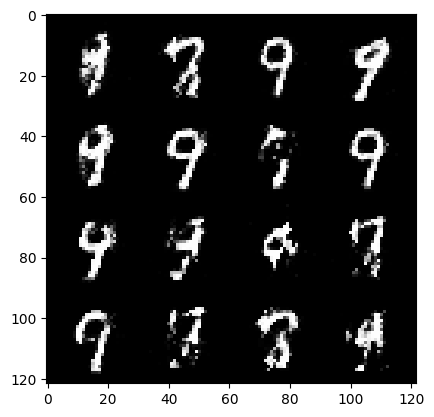

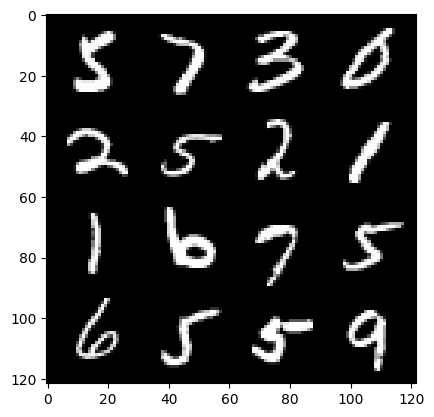

124: step 58500 / Gen loss: 3.202596584955853 / disc_loss: 0.1327002483606338


  0%|          | 0/469 [00:00<?, ?it/s]

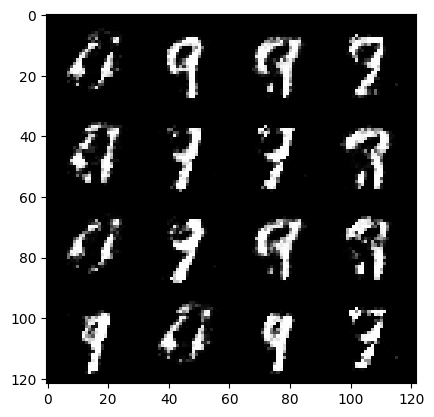

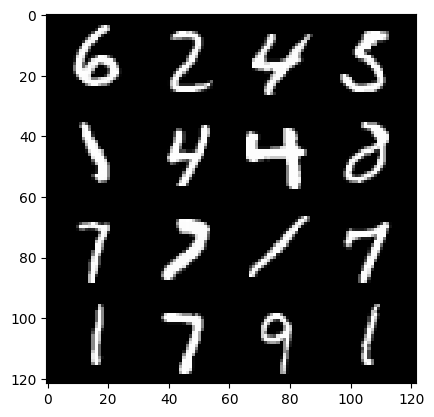

125: step 58800 / Gen loss: 3.2088808957735693 / disc_loss: 0.14313636407256133


  0%|          | 0/469 [00:00<?, ?it/s]

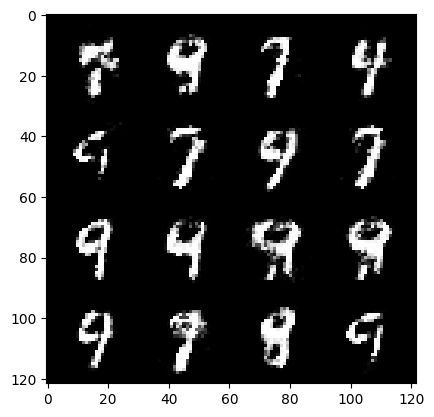

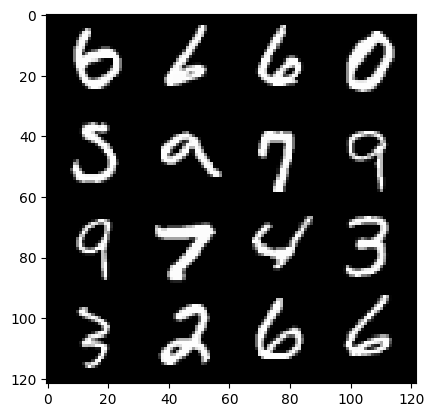

126: step 59100 / Gen loss: 3.1573672048250834 / disc_loss: 0.16078481934964658


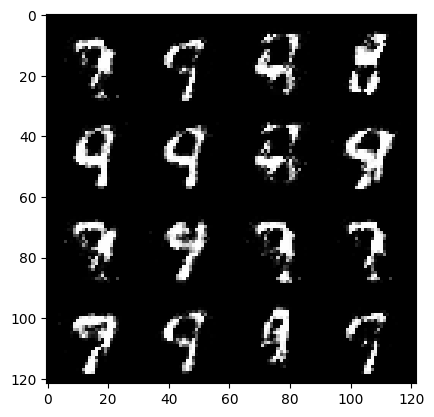

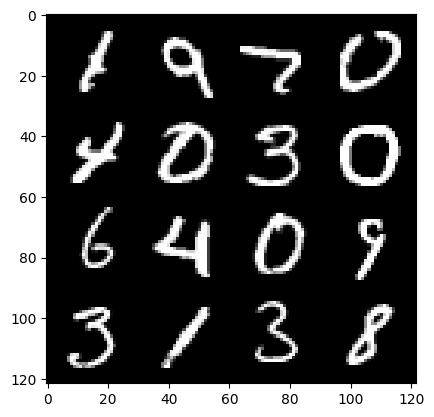

126: step 59400 / Gen loss: 3.2148323472340903 / disc_loss: 0.14478312221666176


  0%|          | 0/469 [00:00<?, ?it/s]

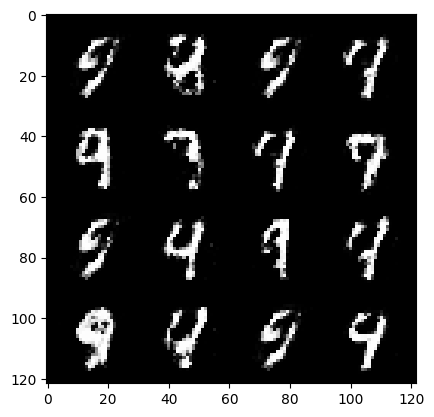

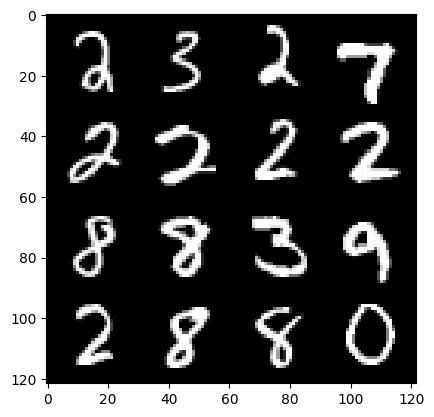

127: step 59700 / Gen loss: 3.0336161390940344 / disc_loss: 0.15462427422404296


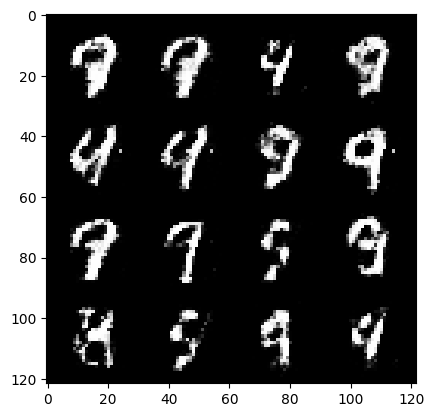

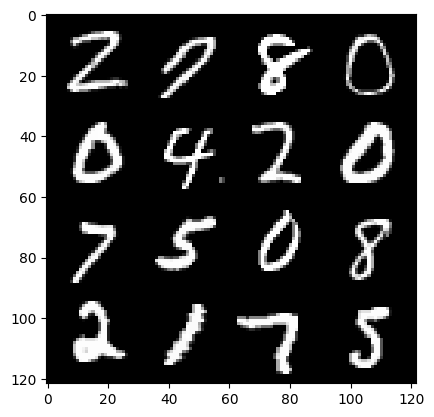

127: step 60000 / Gen loss: 3.032842928568524 / disc_loss: 0.16180519965787718


  0%|          | 0/469 [00:00<?, ?it/s]

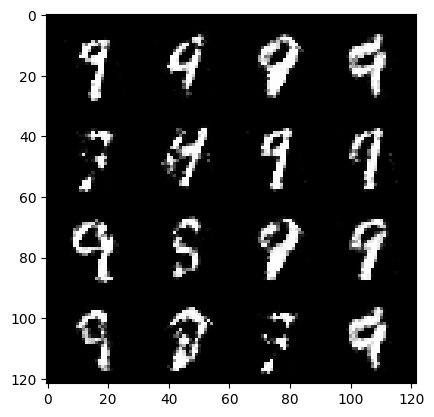

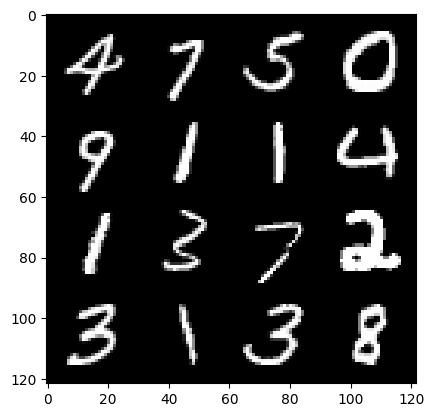

128: step 60300 / Gen loss: 3.01388991912206 / disc_loss: 0.16640562415122986


  0%|          | 0/469 [00:00<?, ?it/s]

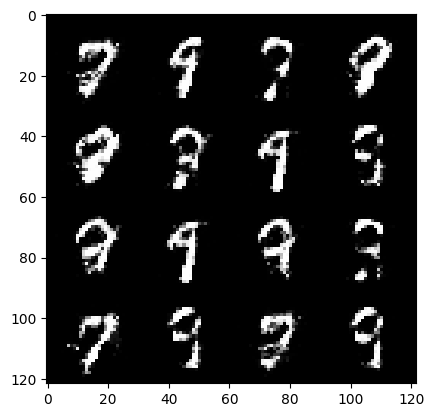

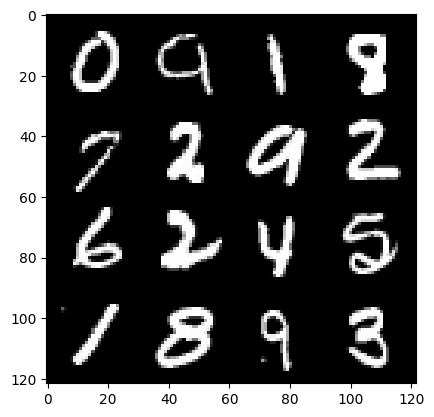

129: step 60600 / Gen loss: 2.869610923131306 / disc_loss: 0.16975662738084796


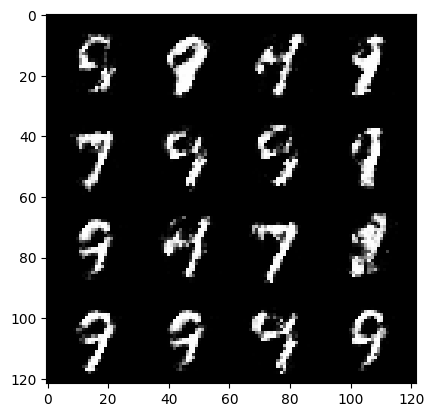

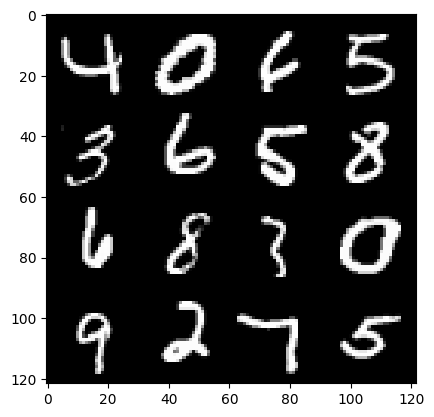

129: step 60900 / Gen loss: 3.025680396556858 / disc_loss: 0.14977893998225536


  0%|          | 0/469 [00:00<?, ?it/s]

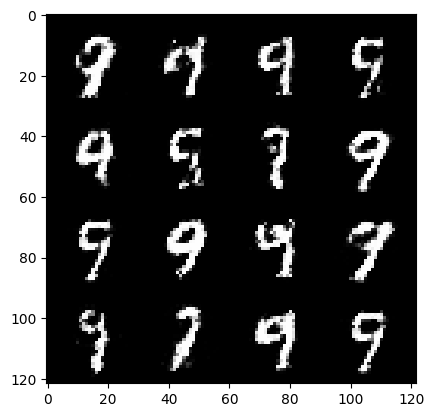

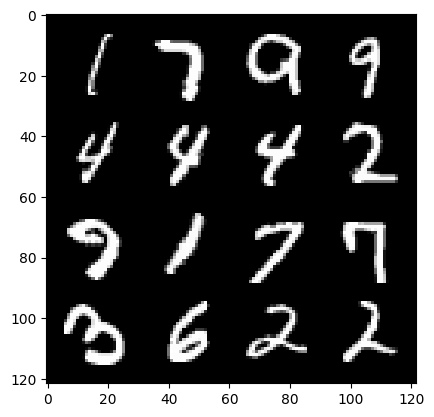

130: step 61200 / Gen loss: 2.9331023550033573 / disc_loss: 0.17483476407825949


  0%|          | 0/469 [00:00<?, ?it/s]

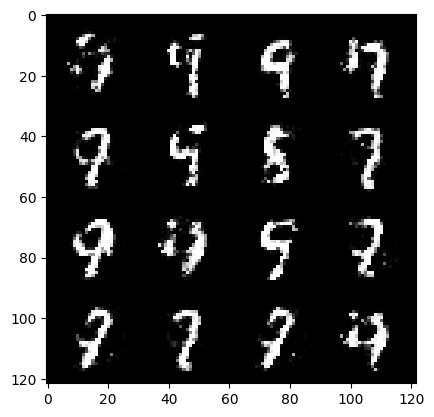

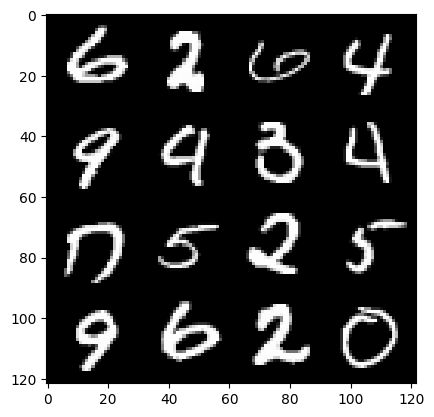

131: step 61500 / Gen loss: 2.9138150318463607 / disc_loss: 0.16784623637795446


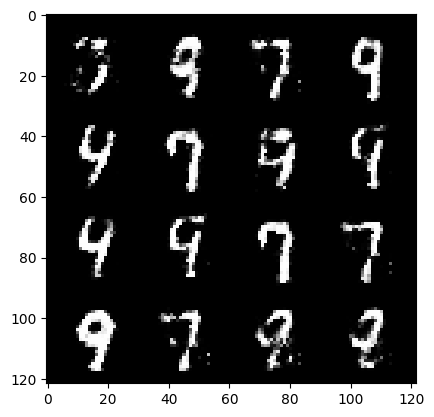

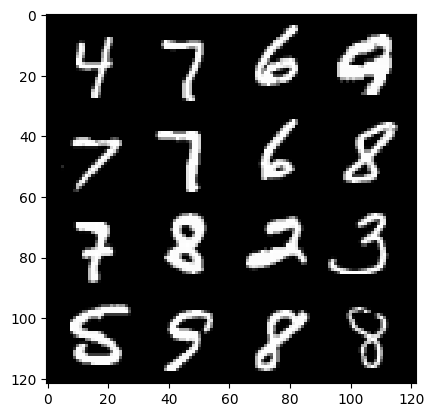

131: step 61800 / Gen loss: 2.868044113318126 / disc_loss: 0.17082178875803944


  0%|          | 0/469 [00:00<?, ?it/s]

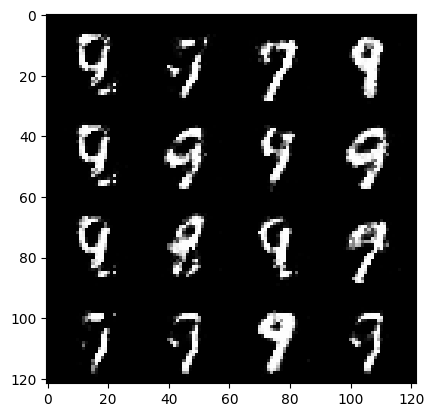

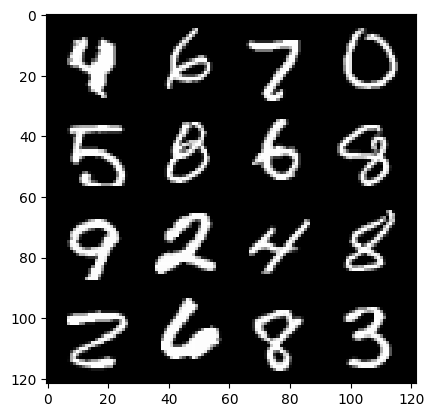

132: step 62100 / Gen loss: 2.7933054836591107 / disc_loss: 0.1846114745984474


  0%|          | 0/469 [00:00<?, ?it/s]

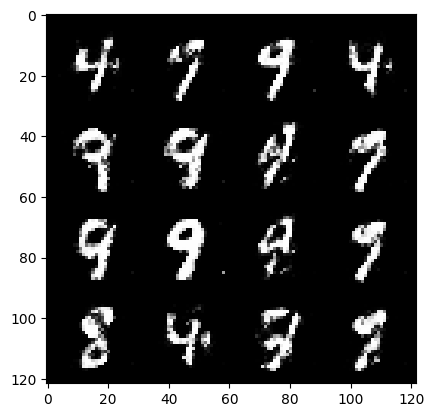

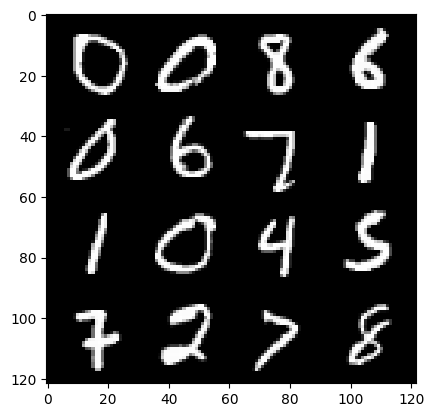

133: step 62400 / Gen loss: 2.8414141368865953 / disc_loss: 0.18027040270467606


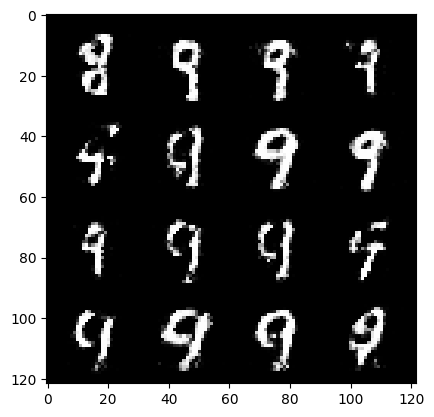

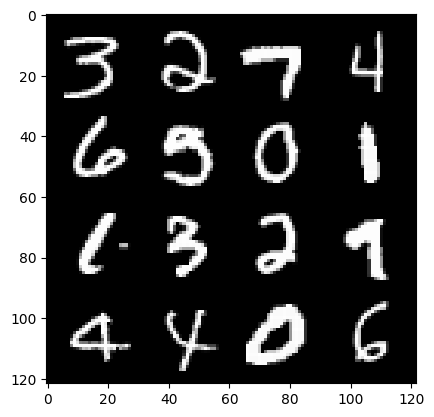

133: step 62700 / Gen loss: 2.871848224004112 / disc_loss: 0.17358486751715355


  0%|          | 0/469 [00:00<?, ?it/s]

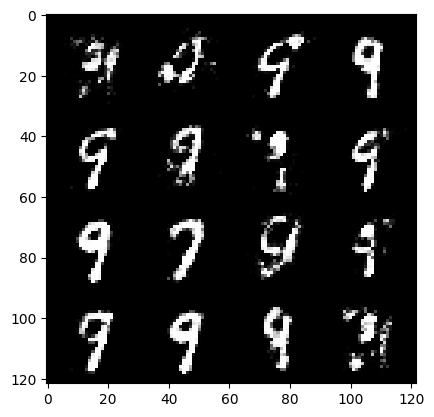

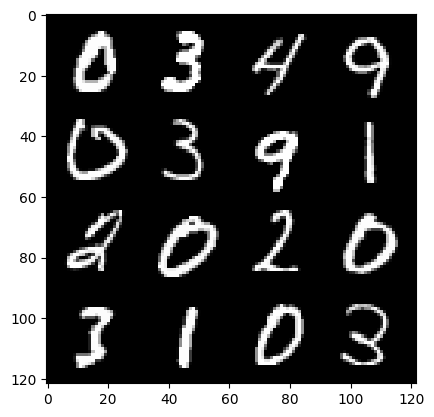

134: step 63000 / Gen loss: 2.9371785410245272 / disc_loss: 0.16493086911737903


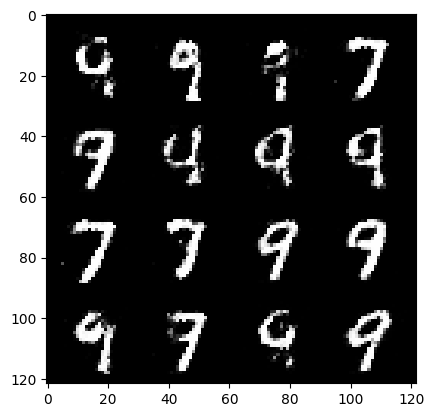

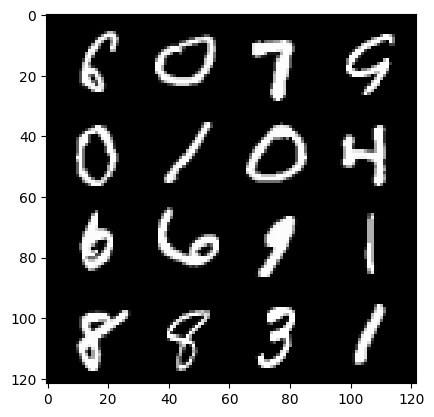

134: step 63300 / Gen loss: 3.0204229799906406 / disc_loss: 0.16772495085994407


  0%|          | 0/469 [00:00<?, ?it/s]

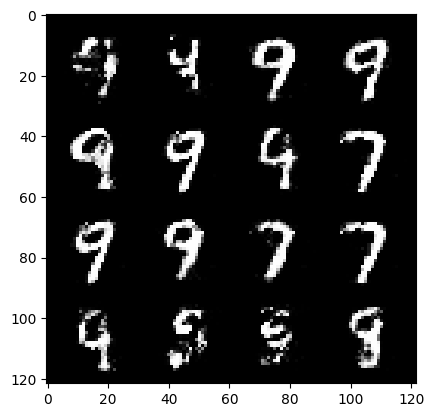

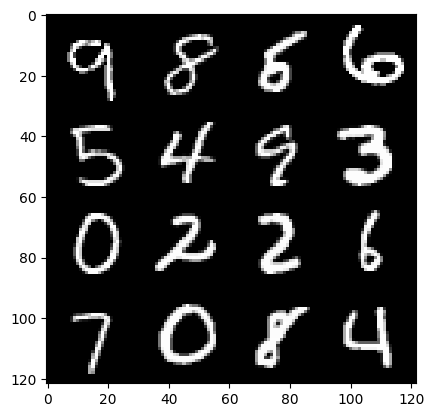

135: step 63600 / Gen loss: 2.742606313228608 / disc_loss: 0.19143322202066562


  0%|          | 0/469 [00:00<?, ?it/s]

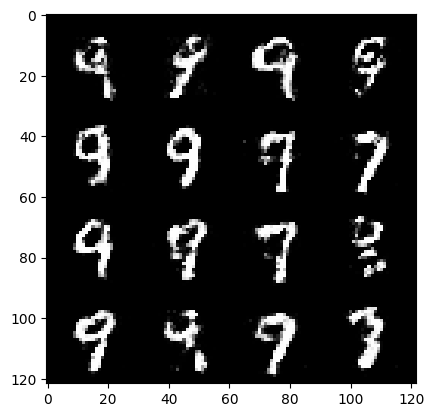

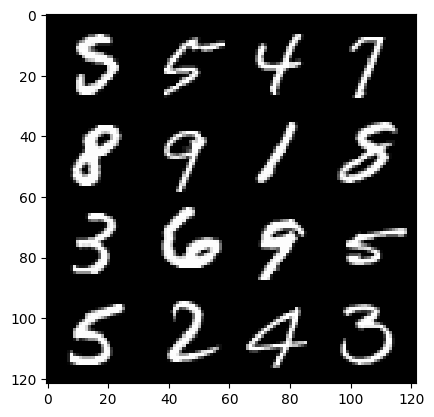

136: step 63900 / Gen loss: 2.832680275440215 / disc_loss: 0.1909018685172002


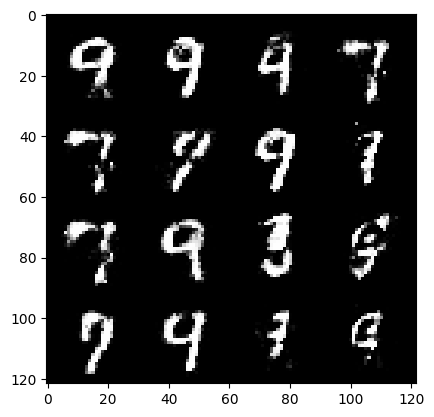

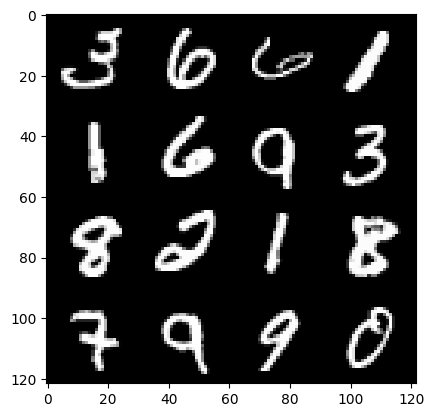

136: step 64200 / Gen loss: 2.678754358291627 / disc_loss: 0.19220810706416763


  0%|          | 0/469 [00:00<?, ?it/s]

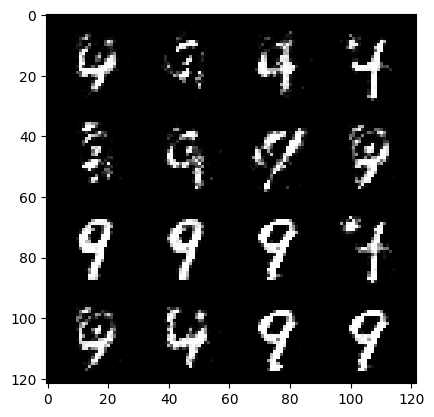

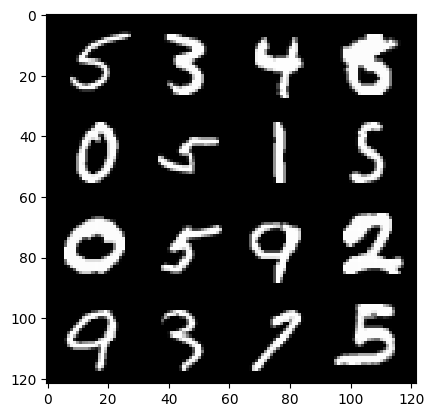

137: step 64500 / Gen loss: 2.8446116844813014 / disc_loss: 0.1804467535267274


  0%|          | 0/469 [00:00<?, ?it/s]

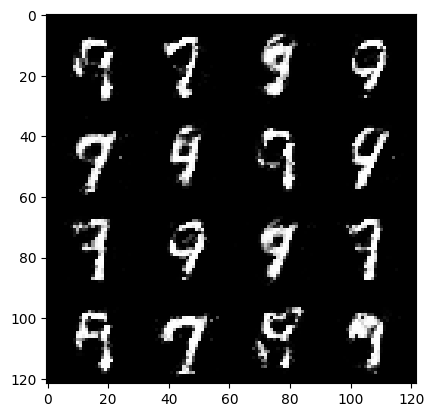

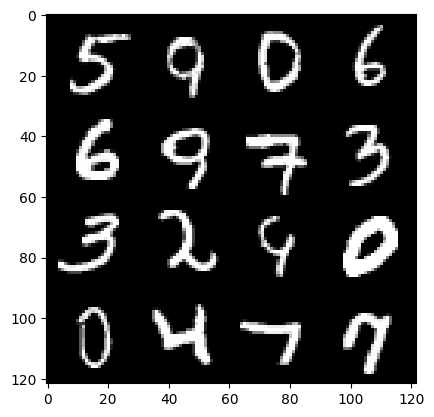

138: step 64800 / Gen loss: 2.6755009643236787 / disc_loss: 0.2103871374328931


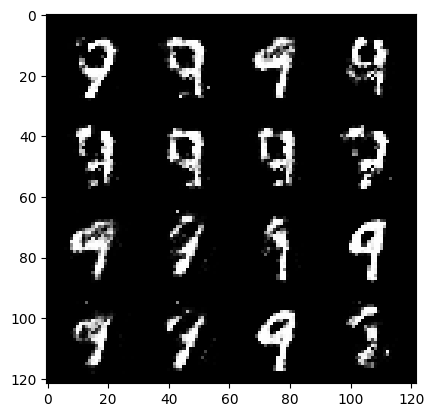

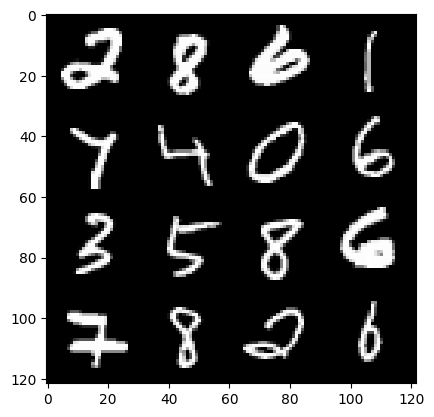

138: step 65100 / Gen loss: 2.662364927132924 / disc_loss: 0.18799937747418877


  0%|          | 0/469 [00:00<?, ?it/s]

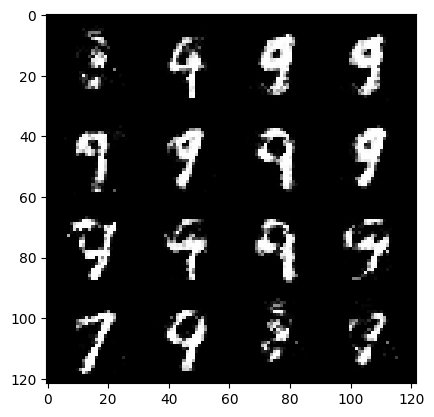

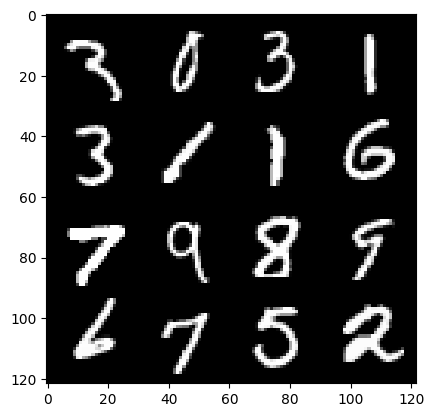

139: step 65400 / Gen loss: 2.886538309256235 / disc_loss: 0.17554751008749006


  0%|          | 0/469 [00:00<?, ?it/s]

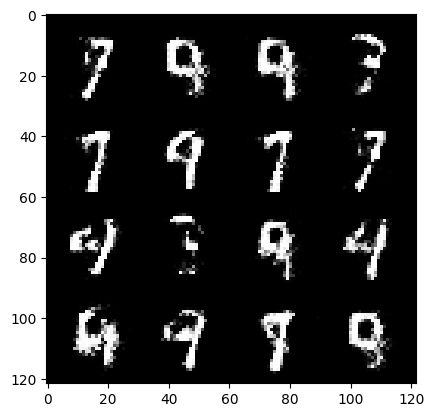

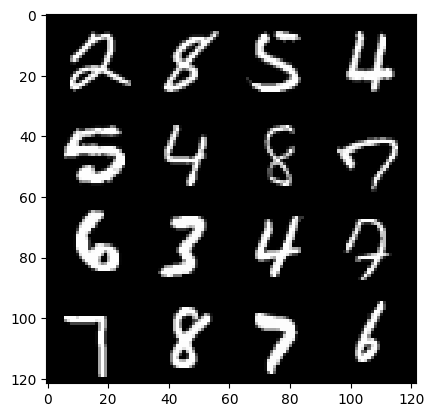

140: step 65700 / Gen loss: 2.824857802391053 / disc_loss: 0.16702654821177318


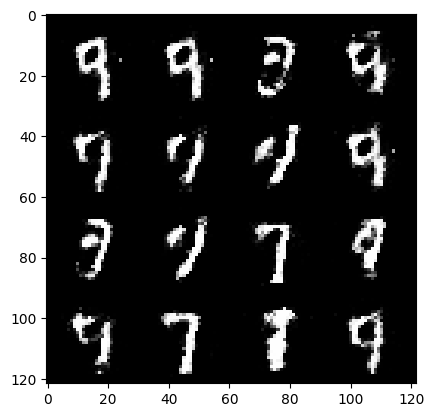

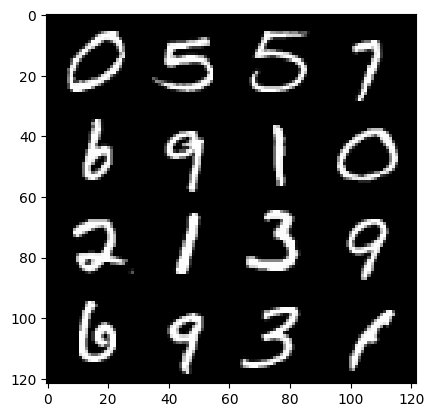

140: step 66000 / Gen loss: 2.88563900232315 / disc_loss: 0.16631466604769227


  0%|          | 0/469 [00:00<?, ?it/s]

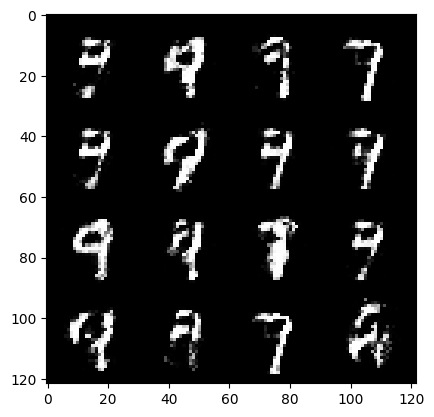

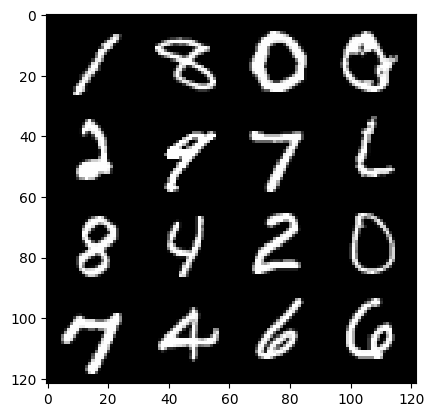

141: step 66300 / Gen loss: 2.852589893341067 / disc_loss: 0.1823765523731709


  0%|          | 0/469 [00:00<?, ?it/s]

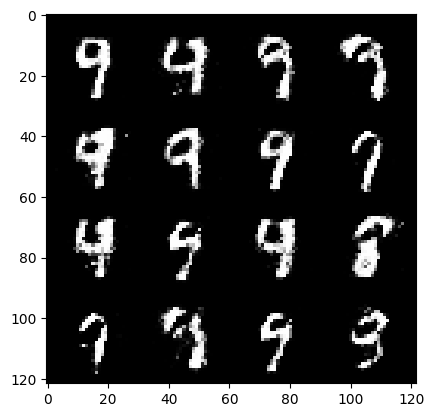

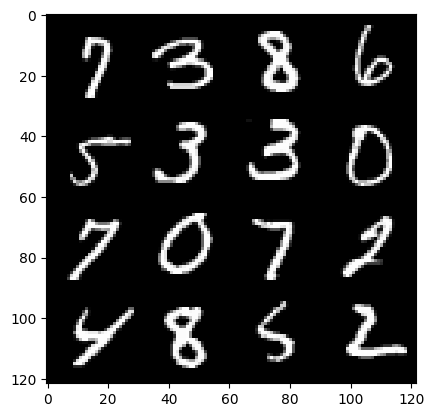

142: step 66600 / Gen loss: 2.748229163487754 / disc_loss: 0.19344861507415775


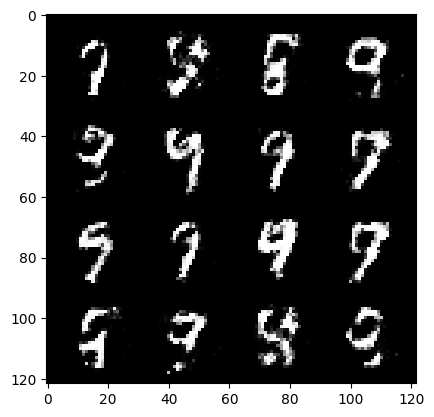

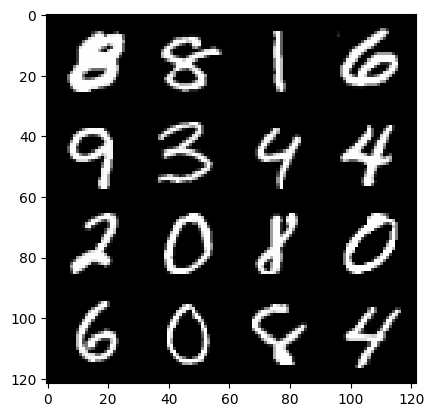

142: step 66900 / Gen loss: 2.7691325521469112 / disc_loss: 0.17172893196344385


  0%|          | 0/469 [00:00<?, ?it/s]

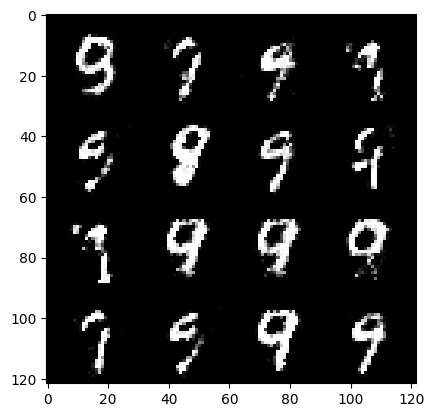

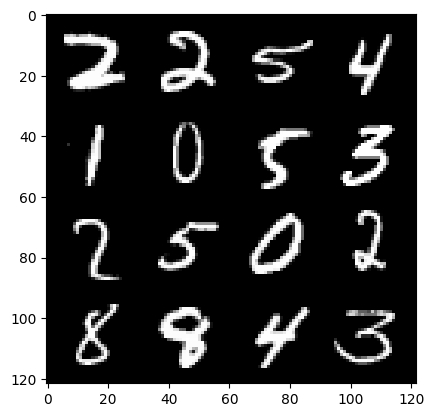

143: step 67200 / Gen loss: 2.7779590415954587 / disc_loss: 0.17628265562156842


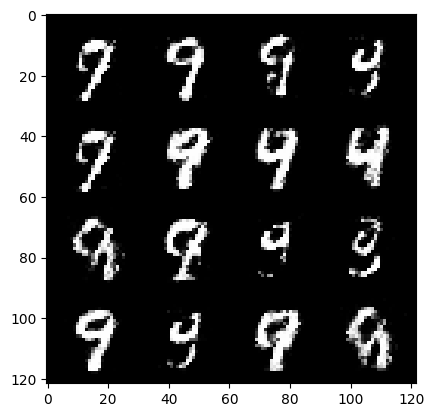

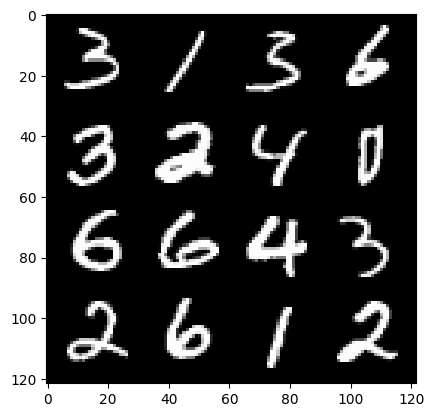

143: step 67500 / Gen loss: 2.8304780515035 / disc_loss: 0.17321986697614186


  0%|          | 0/469 [00:00<?, ?it/s]

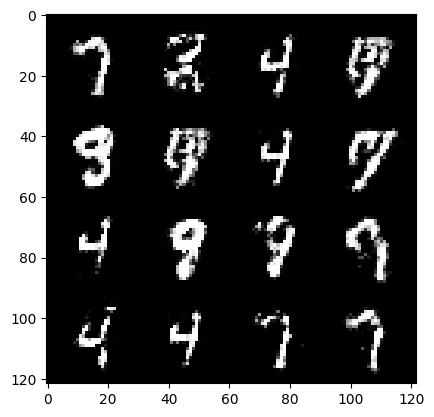

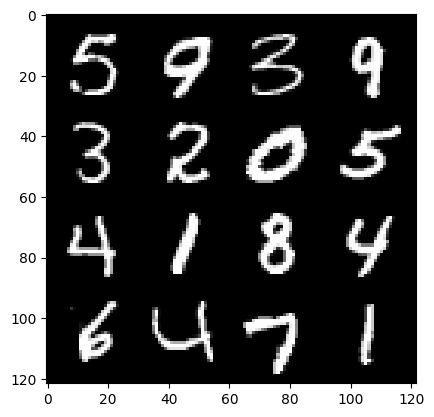

144: step 67800 / Gen loss: 2.795047794183095 / disc_loss: 0.17344943647583322


  0%|          | 0/469 [00:00<?, ?it/s]

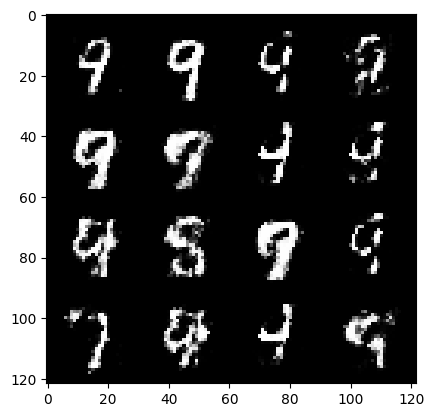

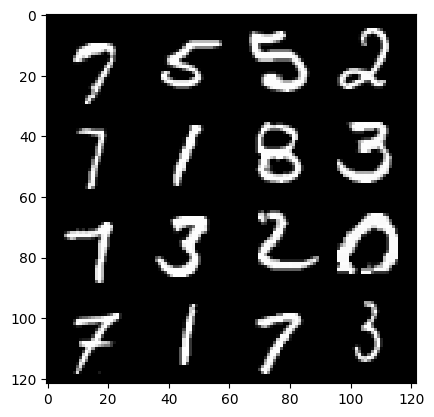

145: step 68100 / Gen loss: 2.6105782524744683 / disc_loss: 0.20653010678788028


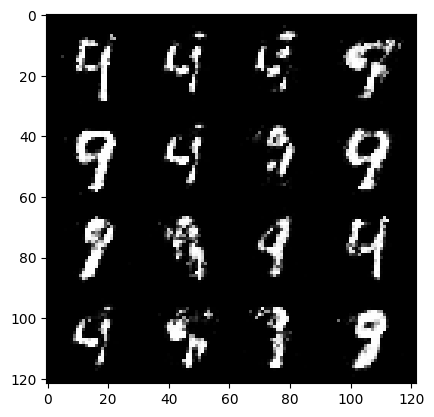

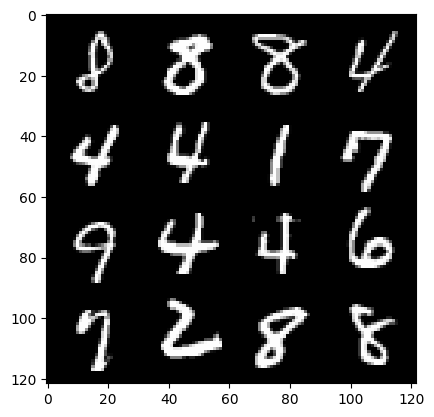

145: step 68400 / Gen loss: 2.5981744547684986 / disc_loss: 0.2130716169377169


  0%|          | 0/469 [00:00<?, ?it/s]

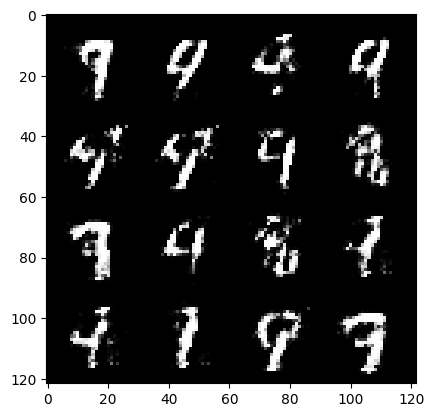

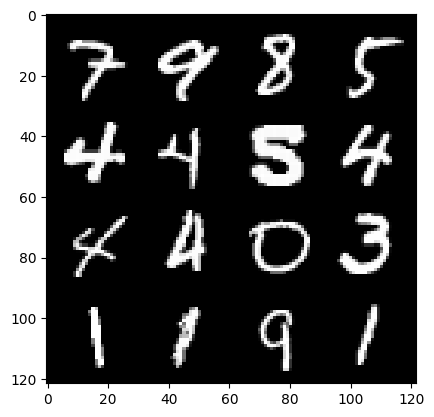

146: step 68700 / Gen loss: 2.577210488319397 / disc_loss: 0.20519340085486565


  0%|          | 0/469 [00:00<?, ?it/s]

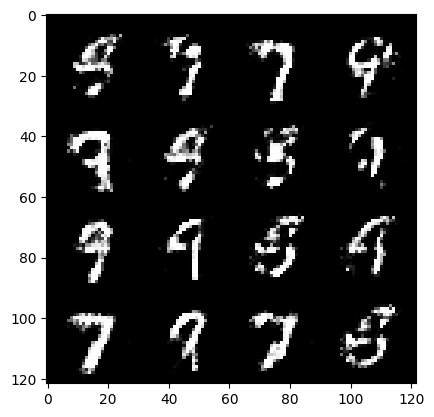

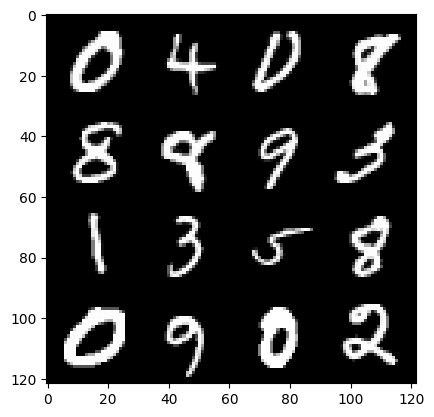

147: step 69000 / Gen loss: 2.6811841940879817 / disc_loss: 0.20154170386493217


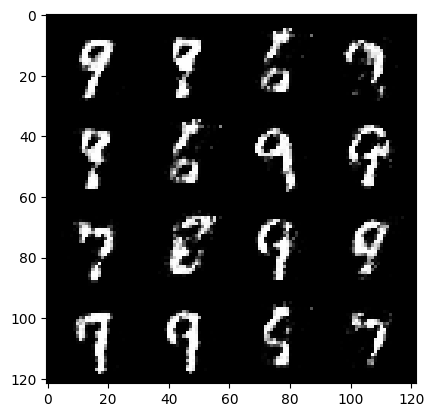

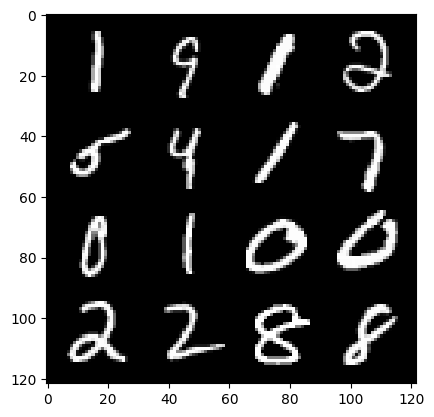

147: step 69300 / Gen loss: 2.578092443148293 / disc_loss: 0.21242739523450524


  0%|          | 0/469 [00:00<?, ?it/s]

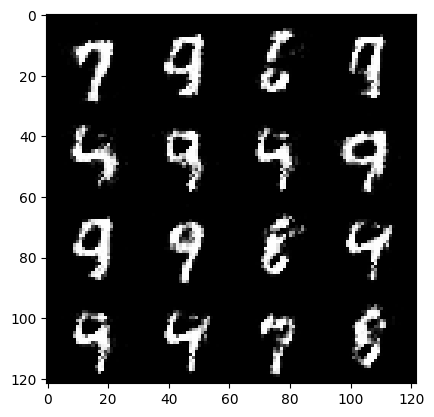

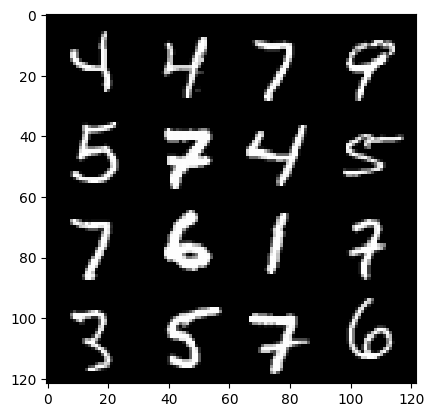

148: step 69600 / Gen loss: 2.6908970304330184 / disc_loss: 0.19824148148298257


  0%|          | 0/469 [00:00<?, ?it/s]

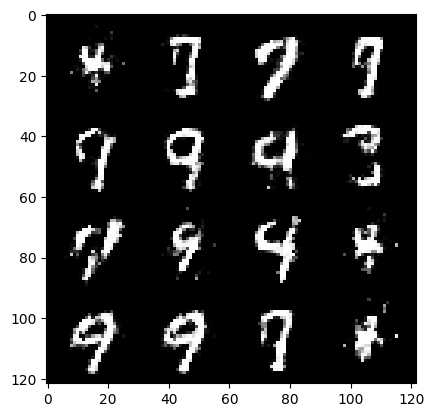

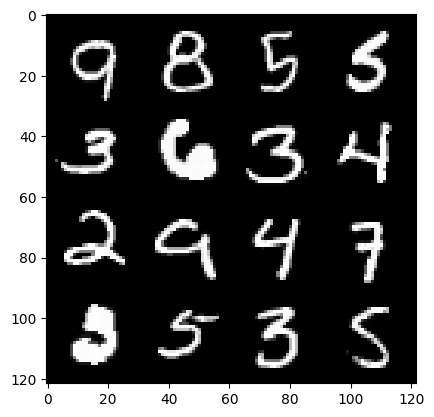

149: step 69900 / Gen loss: 2.5758229192097977 / disc_loss: 0.2161843583484491


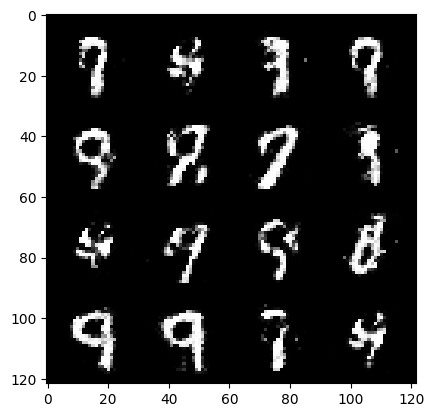

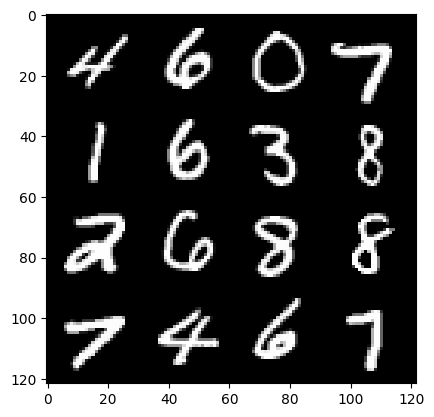

149: step 70200 / Gen loss: 2.6325021060307825 / disc_loss: 0.2013407544294993


  0%|          | 0/469 [00:00<?, ?it/s]

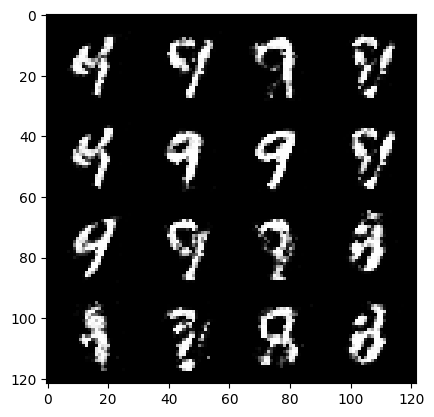

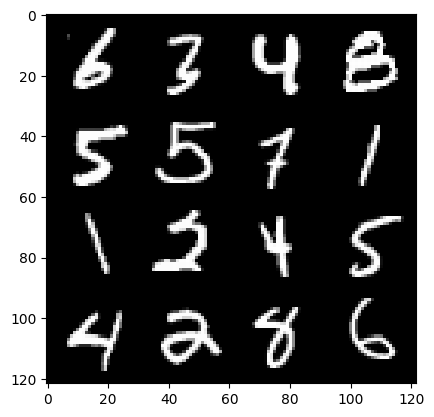

150: step 70500 / Gen loss: 2.576890115737915 / disc_loss: 0.2161491295695305


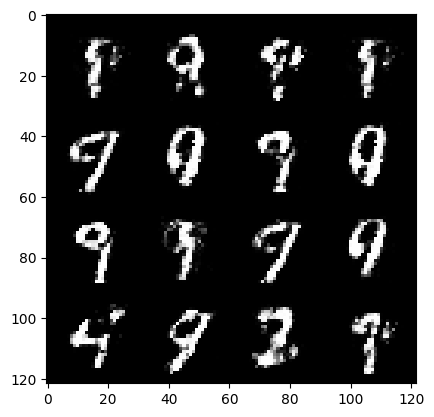

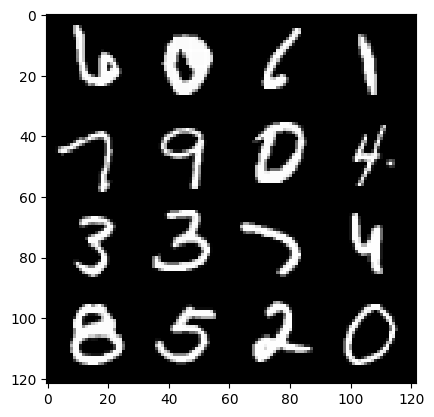

150: step 70800 / Gen loss: 2.608734591801961 / disc_loss: 0.20042666276295976


  0%|          | 0/469 [00:00<?, ?it/s]

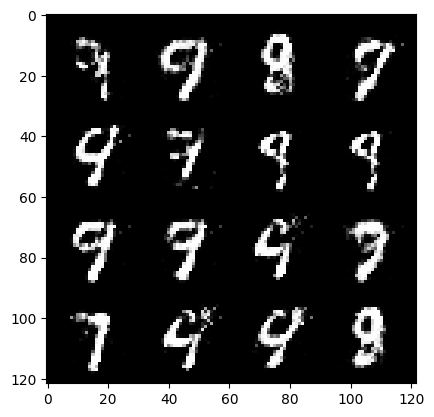

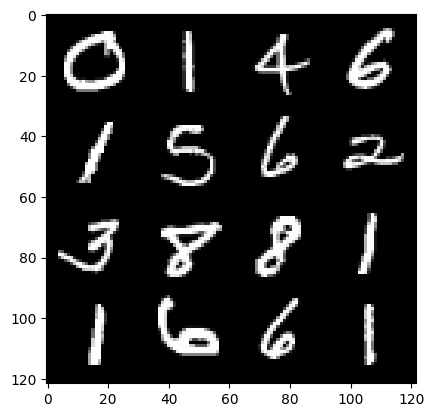

151: step 71100 / Gen loss: 2.6224896009763055 / disc_loss: 0.19930651585261028


  0%|          | 0/469 [00:00<?, ?it/s]

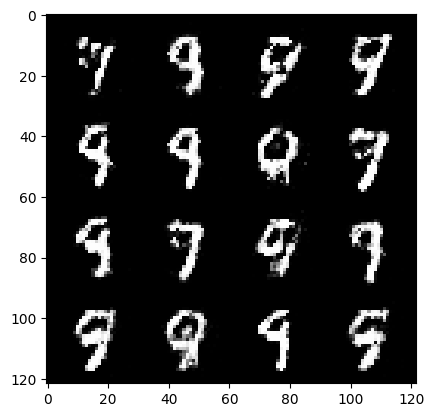

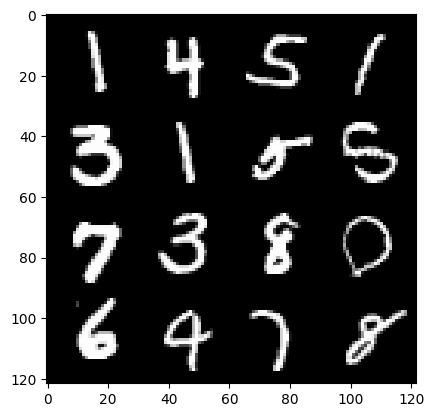

152: step 71400 / Gen loss: 2.8320626227060974 / disc_loss: 0.18954287139077983


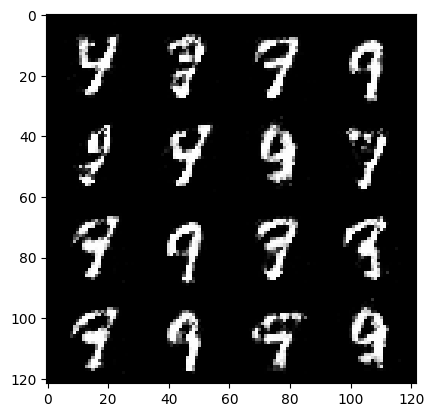

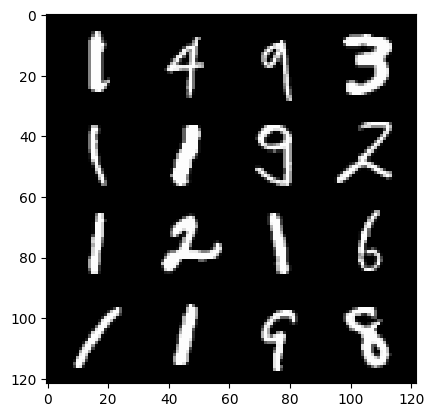

152: step 71700 / Gen loss: 2.651845262845358 / disc_loss: 0.192021590222915


  0%|          | 0/469 [00:00<?, ?it/s]

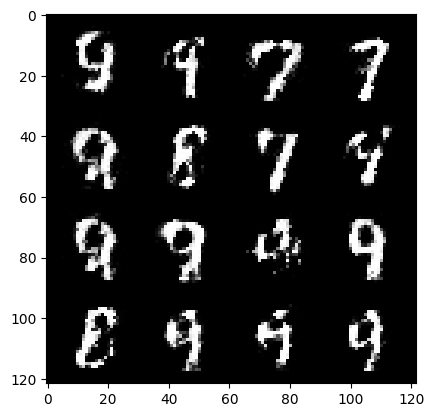

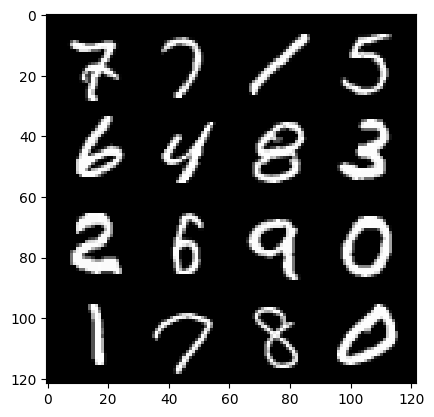

153: step 72000 / Gen loss: 2.7485299015045155 / disc_loss: 0.1808277893811463


  0%|          | 0/469 [00:00<?, ?it/s]

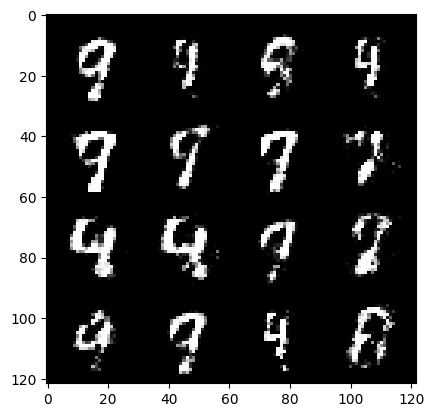

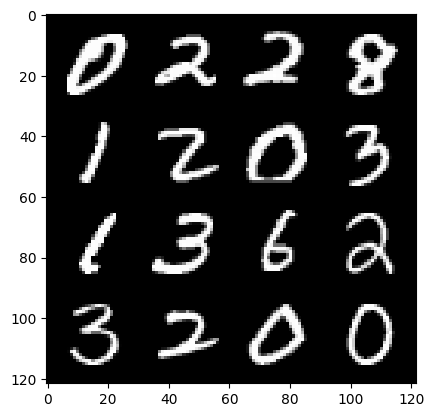

154: step 72300 / Gen loss: 2.747564185460411 / disc_loss: 0.17969189698497448


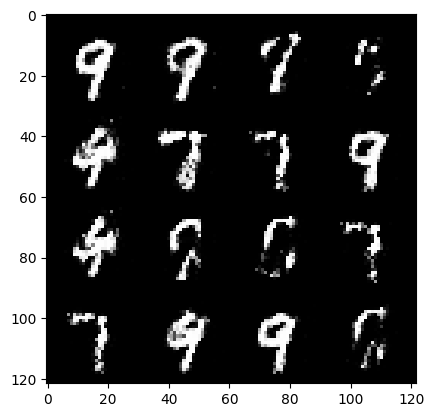

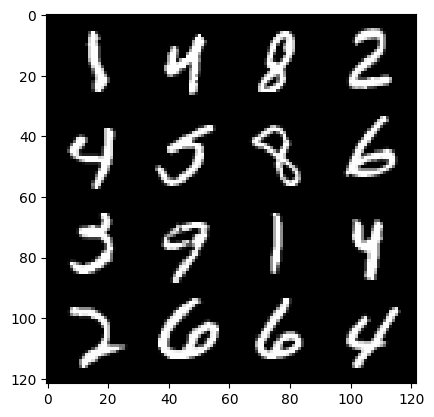

154: step 72600 / Gen loss: 2.756008769671125 / disc_loss: 0.18165678359568124


  0%|          | 0/469 [00:00<?, ?it/s]

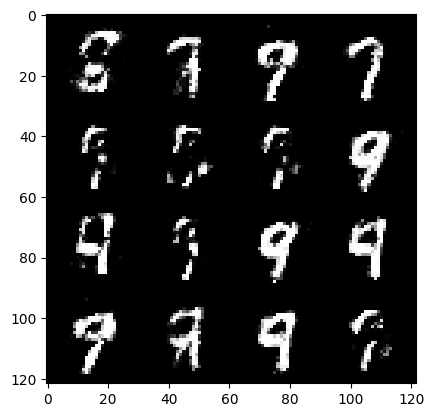

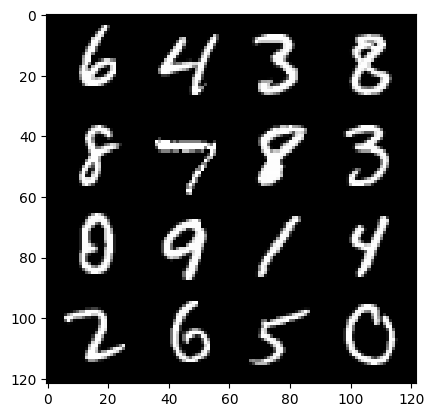

155: step 72900 / Gen loss: 2.564878075917561 / disc_loss: 0.20077066553135717


  0%|          | 0/469 [00:00<?, ?it/s]

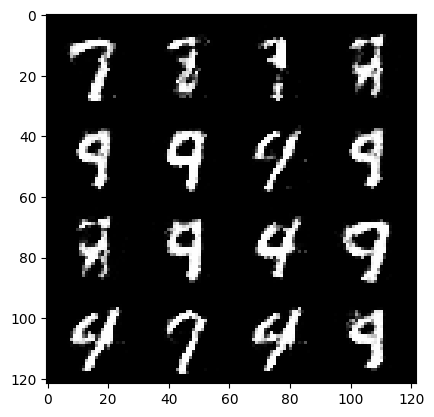

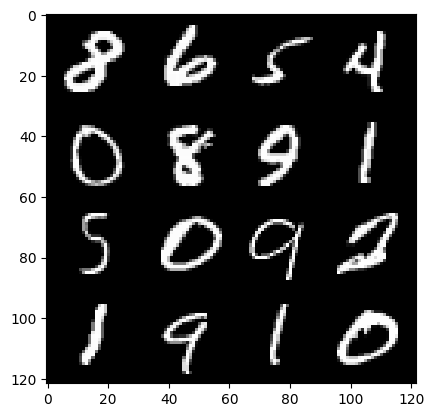

156: step 73200 / Gen loss: 2.5796399426460264 / disc_loss: 0.19937106117606157


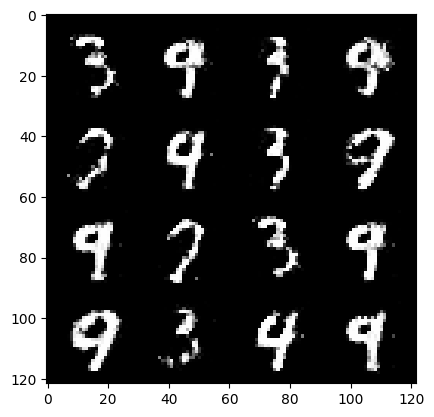

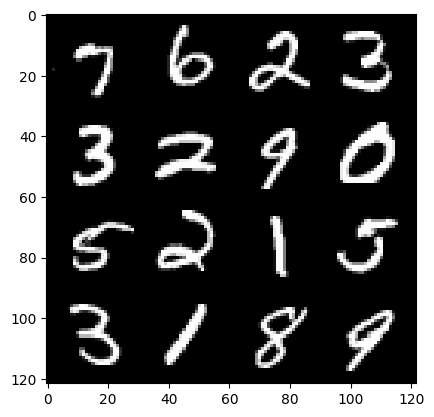

156: step 73500 / Gen loss: 2.671985051631928 / disc_loss: 0.19200767062604424


  0%|          | 0/469 [00:00<?, ?it/s]

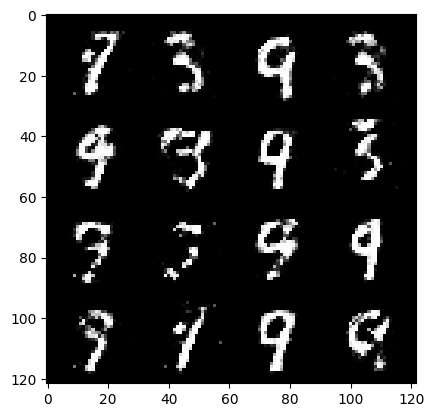

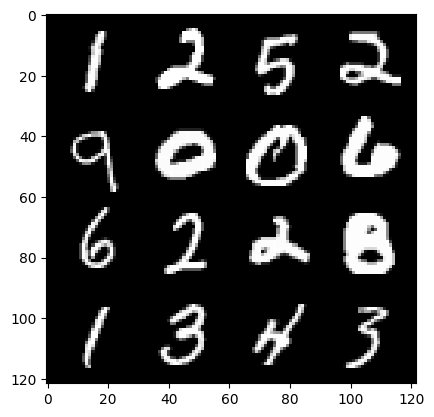

157: step 73800 / Gen loss: 2.7339538335800153 / disc_loss: 0.18907064341008673


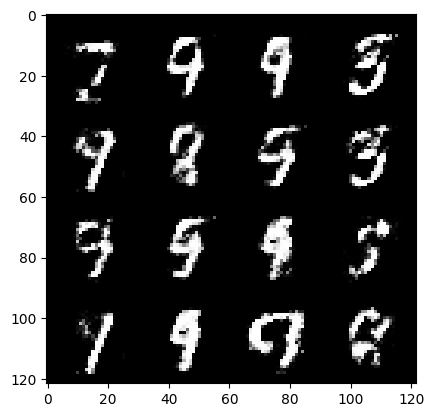

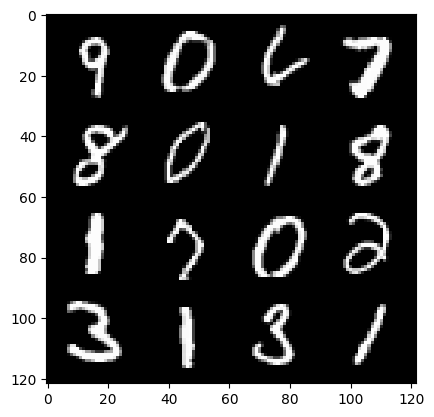

157: step 74100 / Gen loss: 2.540359578132631 / disc_loss: 0.21202399325867496


  0%|          | 0/469 [00:00<?, ?it/s]

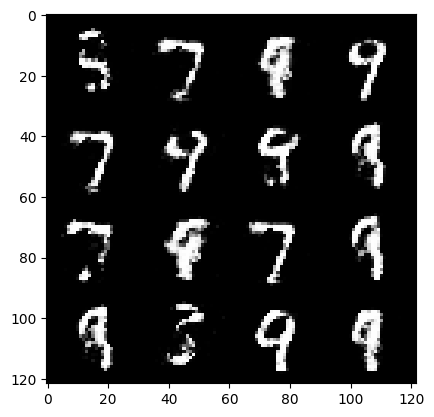

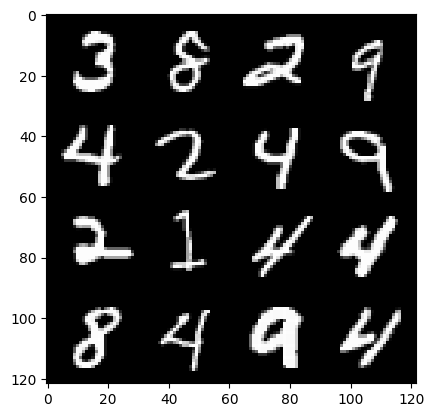

158: step 74400 / Gen loss: 2.613296345869701 / disc_loss: 0.19107571062942352


  0%|          | 0/469 [00:00<?, ?it/s]

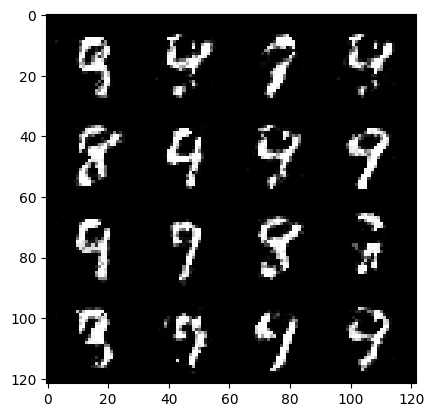

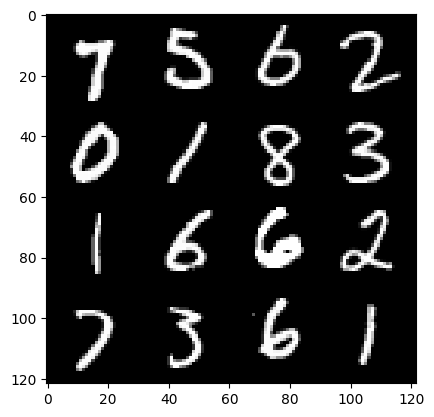

159: step 74700 / Gen loss: 2.5011535199483226 / disc_loss: 0.20819254363576575


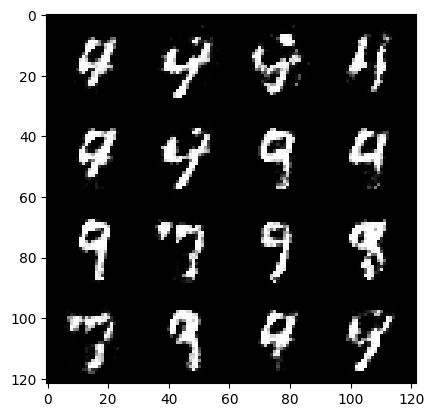

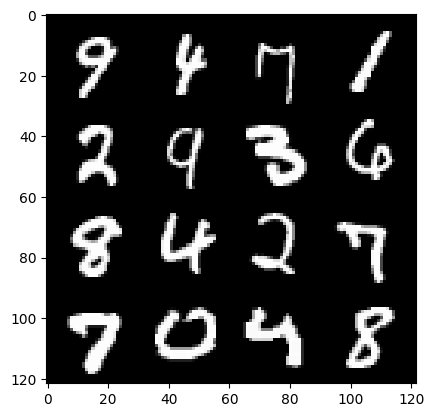

159: step 75000 / Gen loss: 2.4740713346004477 / disc_loss: 0.22428009529908505


  0%|          | 0/469 [00:00<?, ?it/s]

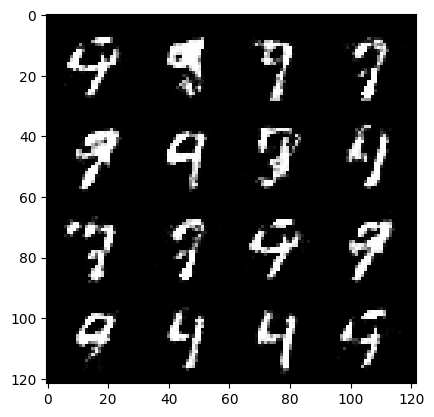

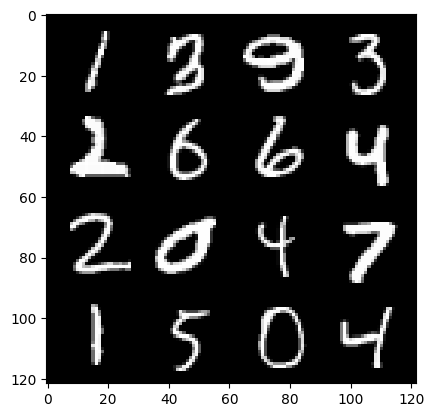

160: step 75300 / Gen loss: 2.5539016040166227 / disc_loss: 0.20000956286986665


  0%|          | 0/469 [00:00<?, ?it/s]

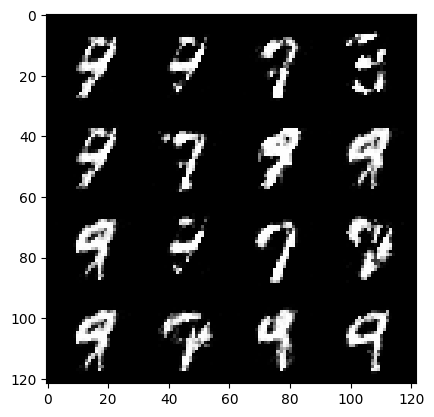

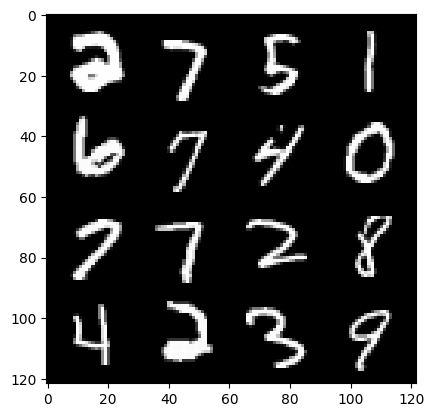

161: step 75600 / Gen loss: 2.568983297348022 / disc_loss: 0.21293588228523722


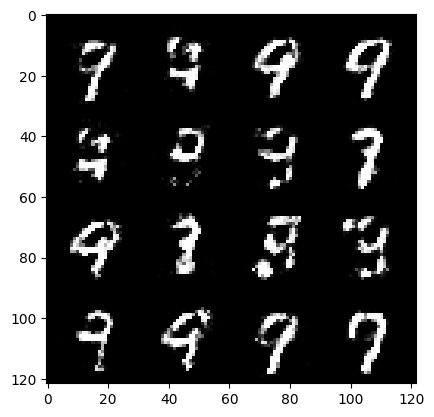

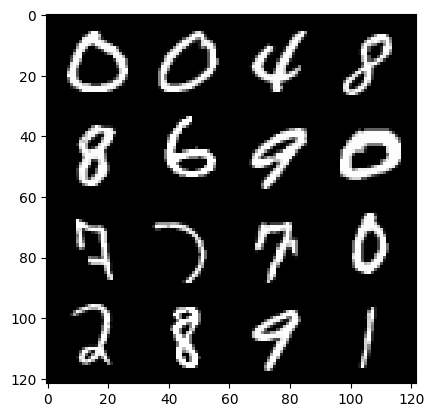

161: step 75900 / Gen loss: 2.4038343437512717 / disc_loss: 0.22906843473513927


  0%|          | 0/469 [00:00<?, ?it/s]

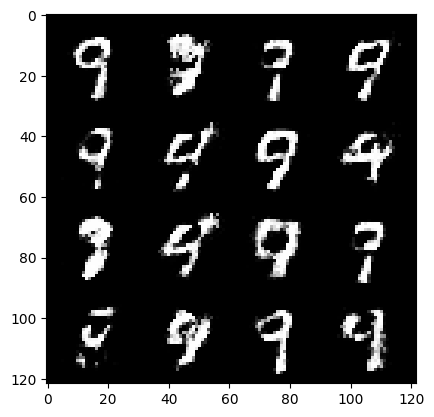

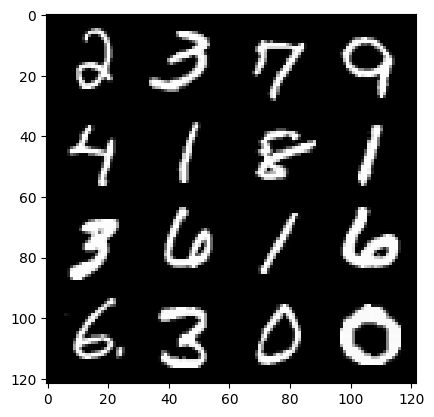

162: step 76200 / Gen loss: 2.4132857537269583 / disc_loss: 0.2198989194134873


  0%|          | 0/469 [00:00<?, ?it/s]

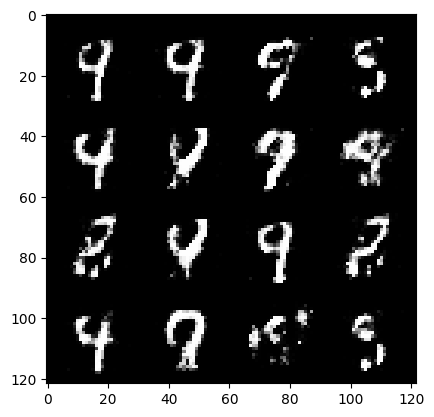

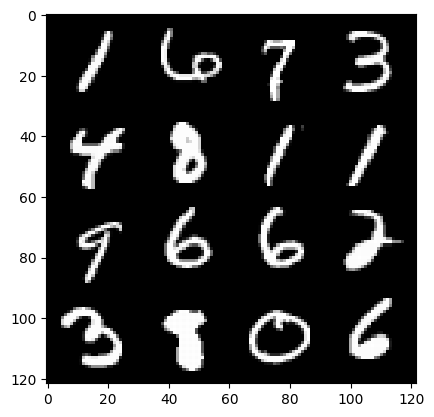

163: step 76500 / Gen loss: 2.3862306435902925 / disc_loss: 0.2290701612333454


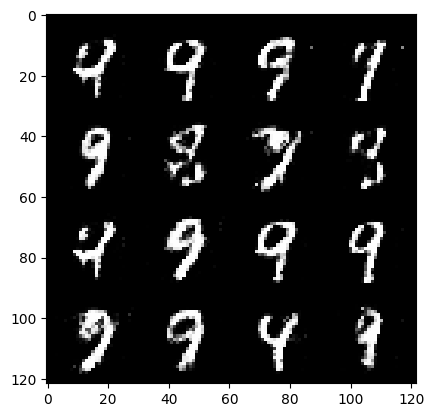

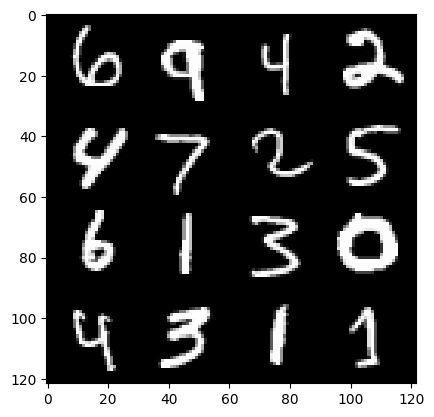

163: step 76800 / Gen loss: 2.333439871470133 / disc_loss: 0.23626277466615048


  0%|          | 0/469 [00:00<?, ?it/s]

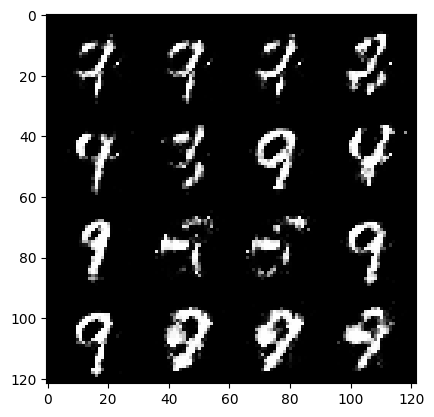

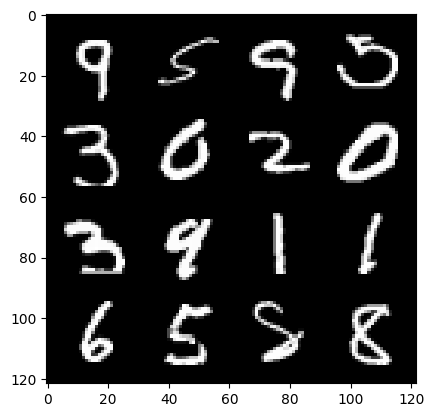

164: step 77100 / Gen loss: 2.510078505674997 / disc_loss: 0.20661054884394026


  0%|          | 0/469 [00:00<?, ?it/s]

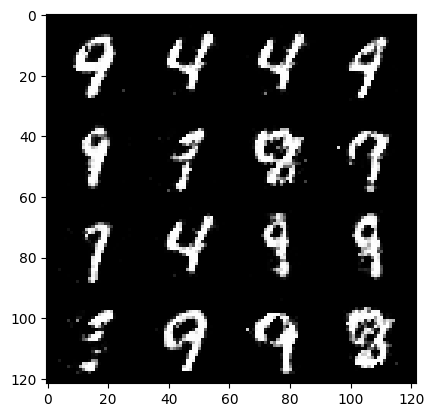

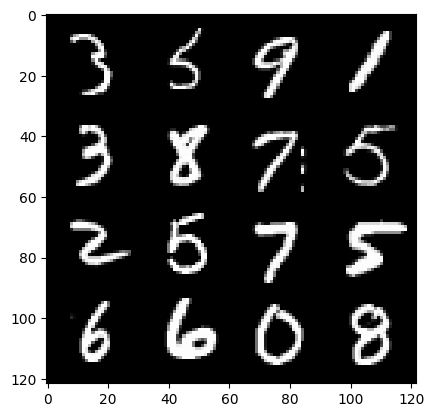

165: step 77400 / Gen loss: 2.6400907691319775 / disc_loss: 0.18541616521775725


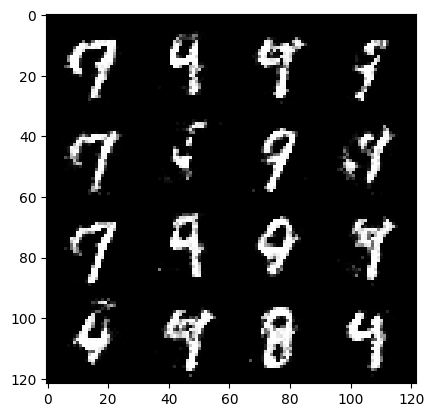

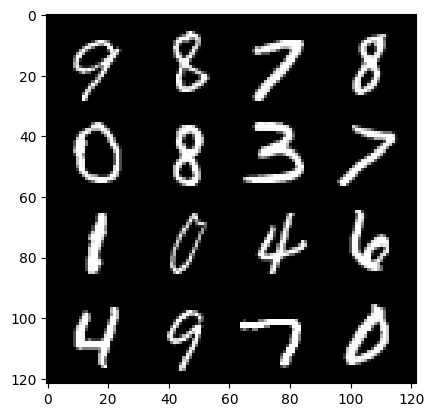

165: step 77700 / Gen loss: 2.558883543014526 / disc_loss: 0.2095456001659233


  0%|          | 0/469 [00:00<?, ?it/s]

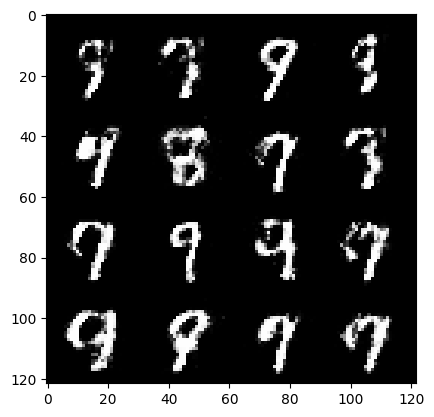

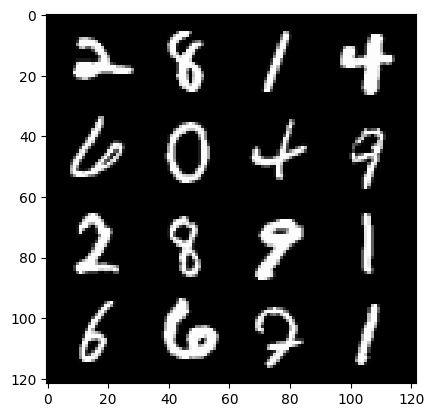

166: step 78000 / Gen loss: 2.4786202589670823 / disc_loss: 0.22509615590175


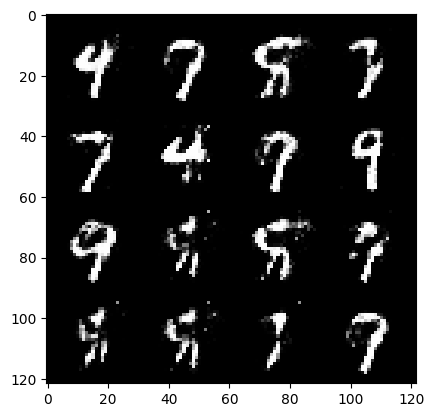

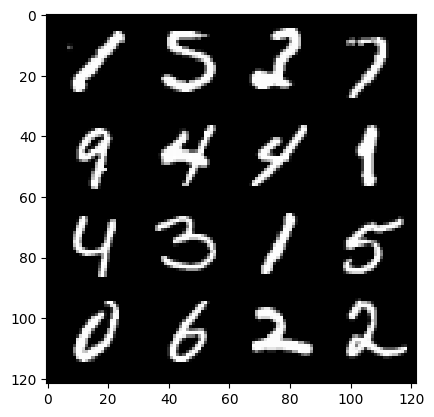

166: step 78300 / Gen loss: 2.466042786836624 / disc_loss: 0.21461362232764566


  0%|          | 0/469 [00:00<?, ?it/s]

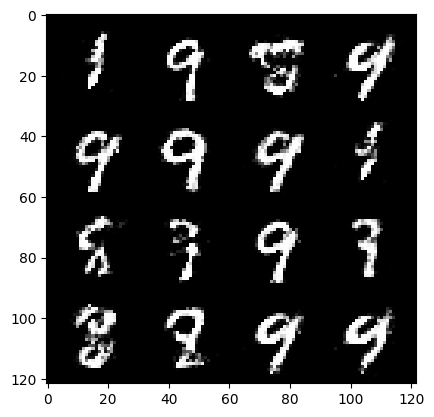

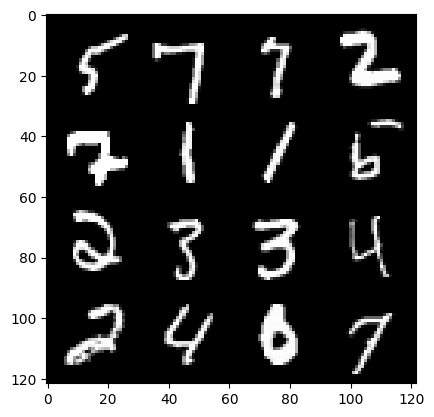

167: step 78600 / Gen loss: 2.4858735720316565 / disc_loss: 0.22258986368775383


  0%|          | 0/469 [00:00<?, ?it/s]

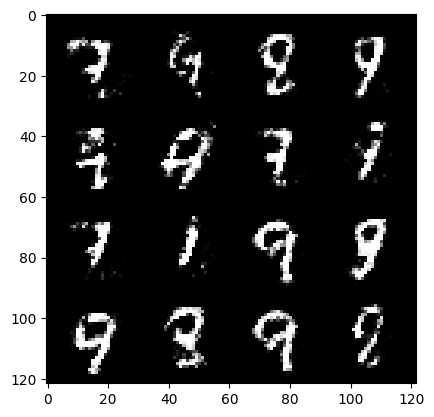

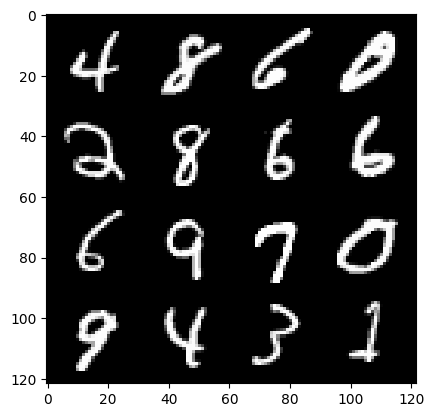

168: step 78900 / Gen loss: 2.4236038215955076 / disc_loss: 0.2260510728259881


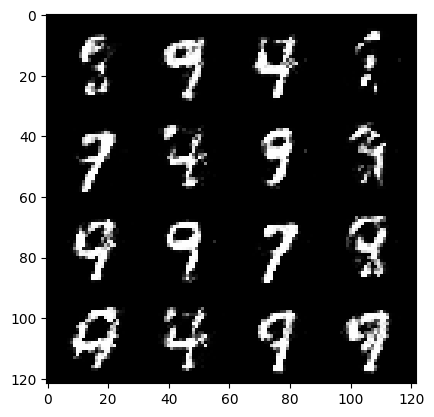

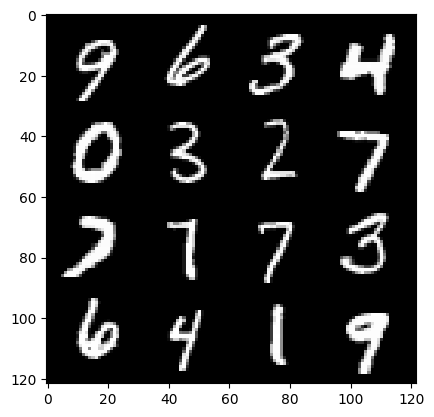

168: step 79200 / Gen loss: 2.461228466033936 / disc_loss: 0.21875523477792752


  0%|          | 0/469 [00:00<?, ?it/s]

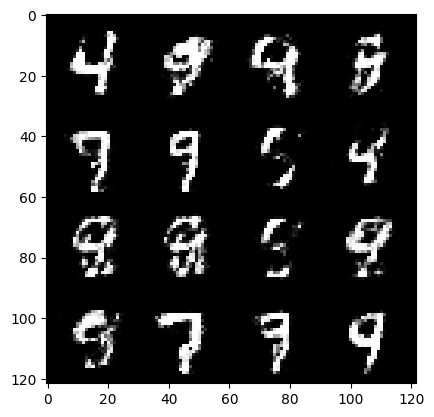

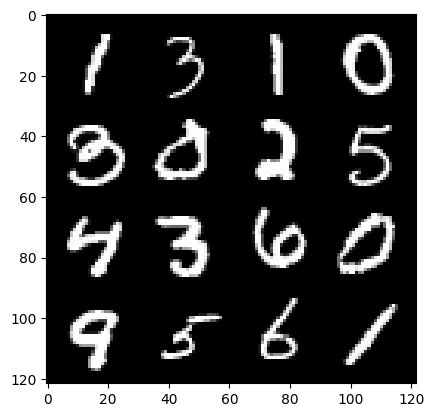

169: step 79500 / Gen loss: 2.3919193172454825 / disc_loss: 0.22227626537283254


  0%|          | 0/469 [00:00<?, ?it/s]

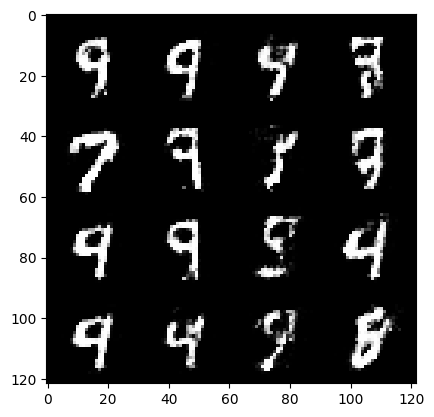

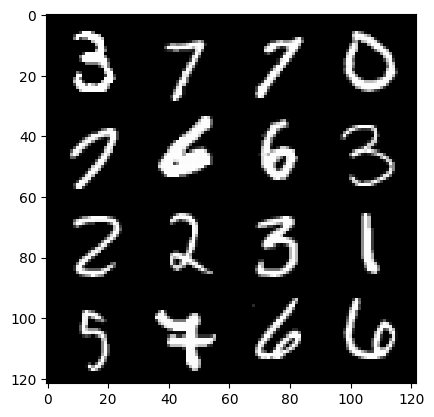

170: step 79800 / Gen loss: 2.3047571774323785 / disc_loss: 0.24530828634897883


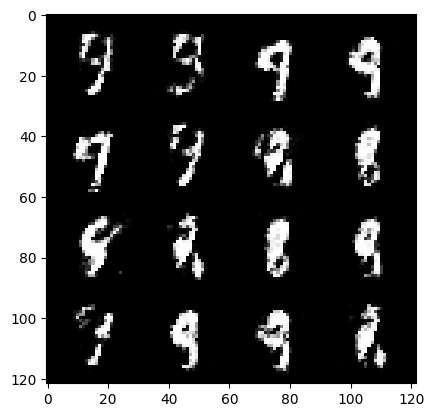

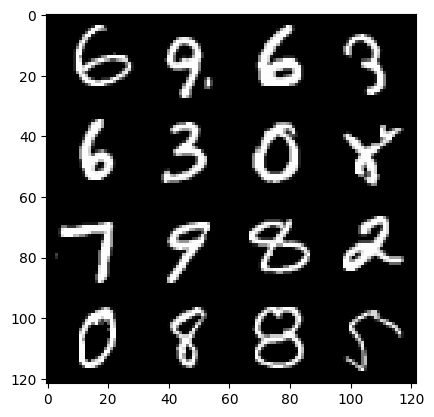

170: step 80100 / Gen loss: 2.3623542753855373 / disc_loss: 0.22898063078522674


  0%|          | 0/469 [00:00<?, ?it/s]

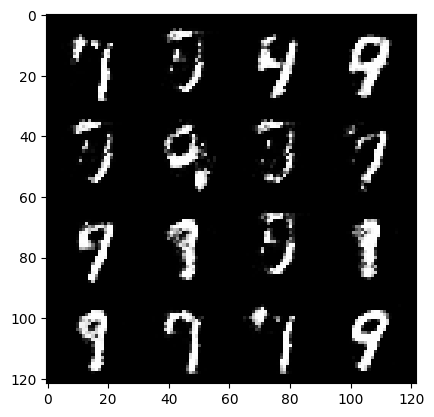

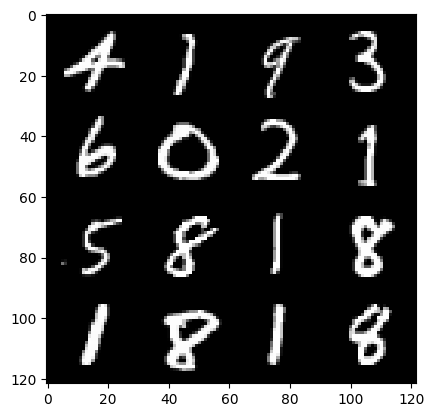

171: step 80400 / Gen loss: 2.4281803925832115 / disc_loss: 0.2206943396727243


  0%|          | 0/469 [00:00<?, ?it/s]

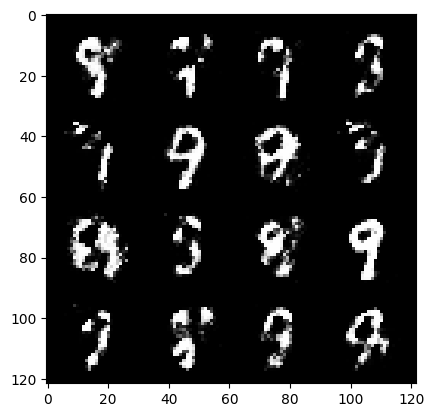

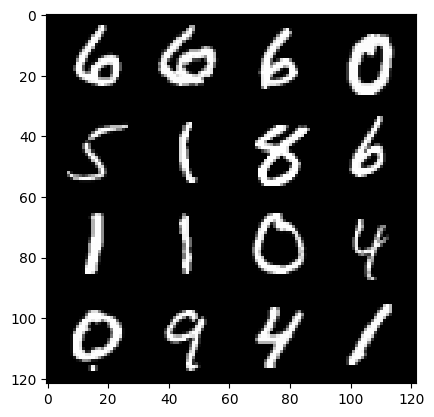

172: step 80700 / Gen loss: 2.527764563560484 / disc_loss: 0.20864371806383133


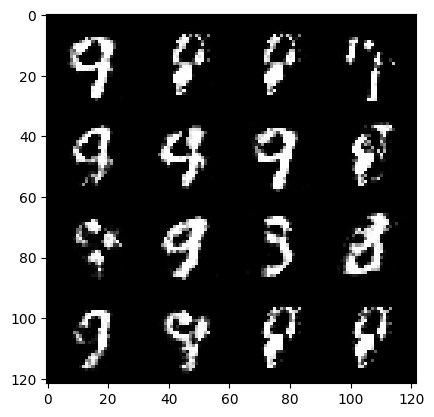

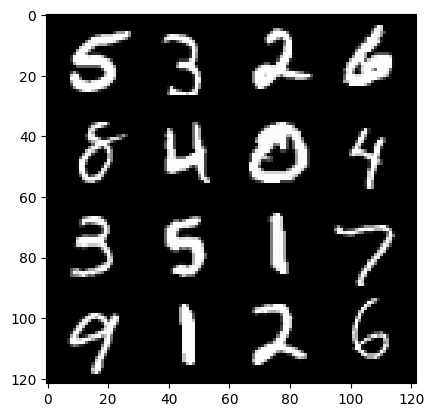

172: step 81000 / Gen loss: 2.4253464865684506 / disc_loss: 0.21345430359244336


  0%|          | 0/469 [00:00<?, ?it/s]

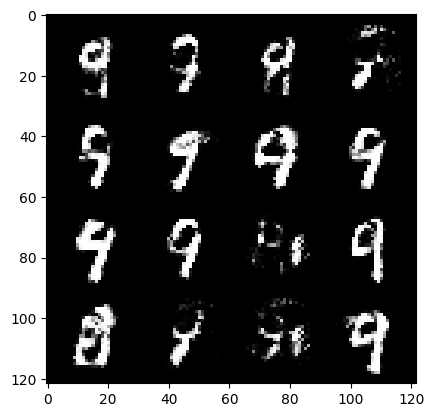

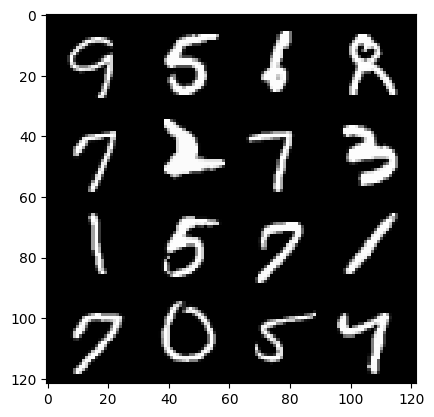

173: step 81300 / Gen loss: 2.489188687006633 / disc_loss: 0.20961779971917477


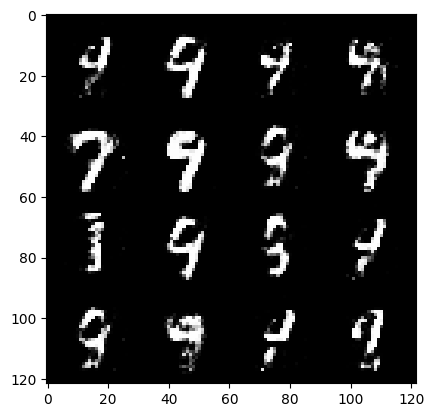

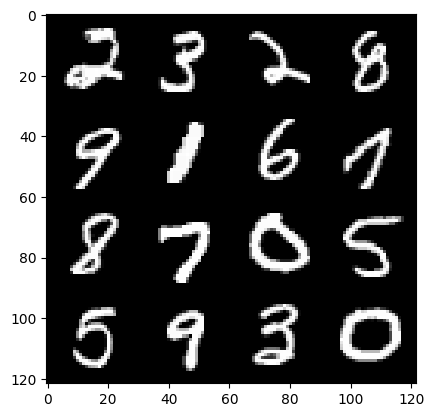

173: step 81600 / Gen loss: 2.477912053664526 / disc_loss: 0.2104437632362047


  0%|          | 0/469 [00:00<?, ?it/s]

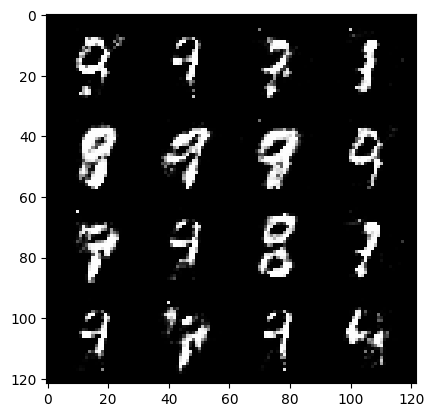

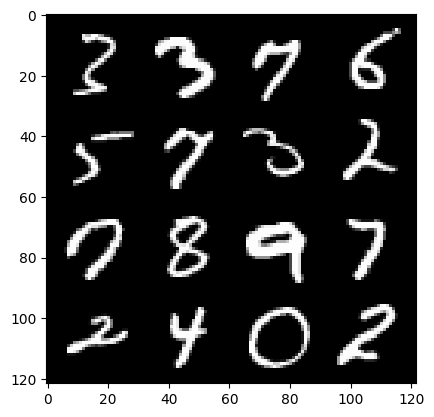

174: step 81900 / Gen loss: 2.4726378512382503 / disc_loss: 0.20669481808940562


  0%|          | 0/469 [00:00<?, ?it/s]

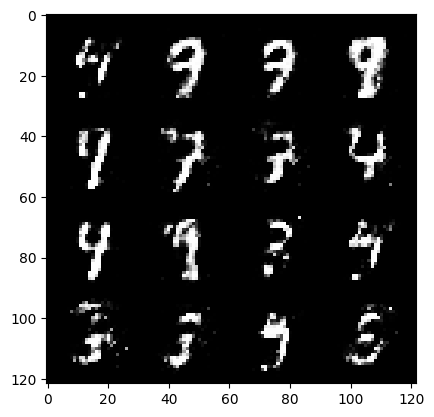

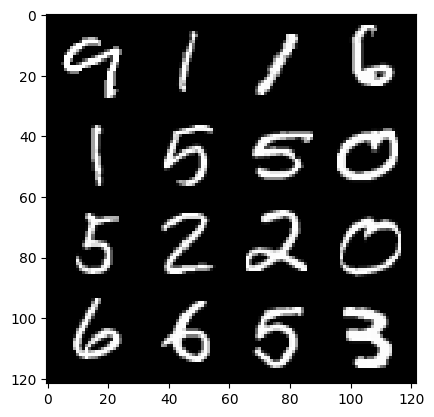

175: step 82200 / Gen loss: 2.535285167694091 / disc_loss: 0.20066019790867967


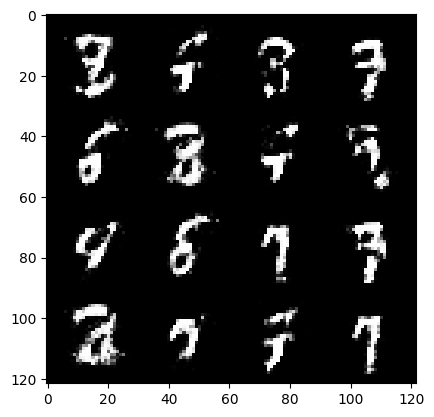

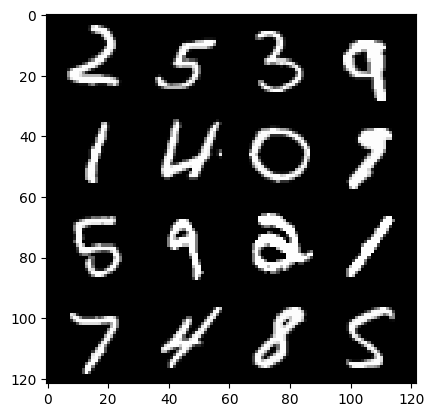

175: step 82500 / Gen loss: 2.478606625398001 / disc_loss: 0.23361960719029098


  0%|          | 0/469 [00:00<?, ?it/s]

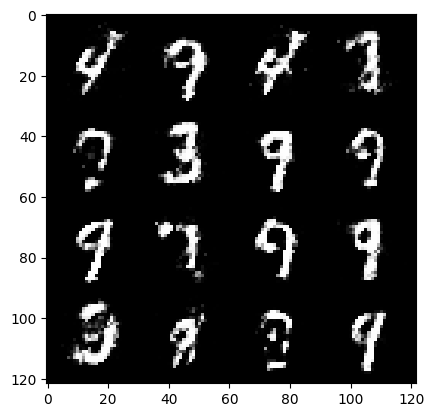

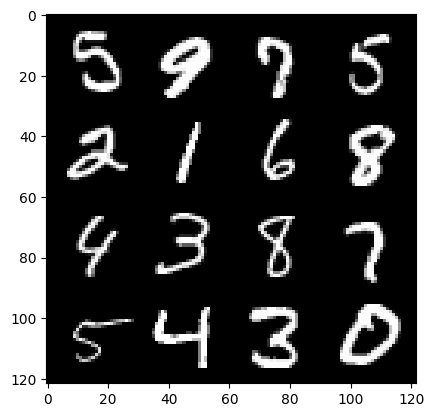

176: step 82800 / Gen loss: 2.3064388473828625 / disc_loss: 0.23560267190138504


  0%|          | 0/469 [00:00<?, ?it/s]

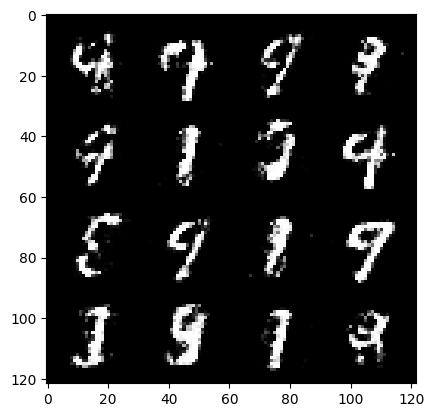

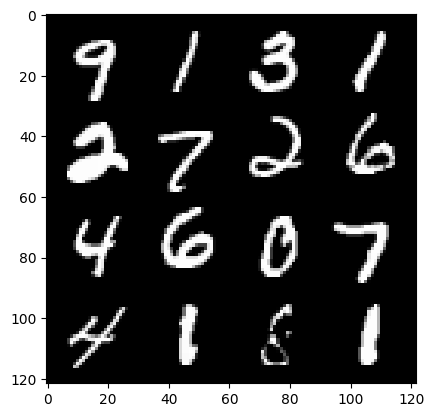

177: step 83100 / Gen loss: 2.470209817886352 / disc_loss: 0.22460584024588273


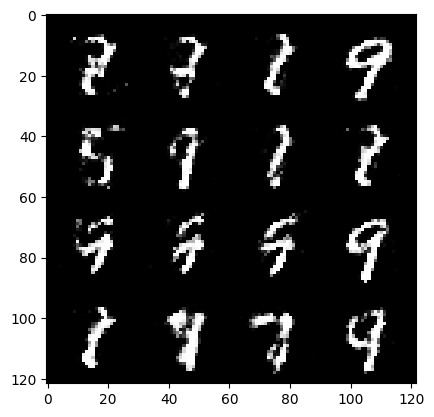

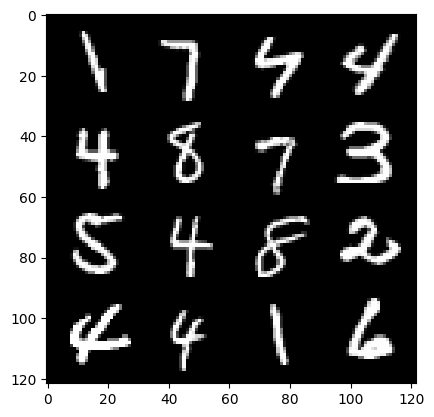

177: step 83400 / Gen loss: 2.3802131541570026 / disc_loss: 0.23642442117134738


  0%|          | 0/469 [00:00<?, ?it/s]

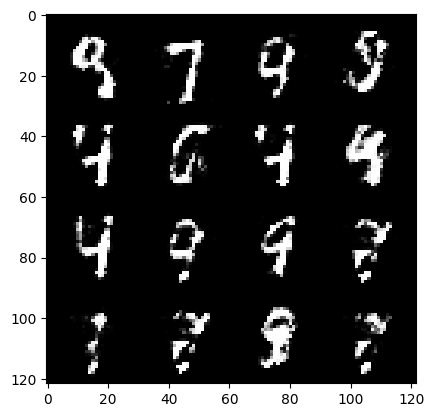

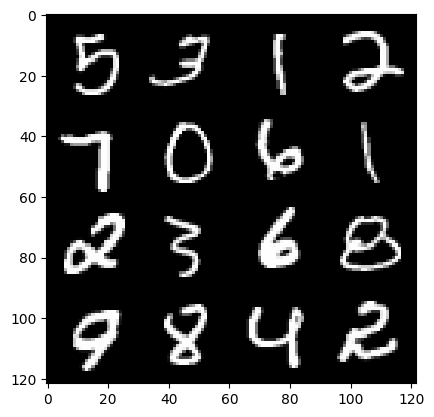

178: step 83700 / Gen loss: 2.4088350240389502 / disc_loss: 0.23184443940718966


  0%|          | 0/469 [00:00<?, ?it/s]

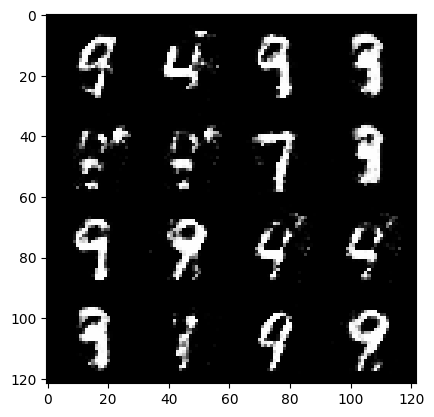

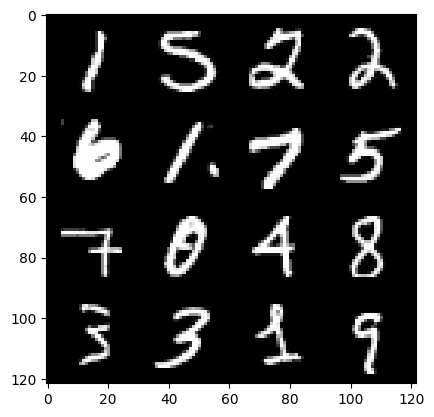

179: step 84000 / Gen loss: 2.388432701031366 / disc_loss: 0.22265859236319865


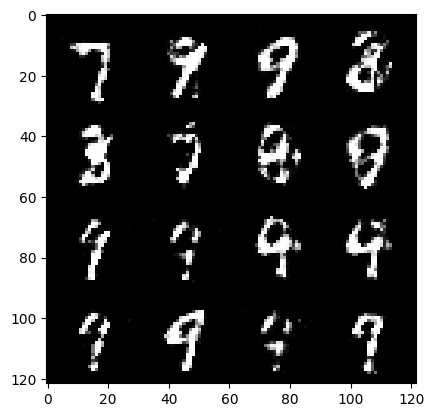

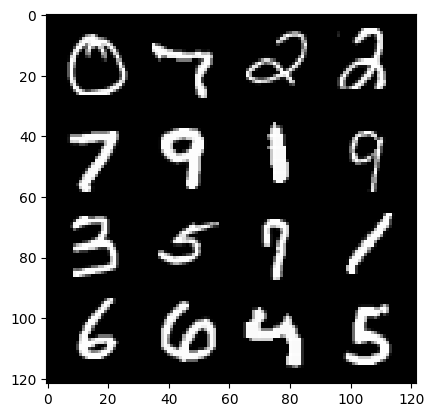

179: step 84300 / Gen loss: 2.4091411423683162 / disc_loss: 0.23936060667037962


  0%|          | 0/469 [00:00<?, ?it/s]

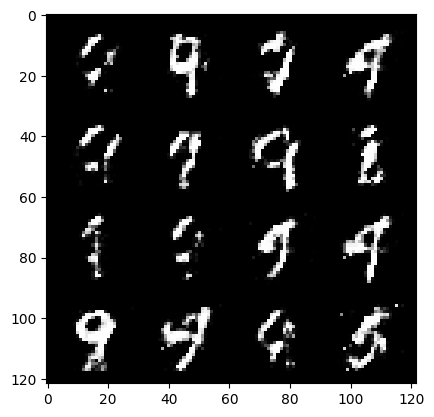

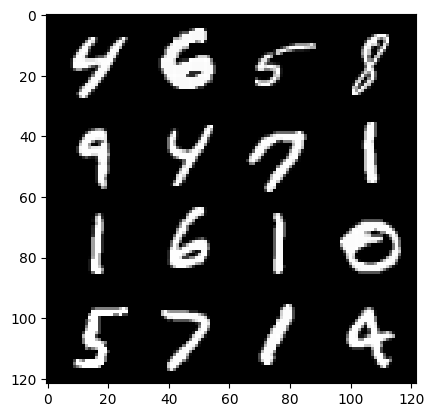

180: step 84600 / Gen loss: 2.219702953100204 / disc_loss: 0.24919914732376733


  0%|          | 0/469 [00:00<?, ?it/s]

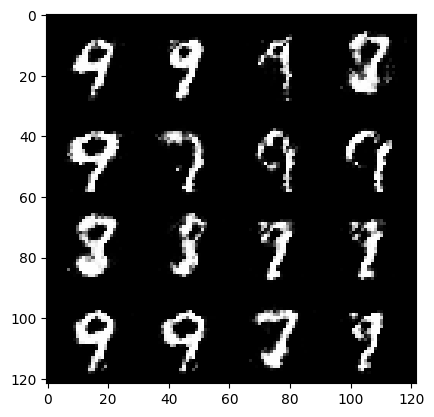

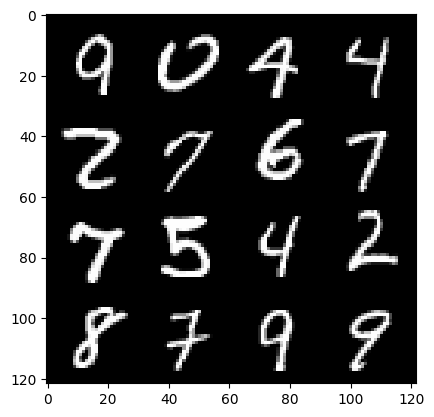

181: step 84900 / Gen loss: 2.2119996551672627 / disc_loss: 0.25218364705642077


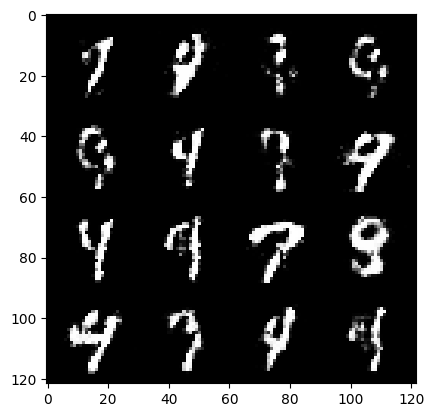

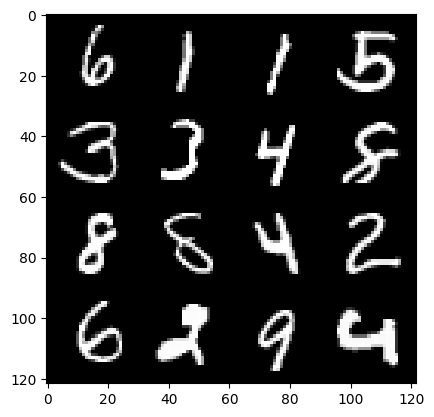

181: step 85200 / Gen loss: 2.1970307751496643 / disc_loss: 0.2586964565018814


  0%|          | 0/469 [00:00<?, ?it/s]

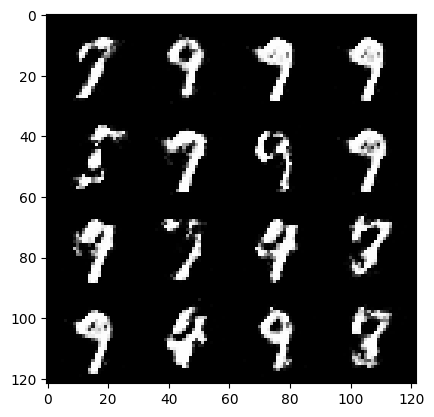

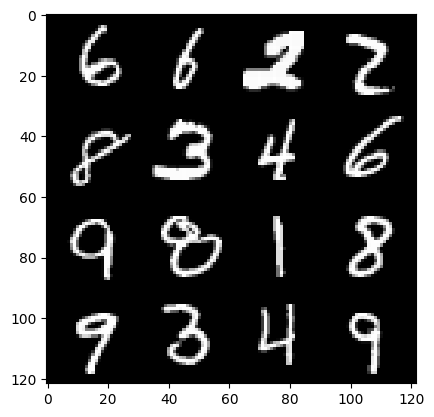

182: step 85500 / Gen loss: 2.1802783993879973 / disc_loss: 0.2575612804790339


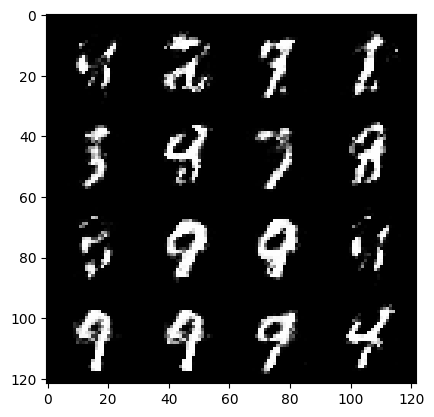

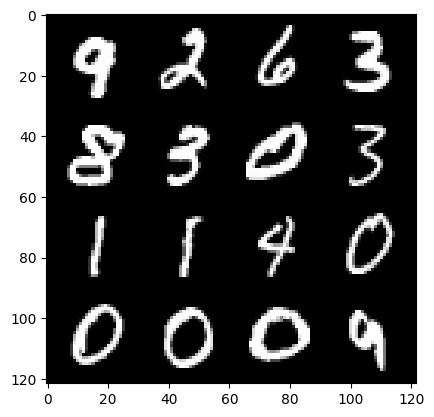

182: step 85800 / Gen loss: 2.170468230644862 / disc_loss: 0.2588411220908166


  0%|          | 0/469 [00:00<?, ?it/s]

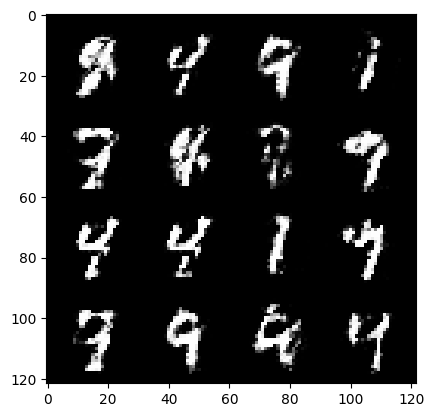

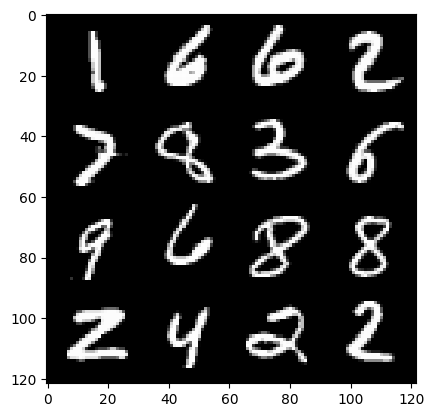

183: step 86100 / Gen loss: 2.2529770843187964 / disc_loss: 0.24427386571963625


  0%|          | 0/469 [00:00<?, ?it/s]

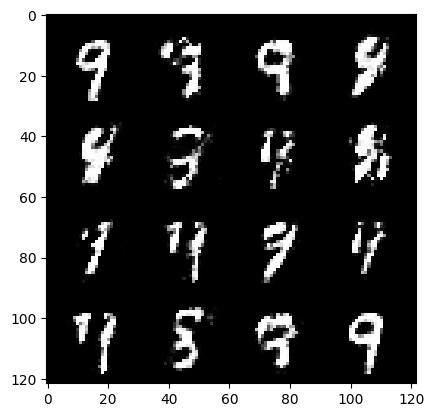

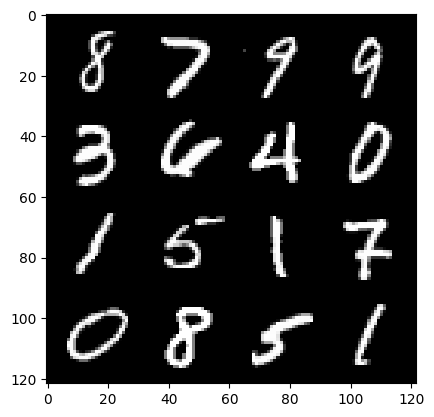

184: step 86400 / Gen loss: 2.192317396402358 / disc_loss: 0.2557747498154641


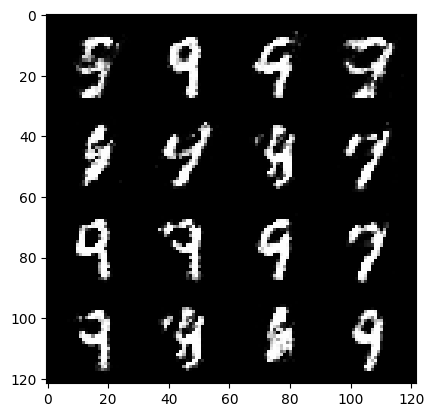

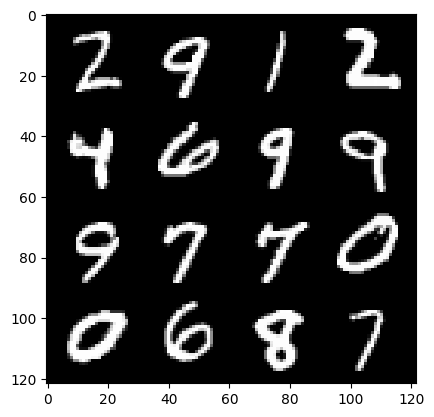

184: step 86700 / Gen loss: 2.223787014881769 / disc_loss: 0.243958172549804


  0%|          | 0/469 [00:00<?, ?it/s]

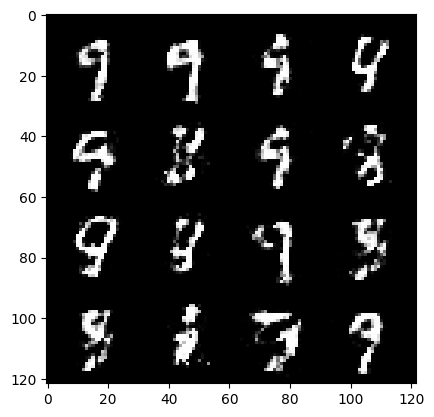

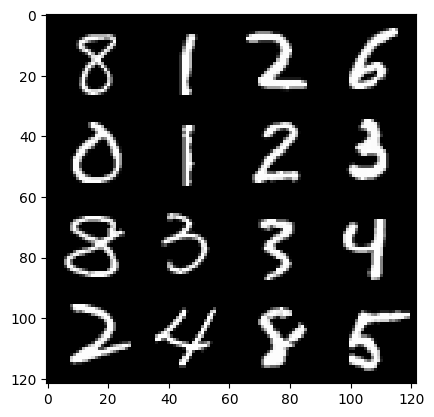

185: step 87000 / Gen loss: 2.191305779218674 / disc_loss: 0.25090431471665714


  0%|          | 0/469 [00:00<?, ?it/s]

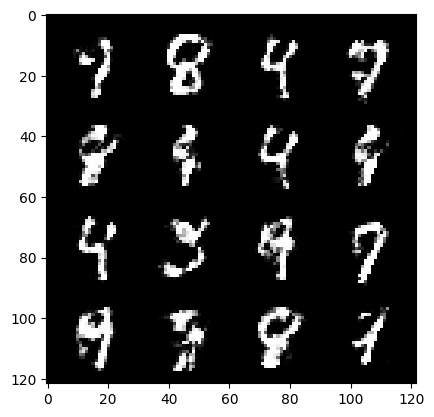

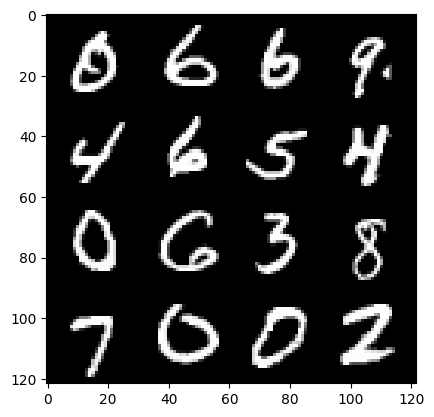

186: step 87300 / Gen loss: 2.344449956814448 / disc_loss: 0.2318861366311708


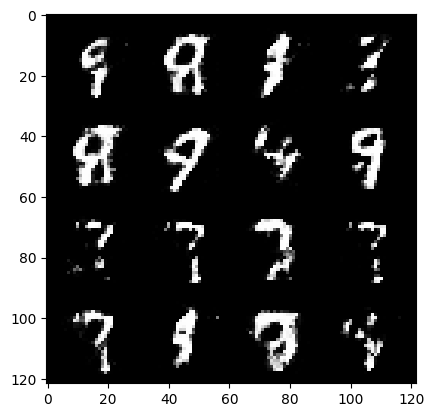

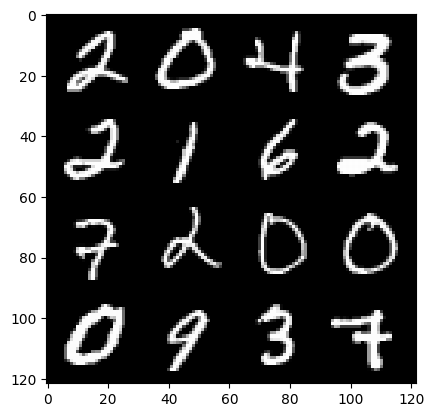

186: step 87600 / Gen loss: 2.2497003567218803 / disc_loss: 0.26496633609135944


  0%|          | 0/469 [00:00<?, ?it/s]

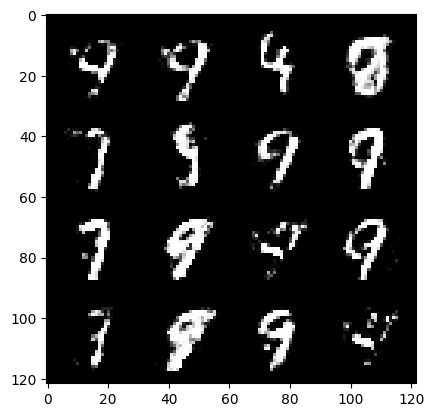

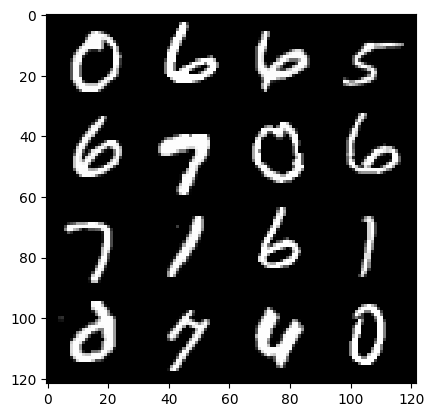

187: step 87900 / Gen loss: 2.0584433722496014 / disc_loss: 0.2787717572848004


  0%|          | 0/469 [00:00<?, ?it/s]

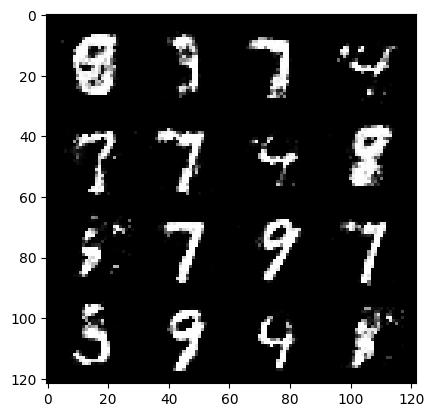

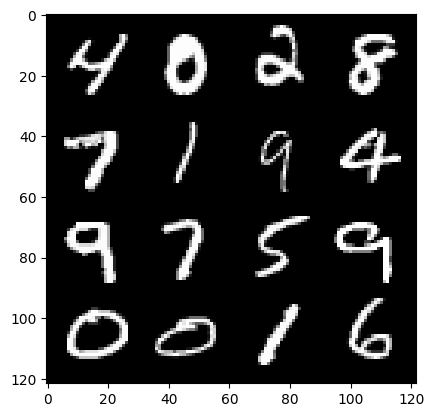

188: step 88200 / Gen loss: 2.142865277926127 / disc_loss: 0.25967969492077836


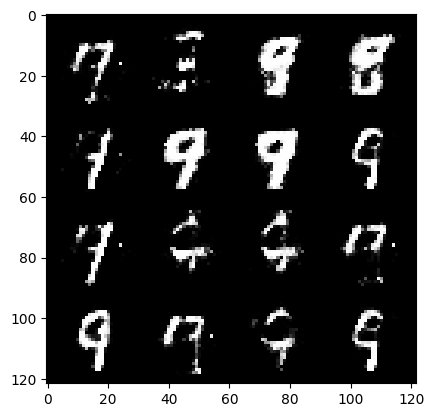

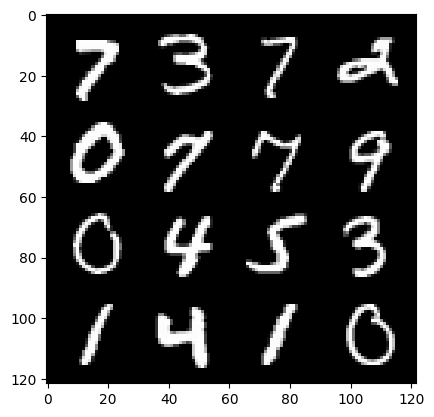

188: step 88500 / Gen loss: 2.1484895559151953 / disc_loss: 0.2713904396692912


  0%|          | 0/469 [00:00<?, ?it/s]

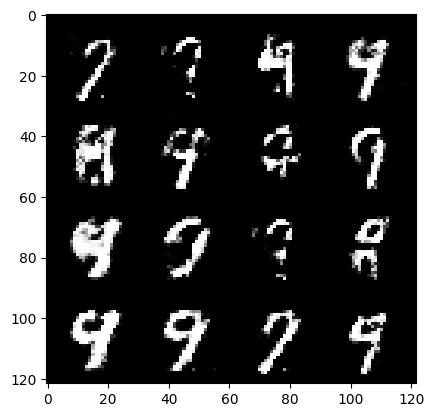

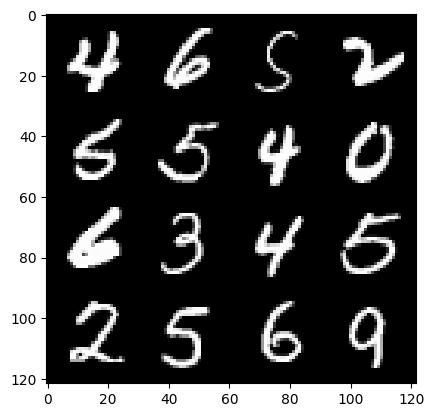

189: step 88800 / Gen loss: 2.1853337264060957 / disc_loss: 0.25189738109707827


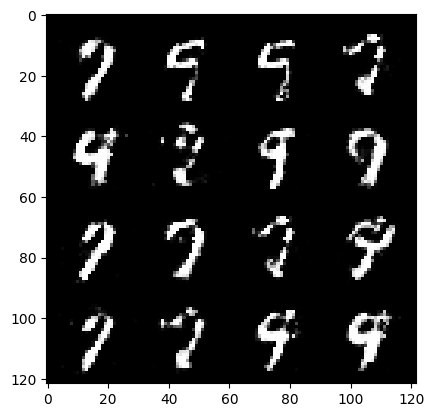

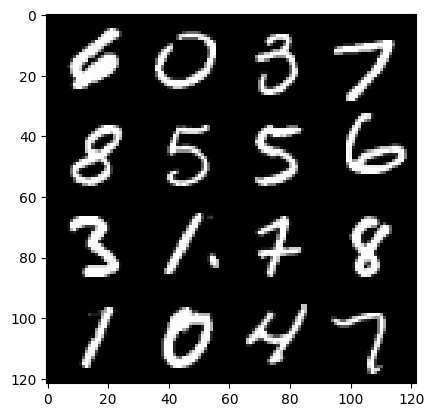

189: step 89100 / Gen loss: 2.15360305349032 / disc_loss: 0.26137224033474926


  0%|          | 0/469 [00:00<?, ?it/s]

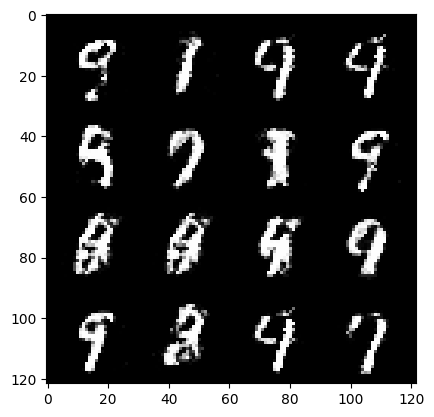

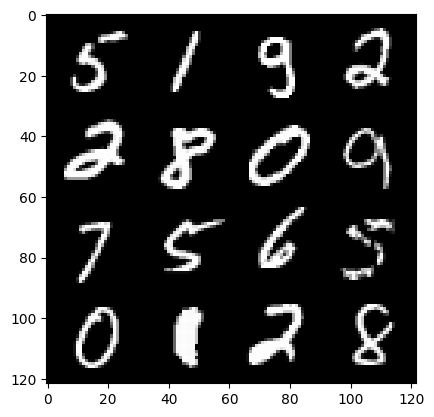

190: step 89400 / Gen loss: 2.220836745500564 / disc_loss: 0.2565730962157248


  0%|          | 0/469 [00:00<?, ?it/s]

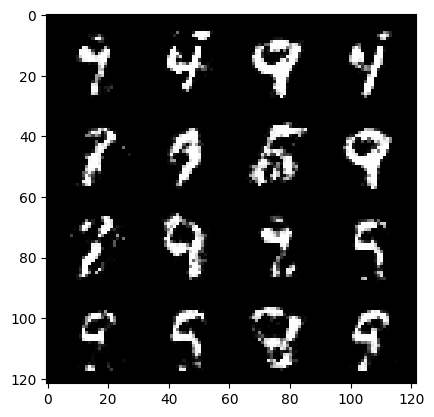

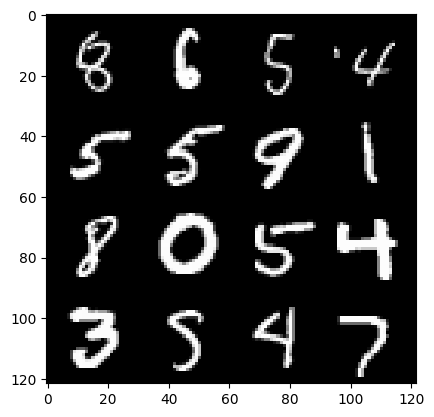

191: step 89700 / Gen loss: 2.08642162879308 / disc_loss: 0.2748719677825769


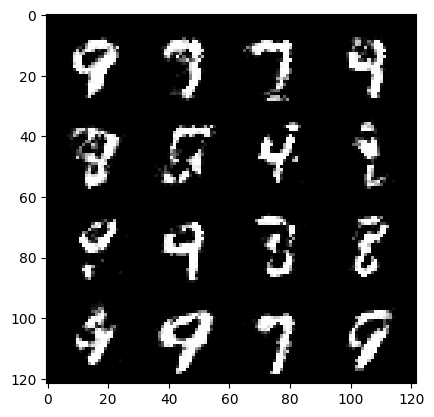

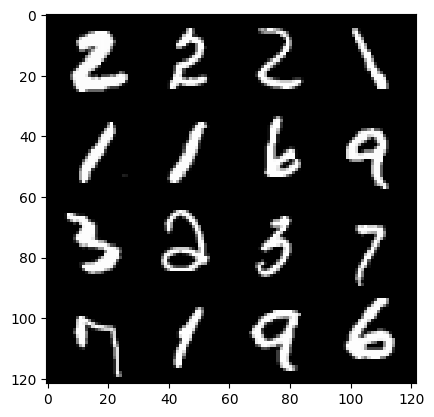

191: step 90000 / Gen loss: 2.114481923580169 / disc_loss: 0.26650801479816444


  0%|          | 0/469 [00:00<?, ?it/s]

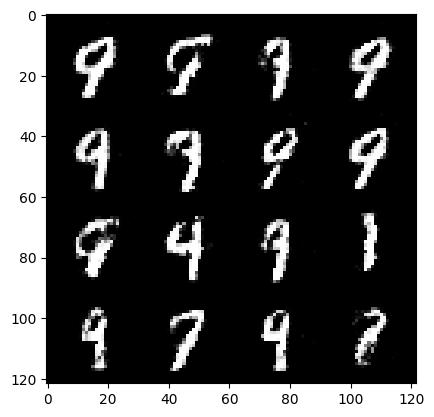

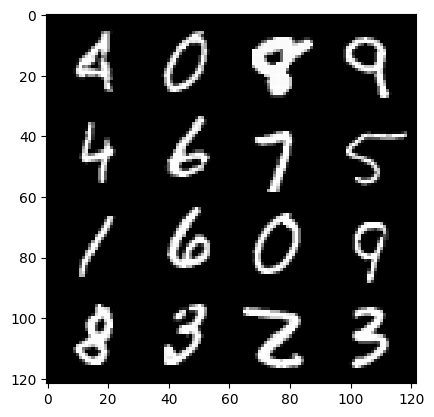

192: step 90300 / Gen loss: 2.293421107530595 / disc_loss: 0.23454844072461123


  0%|          | 0/469 [00:00<?, ?it/s]

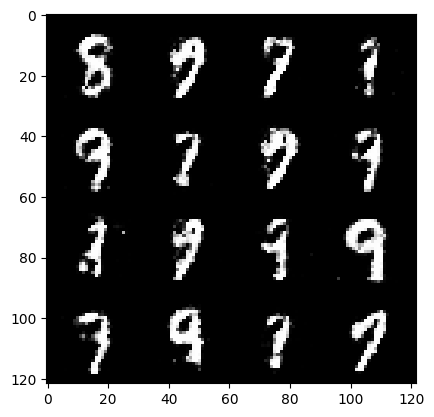

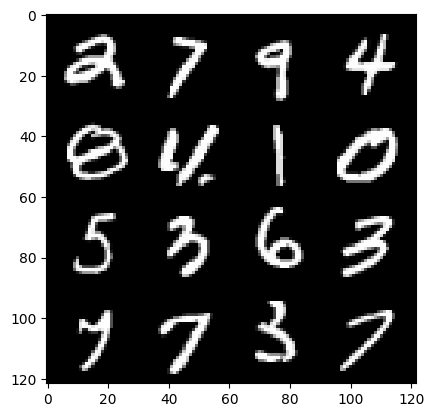

193: step 90600 / Gen loss: 2.2480701955159494 / disc_loss: 0.24417400414745016


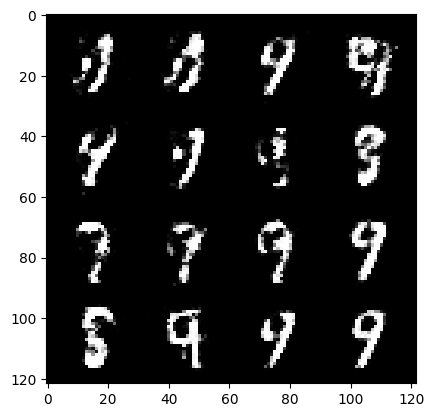

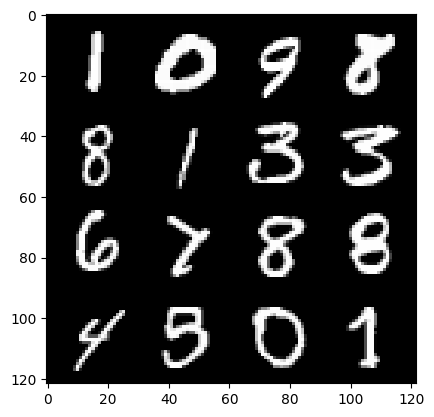

193: step 90900 / Gen loss: 2.2292661301294965 / disc_loss: 0.23967251688241958


  0%|          | 0/469 [00:00<?, ?it/s]

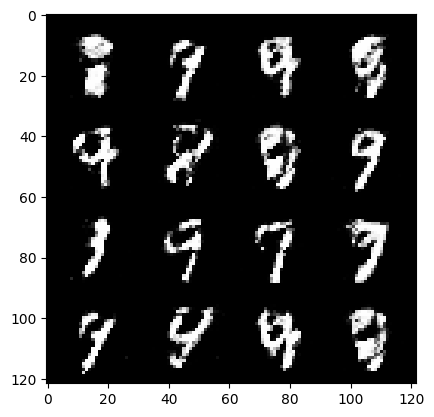

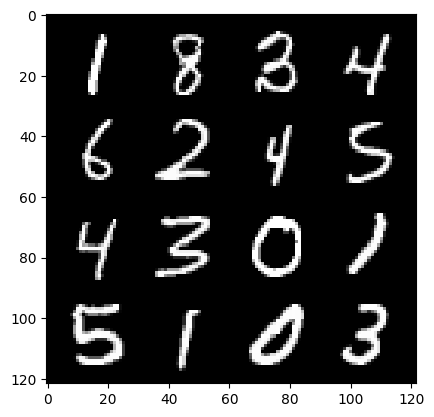

194: step 91200 / Gen loss: 2.127197633186977 / disc_loss: 0.2711403923233349


  0%|          | 0/469 [00:00<?, ?it/s]

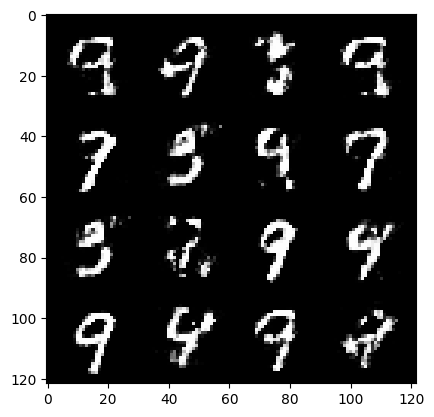

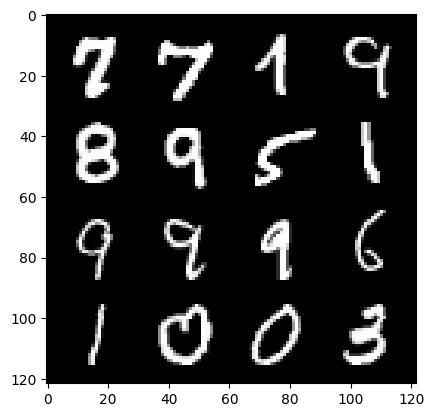

195: step 91500 / Gen loss: 2.054243361552555 / disc_loss: 0.27490518460671093


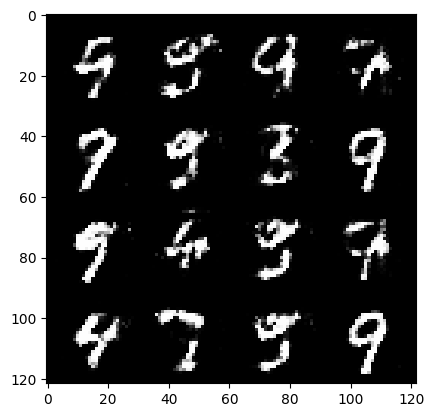

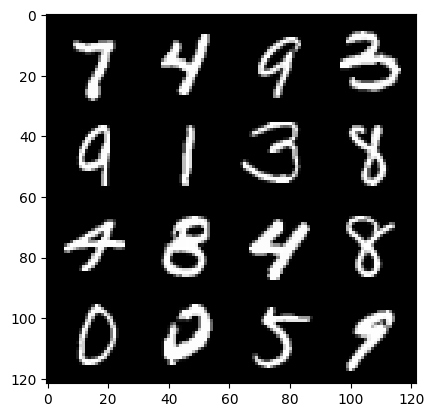

195: step 91800 / Gen loss: 2.179561161994936 / disc_loss: 0.2654549280305703


  0%|          | 0/469 [00:00<?, ?it/s]

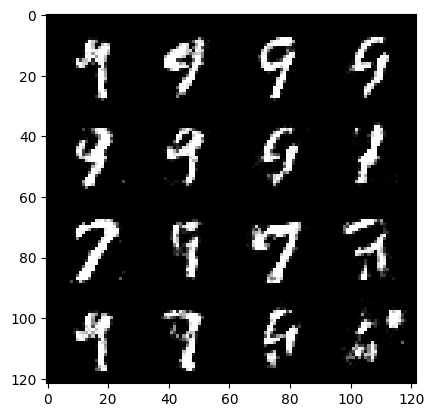

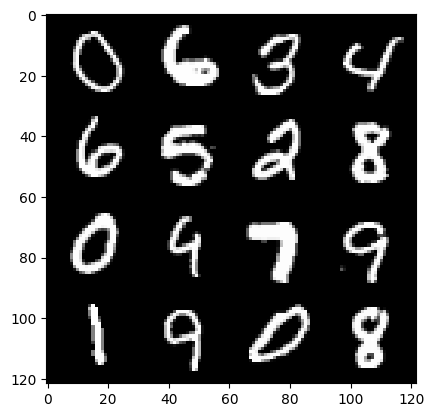

196: step 92100 / Gen loss: 2.1823506605625145 / disc_loss: 0.26255710010727246


  0%|          | 0/469 [00:00<?, ?it/s]

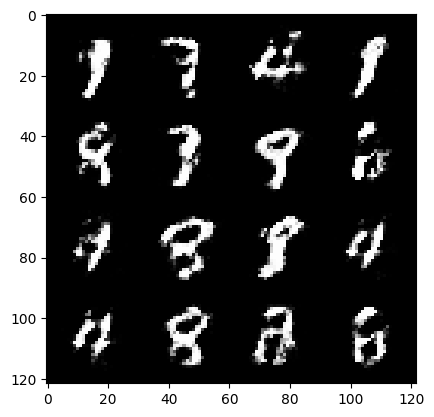

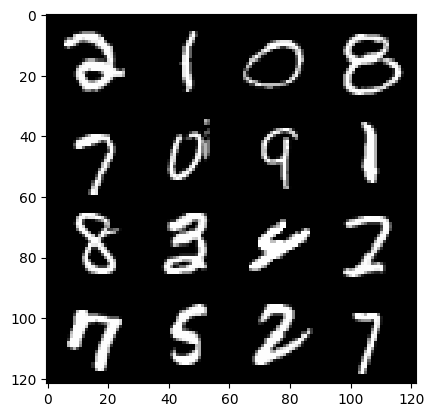

197: step 92400 / Gen loss: 2.0686694550514217 / disc_loss: 0.2951675666868689


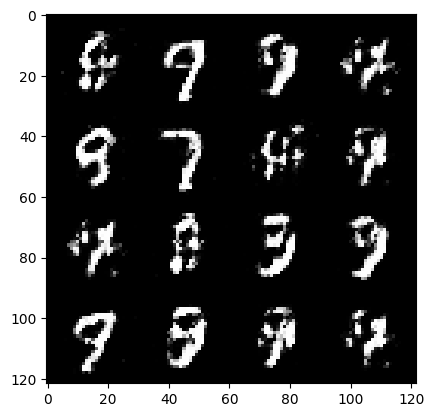

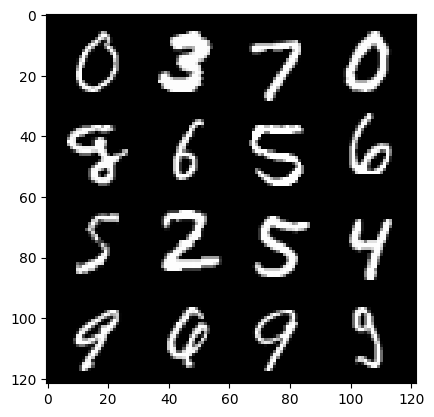

197: step 92700 / Gen loss: 2.0419529839356745 / disc_loss: 0.296464636027813


  0%|          | 0/469 [00:00<?, ?it/s]

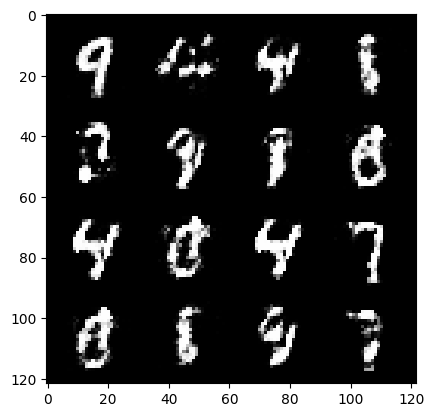

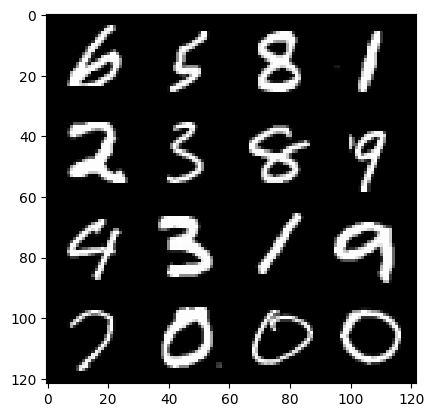

198: step 93000 / Gen loss: 2.0479122952620177 / disc_loss: 0.2879675646622976


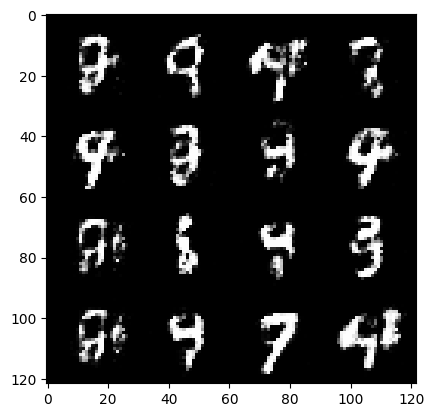

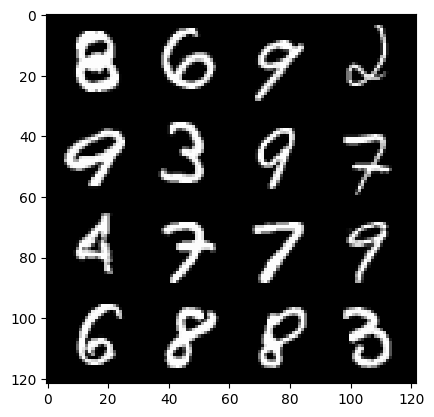

198: step 93300 / Gen loss: 2.0171541965007798 / disc_loss: 0.2944094297786554


  0%|          | 0/469 [00:00<?, ?it/s]

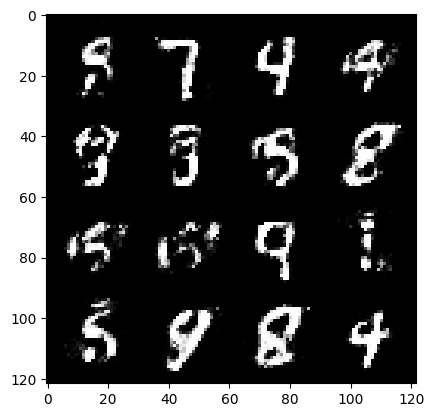

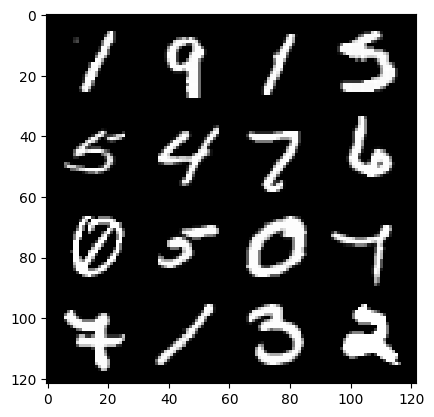

199: step 93600 / Gen loss: 1.9777993055184684 / disc_loss: 0.3046906953056652


  0%|          | 0/469 [00:00<?, ?it/s]

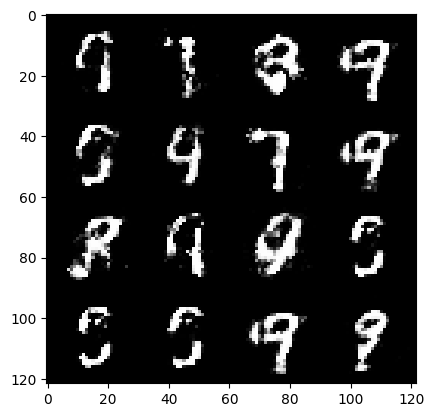

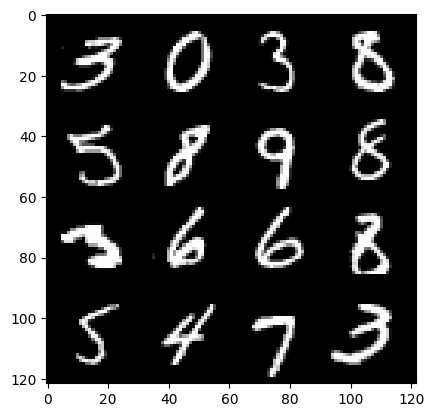

200: step 93900 / Gen loss: 1.9952372086048127 / disc_loss: 0.29296176657080636


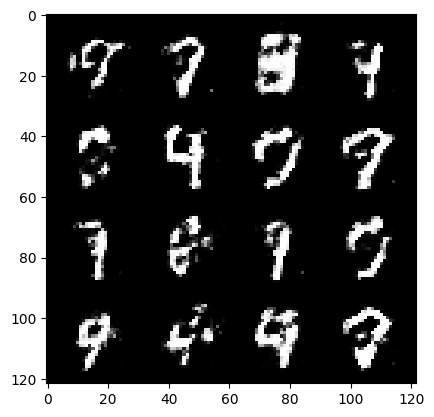

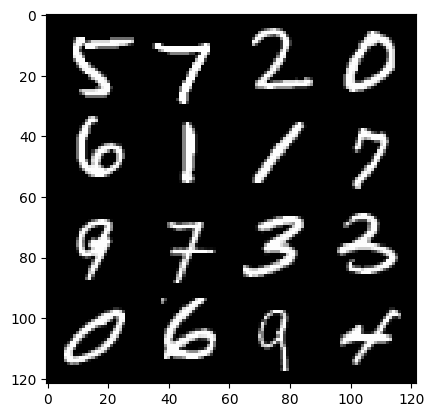

200: step 94200 / Gen loss: 2.0856984949111923 / disc_loss: 0.2759171202778818


  0%|          | 0/469 [00:00<?, ?it/s]

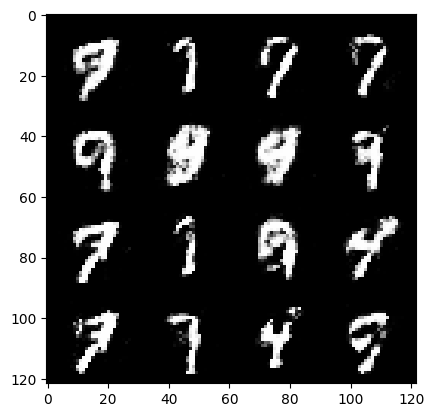

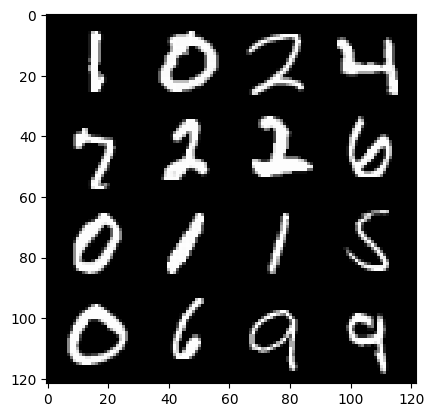

201: step 94500 / Gen loss: 1.9743626956144962 / disc_loss: 0.3071832352876663


  0%|          | 0/469 [00:00<?, ?it/s]

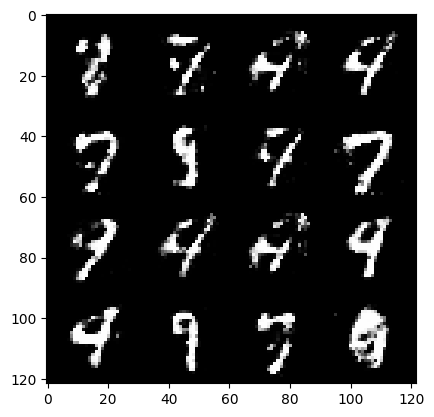

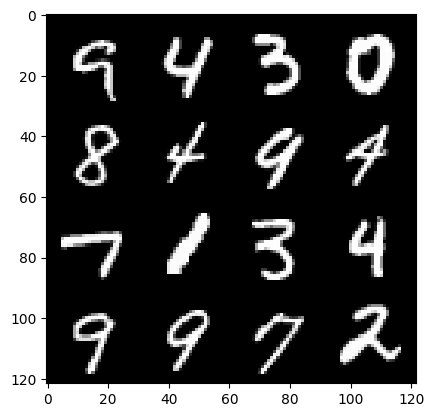

202: step 94800 / Gen loss: 1.938530582189559 / disc_loss: 0.29740116337935113


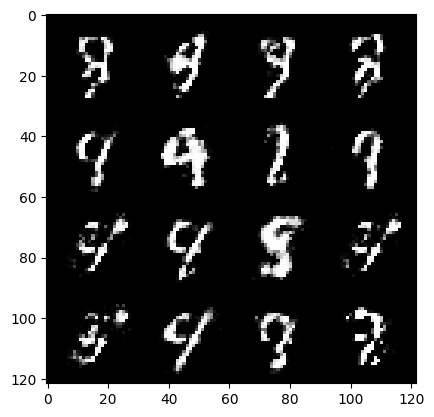

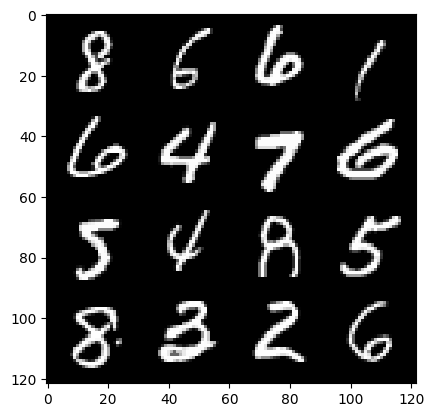

202: step 95100 / Gen loss: 2.062720094124476 / disc_loss: 0.26871958161393816


  0%|          | 0/469 [00:00<?, ?it/s]

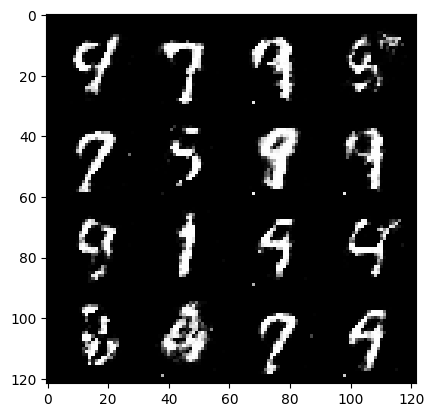

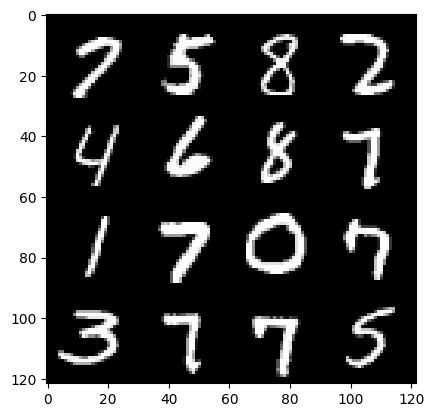

203: step 95400 / Gen loss: 2.0369131926695507 / disc_loss: 0.2966655802230041


  0%|          | 0/469 [00:00<?, ?it/s]

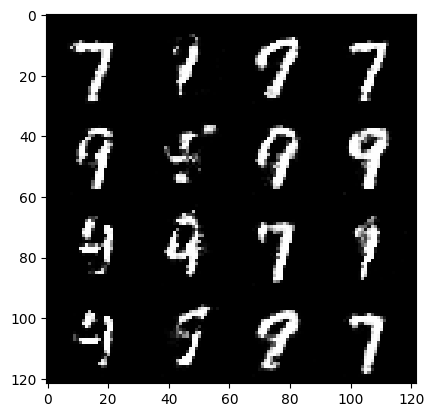

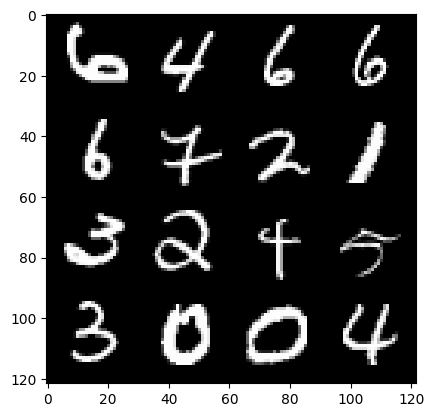

204: step 95700 / Gen loss: 1.9781646152337389 / disc_loss: 0.27608262653152155


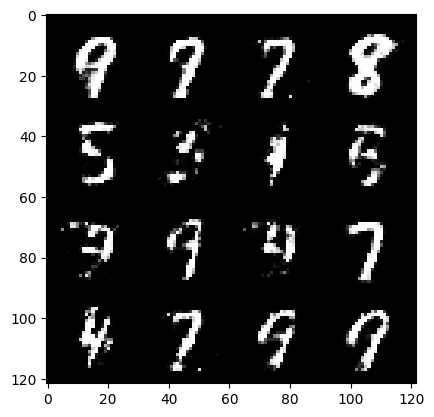

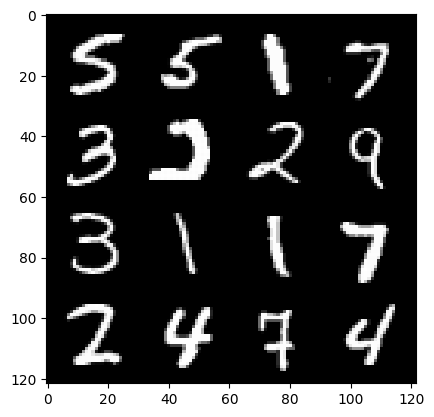

204: step 96000 / Gen loss: 2.0336984888712566 / disc_loss: 0.2772612010439237


  0%|          | 0/469 [00:00<?, ?it/s]

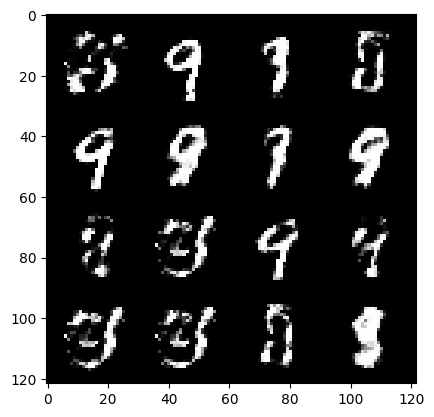

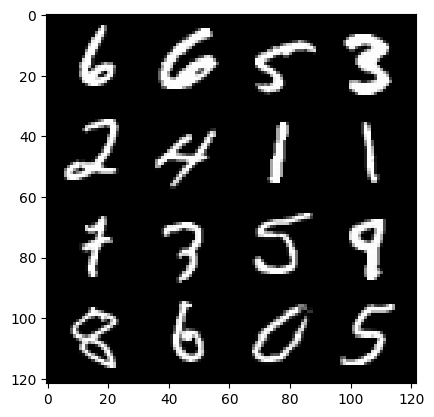

205: step 96300 / Gen loss: 1.952970678011577 / disc_loss: 0.29254240617156024


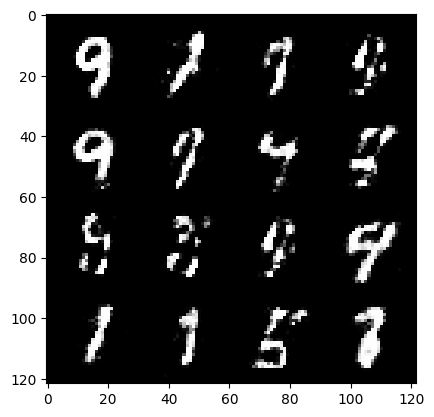

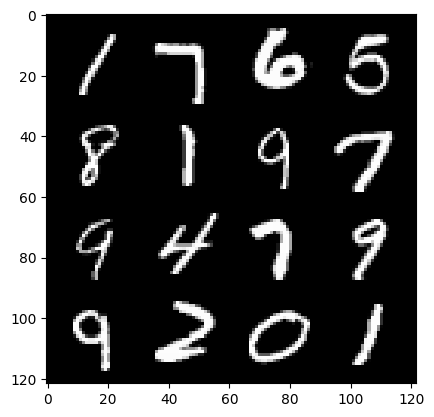

205: step 96600 / Gen loss: 1.9562116054693854 / disc_loss: 0.29248623008529356


  0%|          | 0/469 [00:00<?, ?it/s]

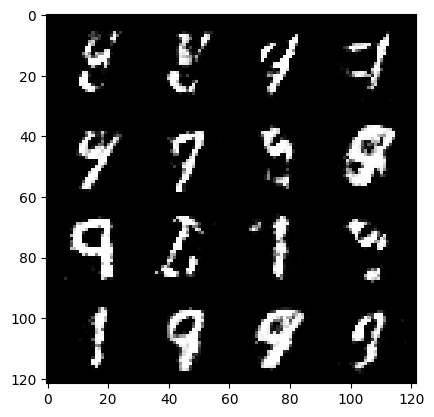

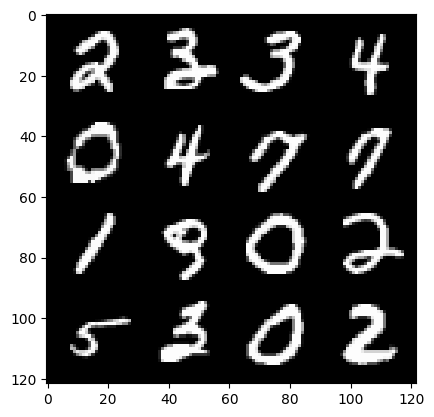

206: step 96900 / Gen loss: 1.929538634618124 / disc_loss: 0.3010114934047066


  0%|          | 0/469 [00:00<?, ?it/s]

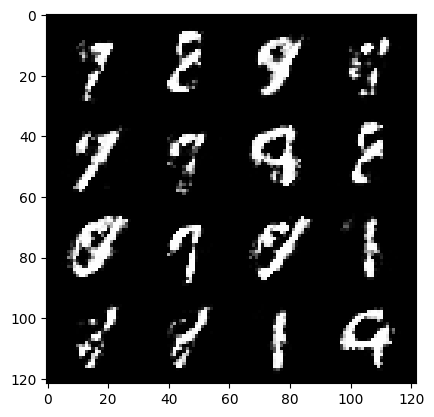

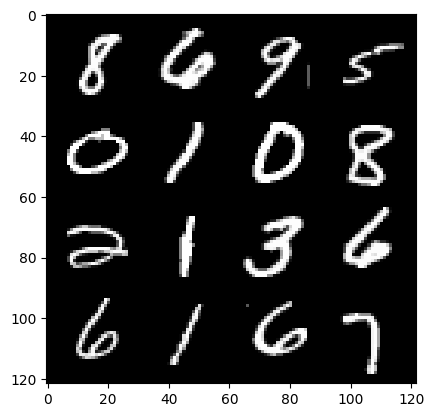

207: step 97200 / Gen loss: 1.8997985597451525 / disc_loss: 0.30556313787897416


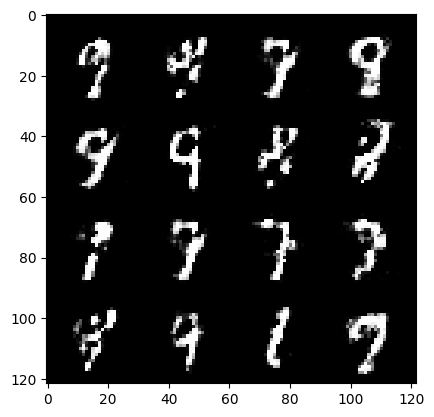

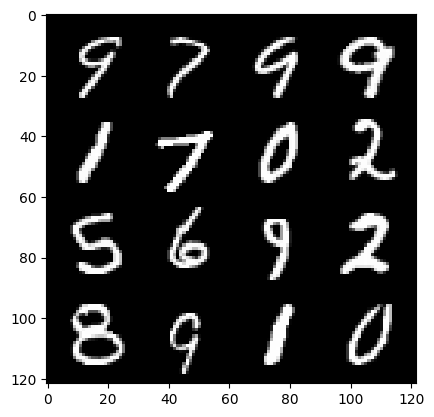

207: step 97500 / Gen loss: 1.874805659850439 / disc_loss: 0.3042171232402324


  0%|          | 0/469 [00:00<?, ?it/s]

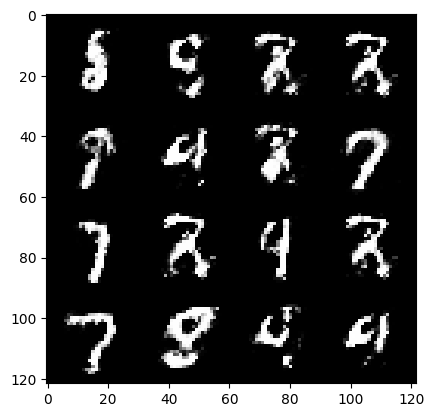

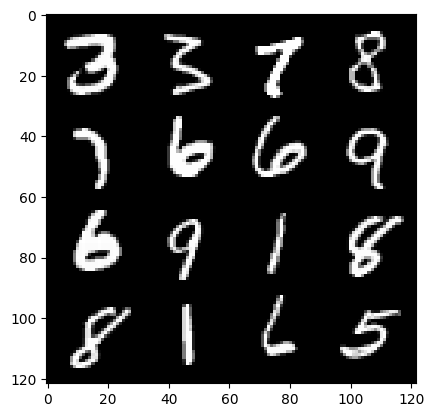

208: step 97800 / Gen loss: 1.9740493575731906 / disc_loss: 0.3024446898202101


  0%|          | 0/469 [00:00<?, ?it/s]

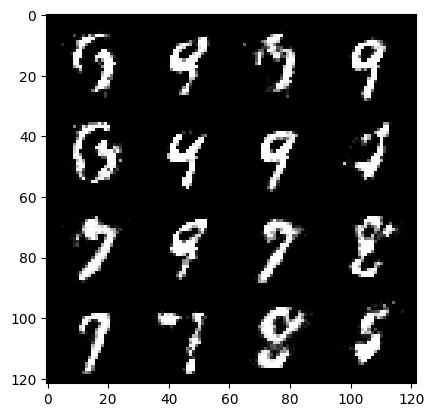

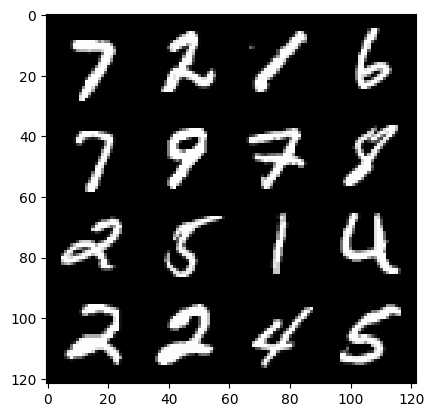

209: step 98100 / Gen loss: 2.0121140853563957 / disc_loss: 0.29644411722819025


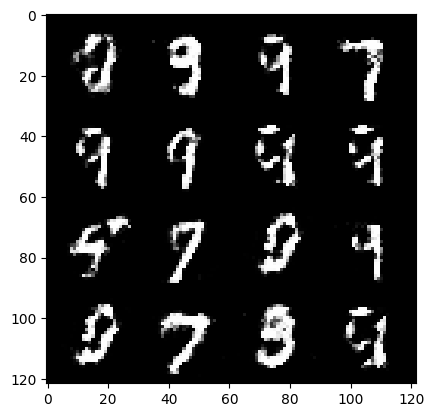

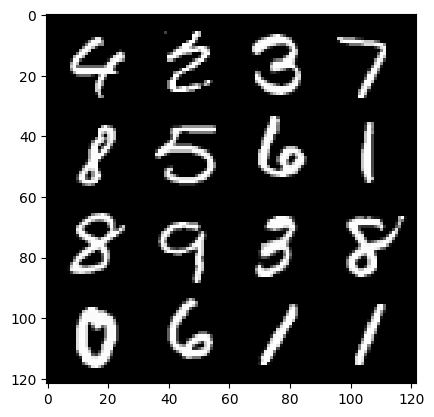

209: step 98400 / Gen loss: 2.026491706768671 / disc_loss: 0.2991241063177588


  0%|          | 0/469 [00:00<?, ?it/s]

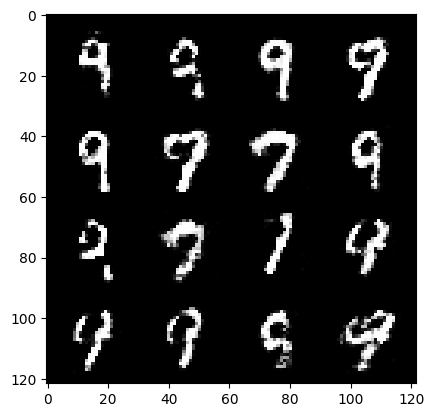

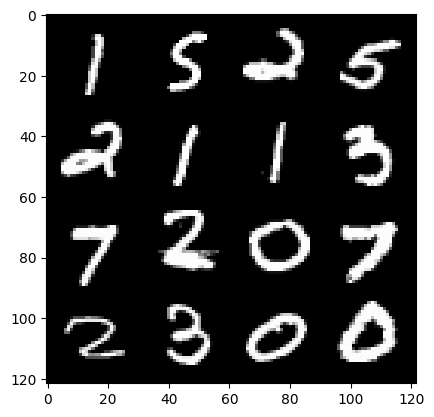

210: step 98700 / Gen loss: 1.8251197846730556 / disc_loss: 0.335577414582173


  0%|          | 0/469 [00:00<?, ?it/s]

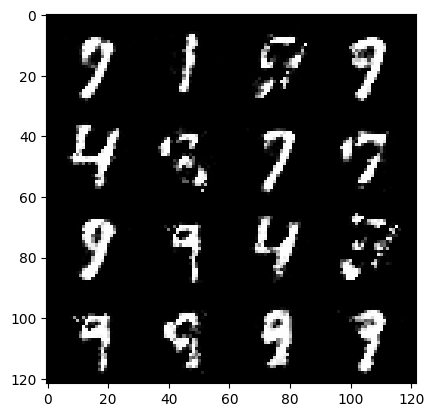

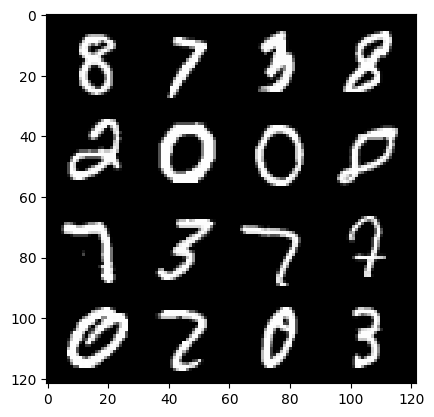

211: step 99000 / Gen loss: 1.9137605480353046 / disc_loss: 0.31248359968264894


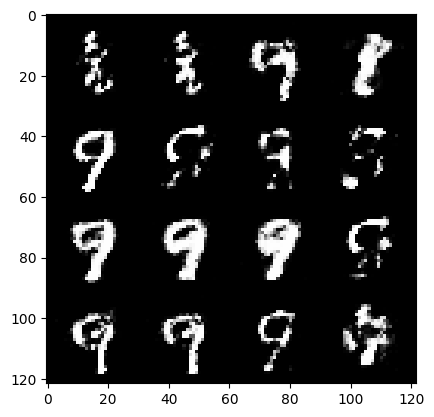

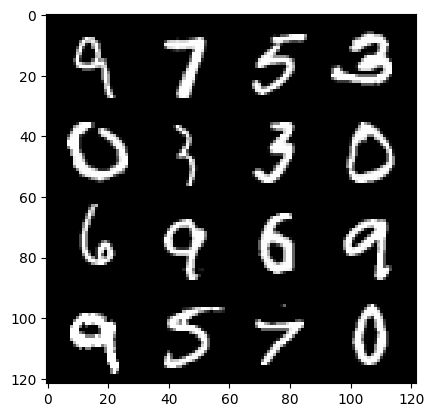

211: step 99300 / Gen loss: 1.7990101897716528 / disc_loss: 0.32740154514710096


  0%|          | 0/469 [00:00<?, ?it/s]

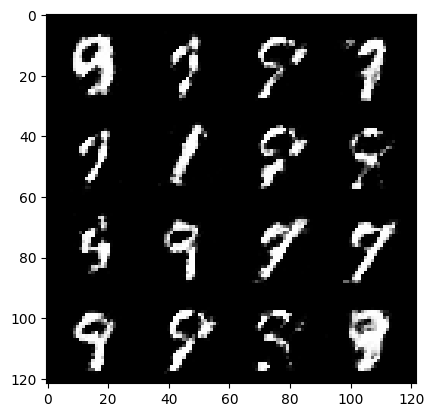

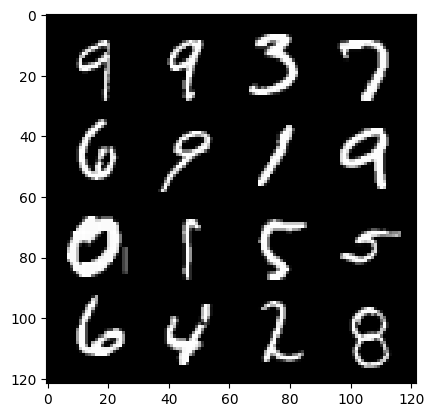

212: step 99600 / Gen loss: 1.7208734440803535 / disc_loss: 0.3371901040275893


  0%|          | 0/469 [00:00<?, ?it/s]

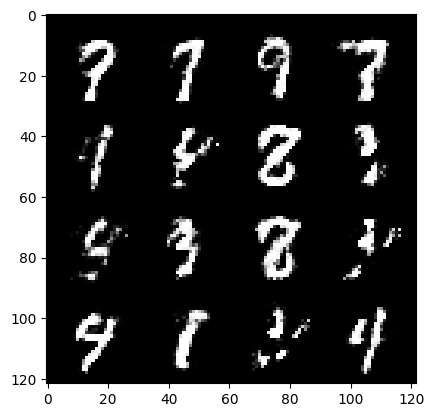

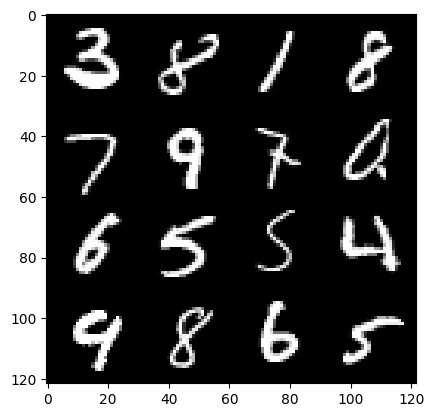

213: step 99900 / Gen loss: 1.8402366197109226 / disc_loss: 0.30212687348326045


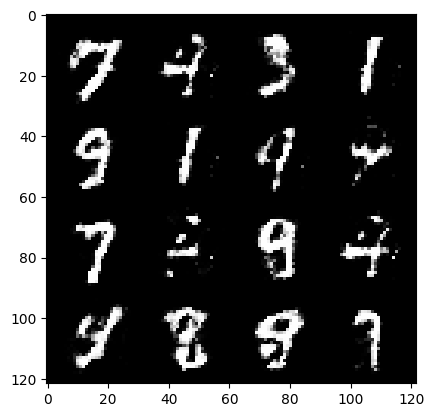

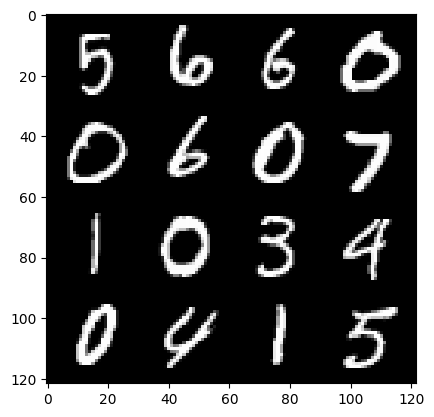

213: step 100200 / Gen loss: 1.9120994587739315 / disc_loss: 0.30338585063815143


  0%|          | 0/469 [00:00<?, ?it/s]

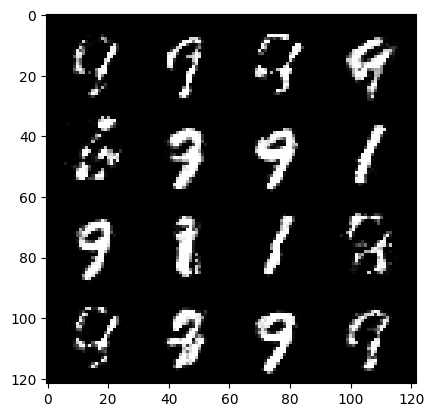

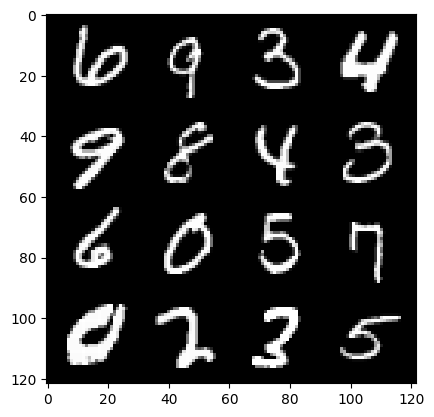

214: step 100500 / Gen loss: 1.851733743747075 / disc_loss: 0.315818429638942


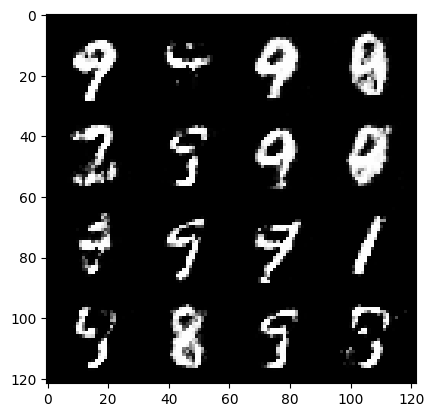

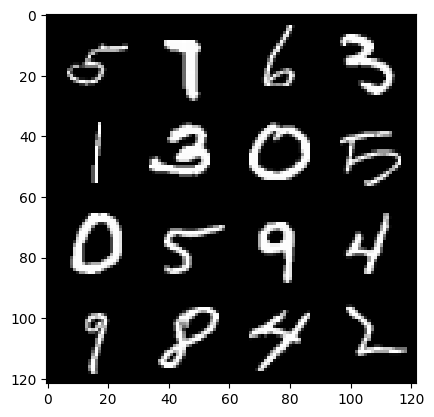

214: step 100800 / Gen loss: 1.7781268811225892 / disc_loss: 0.3278325002888838


  0%|          | 0/469 [00:00<?, ?it/s]

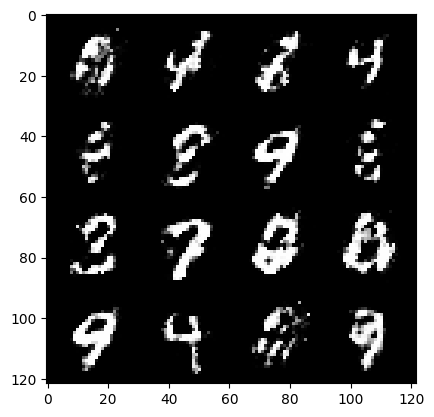

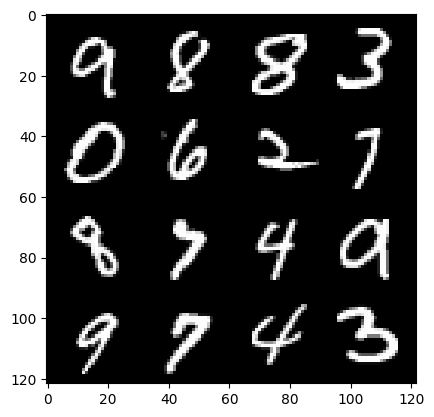

215: step 101100 / Gen loss: 1.7178474493821458 / disc_loss: 0.34784306416908906


  0%|          | 0/469 [00:00<?, ?it/s]

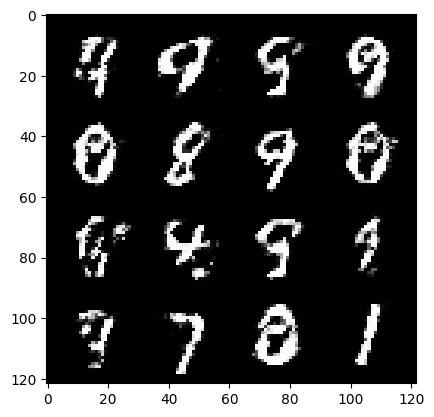

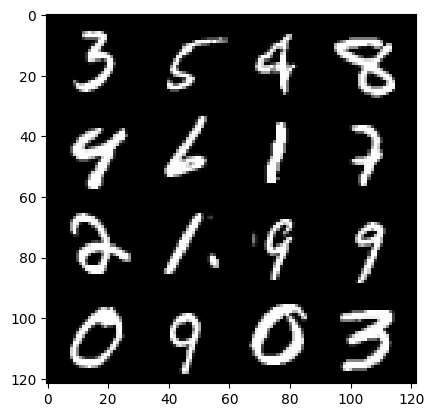

216: step 101400 / Gen loss: 1.9392068131764733 / disc_loss: 0.30206969236334147


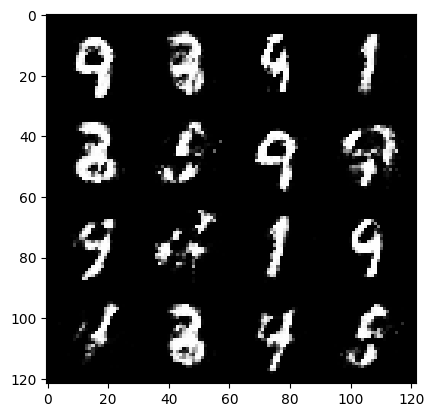

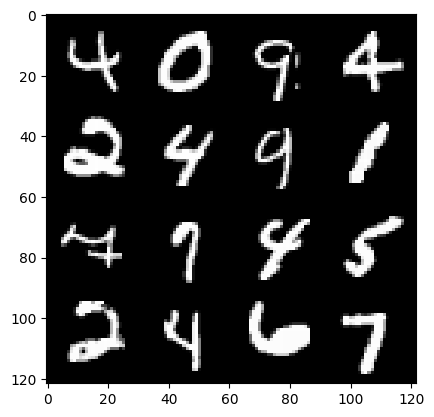

216: step 101700 / Gen loss: 1.8468853704134627 / disc_loss: 0.33577105879783625


  0%|          | 0/469 [00:00<?, ?it/s]

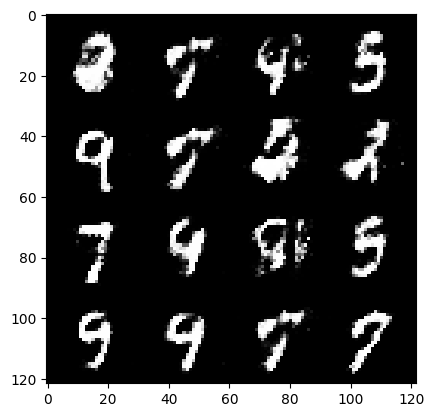

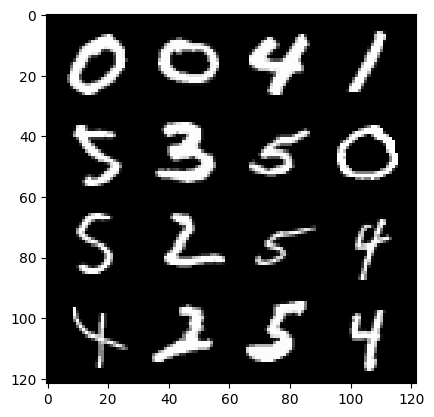

217: step 102000 / Gen loss: 1.8443840034802754 / disc_loss: 0.32889022355278336


  0%|          | 0/469 [00:00<?, ?it/s]

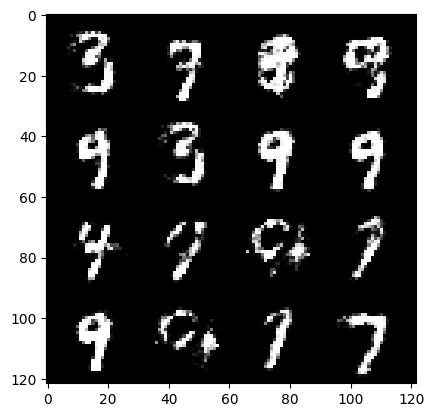

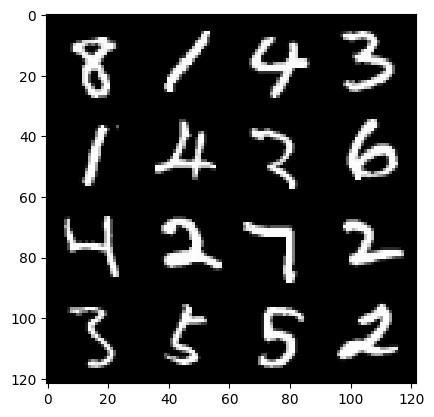

218: step 102300 / Gen loss: 1.8822538876533503 / disc_loss: 0.3164841639995574


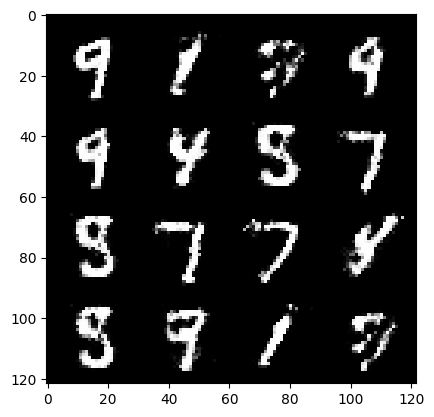

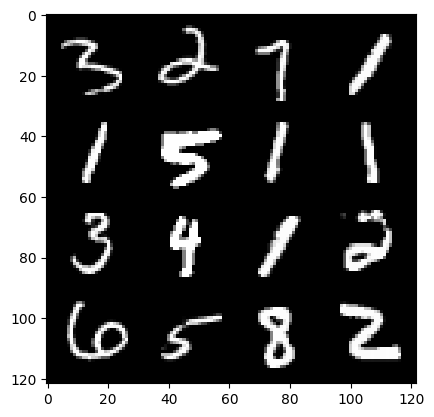

218: step 102600 / Gen loss: 1.703502460718154 / disc_loss: 0.35177106589078877


  0%|          | 0/469 [00:00<?, ?it/s]

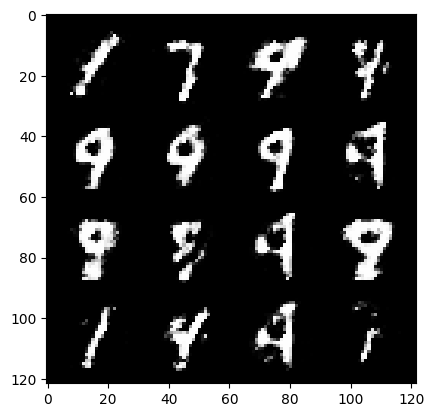

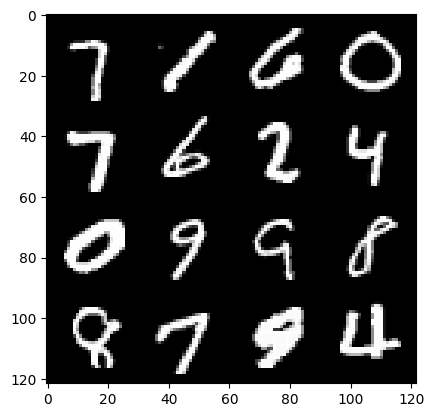

219: step 102900 / Gen loss: 1.6792228794097908 / disc_loss: 0.3709696916739145


  0%|          | 0/469 [00:00<?, ?it/s]

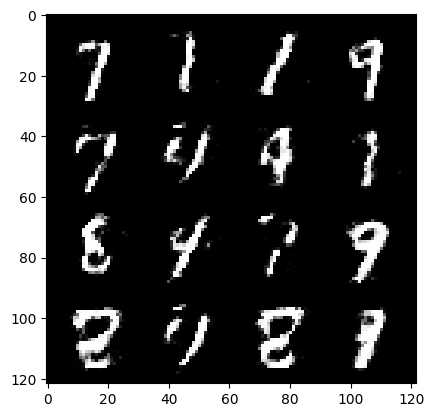

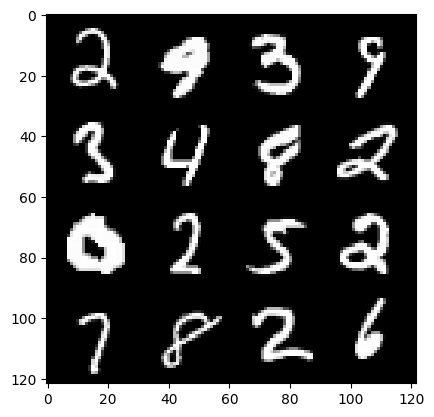

220: step 103200 / Gen loss: 1.7662051355838777 / disc_loss: 0.3312921627859274


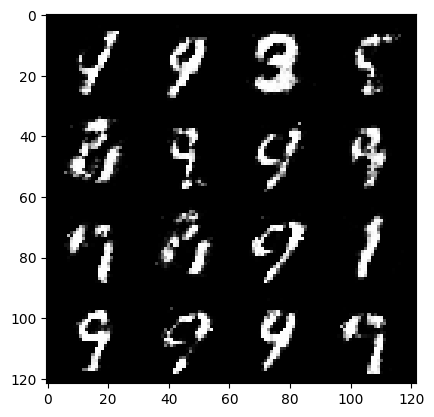

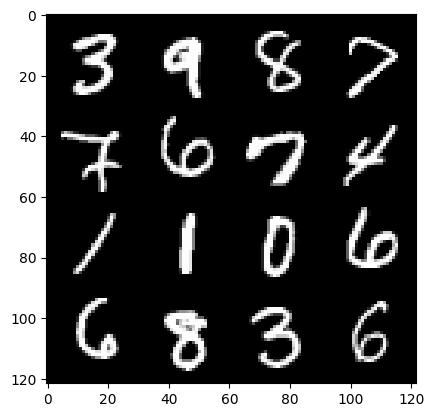

220: step 103500 / Gen loss: 1.767921649614969 / disc_loss: 0.33639098823070507


  0%|          | 0/469 [00:00<?, ?it/s]

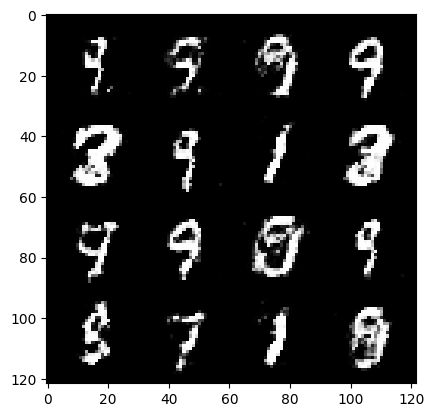

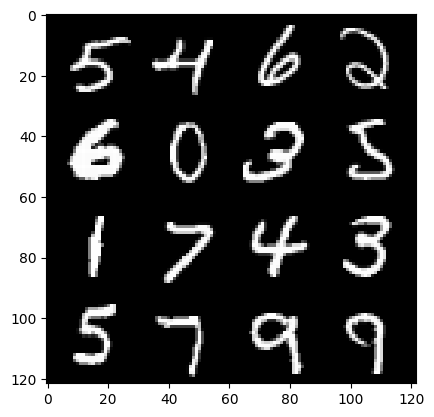

221: step 103800 / Gen loss: 1.6304785525798793 / disc_loss: 0.3634950403372448


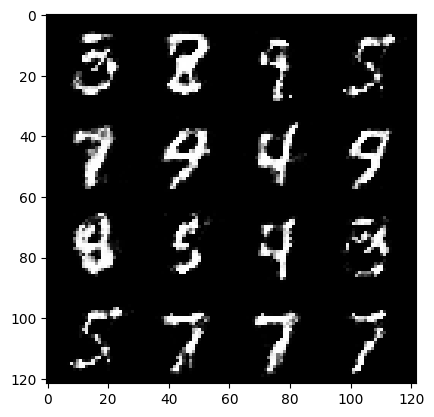

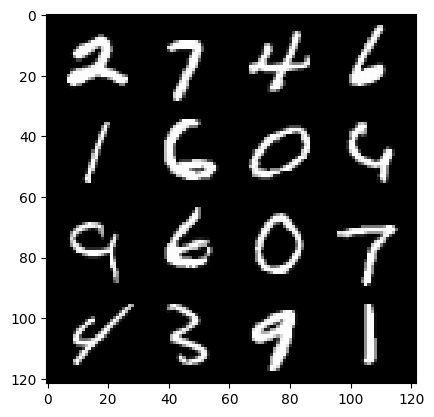

221: step 104100 / Gen loss: 1.671128530104955 / disc_loss: 0.3494856762886048


  0%|          | 0/469 [00:00<?, ?it/s]

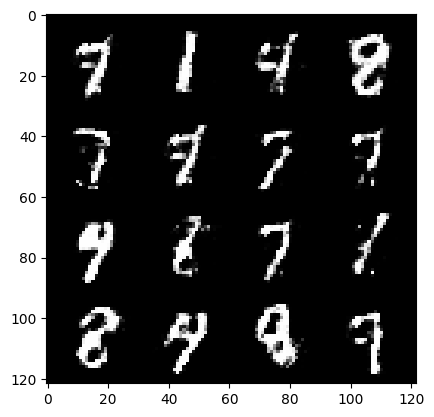

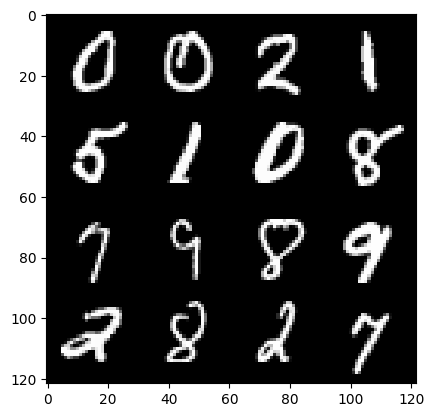

222: step 104400 / Gen loss: 1.7220304918289193 / disc_loss: 0.32838490386803937


  0%|          | 0/469 [00:00<?, ?it/s]

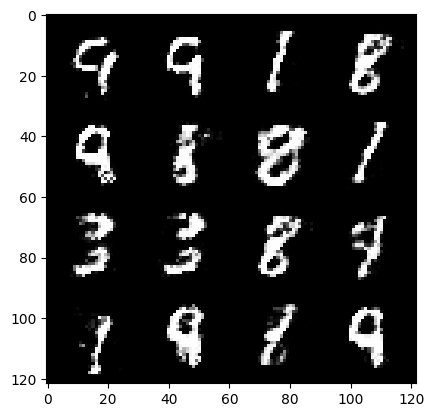

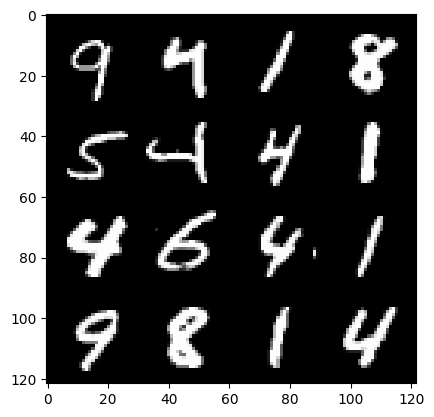

223: step 104700 / Gen loss: 1.7562995684146891 / disc_loss: 0.3446221122642359


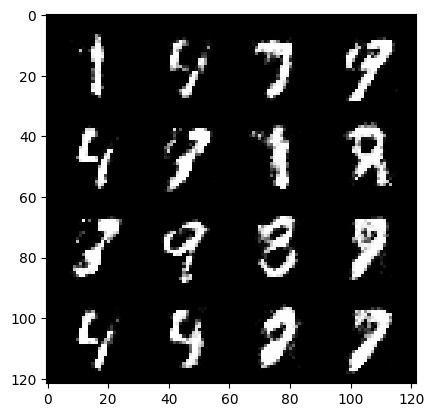

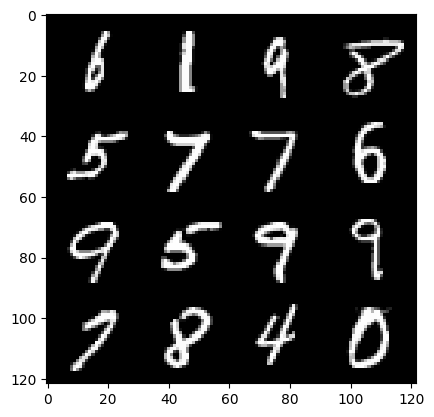

223: step 105000 / Gen loss: 1.7942898885409038 / disc_loss: 0.34009740759929025


  0%|          | 0/469 [00:00<?, ?it/s]

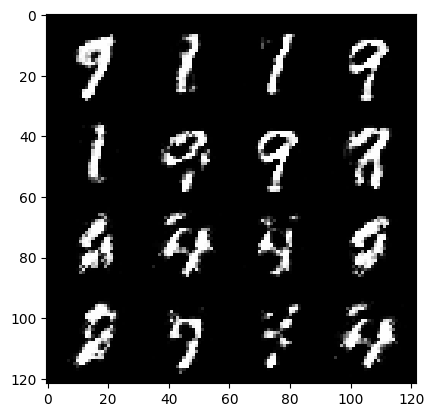

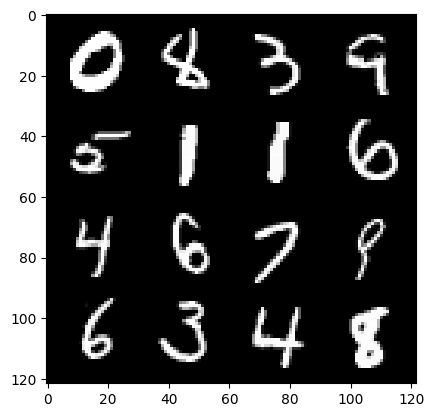

224: step 105300 / Gen loss: 1.6831781689325964 / disc_loss: 0.3673180217544236


  0%|          | 0/469 [00:00<?, ?it/s]

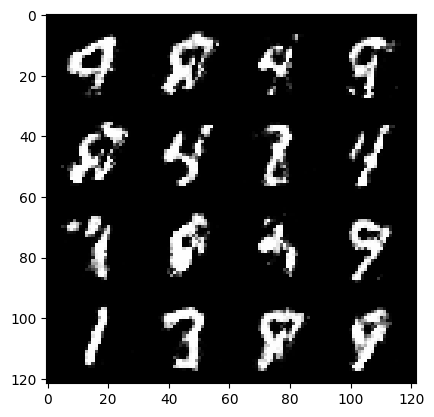

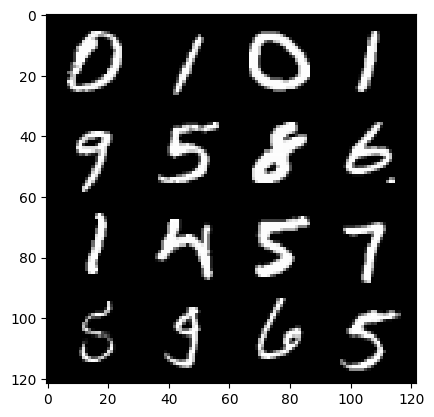

225: step 105600 / Gen loss: 1.7229843509197251 / disc_loss: 0.3420933343966801


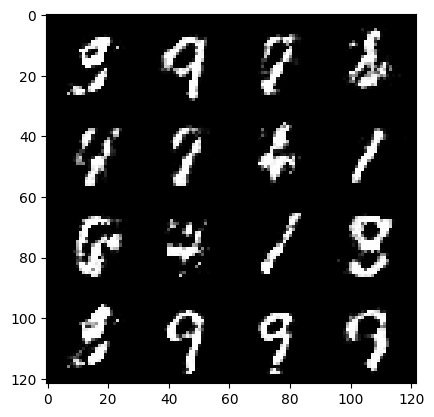

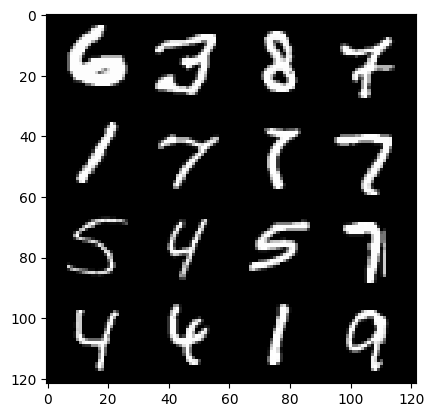

225: step 105900 / Gen loss: 1.88018850684166 / disc_loss: 0.3102186922729015


  0%|          | 0/469 [00:00<?, ?it/s]

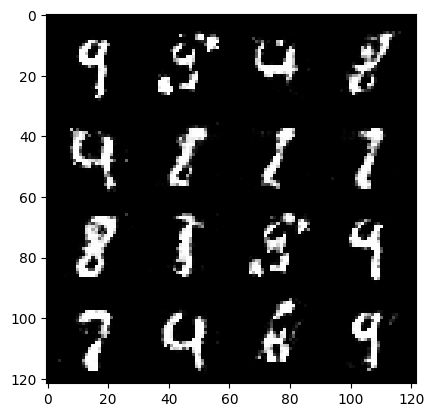

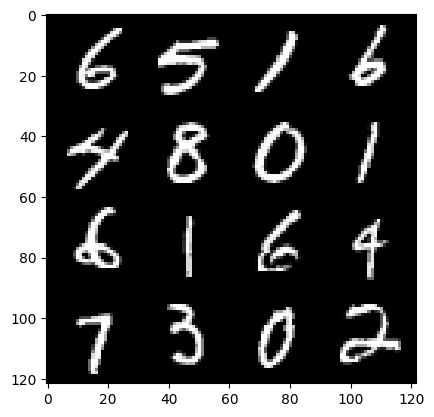

226: step 106200 / Gen loss: 1.7718494776884717 / disc_loss: 0.3436845135688782


  0%|          | 0/469 [00:00<?, ?it/s]

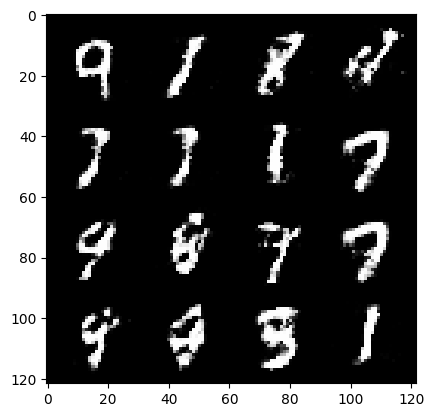

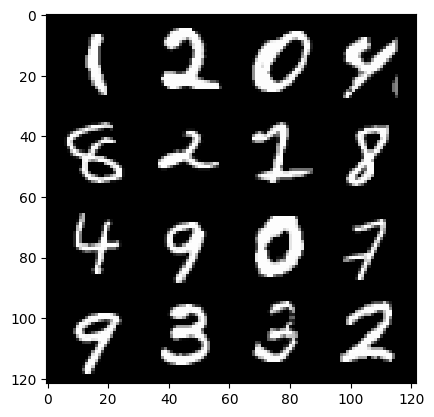

227: step 106500 / Gen loss: 1.7720003497600558 / disc_loss: 0.3457528968652091


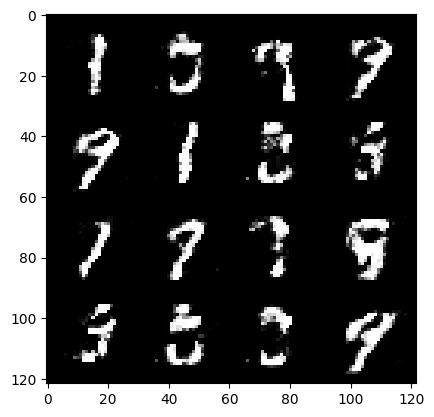

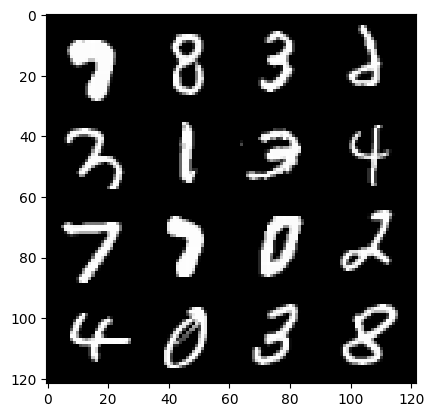

227: step 106800 / Gen loss: 1.6439844950040163 / disc_loss: 0.3682446602980298


  0%|          | 0/469 [00:00<?, ?it/s]

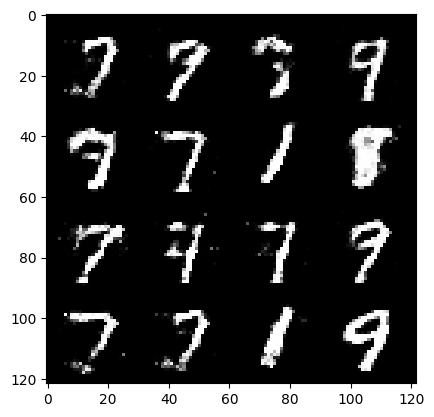

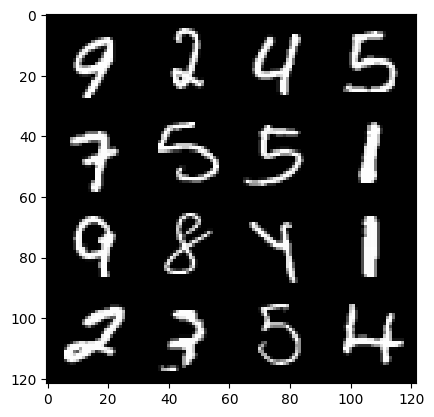

228: step 107100 / Gen loss: 1.6471248853206644 / disc_loss: 0.3628528232375781


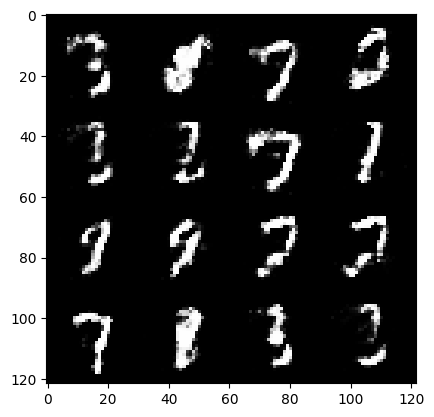

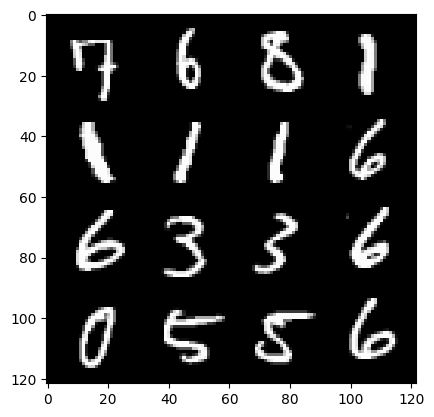

228: step 107400 / Gen loss: 1.6432745901743586 / disc_loss: 0.3560699686408043


  0%|          | 0/469 [00:00<?, ?it/s]

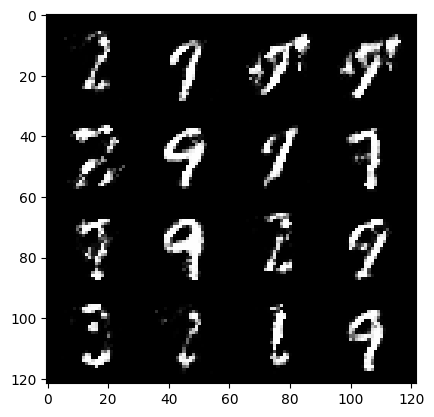

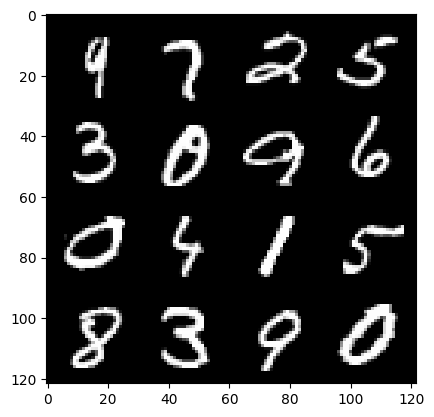

229: step 107700 / Gen loss: 1.7214372448126467 / disc_loss: 0.32927759587764727


  0%|          | 0/469 [00:00<?, ?it/s]

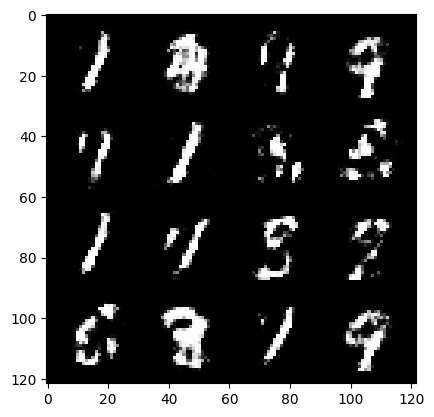

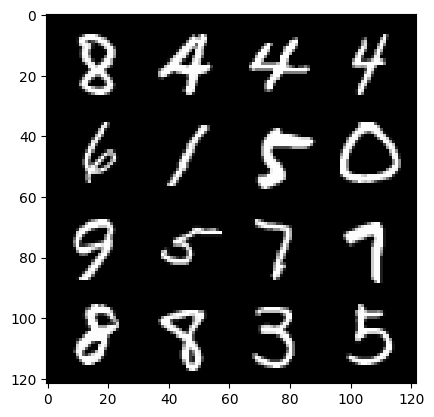

230: step 108000 / Gen loss: 1.6730534625053408 / disc_loss: 0.3514136773347853


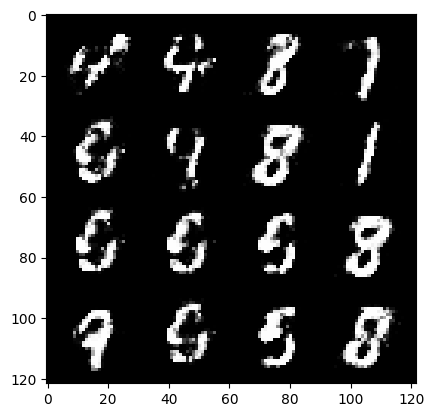

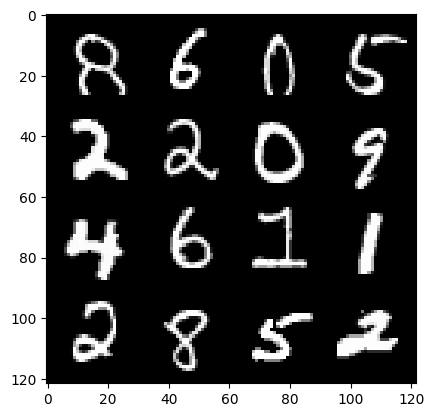

230: step 108300 / Gen loss: 1.6807743597030658 / disc_loss: 0.3476775767405827


  0%|          | 0/469 [00:00<?, ?it/s]

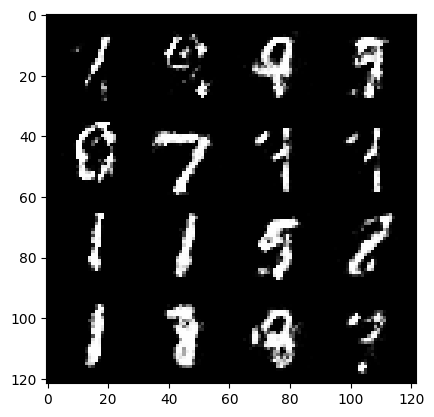

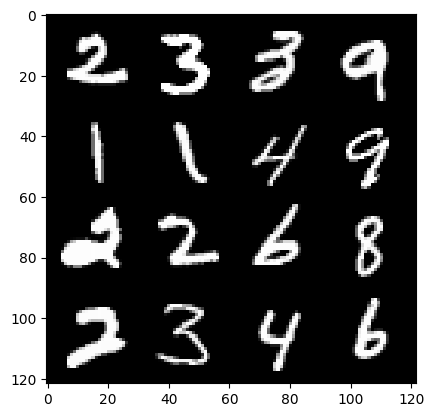

231: step 108600 / Gen loss: 1.6724115645885473 / disc_loss: 0.35779230346282315


  0%|          | 0/469 [00:00<?, ?it/s]

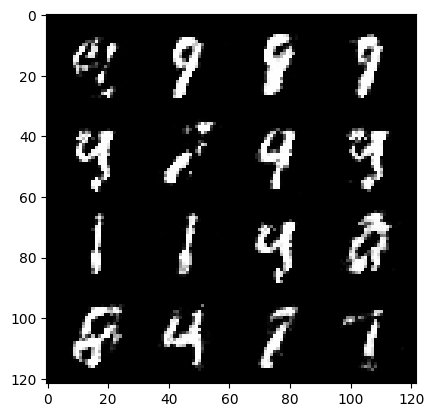

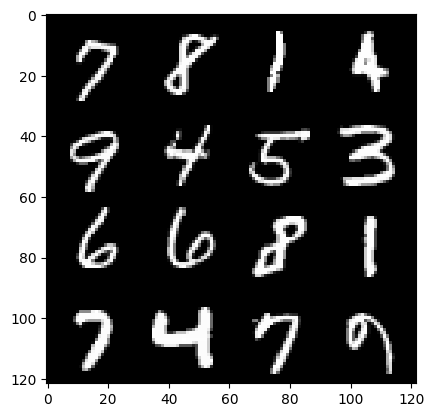

232: step 108900 / Gen loss: 1.6292159553368895 / disc_loss: 0.370253244837125


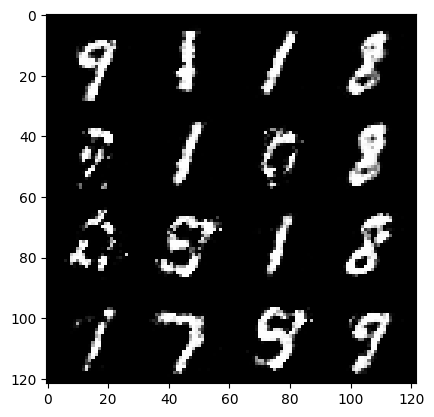

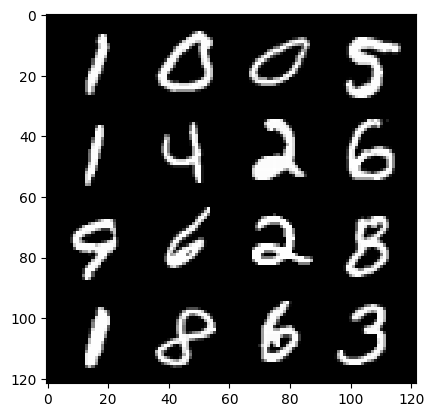

232: step 109200 / Gen loss: 1.6172454893589026 / disc_loss: 0.3719422520200413


  0%|          | 0/469 [00:00<?, ?it/s]

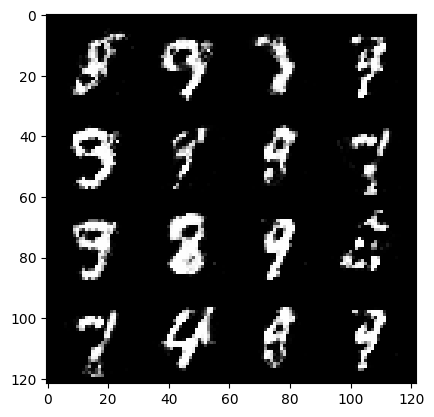

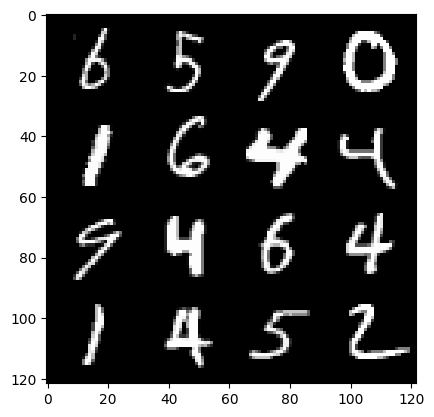

233: step 109500 / Gen loss: 1.6242382816473646 / disc_loss: 0.36331024348735785


In [ ]:
for epoch in range(epochs):
  for real, _ in tqdm(dataloader): #we don't need labels

    #Discriminator
    disc_opt.zero_grad() #at the begining of earch step set the gradients to zero

    cur_bs = len(real) #Current batch size, usually 128 but for last step it will be less (60k / 128 = 468.75)
    real = real.view(cur_bs, -1) #resize to 128 x 784
    real = real.to(device)

    disc_loss = calc_disc_loss(loss_func, gen, disc, cur_bs, real, z_dim)
    disc_loss.backward(retain_graph=True)
    disc_opt.step()

    #Generator
    gen_opt.zero_grad()

    gen_loss = calc_gen_loss(loss_func, gen, disc, cur_bs, z_dim)
    gen_loss.backward(retain_graph=True)
    gen_opt.step()


    #visualization & status
    mean_disc_loss += disc_loss.item() / info_step
    mean_gen_loss += gen_loss.item() / info_step

    if cur_step % info_step == 0 and cur_step > 0:
      fake_noise = gen_noise(cur_bs, z_dim)
      fake = gen(fake_noise)
      show(fake)
      show(real)

      print(f"{epoch}: step {cur_step} / Gen loss: {mean_gen_loss} / disc_loss: {mean_disc_loss}")
      mean_gen_loss, mean_disc_loss = 0,0

    cur_step += 1




